In [1]:
import os
import sys
import time
import glob
import numpy as np
import torch
import torch.nn as nn
import torch.utils
import torch.nn.functional as F
import torchvision.datasets as dset
import torch.backends.cudnn as cudnn
import torchvision.transforms as transforms
from torch.autograd import Variable
from timeit import default_timer as timer
from tqdm import tqdm_notebook
from collections import defaultdict,Counter
import pickle

import scipy.io

In [ ]:
!git clone https://github.com/Huawei-Sirius-Summer-2020/DPDBlocks.git

Cloning into 'DPDBlocks'...
remote: Enumerating objects: 19, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 19 (delta 4), reused 19 (delta 4), pack-reused 0
Unpacking objects: 100% (19/19), done.


In [ ]:
from DPDBlocks.blocks import AFIR,ABS,Polynomial,Delay,Prod_cmp

In [ ]:
!git clone https://github.com/Huawei-Sirius-Summer-2020/BlackBoxData.git

Cloning into 'BlackBoxData'...
remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 7 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (7/7), done.


In [ ]:
cd /content/BlackBoxData


/content/BlackBoxData


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [3]:
cd /content/drive/My Drive/Colab Notebooks/huawei

/content/drive/My Drive/Colab Notebooks/huawei


In [4]:
from DPDBlocks.blocks import AFIR,ABS,Polynomial,Delay,Prod_cmp

In [5]:
import matplotlib.pyplot as plt

import matplotlib.mlab as mlab
import matplotlib.gridspec as gridspec

In [6]:
def NMSE(X, E):
    return 10*torch.log10((E.norm(dim=1)**2).sum()/(X.norm(dim=1)**2).sum())

In [7]:
def update_history(hist,iter_num, val_acc, val_loss, time):
    hist['iter'].append(iter_num)
    hist['time'].append(time)
    hist['train_loss'].append(val_loss.item())
        # self.hist['norm_coeffs'].append(train_loss.item())
    hist['train_loss_db'].append(val_acc.item())

In [8]:
def train_of_epoch(train_queue, model, criterion, optimizer):
    for step, (train) in enumerate(train_queue):

        input_batch = Variable(train[:,:,:1],requires_grad=False).permute(2,1,0).cuda()
        desired = Variable(train[:,:,1:],requires_grad=False).permute(2,1,0).cuda()
        optimizer.zero_grad()
        out = model.forward(input_batch)
        loss = criterion(out, desired)

        loss.backward()

        optimizer.step()

In [9]:
def eval_model(valid_queue, model, criterion):
    for step, (valid) in enumerate(valid_queue):
        model.eval()
        input_batch = Variable(valid[:,:,:1],requires_grad=False).permute(2,1,0).cuda()
        desired = Variable(valid[:,:,1:],requires_grad=False).permute(2,1,0).cuda()
        out = model.forward(input_batch)


        loss=criterion(out,desired)
        plt.psd(input_batch.detach().cpu()[0,0,:]+
                1j*input_batch.detach().cpu()[0,1,:],NFFT=2048)
        plt.psd(desired.detach().cpu()[0,0,:]+
                1j*desired.detach().cpu()[0,1,:],NFFT=2048)
        # plt.psd(desired.permute(2,1,0).detach().cpu().reshape(-1,),NFFT=2048)
        plt.psd((out-desired).detach().cpu()[0,0,:]+
                1j*(out-desired).detach().cpu()[0,1,:],NFFT=2048)
        # plt.psd((out-desired).permute(2,1,0).detach().cpu().reshape(-1,),NFFT=2048)
        plt.show()

        
        accuracy = NMSE(input_batch, out-desired)
#         print('Loss = ',loss.cpu().detach().numpy(), 'Accuracy = ', accuracy.cpu().detach().numpy(), 'dbs')
    return loss,accuracy
#     return model

In [10]:
def train(train_queue, valid_queue, model, criterion, optimizer,n_epoch,
          scheduler,log_every=1,save_flag=True,path_to_experiment='/content/drive/My Drive/Colab Notebooks/huawei/new_folder'):
    min_loss=0
    hist=defaultdict(list)
    t0=timer()
    for it in tqdm_notebook(range(n_epoch)):
        model.train(True)
        train_of_epoch(train_queue, model, criterion, optimizer)
        scheduler.step()

    #     if return_history and it % log_every == 0:
    #         model.init_for_batch(train)
    #         train_loss = complex_mse(model.forward(train.x), train.y)
        if it%log_every==0:
            loss_v,accuracy_v=eval_model(valid_queue,net, loss_fn)
            update_history(hist,it, accuracy_v, loss_v, timer() - t0,)
            print('Loss = ',loss_v.cpu().detach().numpy(), 'Accuracy = ', accuracy_v.cpu().detach().numpy(), 'dbs')
            
            if save_flag:
                with open(path_to_experiment + '/hist.pkl', 'wb') as output:
                    pickle.dump(hist, output)

                    torch.save(model.state_dict(), path_to_experiment + '/model.pt')
                if hist['train_loss_db'][-1] < min_loss:
                            min_loss = hist['train_loss_db'][-1]
                            torch.save(model.state_dict(), path_to_experiment + '/best_model.pth')
    return hist

In [11]:
def draw_spectrum(input_batch,desired,out):
  plt.psd(input_batch.detach().cpu()[0,0,:]+
                1j*input_batch.detach().cpu()[0,1,:],NFFT=2048)
  plt.psd(desired.detach().cpu()[0,0,:]+
                1j*desired.detach().cpu()[0,1,:],NFFT=2048)
        # plt.psd(desired.permute(2,1,0).detach().cpu().reshape(-1,),NFFT=2048)
  plt.psd((out-desired).detach().cpu()[0,0,:]+
                1j*(out-desired).detach().cpu()[0,1,:],NFFT=2048)
        # plt.psd((out-desired).permute(2,1,0).detach().cpu().reshape(-1,),NFFT=2048)
  plt.show()

In [12]:
np.random.seed()
# torch.cuda.set_device()
cudnn.benchmark = True
torch.manual_seed(10)
cudnn.enabled=True
torch.cuda.manual_seed(10)

In [13]:
Batch_size=5000

In [14]:
gamma=0.95
step_size=5

In [15]:
name = 'BlackBoxData_80'
# name = 'BlackBoxData'
# name = '../BlackBoxData/data1'
mat = scipy.io.loadmat(name)
x = np.array(mat['x']).reshape(-1,1)/2**15
d = np.array(mat['y']).reshape(-1,1)/2**15
# x = np.array(mat['xE']).reshape(-1,1)/2**15
# d = np.array(mat['d']).reshape(-1,1)/2**15
# x, d = mat['xE'], mat['d']

x_real, x_imag = torch.from_numpy(np.real(x)), torch.from_numpy(np.imag(x))
d_real, d_imag = torch.from_numpy(np.real(d)), torch.from_numpy(np.imag(d))
print(x_real.shape)

X = torch.DoubleTensor(torch.cat((x_real, x_imag), dim=1)).reshape(-1,2,1)
D = torch.DoubleTensor(torch.cat((d_real, d_imag), dim=1)).reshape(-1,2,1)

train_queue = torch.utils.data.DataLoader(
    torch.cat((X,D),dim=-1), batch_size=Batch_size)#, pin_memory=True)

valid_queue = torch.utils.data.DataLoader(
    torch.cat((X,D),dim=-1), batch_size=X.shape[0])#,pin_memory=True)

torch.Size([99840, 1])


In [16]:
loss_fn = nn.MSELoss()

In [17]:
class Cell(nn.Module):
    def __init__(self,M=15,D=0,Poly_order=8,Passthrough=False):
        super(Cell,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,0)
        self.delay=Delay(D)
        self.pol=Polynomial(Poly_order,True) # было Passthrough
        self.prod=Prod_cmp()
    def forward(self,x):
        x=self.delay(x)
        up=self.f1(x) 
        return self.prod(up,self.f2(self.pol(x)))

In [18]:
class Sasha_Cell_apd(nn.Module):
    def __init__(self,M=15,D1=0,D2=0,Poly_order=8,Passthrough=False):
        super(Sasha_Cell_apd,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,1)
        self.f3=AFIR(M,0)
        self.f4=AFIR(M,1)
        self.pol1=Polynomial(Poly_order,True) # было Passthrough
        self.pol2=Polynomial(Poly_order,True) # было Passthrough
        self.delay1=Delay(D1)
        self.delay2=Delay(D2)
        self.prod=Prod_cmp()
    def forward(self,x):
        x1 = x.clone()
        x2 = x.clone()
        x1=self.delay1(x1)
        x2=self.delay2(x2)
        lis = self.f1(self.pol1(x1)) + self.f2(x1)
        sah = self.f3(self.pol2(x2)) + self.f4(x2)
        return self.prod(lis, sah)

In [19]:
class Olga_Cell(nn.Module):
    def __init__(self,M=15,D=2,Poly_order=2,Passthrough=True):
        super(Olga_Cell,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,3)
        self.f3=AFIR(M,4)
        self.delay=Delay(D)
        self.pol_smal=Polynomial(2,Passthrough)
        self.pol_big=Polynomial(10,Passthrough)
        self.prod=Prod_cmp()
 
    def forward(self,x):
        source = x.clone()
        x=self.delay(x)
        up=self.f1(x) 
 
        mid = self.pol_smal(source)
        mid = self.prod(source,mid)
        mid = self.f2(mid)
 
        low = self.pol_big(source)
        low = self.prod(low, source)
        low = self.f3(low)
        return up+mid+low

In [20]:
class Olga_Better_Cell(nn.Module):
    def __init__(self,M=15,D1=0,D2=0,D3=0,Poly_order=2,Passthrough=True):
        super(Olga_Better_Cell,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,3)
        self.f3=AFIR(M,4)
        self.delay1=Delay(D1)
        self.delay2=Delay(D2)
        self.delay3=Delay(D3)
        self.pol_smal=Polynomial(2,Passthrough)
        self.pol_big=Polynomial(10,Passthrough)
        self.prod=Prod_cmp()
 
    def forward(self,x):
        source = x.clone()
        x=self.delay1(x)
        up=self.f1(x) 
 
        mid = self.delay2(source)
        mid = self.pol_smal(mid)
        mid = self.prod(source,mid)
        mid = self.f2(mid)
 
        low = self.delay3(source)
        low = self.pol_big(low)
        low = self.prod(low, source)
        low = self.f3(low)
        return up+mid+low

In [21]:
class Olga_Better_Cell1(nn.Module):
    def __init__(self,M=15,D_array=[],Poly_order=2,Passthrough=True):
        super(Olga_Better_Cell1,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,3)
        self.f3=AFIR(M,4)
        self.delay1=Delay(D_array[0])
        self.delay2=Delay(D_array[1])
        self.delay3=Delay(D_array[2])
        self.pol_smal=Polynomial(2,Passthrough)
        self.pol_big=Polynomial(10,Passthrough)
        self.prod=Prod_cmp()
 
    def forward(self,x):
        source = x.clone()
        x=self.delay1(x)
        up=self.f1(x) 
 
        mid = self.delay2(source)
        mid = self.pol_smal(mid)
        mid = self.prod(source,mid)
        mid = self.f2(mid)
 
        low = self.delay3(source)
        low = self.pol_big(low)
        low = self.prod(low, source)
        low = self.f3(low)
        return up+mid+low

In [41]:
class layer(nn.Module):
    def __init__(self, delay, width):
        super(layer, self).__init__()
        self.Cells = nn.ModuleList()
        idx = 0
        for i in range(width):
#             print(i)
            self.Cells.append(Olga_Better_Cell(D1=delay[idx], D2=delay[idx+1], D3=delay[idx+2]))
            idx += 3

    def forward(self, x):
        out = torch.zeros_like(x)
        for i in range(len(self.Cells)):
            out += self.Cells[i](x)
        return out

In [38]:
class layer_Masl(nn.Module):
    def __init__(self, delay, width):
        super(layer_Masl, self).__init__()
        self.Cells = nn.ModuleList()
        for i in range(width):
#             print(i)
            self.Cells.append(Cell(D=delay[i]))

    def forward(self, x):
        out = torch.zeros_like(x)
        for i in range(len(self.Cells)):
            out += self.Cells[i](x)
        return out

In [39]:
net = layer_Masl([1,0,-1,0],4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist_masl_layer = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
#print(hist)

Output hidden; open in https://colab.research.google.com to view.

In [22]:
array1 = [-1,0,1,0,1,-1,1,-1,0,2,-2,-3]
array2 = [-1,0,1,0,1,-1,1,-1,0,0,-1,1]
array3 = [-6,-5,-4,-3,-2,-1,1,2,3,4,5,6]
array4 = [1,2,3,4,5,6,7,8,9,10,11,12]
array5 = [2,-1,0,1,0,-2,0,2,1,1,-2,-1]
array6 = [-3,0,2,-1,-2,4,2,1,-3,0,2,-4]

In [23]:
array7 = [-1,0,1]
array8 = [7,-2,4]
array9 = [0,1,2]
array10 = [-3,0,4]
array11 = [1,6,-5]
array12 = [1,-1,2]

In [42]:
net = layer(array1,4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
print(hist)

Output hidden; open in https://colab.research.google.com to view.

In [43]:
net = layer(array2,4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist_2 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
print(hist_2)

Output hidden; open in https://colab.research.google.com to view.

In [44]:
net = layer(array3,4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist_3 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
print(hist_3)

Output hidden; open in https://colab.research.google.com to view.

In [45]:
net = layer(array4,4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist_4 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
print(hist_4)

Output hidden; open in https://colab.research.google.com to view.

In [46]:
net = layer(array5,4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist_5 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
print(hist_5)

Output hidden; open in https://colab.research.google.com to view.

In [47]:
net = layer(array6,4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.98)
hist_6 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)
print(hist_6)

Output hidden; open in https://colab.research.google.com to view.

In [48]:
def draw_graph(array1, array2, array3, array4, array5, array6, hist1, hist2, hist3, hist4, hist5, hist6, hist_masl_layer):
    #print("Olga_layer")
    print("Olga_better_cells")
    fig, ax = plt.subplots()
    ax.plot(hist1['iter'], hist1['train_loss_db'], label=array1)
    ax.plot(hist2['iter'], hist2['train_loss_db'], label=array2)
    ax.plot(hist3['iter'], hist3['train_loss_db'], label=array3)
    ax.plot(hist4['iter'], hist4['train_loss_db'], label=array4)
    ax.plot(hist5['iter'], hist5['train_loss_db'], label=array5)
    ax.plot(hist6['iter'], hist6['train_loss_db'], label=array6)
    ax.plot(hist_masl_layer['iter'], hist_masl_layer['train_loss_db'], label='Masl_layer')
    ax.set_xlabel('iter')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of layers: iter')
    ax.legend()
    plt.show()

    fig, ax = plt.subplots()
    ax.plot(hist1['time'], hist1['train_loss_db'], label=array1)
    ax.plot(hist2['time'], hist2['train_loss_db'], label=array2)
    ax.plot(hist3['time'], hist3['train_loss_db'], label=array3)
    ax.plot(hist4['time'], hist4['train_loss_db'], label=array4)
    ax.plot(hist5['time'], hist5['train_loss_db'], label=array5)
    ax.plot(hist6['time'], hist6['train_loss_db'], label=array6)
    ax.plot(hist_masl_layer['time'], hist_masl_layer['train_loss_db'], label='Masl_layer')
    ax.set_xlabel('time')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of layers: time')
    ax.legend()
    plt.show()


Olga_better_cells


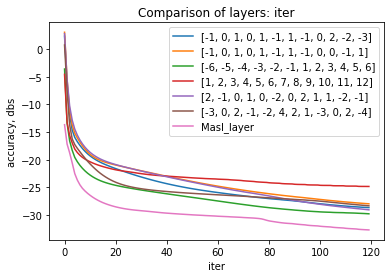

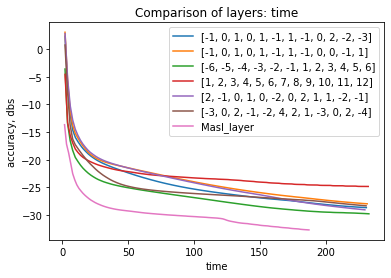

In [49]:
draw_graph(array1, array2, array3, array4, array5, array6, hist, hist_2, hist_3, hist_4, hist_5, hist_6,hist_masl_layer)

In [25]:
net = Olga_Better_Cell1(D_array=array7)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist13 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist13)

Output hidden; open in https://colab.research.google.com to view.

In [26]:
net = Olga_Better_Cell1(D_array=array8)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist14 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist14)

Output hidden; open in https://colab.research.google.com to view.

In [27]:
net = Olga_Better_Cell1(D_array=array9)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist15 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist15)

Output hidden; open in https://colab.research.google.com to view.

In [28]:
net = Olga_Better_Cell1(D_array=array10)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist16 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist16)

Output hidden; open in https://colab.research.google.com to view.

In [30]:
net = Olga_Better_Cell1(D_array=array11)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist17 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist17)

Output hidden; open in https://colab.research.google.com to view.

In [31]:
net = Olga_Better_Cell1(D_array=array12)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist18 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist18)

Output hidden; open in https://colab.research.google.com to view.

Olga_better_cells


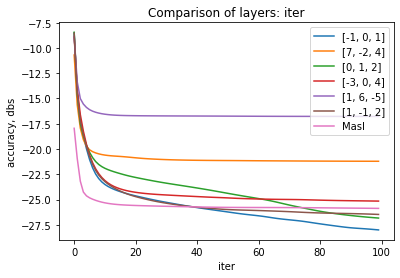

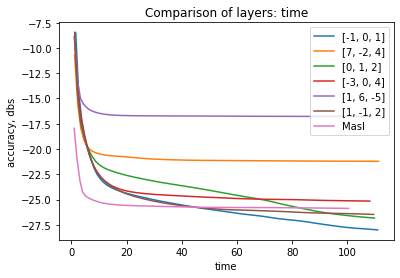

In [33]:
draw_graph(array7, array8, array9, array10, array11, array12, hist13, hist14, hist15, hist16, hist17, hist18, hist)

In [ ]:
const1 = 5
const2 = -2
const3 = -1
const4 = 3
const5 = 4
const6 = 4
const7 = -7
const8 = 7
const9 = 0
const10 = -3
const11 = 5
const12 = 2
const13 = -3
const14 = -1

In [32]:
net = Cell(D=0)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)
print(hist)


Output hidden; open in https://colab.research.google.com to view.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


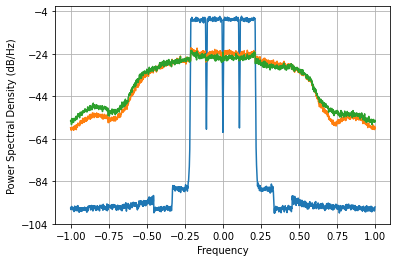

Loss =  0.0010107890653875571 Accuracy =  -14.998794915681103 dbs


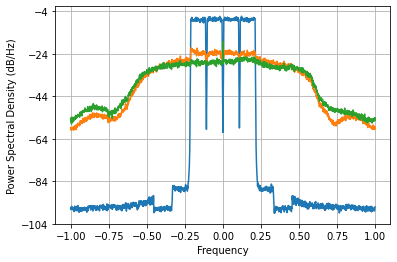

Loss =  0.0007302034222850013 Accuracy =  -16.41096162637648 dbs


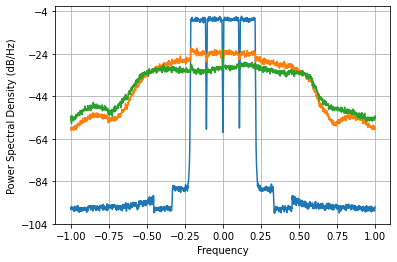

Loss =  0.00041502458401526757 Accuracy =  -18.86466203744938 dbs


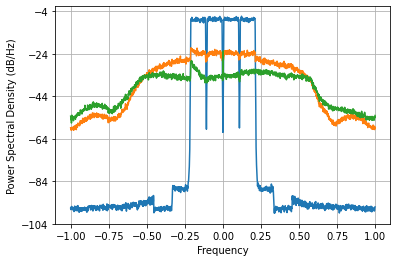

Loss =  0.00024528640280620034 Accuracy =  -21.148665524725033 dbs


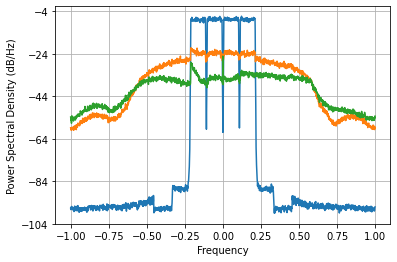

Loss =  0.0001823670481506907 Accuracy =  -22.435936581517225 dbs


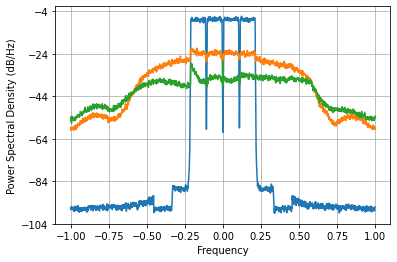

Loss =  0.00015292326561921316 Accuracy =  -23.200664630457887 dbs


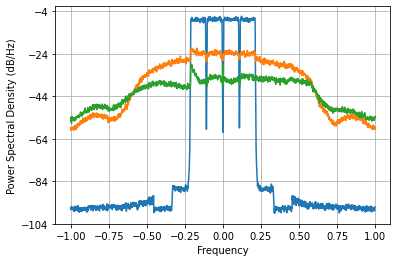

Loss =  0.00013614096622924522 Accuracy =  -23.70551198103361 dbs


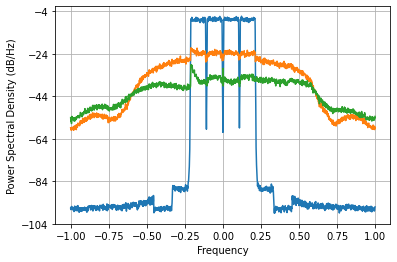

Loss =  0.00012537644413285358 Accuracy =  -24.063240782644076 dbs


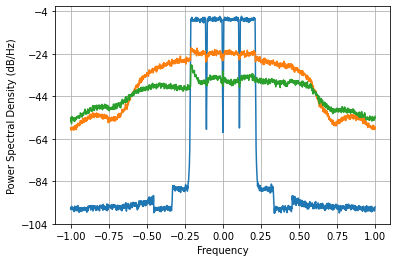

Loss =  0.00011812414269673604 Accuracy =  -24.32201357115279 dbs


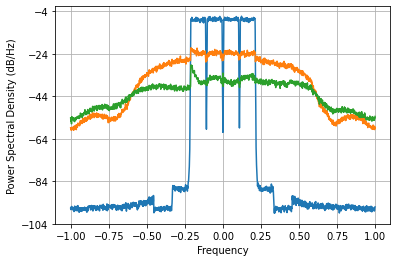

Loss =  0.00011308933956293459 Accuracy =  -24.511183588732962 dbs


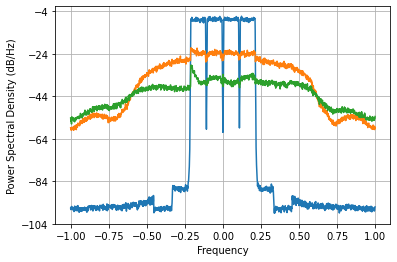

Loss =  0.00010947432783245063 Accuracy =  -24.652277393648696 dbs


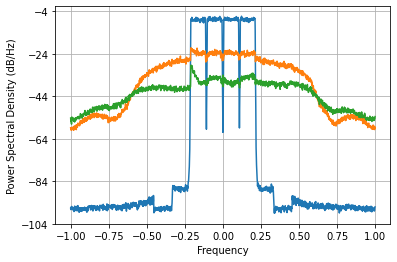

Loss =  0.00010675886591343874 Accuracy =  -24.76136075006182 dbs


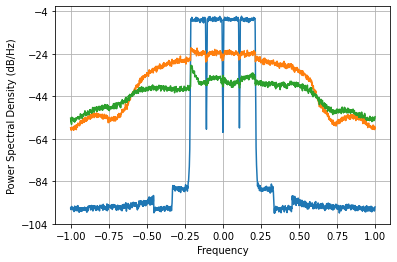

Loss =  0.00010463046999384378 Accuracy =  -24.848818505395407 dbs


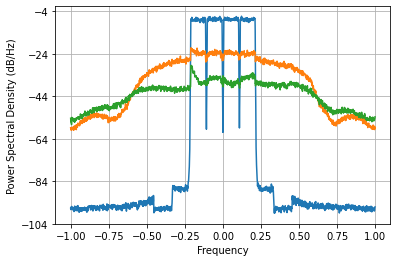

Loss =  0.00010290914238901396 Accuracy =  -24.92086067739923 dbs


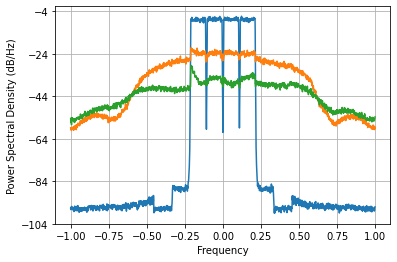

Loss =  0.00010147959347624082 Accuracy =  -24.981613079038063 dbs


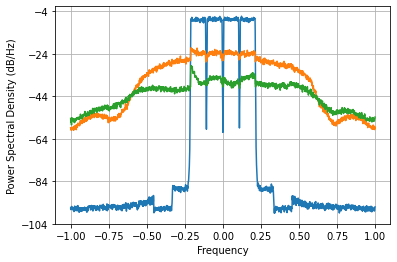

Loss =  0.00010026225978734754 Accuracy =  -25.034025378403314 dbs


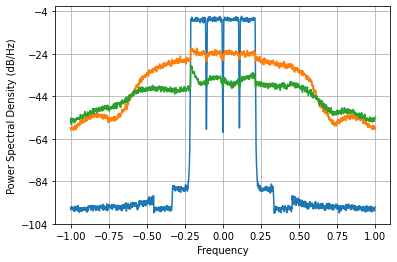

Loss =  9.920312174042122e-05 Accuracy =  -25.080146878676544 dbs


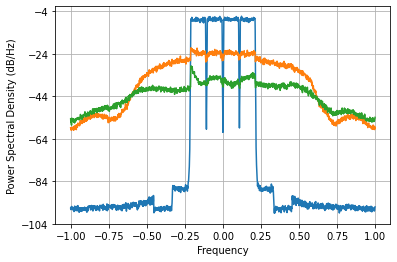

Loss =  9.82661425239978e-05 Accuracy =  -25.12136118701982 dbs


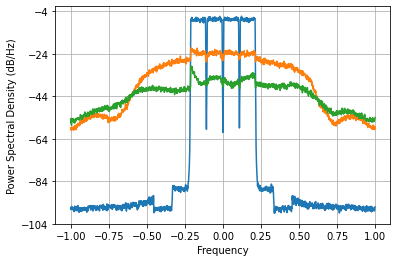

Loss =  9.742757169188169e-05 Accuracy =  -25.158581484631497 dbs


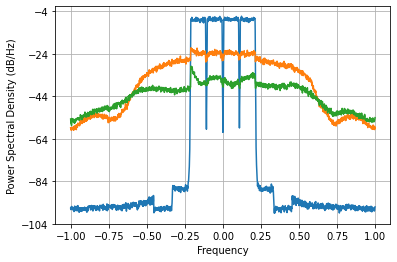

Loss =  9.667067282375124e-05 Accuracy =  -25.192452854137954 dbs


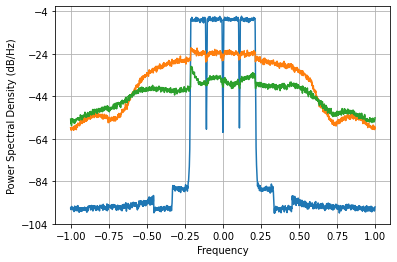

Loss =  9.598274032789436e-05 Accuracy =  -25.223468817138993 dbs


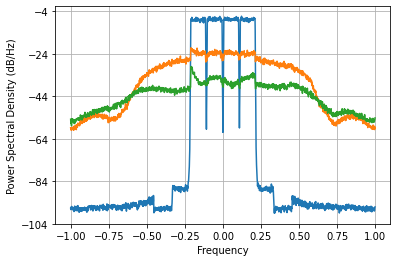

Loss =  9.535379003404999e-05 Accuracy =  -25.252020670286853 dbs


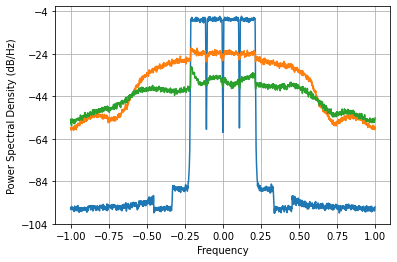

Loss =  9.477570626695486e-05 Accuracy =  -25.278429972225943 dbs


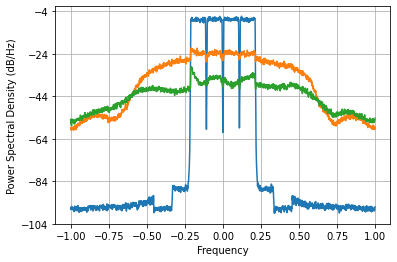

Loss =  9.424173903950255e-05 Accuracy =  -25.30296735150436 dbs


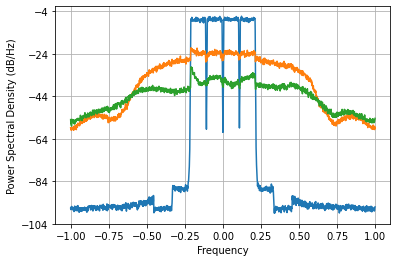

Loss =  9.374623421829728e-05 Accuracy =  -25.325861955264656 dbs


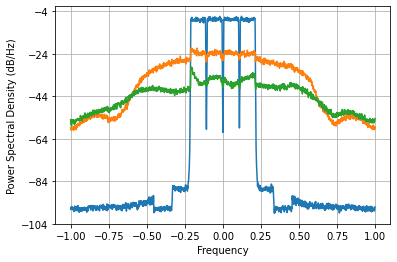

Loss =  9.32844435340059e-05 Accuracy =  -25.347308014909654 dbs


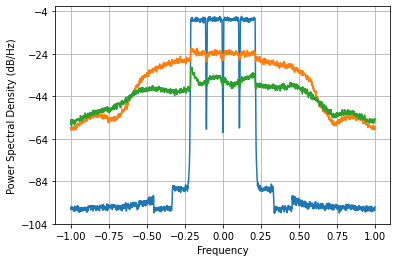

Loss =  9.285238065381348e-05 Accuracy =  -25.3674698353909 dbs


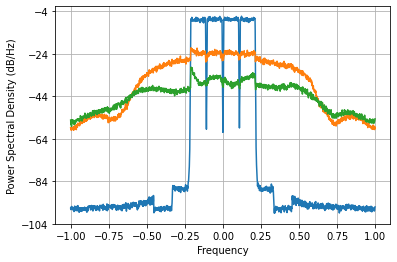

Loss =  9.24467045301545e-05 Accuracy =  -25.386485923166575 dbs


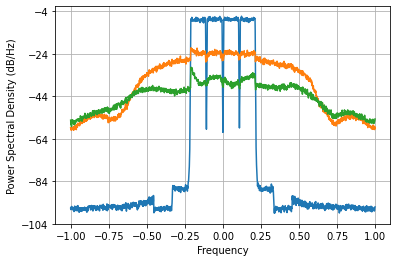

Loss =  9.206461783417952e-05 Accuracy =  -25.404472719720665 dbs


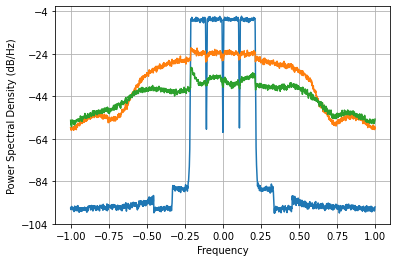

Loss =  9.170376827975279e-05 Accuracy =  -25.421528446771223 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const1, D2=const2)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist1 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


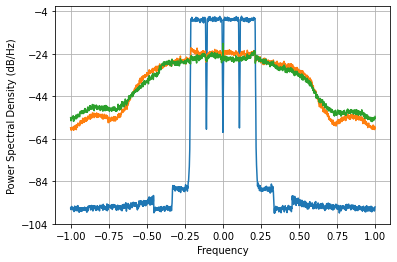

Loss =  0.0009495958782792001 Accuracy =  -15.270012057927577 dbs


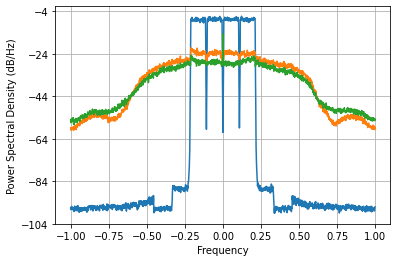

Loss =  0.0006333288676077046 Accuracy =  -17.029107427395466 dbs


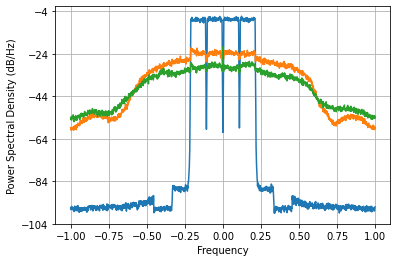

Loss =  0.00036139556069804716 Accuracy =  -19.465572132064956 dbs


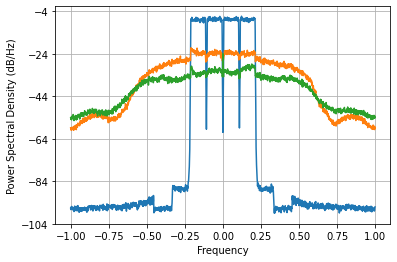

Loss =  0.00022995485996482907 Accuracy =  -21.428974341149754 dbs


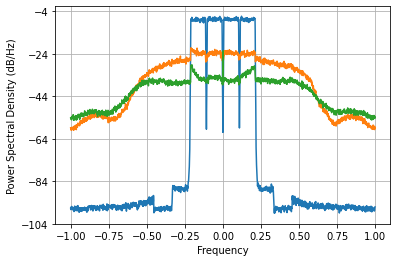

Loss =  0.0001542935272027562 Accuracy =  -23.161923194137394 dbs


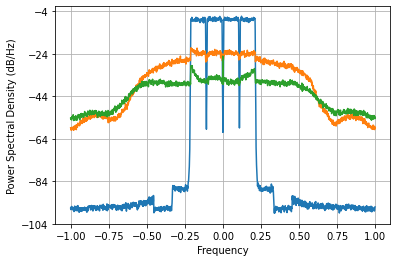

Loss =  0.00013059245559495893 Accuracy =  -23.88621938479037 dbs


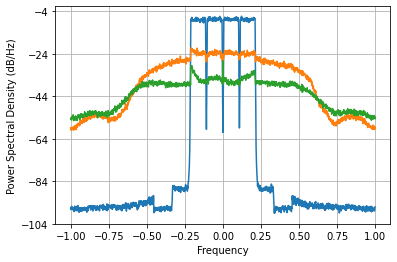

Loss =  0.0001204266526675889 Accuracy =  -24.238174116478767 dbs


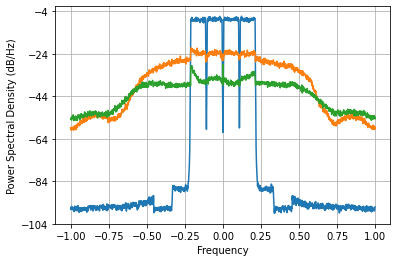

Loss =  0.00011491294190722519 Accuracy =  -24.441710834448994 dbs


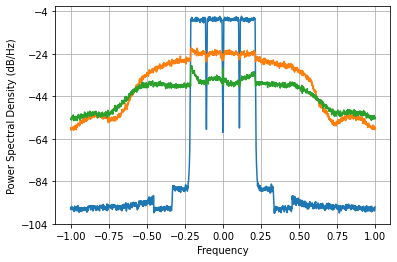

Loss =  0.00011123516658038871 Accuracy =  -24.582979171637795 dbs


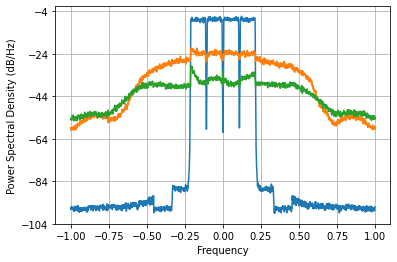

Loss =  0.00010843625980472338 Accuracy =  -24.693654972539953 dbs


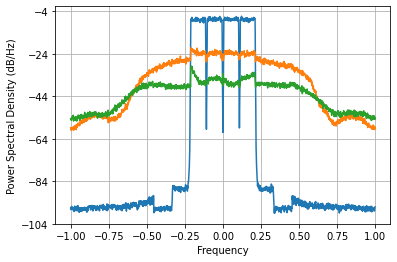

Loss =  0.00010620596011040511 Accuracy =  -24.78391137339871 dbs


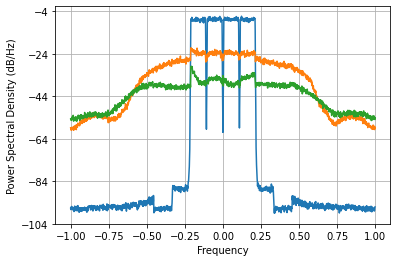

Loss =  0.00010432796467995733 Accuracy =  -24.86139291815374 dbs


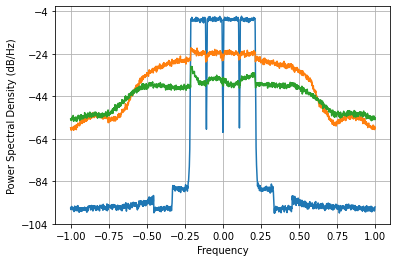

Loss =  0.0001027050072000708 Accuracy =  -24.92948409319289 dbs


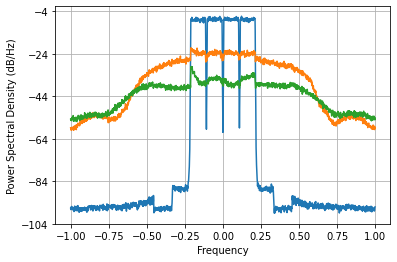

Loss =  0.00010128830203845892 Accuracy =  -24.98980735854167 dbs


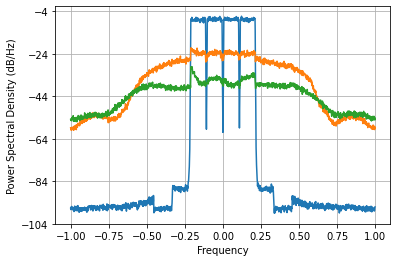

Loss =  0.0001000561393289061 Accuracy =  -25.042962850916666 dbs


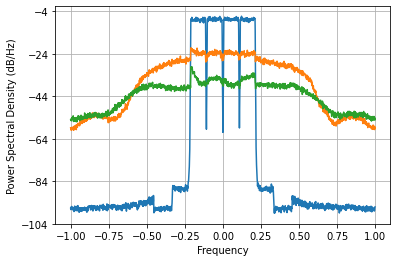

Loss =  9.898890242858083e-05 Accuracy =  -25.089535177894877 dbs


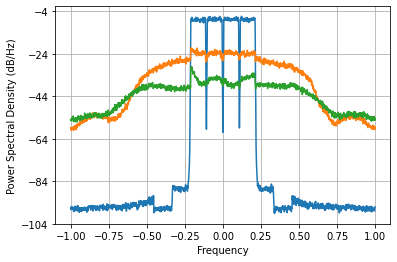

Loss =  9.805858801835016e-05 Accuracy =  -25.130543912989204 dbs


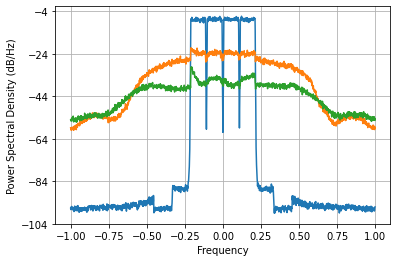

Loss =  9.723388071072444e-05 Accuracy =  -25.16722407421804 dbs


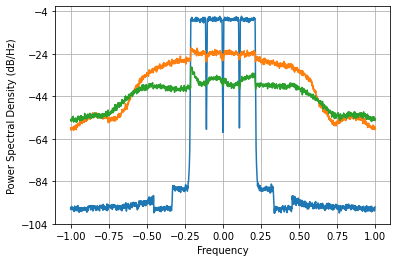

Loss =  9.648859802994074e-05 Accuracy =  -25.200640304972268 dbs


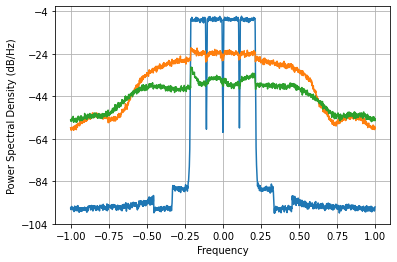

Loss =  9.580450112711851e-05 Accuracy =  -25.231541129254712 dbs


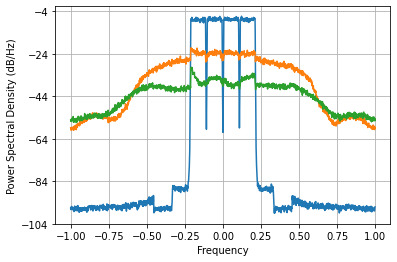

Loss =  9.516907100714143e-05 Accuracy =  -25.26044196721542 dbs


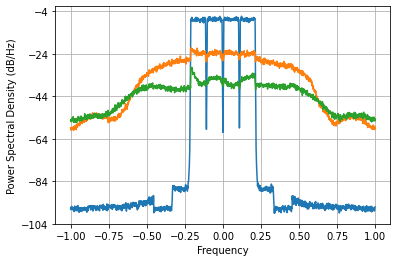

Loss =  9.457297153716566e-05 Accuracy =  -25.287729916551292 dbs


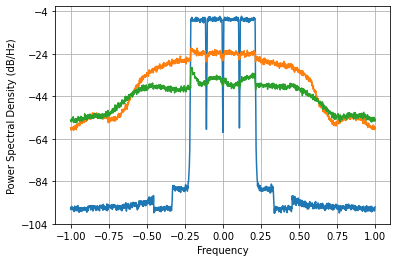

Loss =  9.400895895116153e-05 Accuracy =  -25.313707833262853 dbs


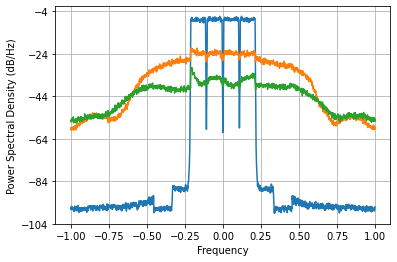

Loss =  9.347185256536893e-05 Accuracy =  -25.338591764137924 dbs


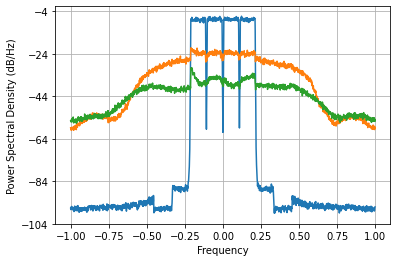

Loss =  9.295910237398624e-05 Accuracy =  -25.362481052296168 dbs


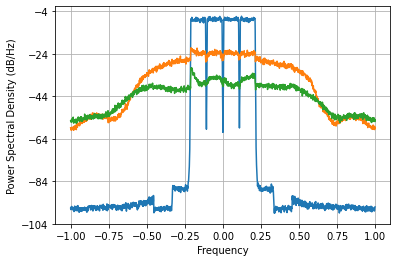

Loss =  9.247101573569532e-05 Accuracy =  -25.385343985827046 dbs


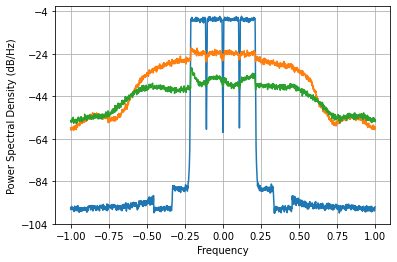

Loss =  9.200967958603592e-05 Accuracy =  -25.407065083679896 dbs


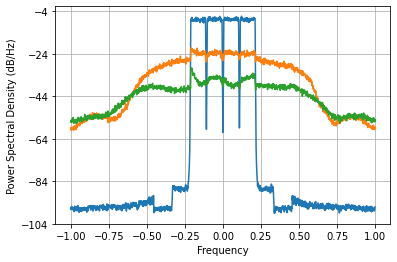

Loss =  9.157651218213231e-05 Accuracy =  -25.42755927886368 dbs


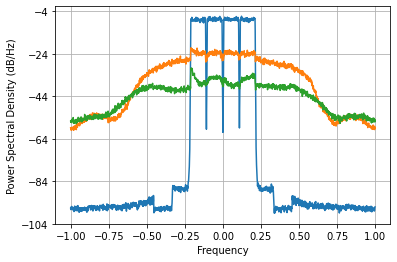

Loss =  9.116999772390556e-05 Accuracy =  -25.446880827309606 dbs


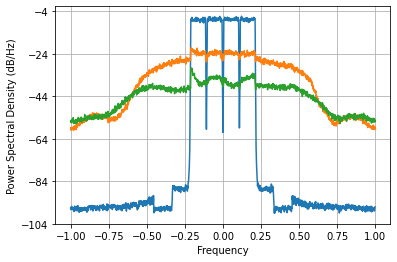

Loss =  9.078567950695203e-05 Accuracy =  -25.465226781847576 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const3, D2=const4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist2 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


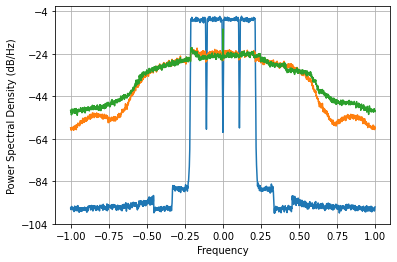

Loss =  0.0011951384219571102 Accuracy =  -14.271218181315469 dbs


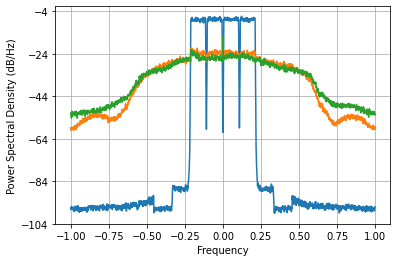

Loss =  0.000991196504999002 Accuracy =  -15.08380264658327 dbs


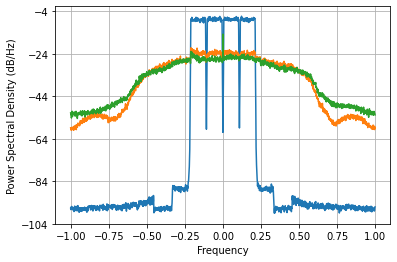

Loss =  0.0009146230073333978 Accuracy =  -15.432979048324382 dbs


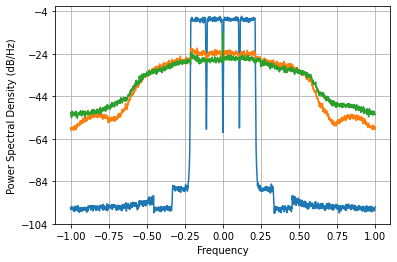

Loss =  0.0008515670254868428 Accuracy =  -15.743211904160406 dbs


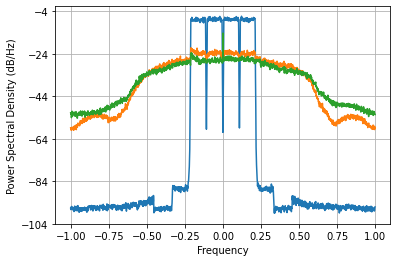

Loss =  0.0007973175380406961 Accuracy =  -16.029087096154125 dbs


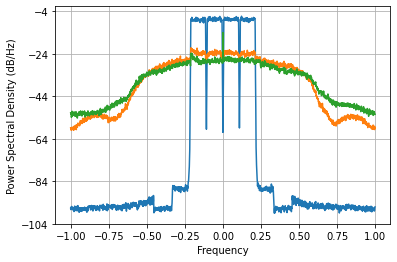

Loss =  0.0007505984517478314 Accuracy =  -16.29132362425276 dbs


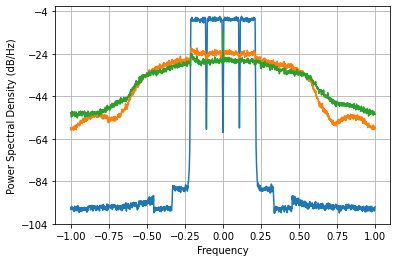

Loss =  0.0007137654550341787 Accuracy =  -16.509845016327283 dbs


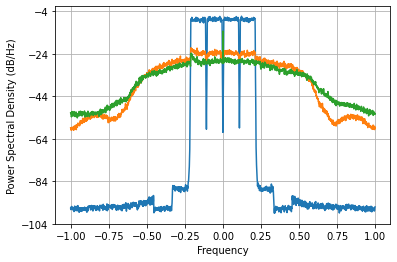

Loss =  0.000687267590225844 Accuracy =  -16.674141625084783 dbs


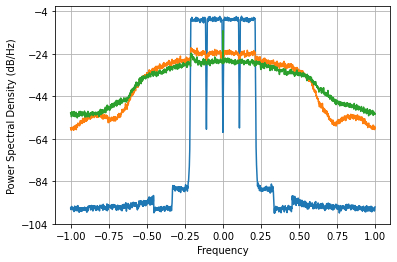

Loss =  0.0006683494403903658 Accuracy =  -16.79536437935442 dbs


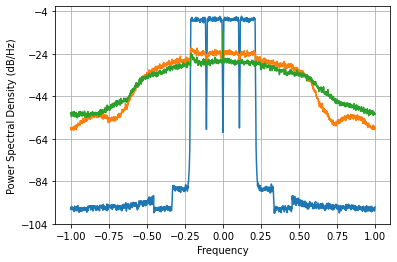

Loss =  0.0006542109535771613 Accuracy =  -16.888222153641244 dbs


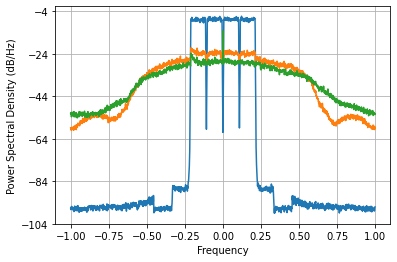

Loss =  0.000643289125918428 Accuracy =  -16.961338164872096 dbs


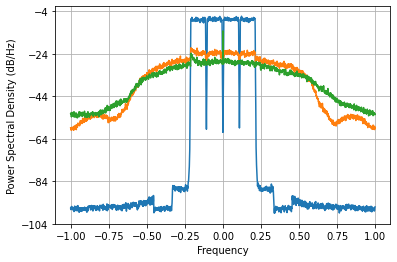

Loss =  0.0006333792530824734 Accuracy =  -17.028761931328702 dbs


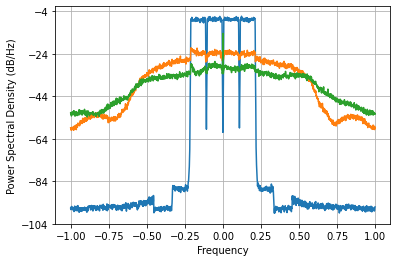

Loss =  0.0003462405084708691 Accuracy =  -19.65162149814939 dbs


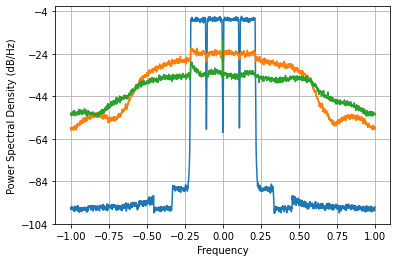

Loss =  0.00022465181120744537 Accuracy =  -21.530301023381885 dbs


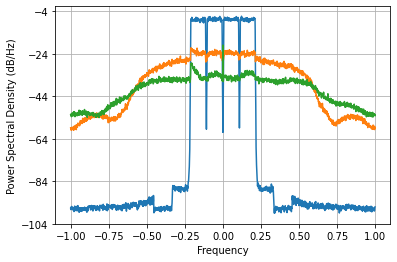

Loss =  0.00017804012809715349 Accuracy =  -22.540221286093896 dbs


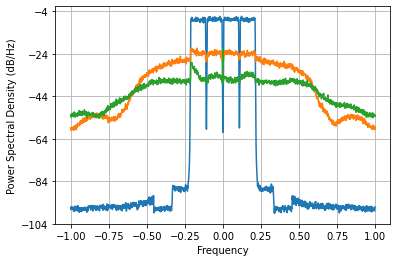

Loss =  0.00015755673941250816 Accuracy =  -23.071030420467377 dbs


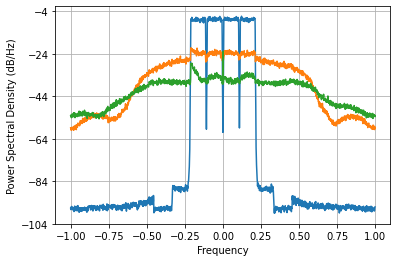

Loss =  0.00014423472986165286 Accuracy =  -23.454701812061217 dbs


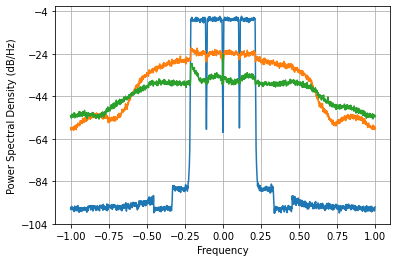

Loss =  0.00013465063380858083 Accuracy =  -23.75331624685812 dbs


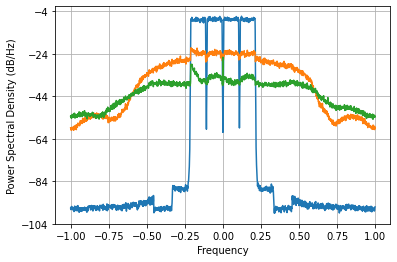

Loss =  0.00012731355524585946 Accuracy =  -23.996653806538276 dbs


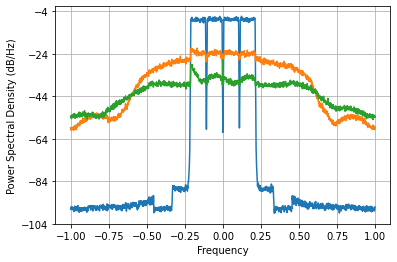

Loss =  0.00012157096576739935 Accuracy =  -24.197101599144148 dbs


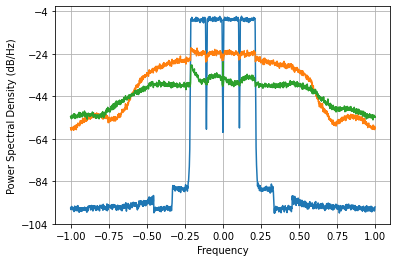

Loss =  0.0001169195150224719 Accuracy =  -24.36653021435449 dbs


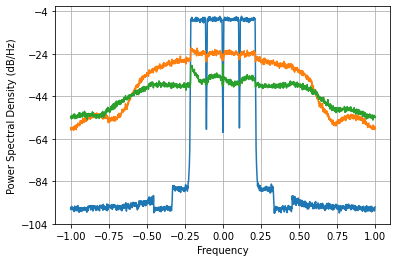

Loss =  0.00011303741800562791 Accuracy =  -24.51317797864673 dbs


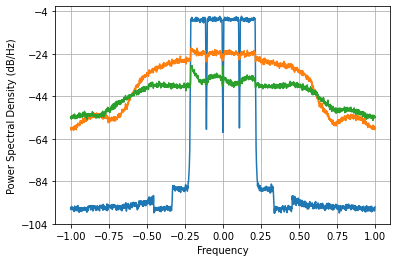

Loss =  0.00010971114893245569 Accuracy =  -24.642892635272304 dbs


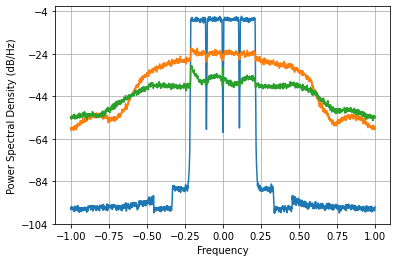

Loss =  0.0001068379894246877 Accuracy =  -24.758143202140374 dbs


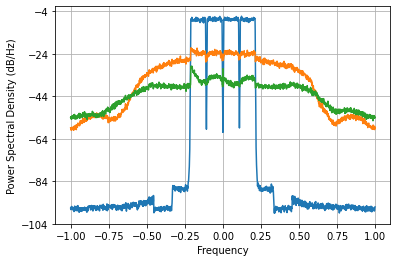

Loss =  0.00010439449849580975 Accuracy =  -24.858624143808736 dbs


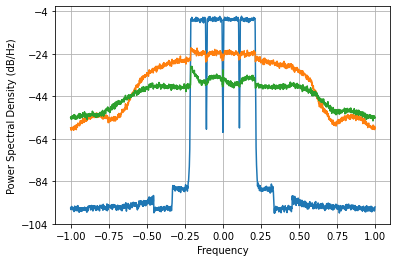

Loss =  0.0001023680168755765 Accuracy =  -24.94375736689885 dbs


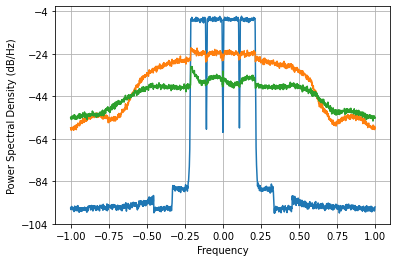

Loss =  0.00010071358819874956 Accuracy =  -25.01451957508798 dbs


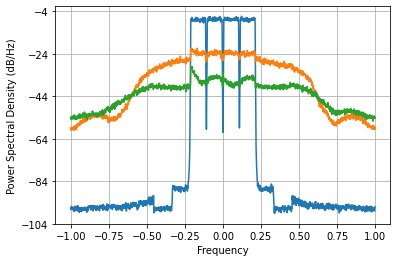

Loss =  9.936206600955321e-05 Accuracy =  -25.073194135898262 dbs


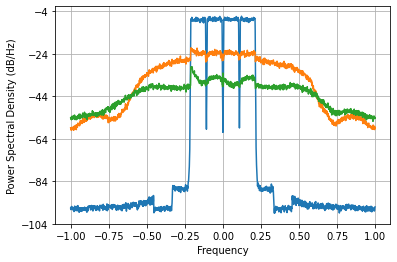

Loss =  9.824606374247126e-05 Accuracy =  -25.12224867428754 dbs


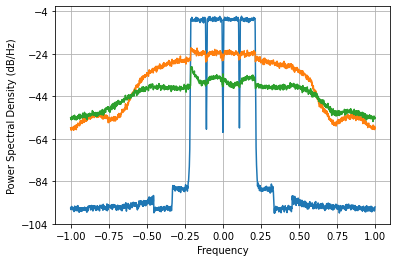

Loss =  9.731245779863069e-05 Accuracy =  -25.16371585115932 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const5, D2=const6)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist3 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


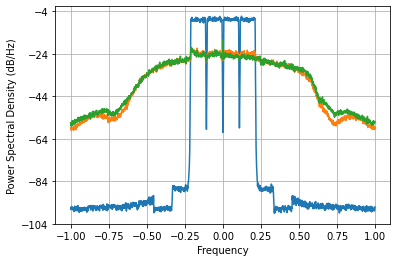

Loss =  0.001160173686273584 Accuracy =  -14.400170156133516 dbs


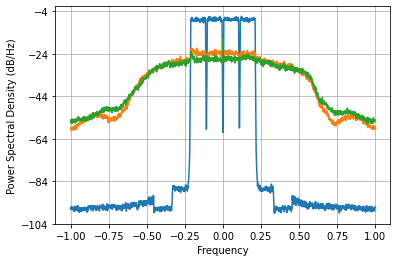

Loss =  0.0008851713339110835 Accuracy =  -15.575126857414421 dbs


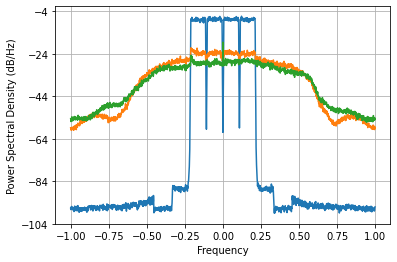

Loss =  0.0006191227159797453 Accuracy =  -17.127632878608125 dbs


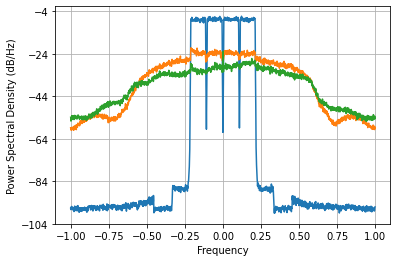

Loss =  0.00038233881311448045 Accuracy =  -19.220916390384698 dbs


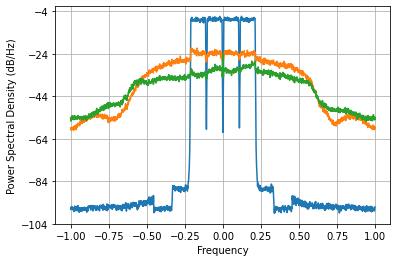

Loss =  0.0002711053060298117 Accuracy =  -20.71402009082233 dbs


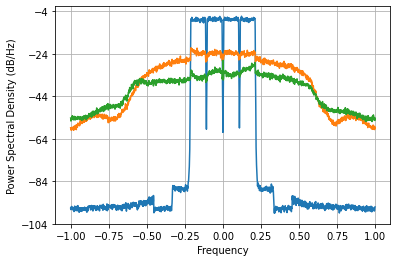

Loss =  0.0002096816255003339 Accuracy =  -21.829796519856266 dbs


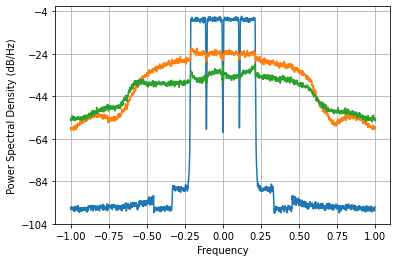

Loss =  0.0001729633393261046 Accuracy =  -22.665859652680567 dbs


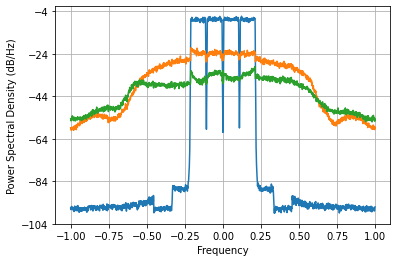

Loss =  0.00015094552618687257 Accuracy =  -23.25719781016083 dbs


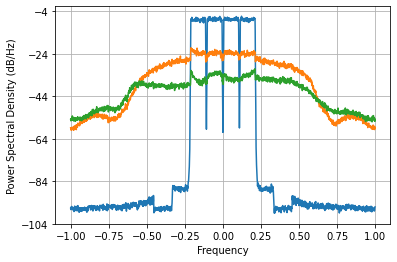

Loss =  0.0001385976682332582 Accuracy =  -23.62784102920006 dbs


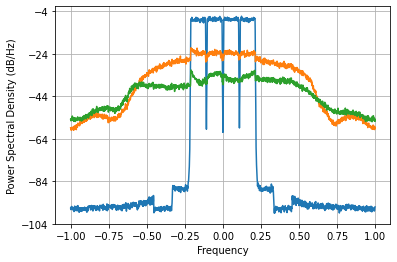

Loss =  0.0001313643383865153 Accuracy =  -23.860625438387892 dbs


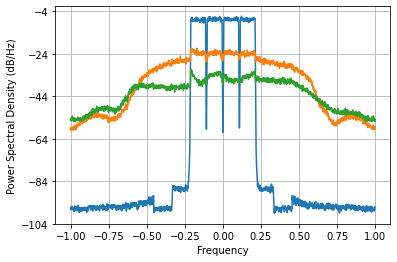

Loss =  0.00012654492260116072 Accuracy =  -24.022953021685606 dbs


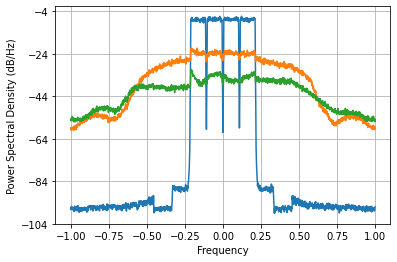

Loss =  0.00012288448825046087 Accuracy =  -24.1504296147792 dbs


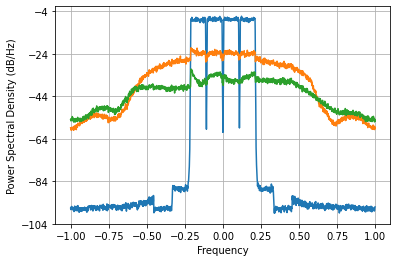

Loss =  0.000119924169682876 Accuracy =  -24.25633306457897 dbs


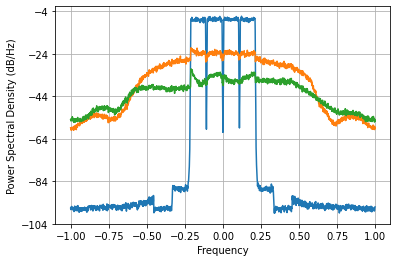

Loss =  0.0001174534177511051 Accuracy =  -24.346743679513715 dbs


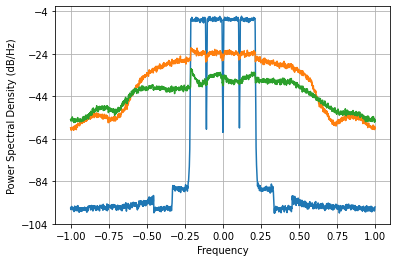

Loss =  0.00011536459040648259 Accuracy =  -24.424674982055503 dbs


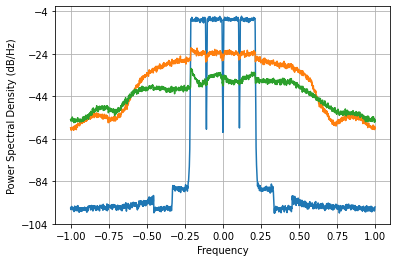

Loss =  0.00011357980588280602 Accuracy =  -24.49238904585012 dbs


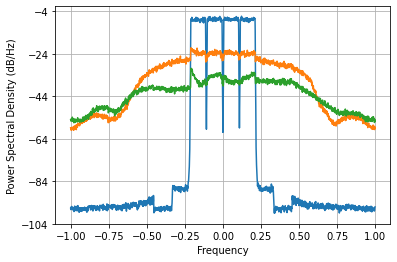

Loss =  0.0001120384606333838 Accuracy =  -24.55172893539737 dbs


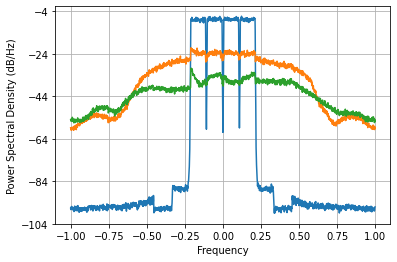

Loss =  0.00011068834014319593 Accuracy =  -24.604381517731092 dbs


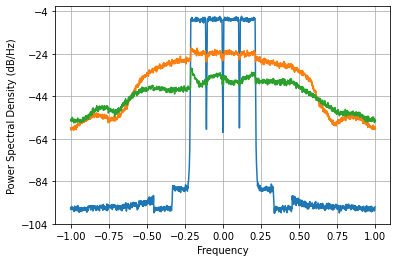

Loss =  0.00010948929226954157 Accuracy =  -24.651683781571904 dbs


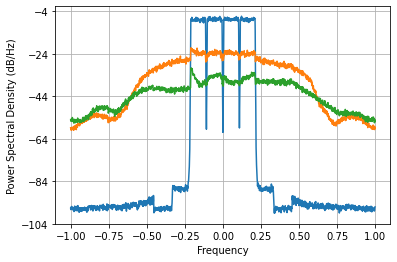

Loss =  0.00010841043310489381 Accuracy =  -24.69468947236324 dbs


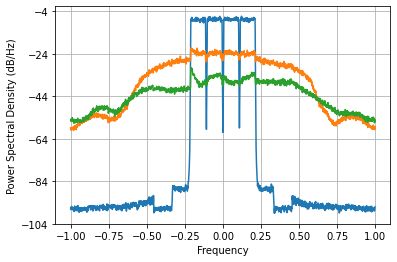

Loss =  0.00010742883839856936 Accuracy =  -24.73419146849985 dbs


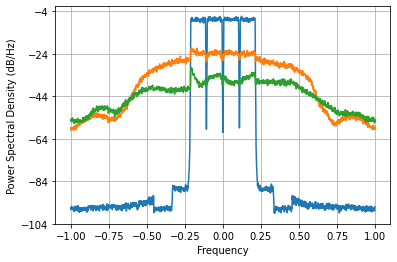

Loss =  0.00010652717520582369 Accuracy =  -24.770796157543376 dbs


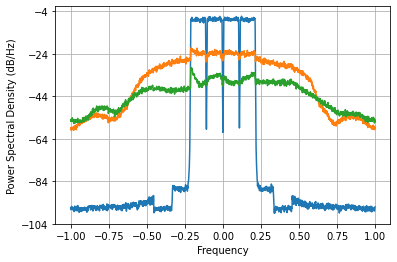

Loss =  0.00010569227828203811 Accuracy =  -24.804967671196874 dbs


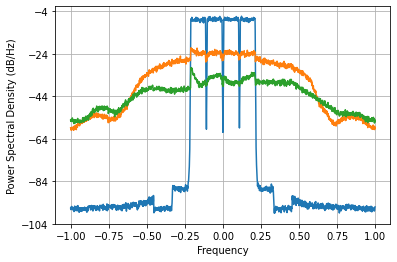

Loss =  0.00010491412938779973 Accuracy =  -24.837060456259536 dbs


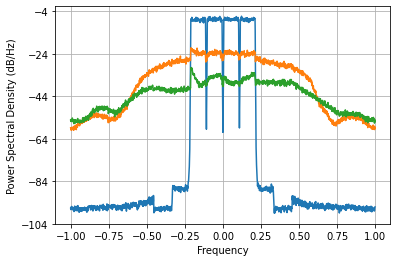

Loss =  0.00010418540237823462 Accuracy =  -24.867331533167874 dbs


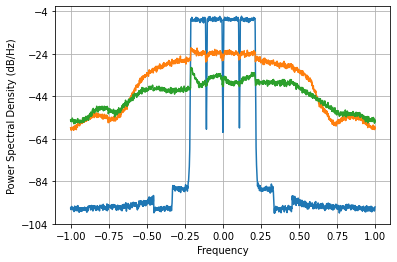

Loss =  0.00010350116745742851 Accuracy =  -24.89594778175883 dbs


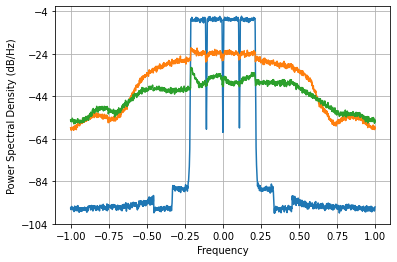

Loss =  0.00010285841518516146 Accuracy =  -24.923001981443615 dbs


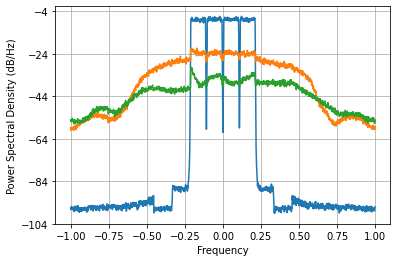

Loss =  0.00010225526159057361 Accuracy =  -24.948543626155917 dbs


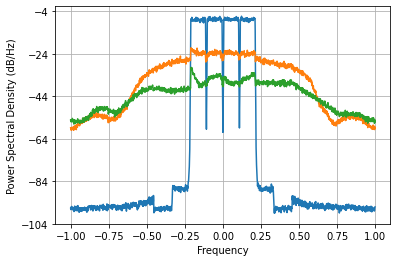

Loss =  0.00010169001134791295 Accuracy =  -24.972617308896808 dbs


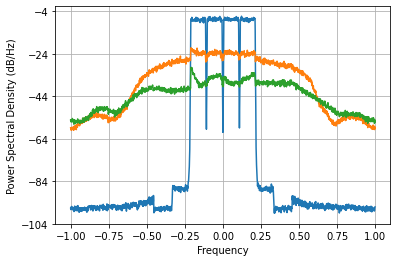

Loss =  0.00010116041380495853 Accuracy =  -24.995294294950842 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const7, D2=const8)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist4 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


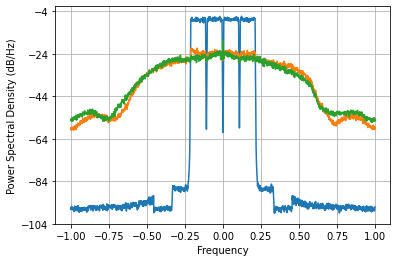

Loss =  0.0010239176656437485 Accuracy =  -14.942749907458811 dbs


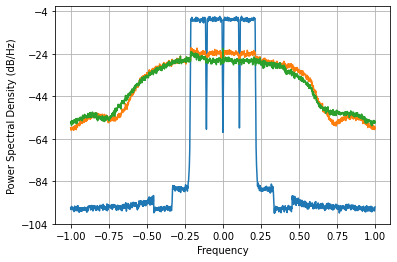

Loss =  0.0008065945578584424 Accuracy =  -15.978847392175052 dbs


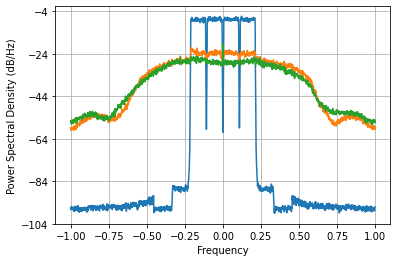

Loss =  0.0006964245537748338 Accuracy =  -16.61665952093407 dbs


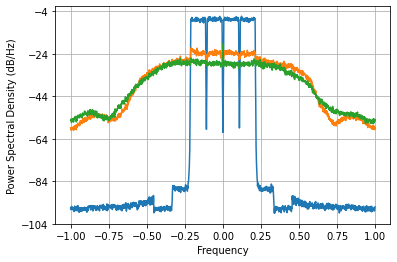

Loss =  0.00060980235028478 Accuracy =  -17.193509328088506 dbs


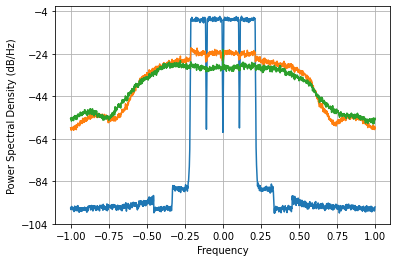

Loss =  0.0004527020568486223 Accuracy =  -18.487275589745657 dbs


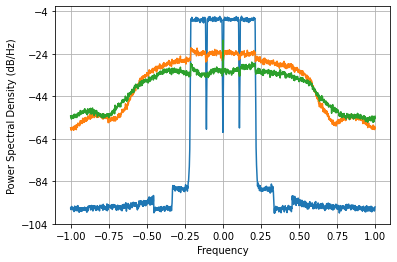

Loss =  0.00031871327241203703 Accuracy =  -20.011398771922636 dbs


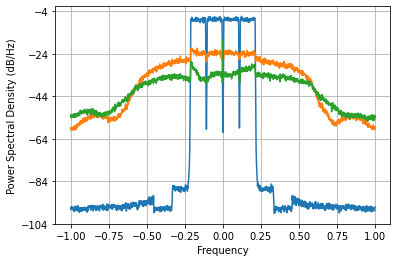

Loss =  0.00023300783022424772 Accuracy =  -21.37169510958168 dbs


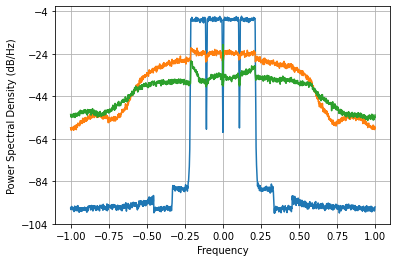

Loss =  0.00017763901686849458 Accuracy =  -22.550016657543143 dbs


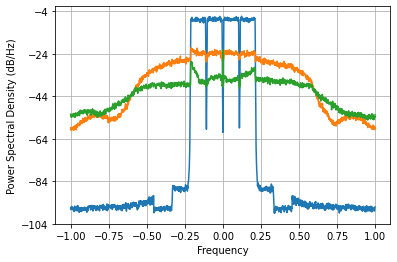

Loss =  0.00014666811216045025 Accuracy =  -23.382043246929808 dbs


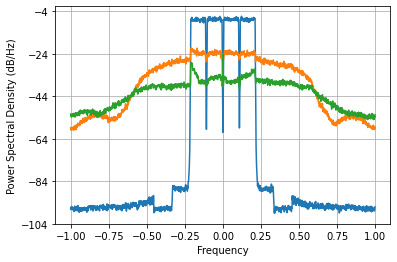

Loss =  0.00012931114259697466 Accuracy =  -23.929040775241496 dbs


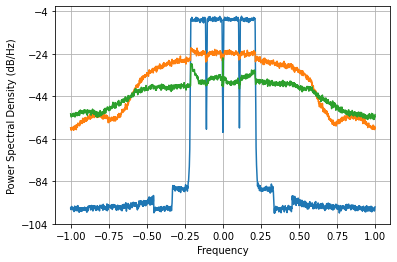

Loss =  0.000118930028048627 Accuracy =  -24.29248505380292 dbs


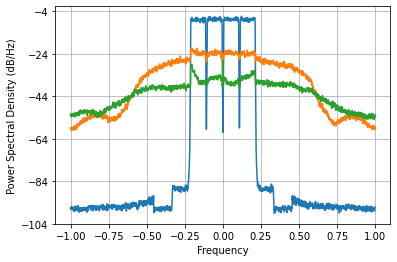

Loss =  0.00011219752315344378 Accuracy =  -24.545567570467473 dbs


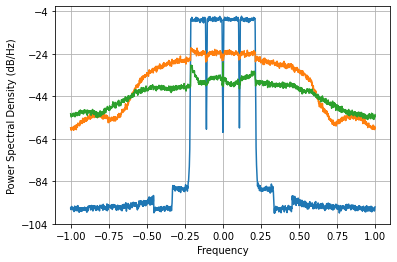

Loss =  0.00010751297623262701 Accuracy =  -24.730791422866147 dbs


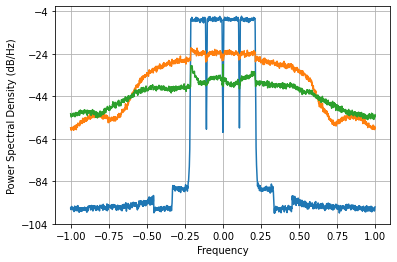

Loss =  0.00010405022151840985 Accuracy =  -24.87297017545485 dbs


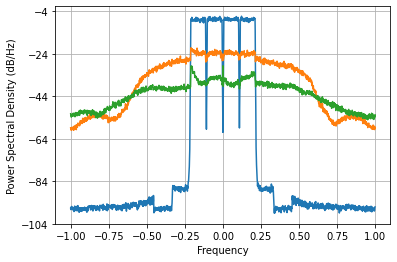

Loss =  0.00010137686661312687 Accuracy =  -24.98601162898688 dbs


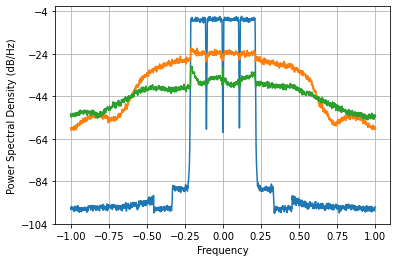

Loss =  9.926305242709836e-05 Accuracy =  -25.077524006802197 dbs


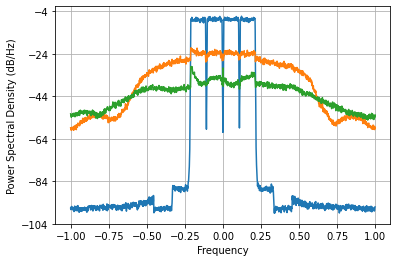

Loss =  9.757369961310513e-05 Accuracy =  -25.152072546377525 dbs


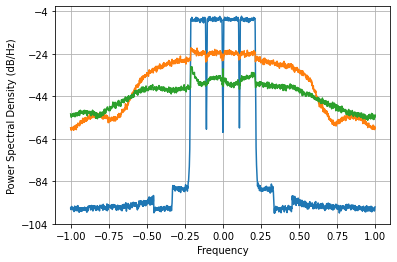

Loss =  9.621789481190908e-05 Accuracy =  -25.212841761126793 dbs


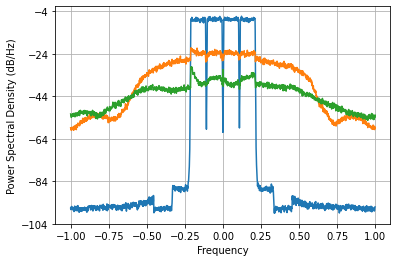

Loss =  9.512728607676864e-05 Accuracy =  -25.26234919920423 dbs


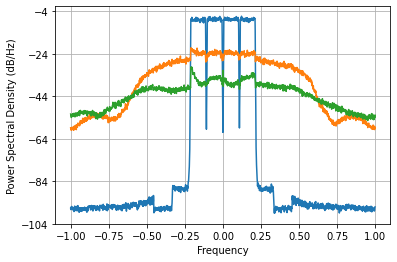

Loss =  9.424793302872322e-05 Accuracy =  -25.302681923097495 dbs


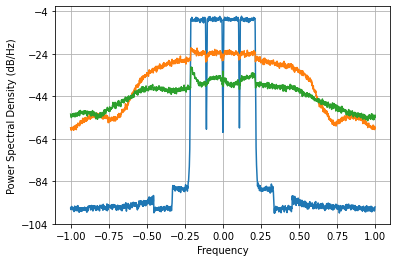

Loss =  9.353678251777996e-05 Accuracy =  -25.335575997388663 dbs


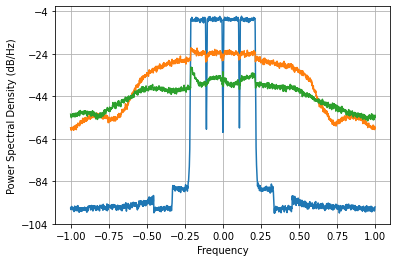

Loss =  9.295918448622712e-05 Accuracy =  -25.36247721610622 dbs


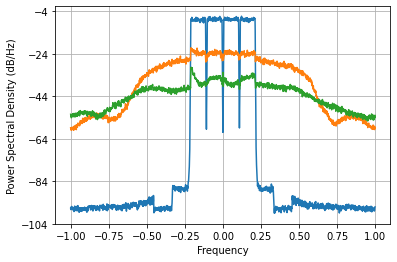

Loss =  9.2486782662194e-05 Accuracy =  -25.38460354781893 dbs


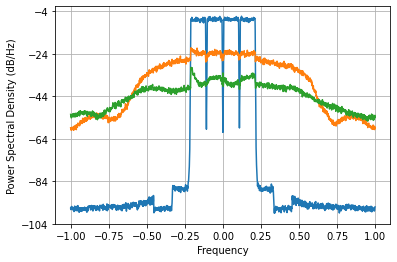

Loss =  9.209597711935325e-05 Accuracy =  -25.402993666653696 dbs


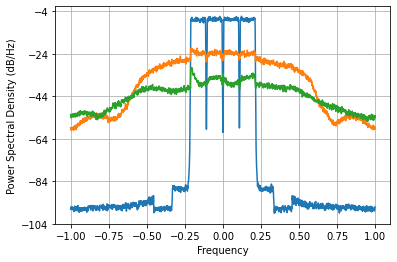

Loss =  9.17670309434599e-05 Accuracy =  -25.41853346043403 dbs


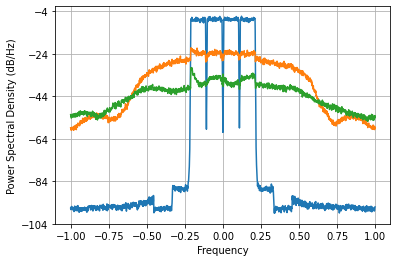

Loss =  9.148369160660619e-05 Accuracy =  -25.431963454799078 dbs


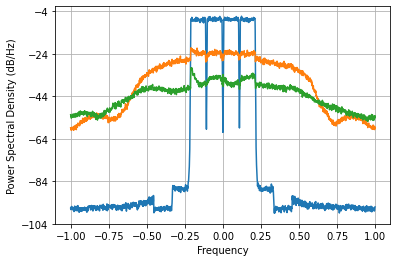

Loss =  9.12330479819331e-05 Accuracy =  -25.4438784234705 dbs


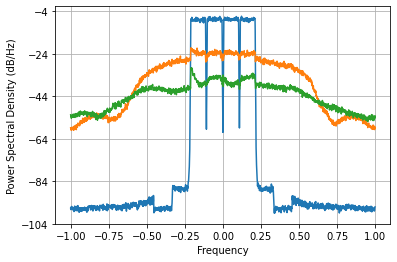

Loss =  9.100532504357758e-05 Accuracy =  -25.454732215168114 dbs


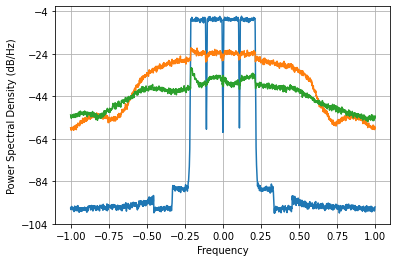

Loss =  9.079347302683917e-05 Accuracy =  -25.464853976639887 dbs


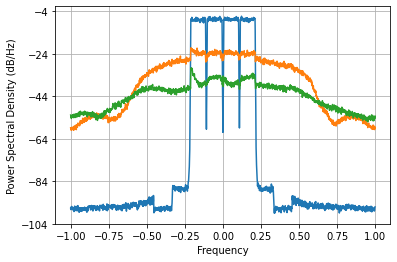

Loss =  9.059260644999458e-05 Accuracy =  -25.474472717155564 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const9, D2=const10)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist5 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


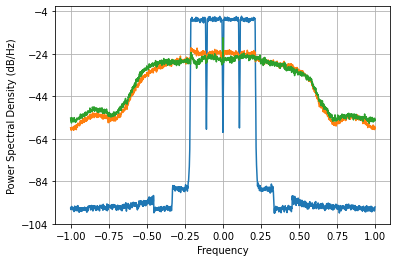

Loss =  0.0009896209879705765 Accuracy =  -15.090711294132182 dbs


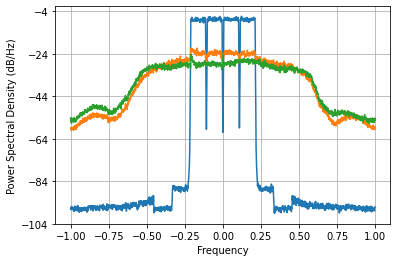

Loss =  0.0006619950945232436 Accuracy =  -16.83685255419804 dbs


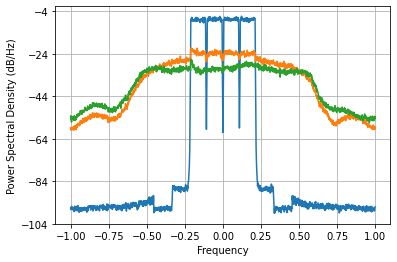

Loss =  0.00044137289342621836 Accuracy =  -18.597343689022466 dbs


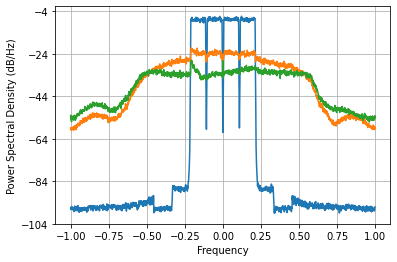

Loss =  0.00030665242411843143 Accuracy =  -20.178936245093443 dbs


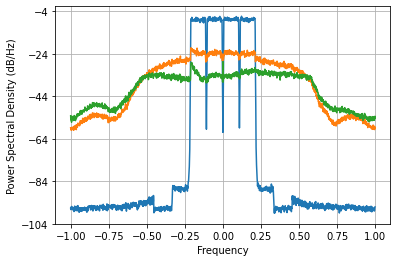

Loss =  0.0002385311084695438 Accuracy =  -21.269950003114992 dbs


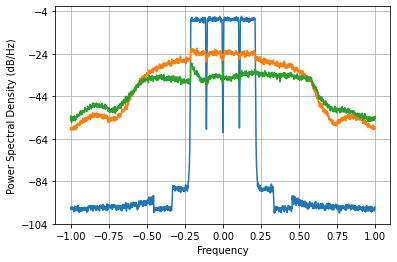

Loss =  0.0002013342944319645 Accuracy =  -22.006222696137403 dbs


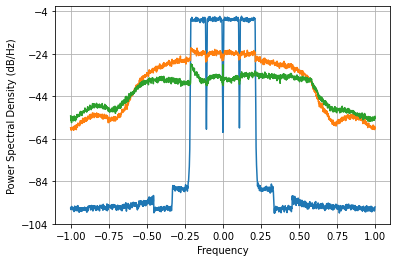

Loss =  0.00017595498826139145 Accuracy =  -22.591384432482645 dbs


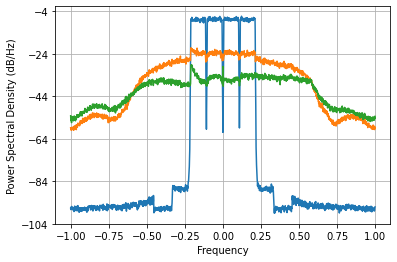

Loss =  0.00015735021611446118 Accuracy =  -23.07672682951843 dbs


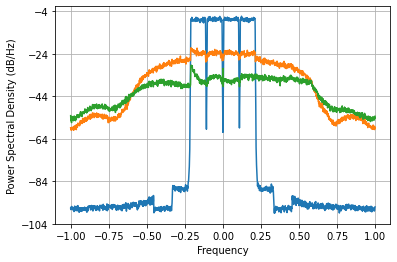

Loss =  0.00014348413717379883 Accuracy =  -23.477361362013973 dbs


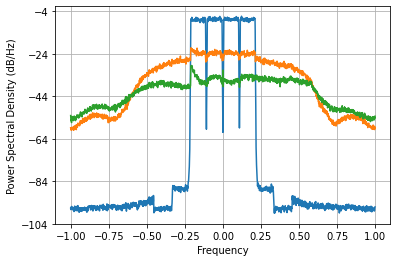

Loss =  0.00013308662663728715 Accuracy =  -23.804056096014754 dbs


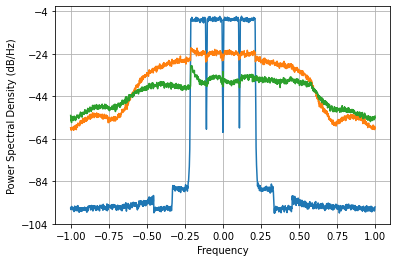

Loss =  0.00012525721720441795 Accuracy =  -24.06737267783672 dbs


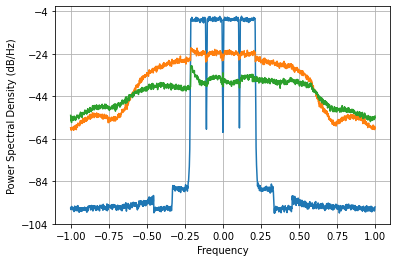

Loss =  0.00011934137028583685 Accuracy =  -24.27749006552361 dbs


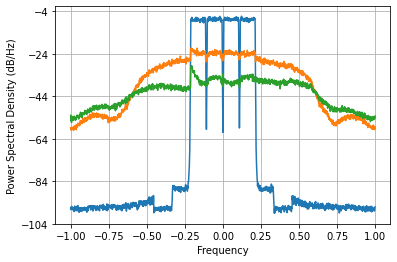

Loss =  0.0001148321650987226 Accuracy =  -24.444764733972786 dbs


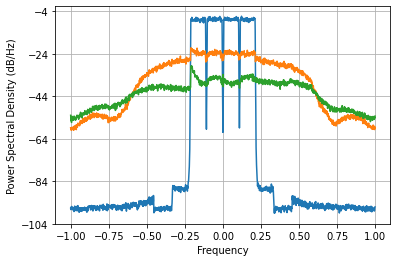

Loss =  0.00011134619858621641 Accuracy =  -24.57864632091516 dbs


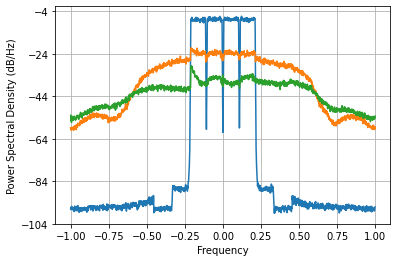

Loss =  0.00010860510968805543 Accuracy =  -24.686897681285632 dbs


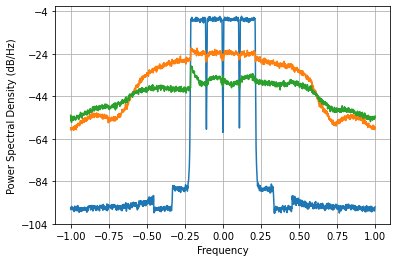

Loss =  0.00010641183213132967 Accuracy =  -24.775501060257458 dbs


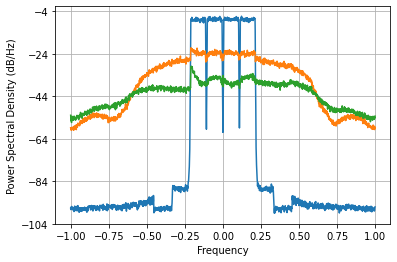

Loss =  0.0001046275897583403 Accuracy =  -24.84893805829457 dbs


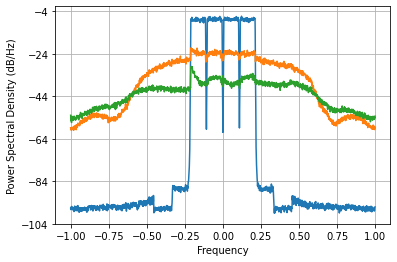

Loss =  0.00010315451587559818 Accuracy =  -24.910517815150442 dbs


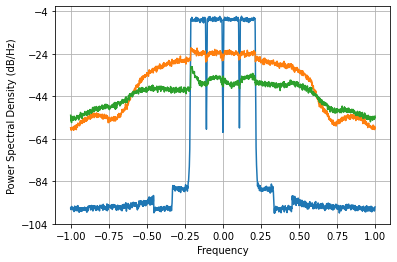

Loss =  0.00010192184639905198 Accuracy =  -24.962727440197988 dbs


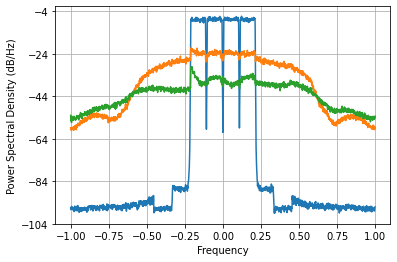

Loss =  0.0001008767266407695 Accuracy =  -25.007490453606774 dbs


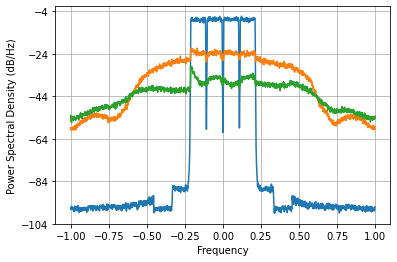

Loss =  9.998005463057772e-05 Accuracy =  -25.046266569666834 dbs


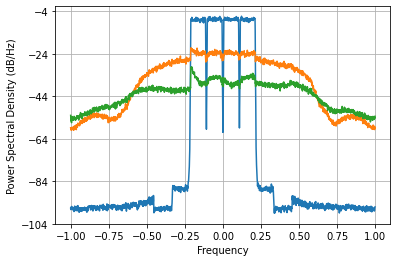

Loss =  9.920262679764053e-05 Accuracy =  -25.080168546488096 dbs


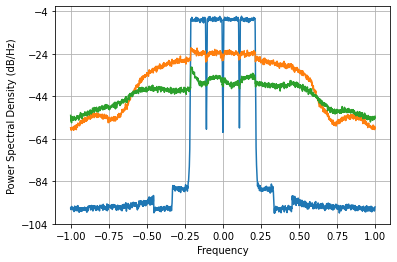

Loss =  9.852147643246171e-05 Accuracy =  -25.110091151810714 dbs


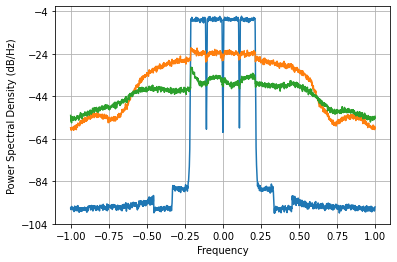

Loss =  9.79179780322377e-05 Accuracy =  -25.13677589804521 dbs


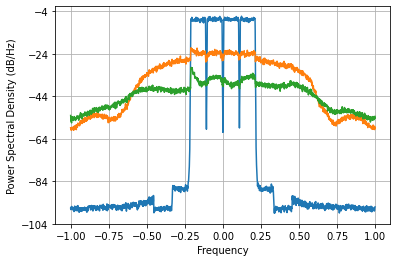

Loss =  9.737700366889509e-05 Accuracy =  -25.16083619695501 dbs


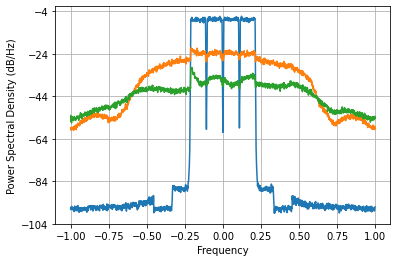

Loss =  9.688621706453844e-05 Accuracy =  -25.18278027538047 dbs


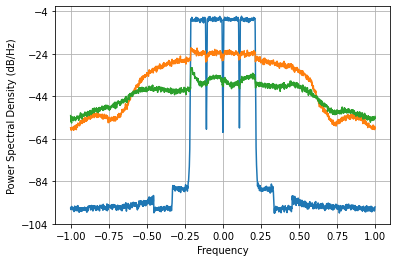

Loss =  9.643531728254038e-05 Accuracy =  -25.203039129932712 dbs


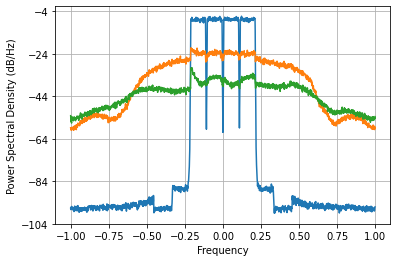

Loss =  9.601545892442455e-05 Accuracy =  -25.221988646374726 dbs


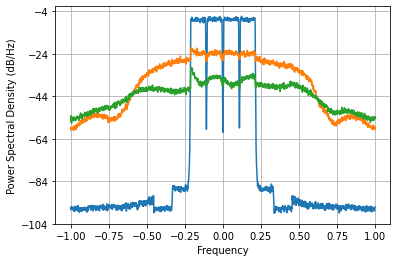

Loss =  9.561900181218912e-05 Accuracy =  -25.239958210005092 dbs


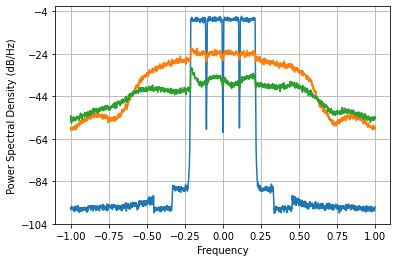

Loss =  9.523953489845744e-05 Accuracy =  -25.257227608240058 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const11, D2=const12)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist6 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


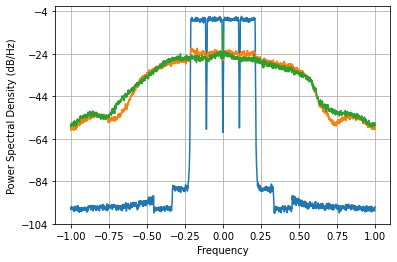

Loss =  0.0010332211704570232 Accuracy =  -14.90346730504735 dbs


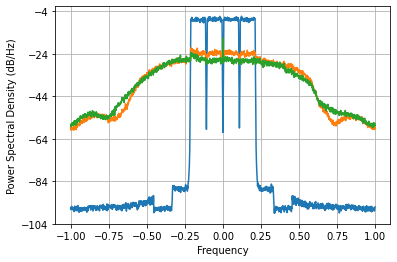

Loss =  0.0008338016567723656 Accuracy =  -15.834772729495503 dbs


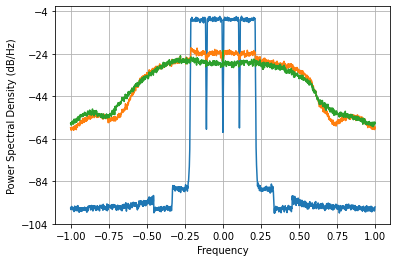

Loss =  0.0006662506117689568 Accuracy =  -16.80902405872728 dbs


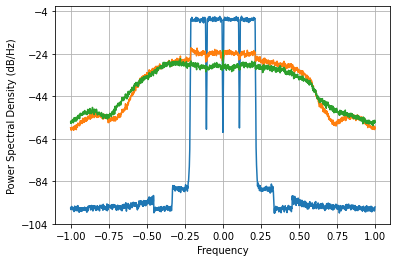

Loss =  0.000503560491929855 Accuracy =  -18.024883775517132 dbs


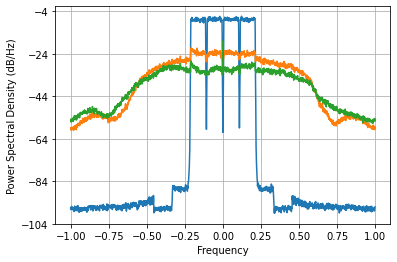

Loss =  0.000381048469467214 Accuracy =  -19.23559805124661 dbs


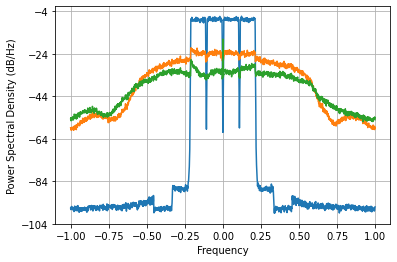

Loss =  0.0002985851283330384 Accuracy =  -20.29471853720326 dbs


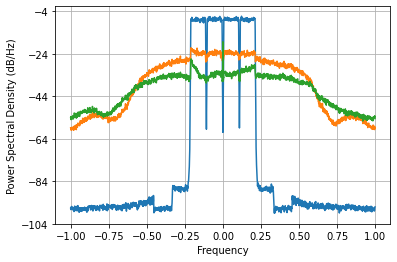

Loss =  0.0002397111329492292 Accuracy =  -21.248518221658877 dbs


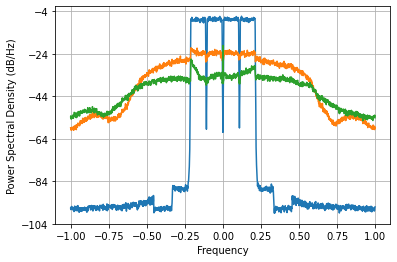

Loss =  0.00019837735639016433 Accuracy =  -22.070479282048893 dbs


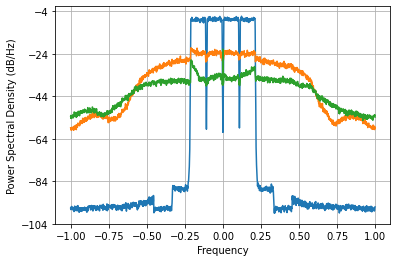

Loss =  0.0001701385660837799 Accuracy =  -22.737372584081733 dbs


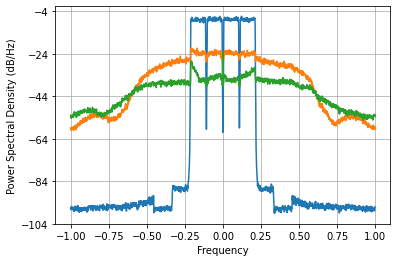

Loss =  0.00015084059930037114 Accuracy =  -23.260217774685273 dbs


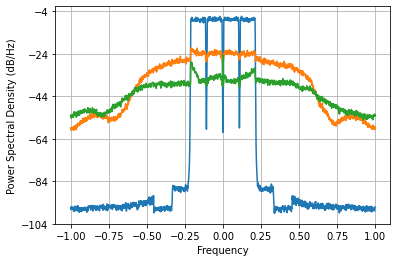

Loss =  0.00013731862775494011 Accuracy =  -23.668105718808896 dbs


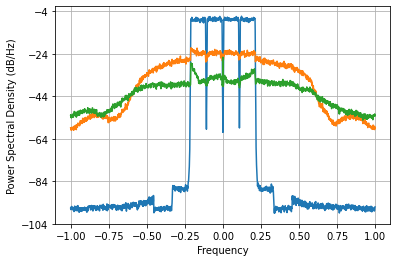

Loss =  0.000127630030588677 Accuracy =  -23.98587153365288 dbs


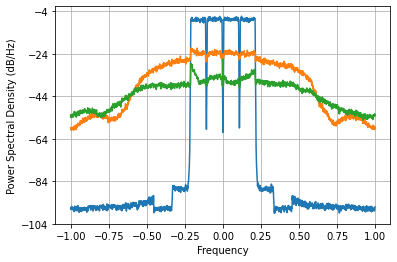

Loss =  0.00012050770317722664 Accuracy =  -24.235252176160586 dbs


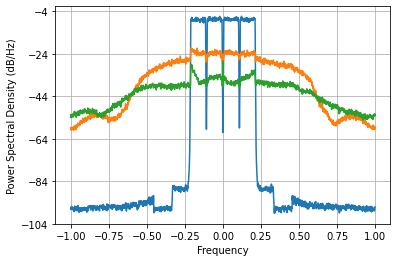

Loss =  0.00011513107818758058 Accuracy =  -24.43347454895754 dbs


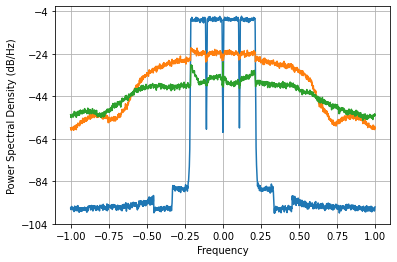

Loss =  0.00011095518674214402 Accuracy =  -24.593924179945507 dbs


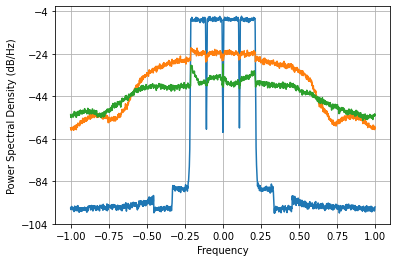

Loss =  0.00010762812359956955 Accuracy =  -24.72614257883933 dbs


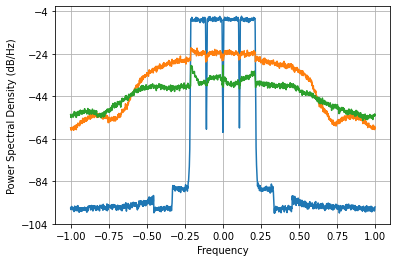

Loss =  0.00010492463007321672 Accuracy =  -24.836625799692907 dbs


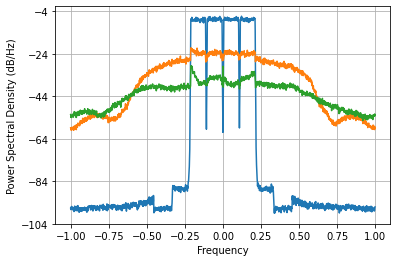

Loss =  0.00010269936355309869 Accuracy =  -24.929722744856377 dbs


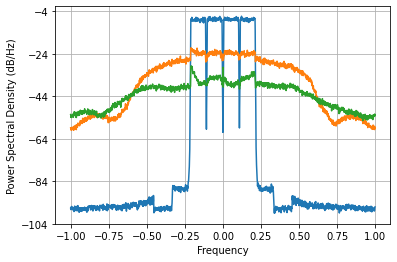

Loss =  0.00010085448956099653 Accuracy =  -25.00844790989539 dbs


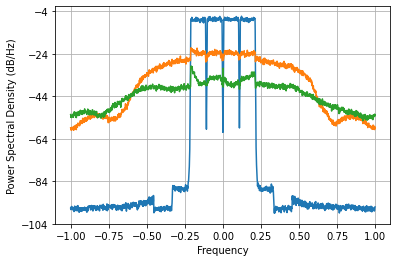

Loss =  9.931973858073321e-05 Accuracy =  -25.075044589097605 dbs


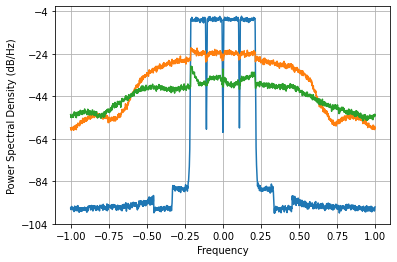

Loss =  9.804077261542081e-05 Accuracy =  -25.13133301614399 dbs


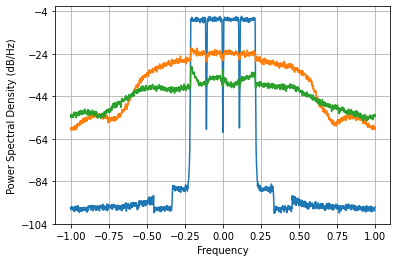

Loss =  9.697315076181835e-05 Accuracy =  -25.17888520154687 dbs


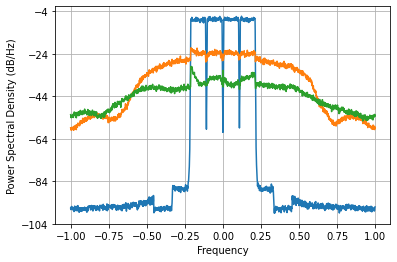

Loss =  9.607998886768504e-05 Accuracy =  -25.219070826129446 dbs


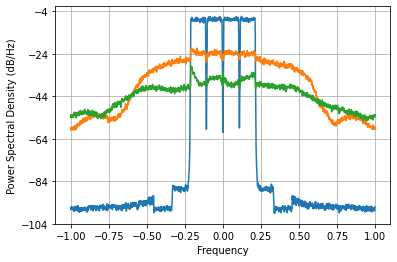

Loss =  9.533151563108838e-05 Accuracy =  -25.253035289667633 dbs


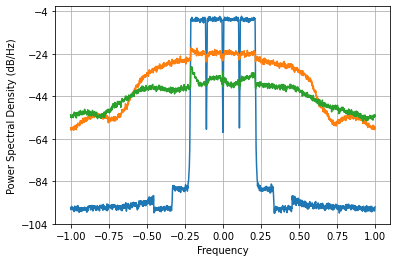

Loss =  9.470443543880892e-05 Accuracy =  -25.281697072257174 dbs


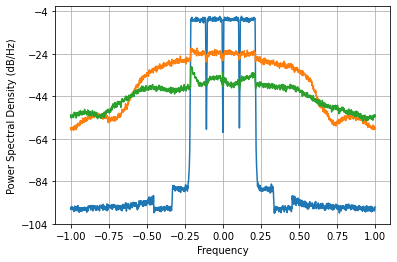

Loss =  9.417959911820365e-05 Accuracy =  -25.305831891812613 dbs


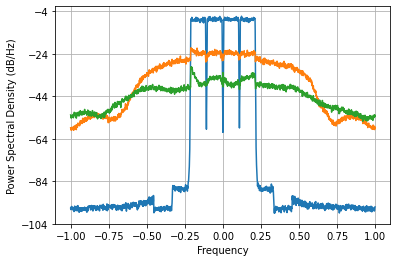

Loss =  9.37388425010218e-05 Accuracy =  -25.326204401936394 dbs


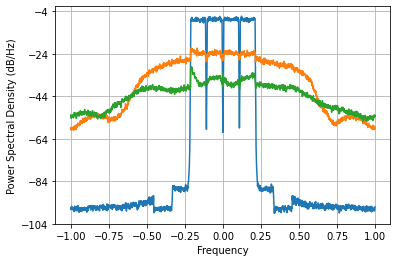

Loss =  9.336393399510262e-05 Accuracy =  -25.343608837755 dbs


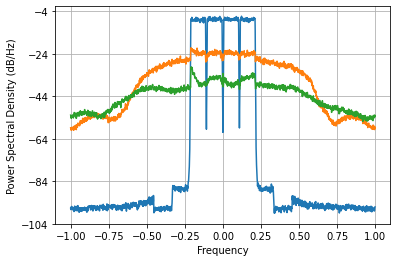

Loss =  9.303861450454928e-05 Accuracy =  -25.358767922669525 dbs


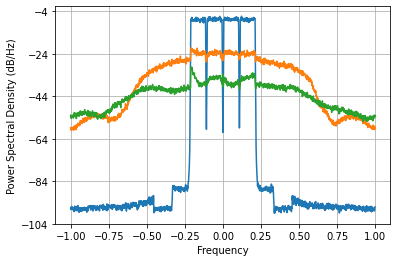

Loss =  9.275073102409846e-05 Accuracy =  -25.372226854525696 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const13, D2=const14)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist7 = train(train_queue, valid_queue, net, loss_fn, optimizer,30,scheduler,save_flag=False)

In [ ]:
def Comparison_results(hist1, hist2, number, const1, const2):
    print("number =", number, "   delays:", const1, const2)
    fig, ax = plt.subplots()
    ax.plot(hist1['iter'], hist1['train_loss_db'], label='Maslovski')
    ax.plot(hist2['iter'], hist2['train_loss_db'], label='Bred')
    ax.set_xlabel('iter')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of two types of cells: iter')
    ax.legend()
    plt.show()

    fig, ax = plt.subplots()
    ax.plot(hist1['time'], hist1['train_loss_db'], label='Maslovski')
    ax.plot(hist2['time'], hist2['train_loss_db'], label='Bred')
    ax.set_xlabel('time')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of two types of cells: time')
    ax.legend()
    plt.show()

    


In [ ]:
def Comparison_best_res(hist1, hist2, hist3):
    #print("M_delays =", m)
    #print("Br_delays =", b1, b2)
    #print("Ol_delays =", ol)
    fig, ax = plt.subplots()
    ax.plot(hist1['iter'], hist1['train_loss_db'], label='Ol_v1')
    ax.plot(hist2['iter'], hist2['train_loss_db'], label='Masl_poly10')
    ax.plot(hist3['iter'], hist3['train_loss_db'], label='Masl_upd')
    ax.set_xlabel('iter')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of three types of cells: iter')
    ax.legend()
    plt.show()

    fig, ax = plt.subplots()
    ax.plot(hist1['time'], hist1['train_loss_db'], label='Ol_v1')
    ax.plot(hist2['time'], hist2['train_loss_db'], label='Masl_poly10')
    ax.plot(hist3['time'], hist3['train_loss_db'], label='Masl_upd')
    ax.set_xlabel('time')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of three types of cells: time')
    ax.legend()
    plt.show()

number = 1    delays: 5 -2


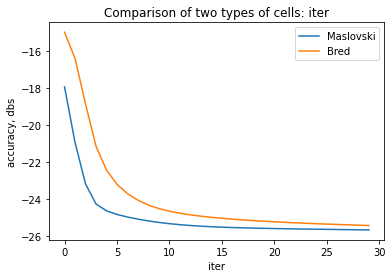

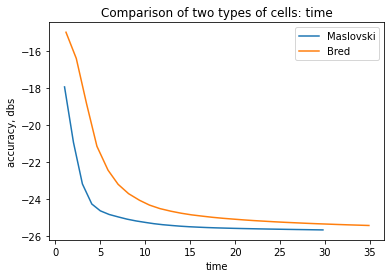

In [ ]:
Comparison_results(hist, hist1, 1, const1, const2)

number = 2    delays: -1 3


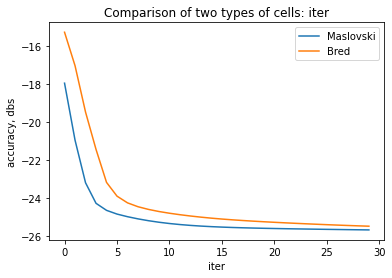

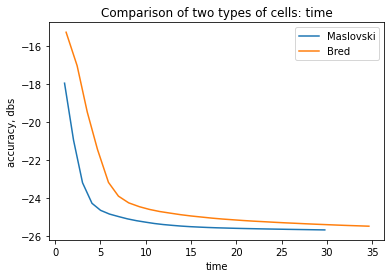

In [ ]:
Comparison_results(hist, hist2, 2, const3, const4)

number = 3    delays: 4 4


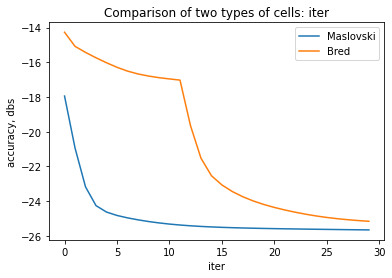

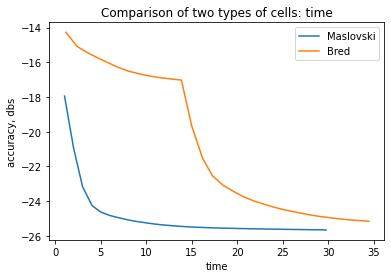

In [ ]:
Comparison_results(hist, hist3, 3, const5, const6)

number = 4    delays: -7 7


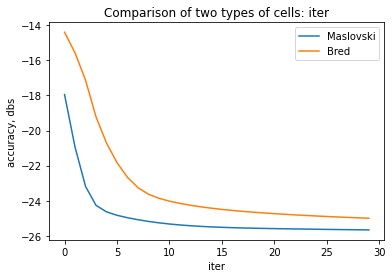

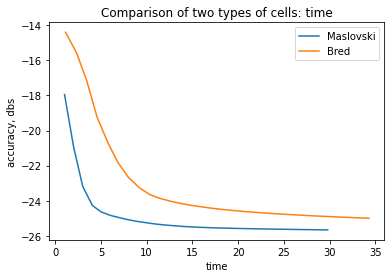

In [ ]:
Comparison_results(hist, hist4, 4, const7, const8)

number = 5    delays: 0 -3


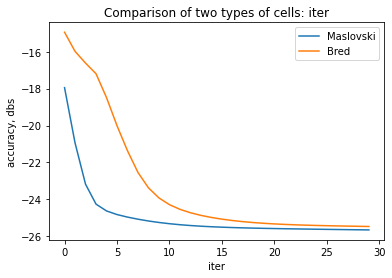

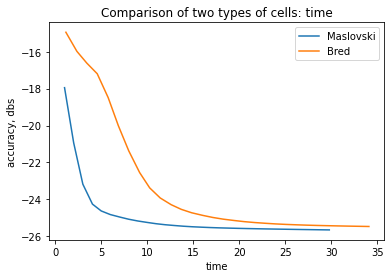

In [ ]:
Comparison_results(hist, hist5, 5, const9, const10)

number = 6    delays: 5 2


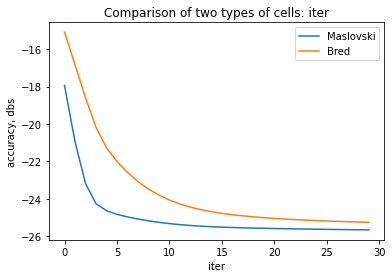

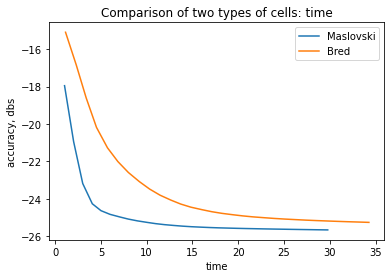

In [ ]:
Comparison_results(hist, hist6, 6, const11, const12)

number = 7    delays: -3 -1


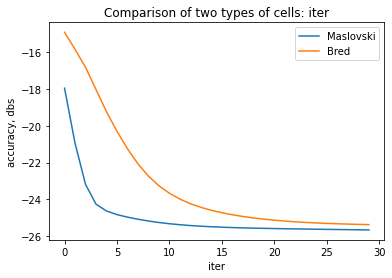

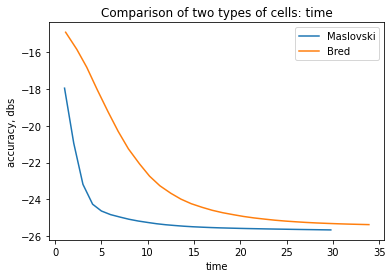

In [ ]:
Comparison_results(hist, hist7, 7, const13, const14)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


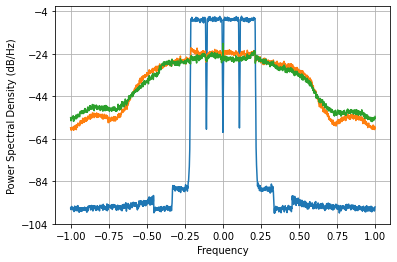

Loss =  0.0009495958782792004 Accuracy =  -15.270012057927577 dbs


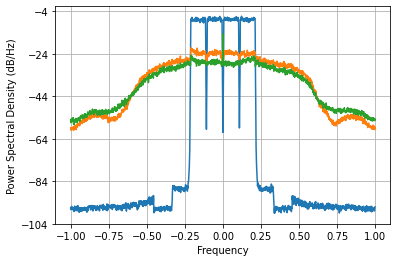

Loss =  0.0006333288676077045 Accuracy =  -17.029107427395466 dbs


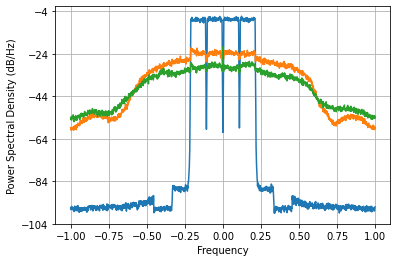

Loss =  0.00036139556069804716 Accuracy =  -19.465572132064956 dbs


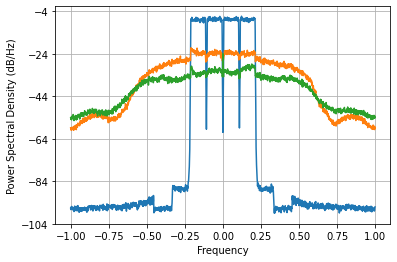

Loss =  0.00022995485996482907 Accuracy =  -21.428974341149754 dbs


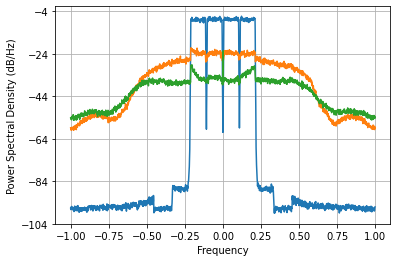

Loss =  0.0001542935272027562 Accuracy =  -23.161923194137394 dbs


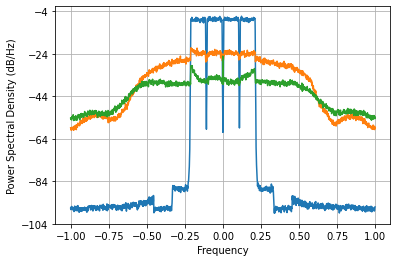

Loss =  0.00013059245559495893 Accuracy =  -23.88621938479037 dbs


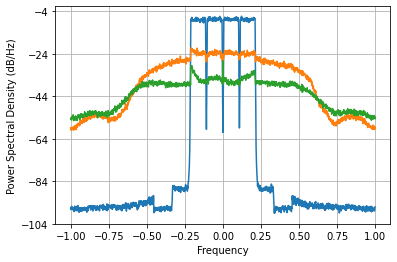

Loss =  0.0001204266526675889 Accuracy =  -24.238174116478767 dbs


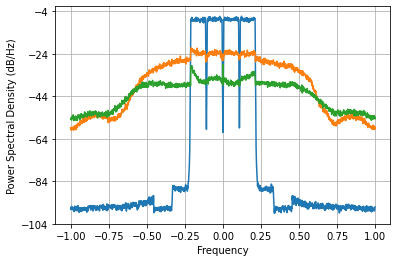

Loss =  0.00011491294190722519 Accuracy =  -24.441710834448994 dbs


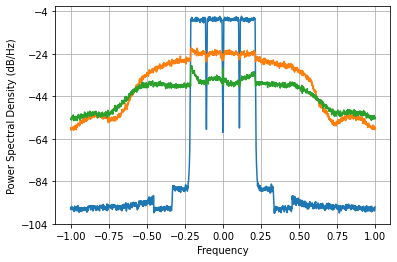

Loss =  0.00011123516658038871 Accuracy =  -24.582979171637795 dbs


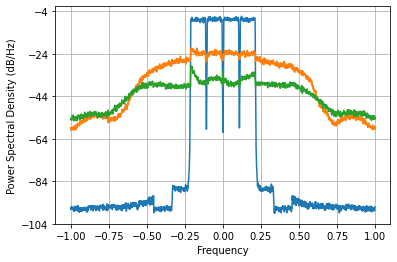

Loss =  0.00010843625980472338 Accuracy =  -24.693654972539953 dbs


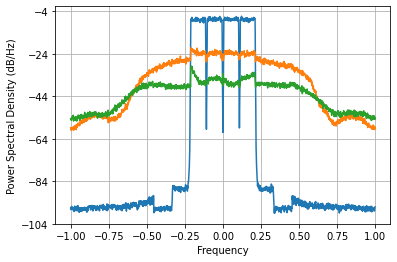

Loss =  0.00010620596011040511 Accuracy =  -24.78391137339871 dbs


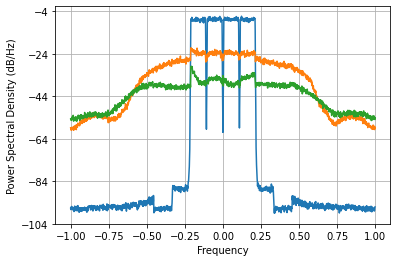

Loss =  0.00010432796467995733 Accuracy =  -24.86139291815374 dbs


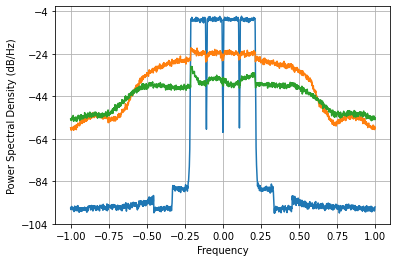

Loss =  0.0001027050072000708 Accuracy =  -24.92948409319289 dbs


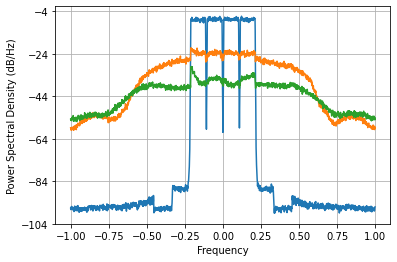

Loss =  0.00010128830203845892 Accuracy =  -24.98980735854167 dbs


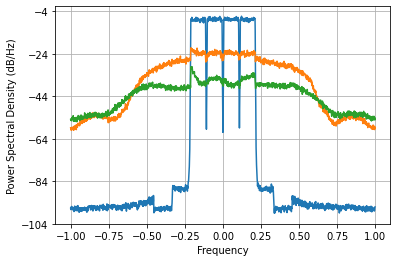

Loss =  0.00010005613932890614 Accuracy =  -25.042962850916666 dbs


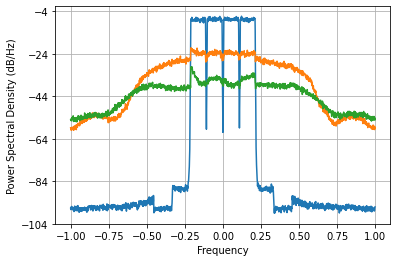

Loss =  9.898890242858083e-05 Accuracy =  -25.089535177894877 dbs


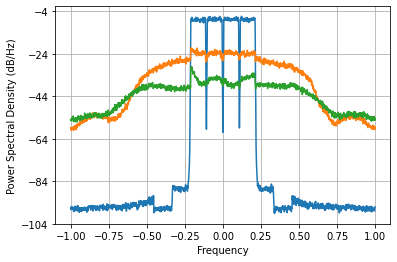

Loss =  9.805858801835016e-05 Accuracy =  -25.130543912989204 dbs


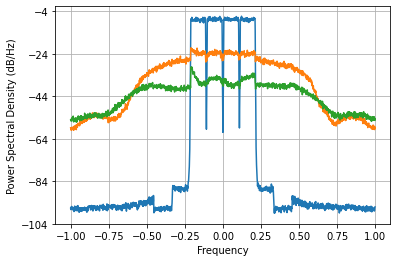

Loss =  9.723388071072444e-05 Accuracy =  -25.16722407421804 dbs


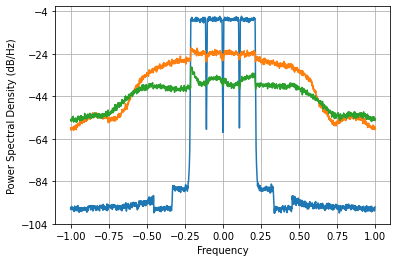

Loss =  9.648859802994073e-05 Accuracy =  -25.200640304972268 dbs


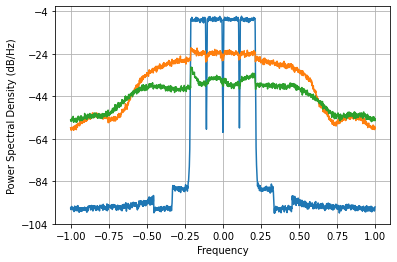

Loss =  9.580450112711851e-05 Accuracy =  -25.231541129254712 dbs


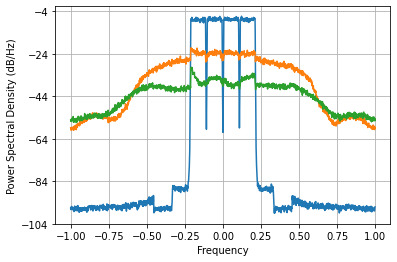

Loss =  9.516907100714142e-05 Accuracy =  -25.26044196721542 dbs


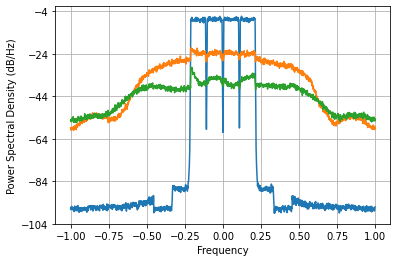

Loss =  9.457297153716569e-05 Accuracy =  -25.287729916551292 dbs


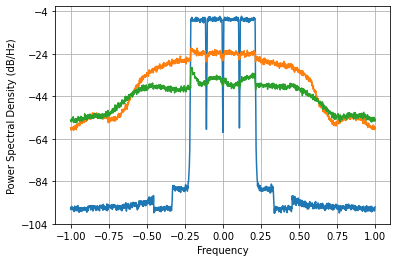

Loss =  9.400895895116153e-05 Accuracy =  -25.313707833262853 dbs


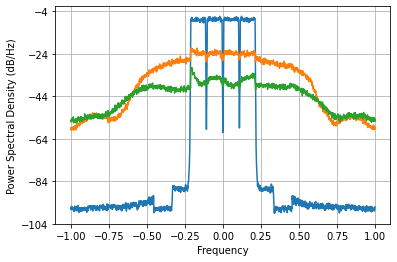

Loss =  9.347185256536893e-05 Accuracy =  -25.338591764137924 dbs


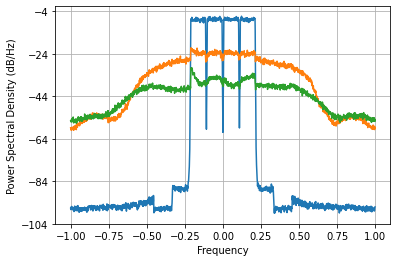

Loss =  9.295910237398624e-05 Accuracy =  -25.362481052296168 dbs


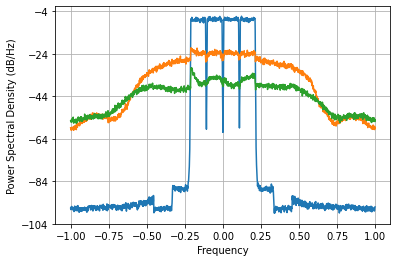

Loss =  9.247101573569529e-05 Accuracy =  -25.385343985827046 dbs


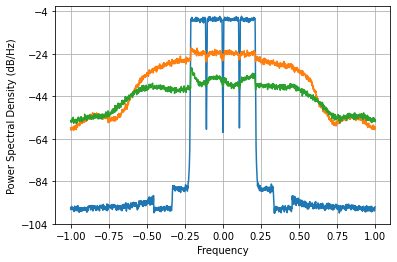

Loss =  9.20096795860359e-05 Accuracy =  -25.407065083679896 dbs


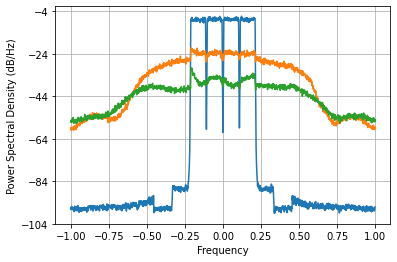

Loss =  9.157651218213231e-05 Accuracy =  -25.42755927886368 dbs


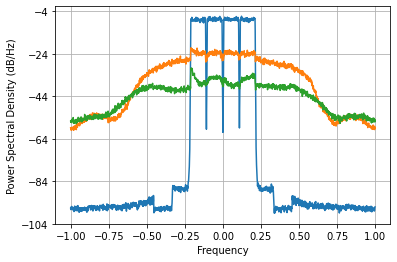

Loss =  9.116999772390556e-05 Accuracy =  -25.446880827309606 dbs


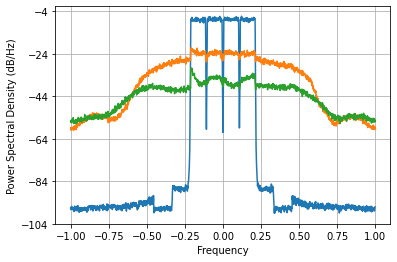

Loss =  9.078567950695203e-05 Accuracy =  -25.465226781847576 dbs


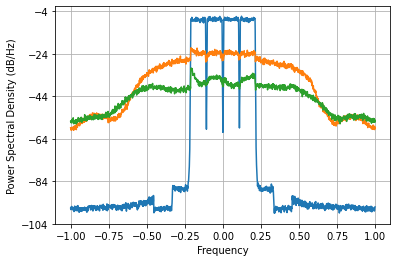

Loss =  9.041834351424457e-05 Accuracy =  -25.482834802962273 dbs


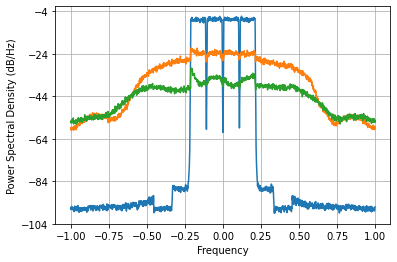

Loss =  9.006407593730126e-05 Accuracy =  -25.499884291976432 dbs


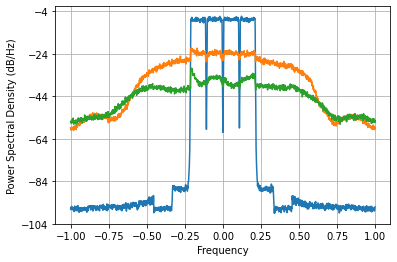

Loss =  8.972069798011107e-05 Accuracy =  -25.51647383180207 dbs


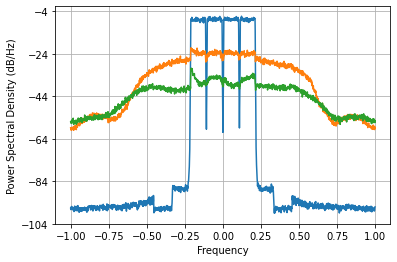

Loss =  8.93871569594941e-05 Accuracy =  -25.53264902325195 dbs


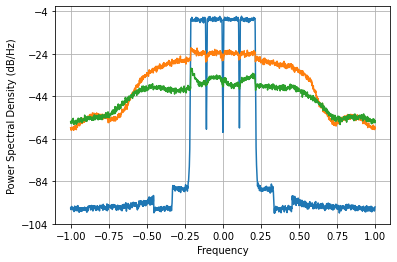

Loss =  8.906292990598529e-05 Accuracy =  -25.548430486588977 dbs


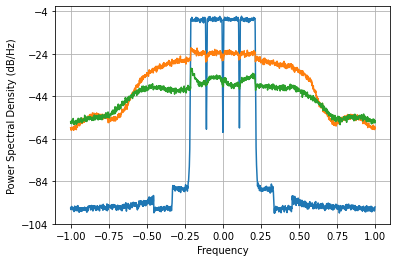

Loss =  8.874776239042084e-05 Accuracy =  -25.563826147497643 dbs


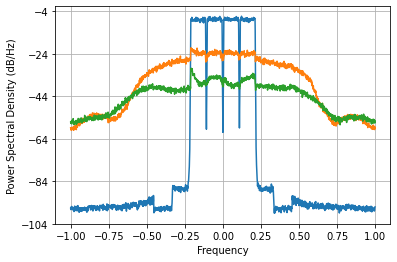

Loss =  8.84415675765624e-05 Accuracy =  -25.57883595090269 dbs


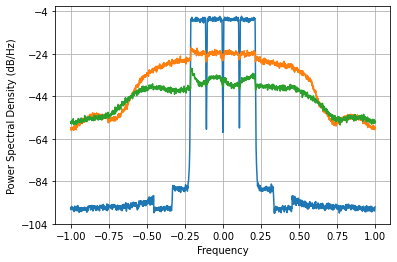

Loss =  8.814436666836371e-05 Accuracy =  -25.59345465050305 dbs


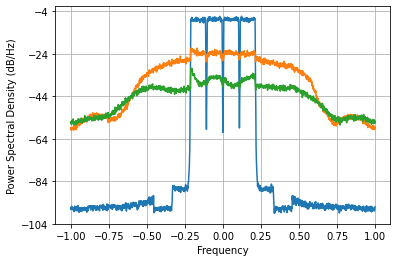

Loss =  8.785625817018406e-05 Accuracy =  -25.607673241241358 dbs


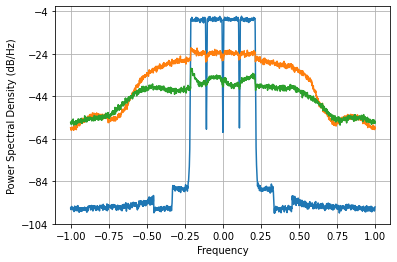

Loss =  8.75774007861982e-05 Accuracy =  -25.621479750872375 dbs


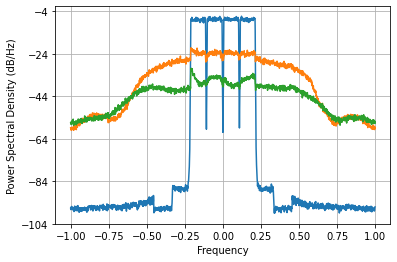

Loss =  8.730799899405379e-05 Accuracy =  -25.634859919192458 dbs


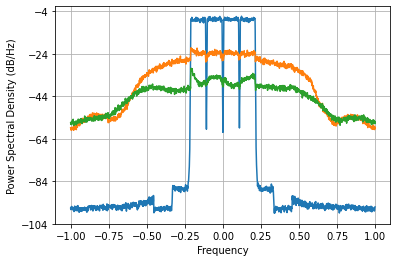

Loss =  8.704828437599358e-05 Accuracy =  -25.647798106074454 dbs


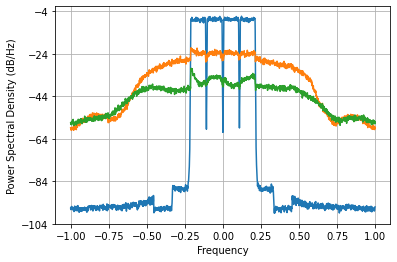

Loss =  8.67984883456846e-05 Accuracy =  -25.660278649776927 dbs


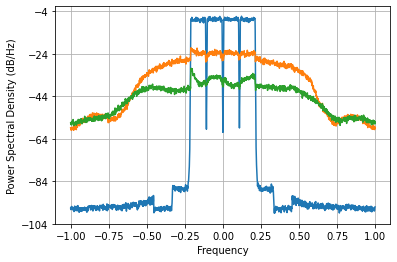

Loss =  8.655880915583487e-05 Accuracy =  -25.672287537479136 dbs


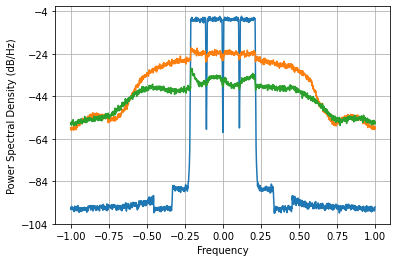

Loss =  8.63293820051796e-05 Accuracy =  -25.683813946928773 dbs


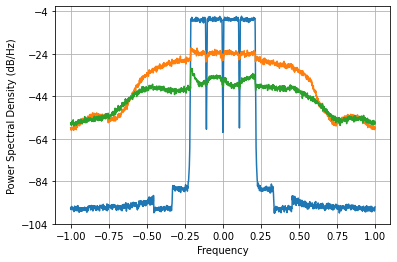

Loss =  8.611026410647497e-05 Accuracy =  -25.69485105442203 dbs


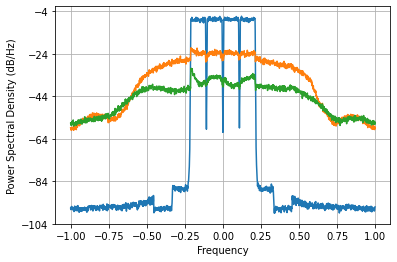

Loss =  8.590144194704778e-05 Accuracy =  -25.705395727011133 dbs


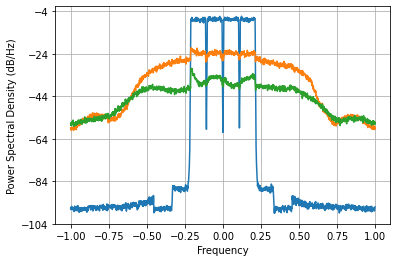

Loss =  8.570285752742948e-05 Accuracy =  -25.71544724161708 dbs


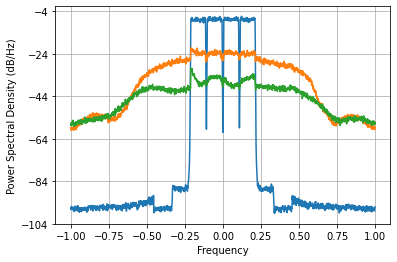

Loss =  8.551444022795813e-05 Accuracy =  -25.725005694829456 dbs


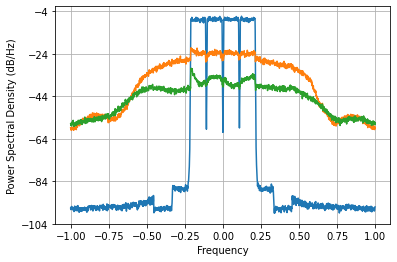

Loss =  8.533612801941462e-05 Accuracy =  -25.73407093085859 dbs


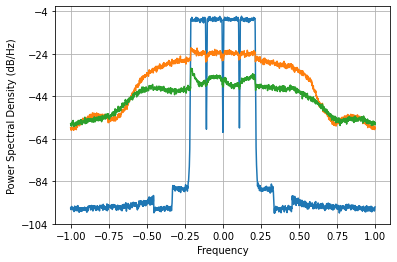

Loss =  8.516786744514098e-05 Accuracy =  -25.742642537928717 dbs


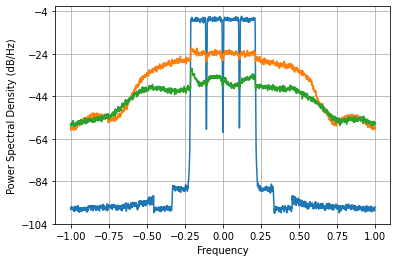

Loss =  8.50095918543577e-05 Accuracy =  -25.75072095628094 dbs


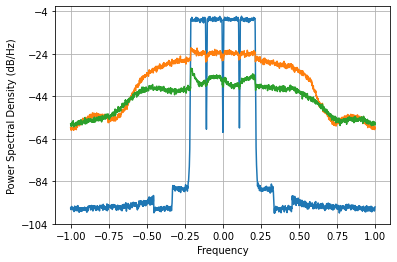

Loss =  8.486118572877695e-05 Accuracy =  -25.758309310056084 dbs


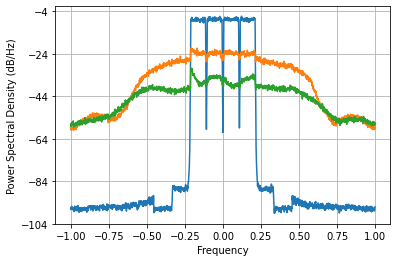

Loss =  8.472244639759775e-05 Accuracy =  -25.765415389651327 dbs


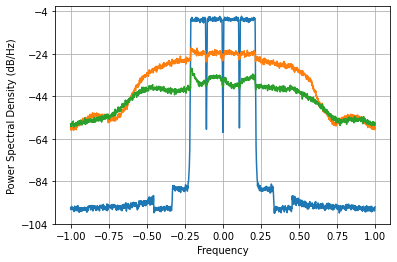

Loss =  8.459305331204481e-05 Accuracy =  -25.772053259673633 dbs


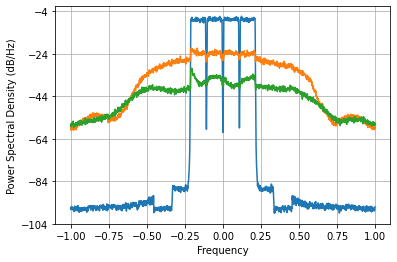

Loss =  8.44725514648487e-05 Accuracy =  -25.77824414589529 dbs


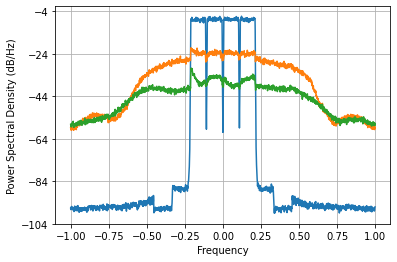

Loss =  8.436035143012625e-05 Accuracy =  -25.78401646423931 dbs


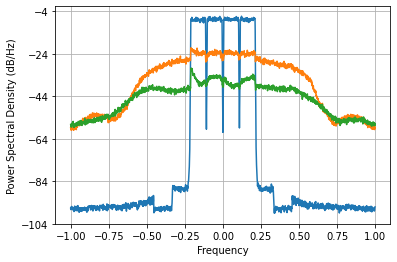

Loss =  8.42557449208864e-05 Accuracy =  -25.78940504060248 dbs


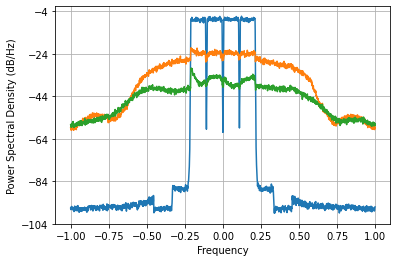

Loss =  8.415793209557562e-05 Accuracy =  -25.794449711061638 dbs


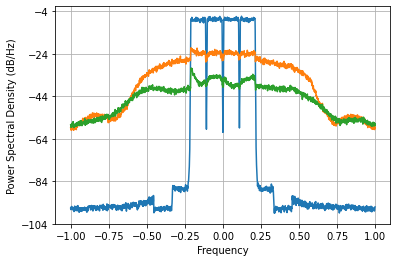

Loss =  8.406605524994475e-05 Accuracy =  -25.799193578053405 dbs


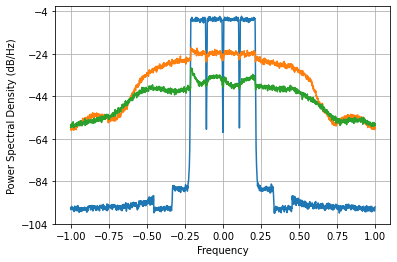

Loss =  8.397923311924808e-05 Accuracy =  -25.803681222543723 dbs


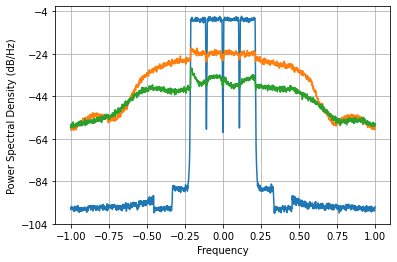

Loss =  8.389659075165045e-05 Accuracy =  -25.80795713628649 dbs


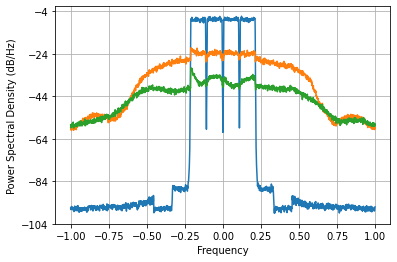

Loss =  8.381728149307489e-05 Accuracy =  -25.812064557511654 dbs


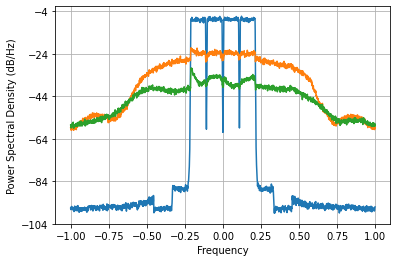

Loss =  8.374049954560197e-05 Accuracy =  -25.81604479384859 dbs


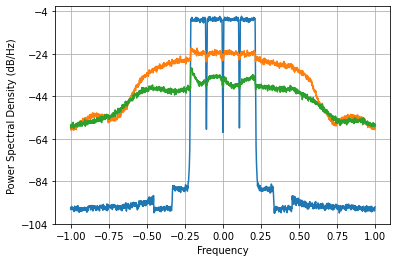

Loss =  8.366548332769771e-05 Accuracy =  -25.81993702411546 dbs


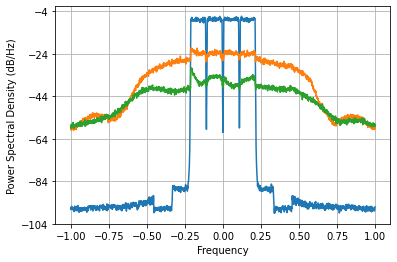

Loss =  8.359151114848167e-05 Accuracy =  -25.82377850308536 dbs


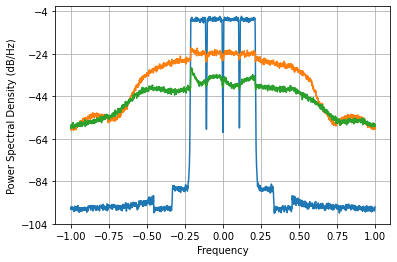

Loss =  8.351789140814979e-05 Accuracy =  -25.8276050560578 dbs


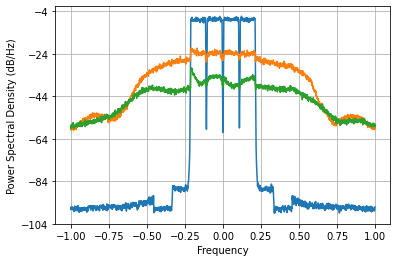

Loss =  8.344394973196844e-05 Accuracy =  -25.831451739087687 dbs


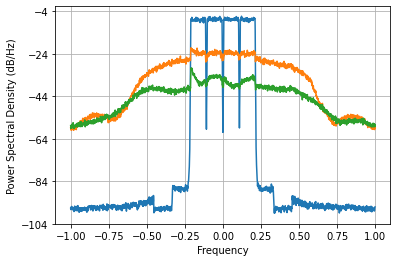

Loss =  8.336901531228981e-05 Accuracy =  -25.83535354697791 dbs


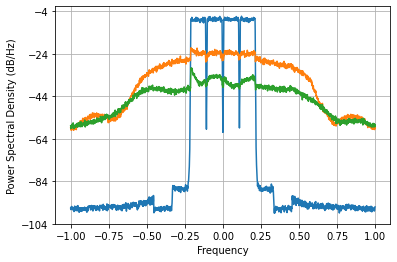

Loss =  8.32924084641047e-05 Accuracy =  -25.839346064626213 dbs


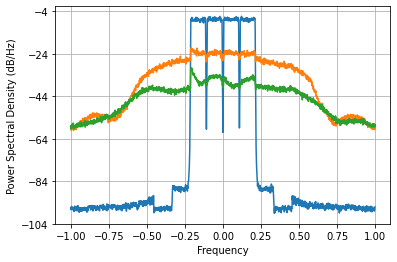

Loss =  8.321343114776143e-05 Accuracy =  -25.843465970010378 dbs


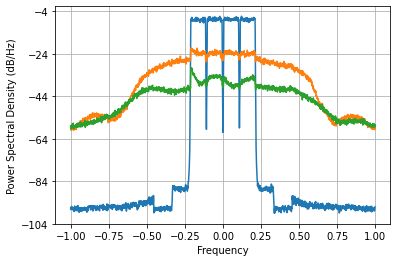

Loss =  8.313136206532951e-05 Accuracy =  -25.847751304325755 dbs


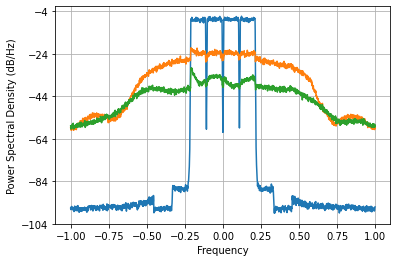

Loss =  8.304545791145775e-05 Accuracy =  -25.852241425550545 dbs


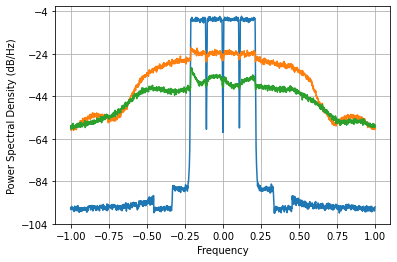

Loss =  8.295496240432373e-05 Accuracy =  -25.856976558534424 dbs


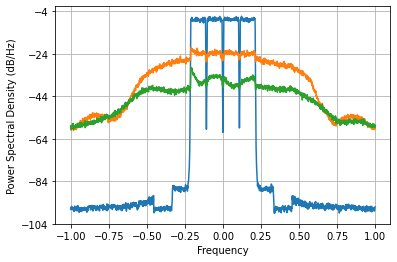

Loss =  8.285912472173416e-05 Accuracy =  -25.861996853500095 dbs


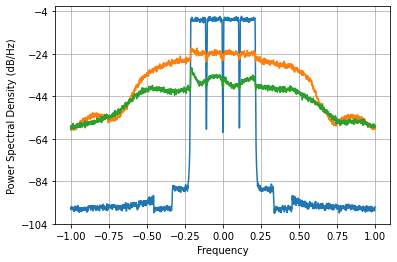

Loss =  8.275722874497272e-05 Accuracy =  -25.86734087479909 dbs


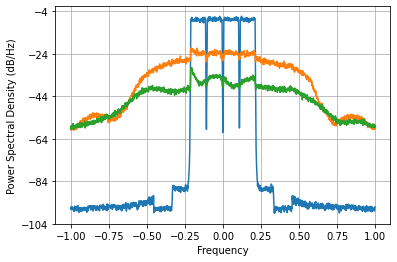

Loss =  8.26486338431906e-05 Accuracy =  -25.87304347477289 dbs


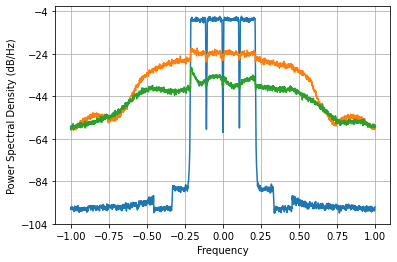

Loss =  8.25328265780534e-05 Accuracy =  -25.8791330763935 dbs


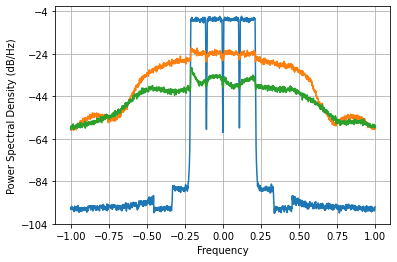

Loss =  8.240948051133321e-05 Accuracy =  -25.885628502227167 dbs


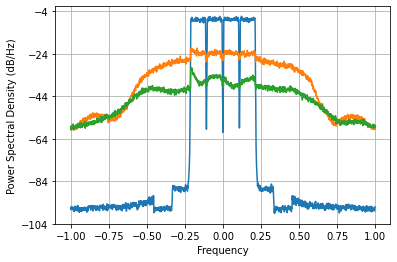

Loss =  8.227851831771183e-05 Accuracy =  -25.892535644267987 dbs



In [ ]:
net = Sasha_Cell_apd(D1=const3, D2=const4)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist9 = train(train_queue, valid_queue, net, loss_fn, optimizer,80,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


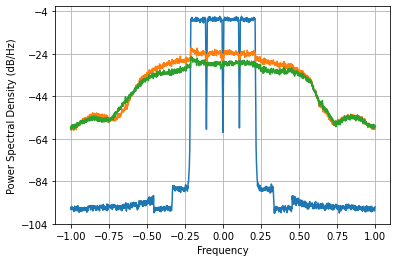

Loss =  0.0005125873492973072 Accuracy =  -17.947721431353067 dbs


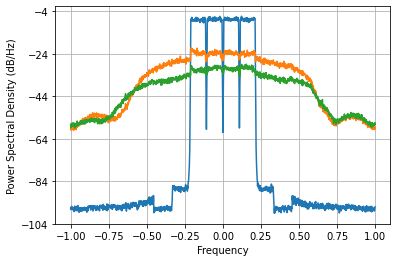

Loss =  0.0002572120644397032 Accuracy =  -20.9424869153127 dbs


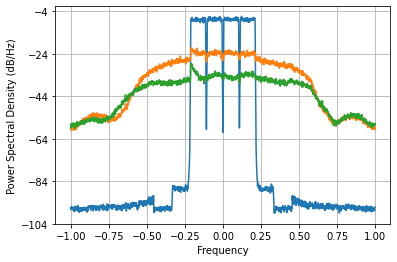

Loss =  0.00015359897409506412 Accuracy =  -23.18151711685063 dbs


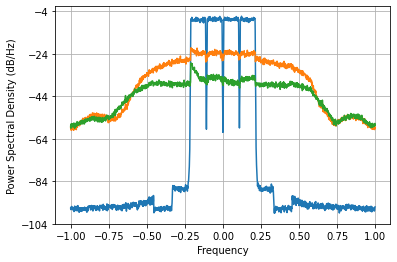

Loss =  0.00011975059632318149 Accuracy =  -24.262623419358945 dbs


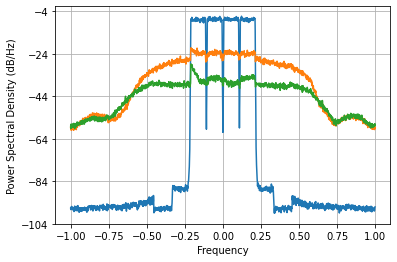

Loss =  0.00011000030176473742 Accuracy =  -24.631461501247326 dbs


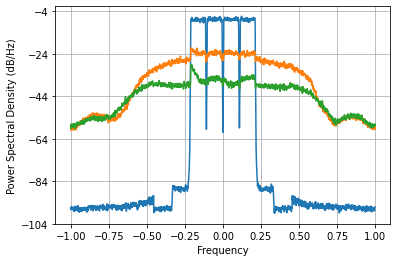

Loss =  0.00010513499582721012 Accuracy =  -24.827927248860824 dbs


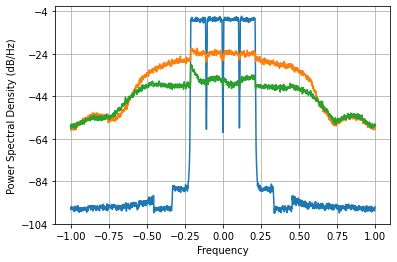

Loss =  0.00010185241548744676 Accuracy =  -24.965686936914736 dbs


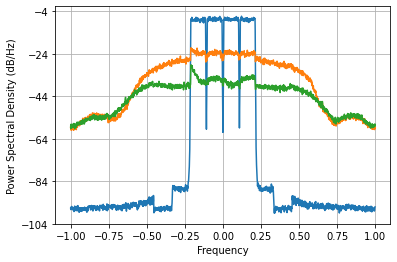

Loss =  9.920752049589125e-05 Accuracy =  -25.079954312873962 dbs


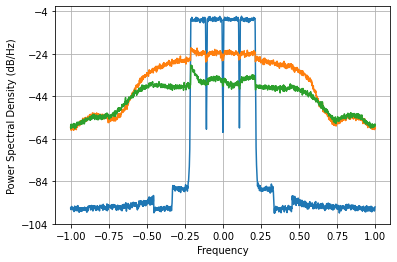

Loss =  9.702505104406794e-05 Accuracy =  -25.176561467974278 dbs


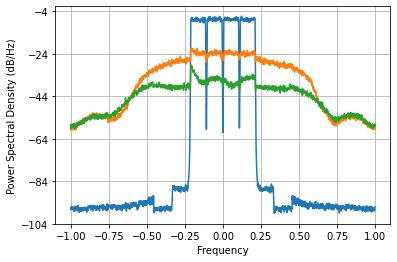

Loss =  9.523647205087347e-05 Accuracy =  -25.257367277044125 dbs


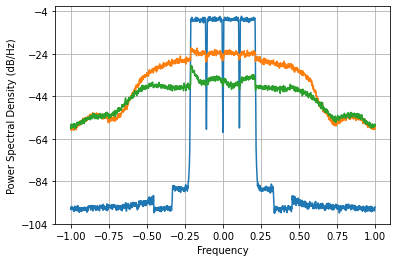

Loss =  9.378525804426404e-05 Accuracy =  -25.324054490041586 dbs


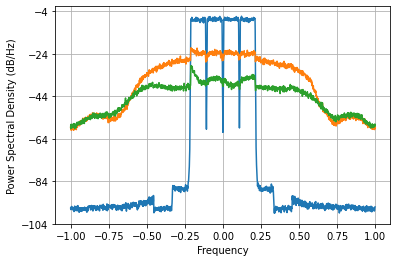

Loss =  9.261308411020761e-05 Accuracy =  -25.378676797962427 dbs


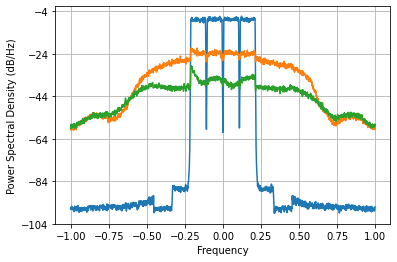

Loss =  9.166969907182391e-05 Accuracy =  -25.423142210135165 dbs


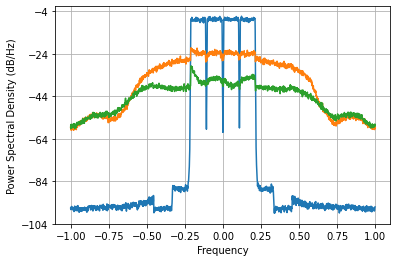

Loss =  9.091079865334978e-05 Accuracy =  -25.459245536200974 dbs


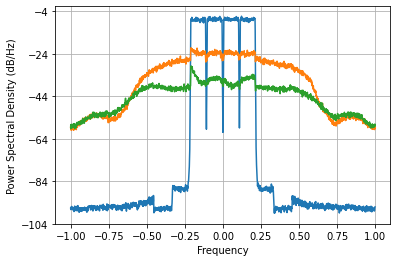

Loss =  9.029825948086012e-05 Accuracy =  -25.488606474172887 dbs


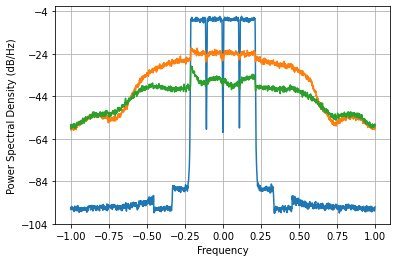

Loss =  8.980073330637178e-05 Accuracy =  -25.512601435887426 dbs


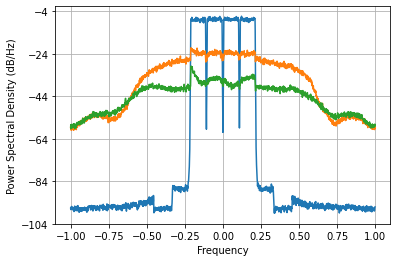

Loss =  8.939220889091044e-05 Accuracy =  -25.532403578155176 dbs


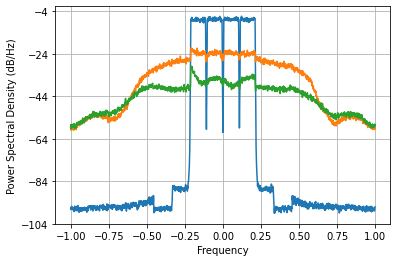

Loss =  8.905140832142004e-05 Accuracy =  -25.548992345971694 dbs


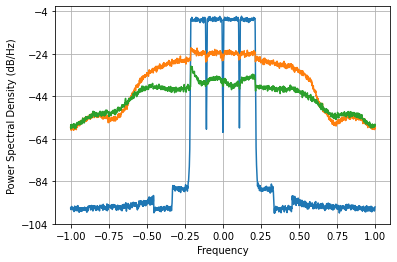

Loss =  8.876143194971433e-05 Accuracy =  -25.563157267870867 dbs


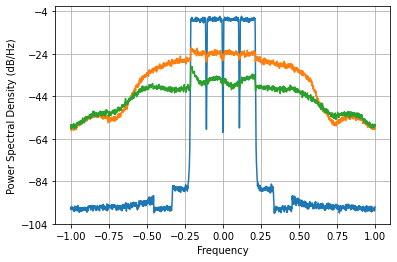

Loss =  8.850920593725546e-05 Accuracy =  -25.57551582207123 dbs


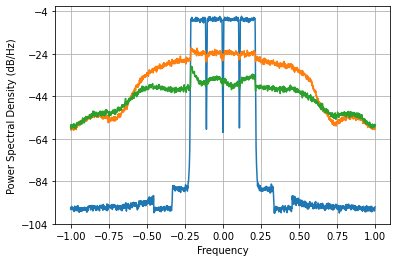

Loss =  8.828483396692365e-05 Accuracy =  -25.586539220934405 dbs


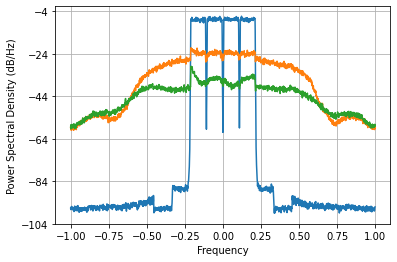

Loss =  8.808097854548276e-05 Accuracy =  -25.59657895854617 dbs


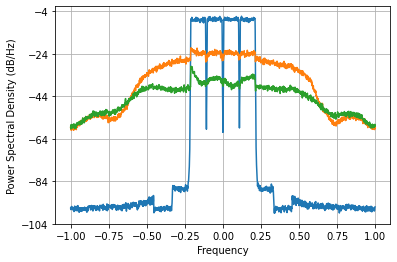

Loss =  8.789233049017732e-05 Accuracy =  -25.605890466214607 dbs


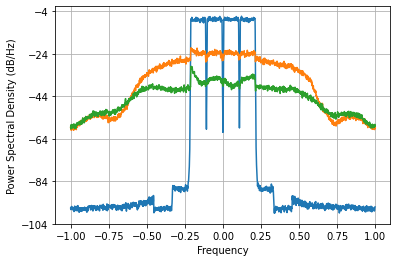

Loss =  8.771515040460848e-05 Accuracy =  -25.614654142930945 dbs


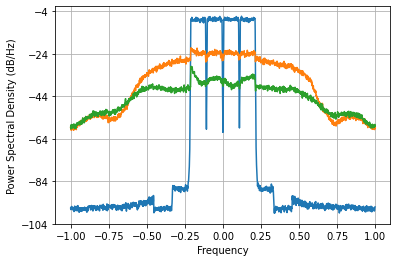

Loss =  8.754687531603984e-05 Accuracy =  -25.622993766367728 dbs


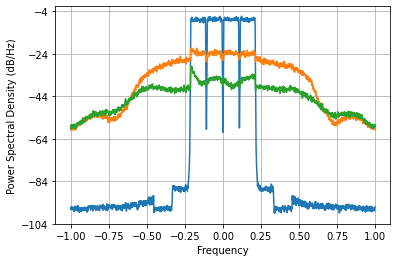

Loss =  8.738577820895129e-05 Accuracy =  -25.630992685154744 dbs


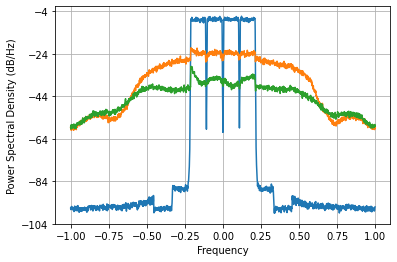

Loss =  8.723068005410033e-05 Accuracy =  -25.638707684209137 dbs


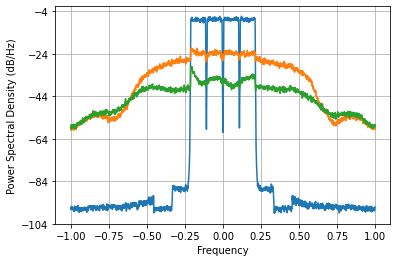

Loss =  8.708072634512889e-05 Accuracy =  -25.646179838299062 dbs


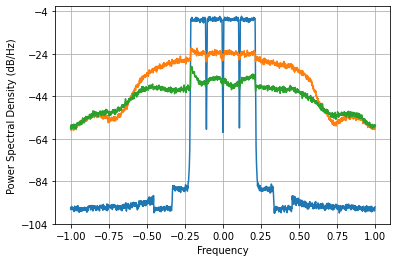

Loss =  8.693523706510222e-05 Accuracy =  -25.653441839436866 dbs


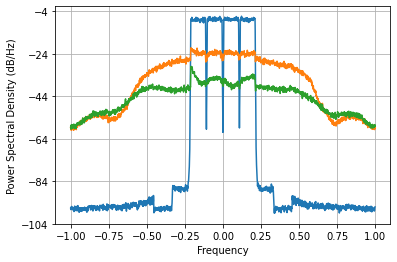

Loss =  8.679362543370005e-05 Accuracy =  -25.66052197141124 dbs


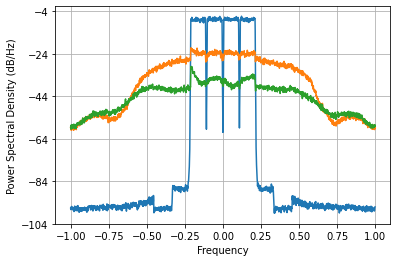

Loss =  8.665536742415104e-05 Accuracy =  -25.66744558651605 dbs


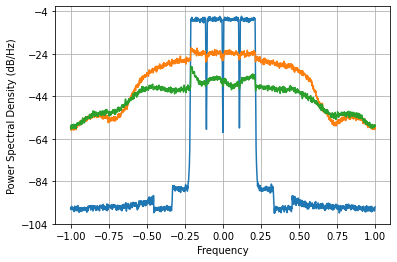

Loss =  8.651999920176384e-05 Accuracy =  -25.674235199279956 dbs


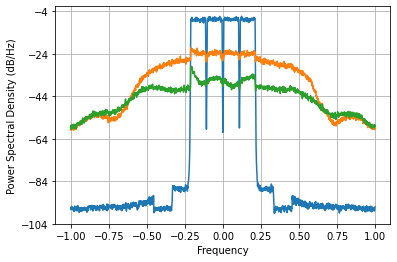

Loss =  8.638712437807541e-05 Accuracy =  -25.680910090733427 dbs


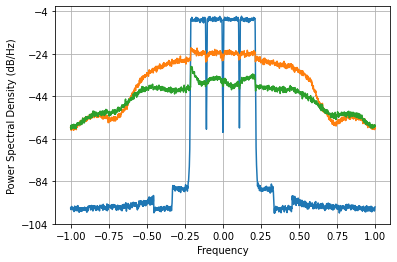

Loss =  8.625642206959466e-05 Accuracy =  -25.687485871103767 dbs


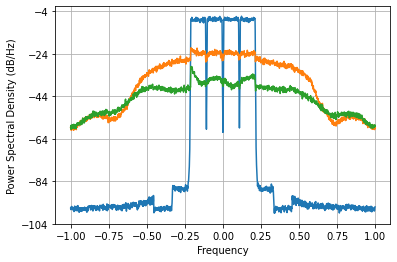

Loss =  8.612765436707459e-05 Accuracy =  -25.69397407050236 dbs


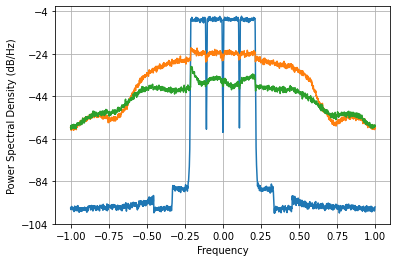

Loss =  8.600067516355297e-05 Accuracy =  -25.700381659254298 dbs


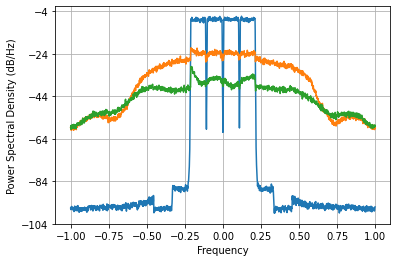

Loss =  8.587544197840128e-05 Accuracy =  -25.706710414149594 dbs


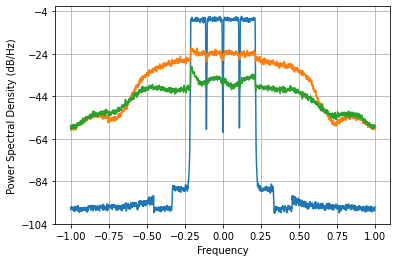

Loss =  8.575203056210566e-05 Accuracy =  -25.71295613991193 dbs


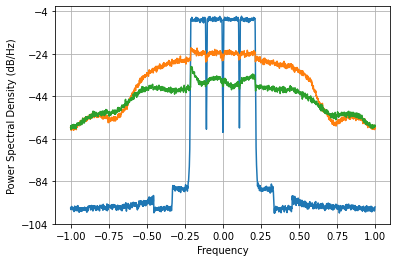

Loss =  8.563065027464093e-05 Accuracy =  -25.719107846445453 dbs


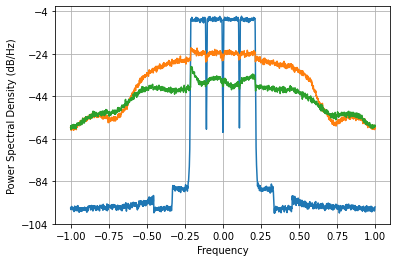

Loss =  8.551165693388021e-05 Accuracy =  -25.72514704977817 dbs


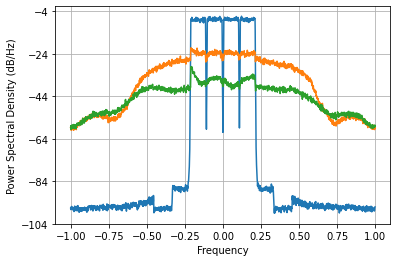

Loss =  8.53955589029776e-05 Accuracy =  -25.731047414100363 dbs


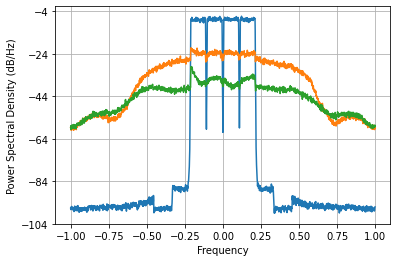

Loss =  8.528301168020383e-05 Accuracy =  -25.736774980803283 dbs


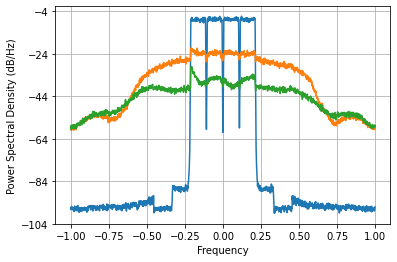

Loss =  8.517479655055434e-05 Accuracy =  -25.742289218076056 dbs


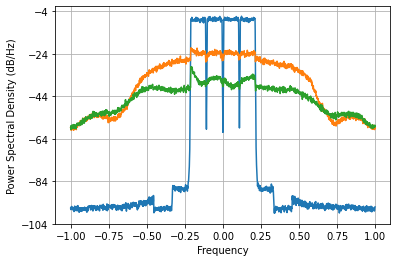

Loss =  8.50717803791793e-05 Accuracy =  -25.747545048888302 dbs


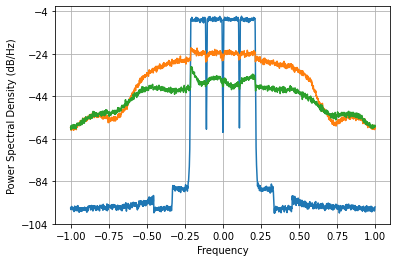

Loss =  8.497485653585135e-05 Accuracy =  -25.75249586657506 dbs


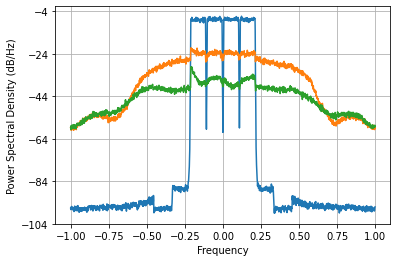

Loss =  8.48848709388792e-05 Accuracy =  -25.757097340091207 dbs


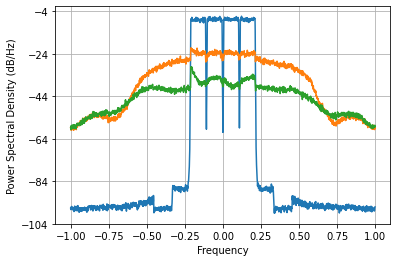

Loss =  8.480254144839719e-05 Accuracy =  -25.761311588598726 dbs


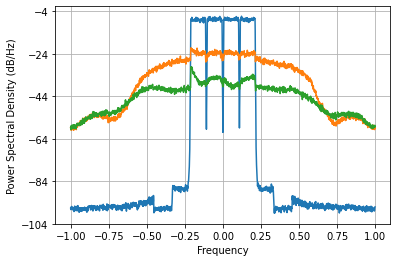

Loss =  8.47283820519103e-05 Accuracy =  -25.76511113360973 dbs


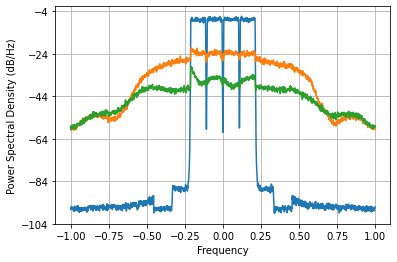

Loss =  8.466264418439856e-05 Accuracy =  -25.768481984496 dbs


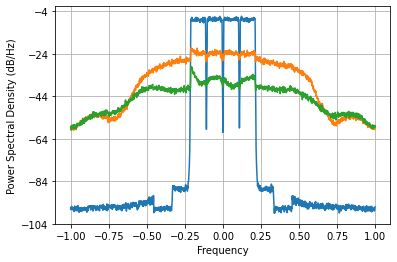

Loss =  8.460528538543641e-05 Accuracy =  -25.77142531946732 dbs


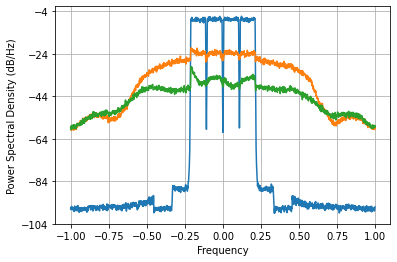

Loss =  8.455597059634305e-05 Accuracy =  -25.77395747628561 dbs


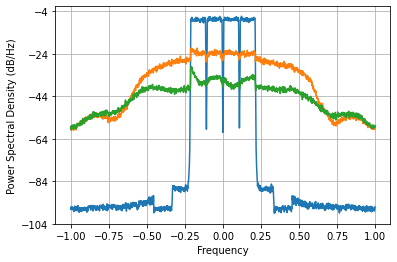

Loss =  8.451410505336378e-05 Accuracy =  -25.7761082974288 dbs


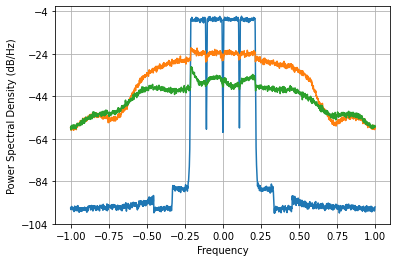

Loss =  8.447889180649532e-05 Accuracy =  -25.777918185330705 dbs


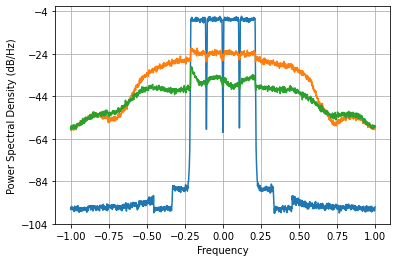

Loss =  8.44494030530888e-05 Accuracy =  -25.779434426647576 dbs


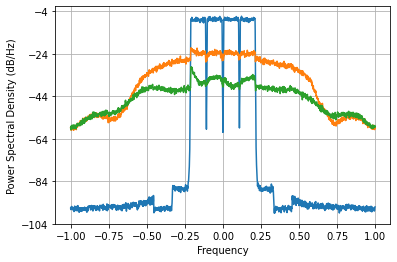

Loss =  8.442465354256432e-05 Accuracy =  -25.780707396118938 dbs


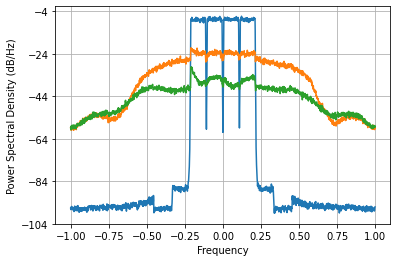

Loss =  8.440366605800841e-05 Accuracy =  -25.78178716150429 dbs


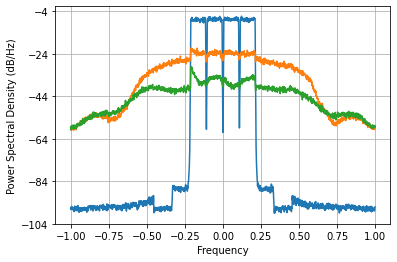

Loss =  8.43855224118933e-05 Accuracy =  -25.782720833321925 dbs


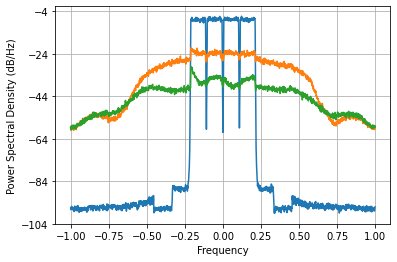

Loss =  8.436939725805374e-05 Accuracy =  -25.78355080205615 dbs


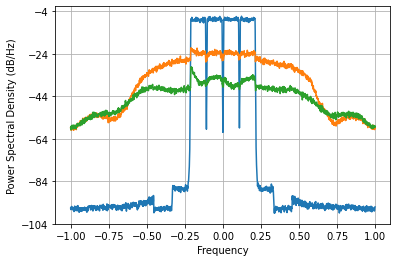

Loss =  8.435457530456932e-05 Accuracy =  -25.784313834425305 dbs


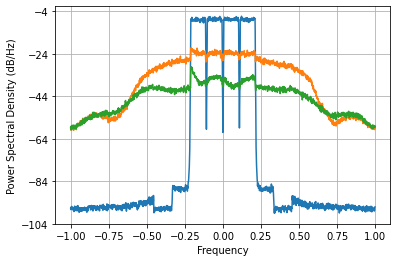

Loss =  8.434045467483574e-05 Accuracy =  -25.785040887449853 dbs


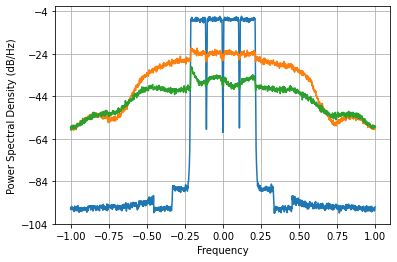

Loss =  8.432654014016608e-05 Accuracy =  -25.785757447989226 dbs


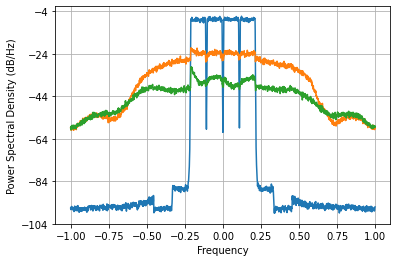

Loss =  8.431242998023181e-05 Accuracy =  -25.78648420344891 dbs


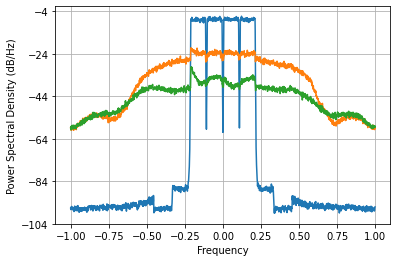

Loss =  8.42977996795748e-05 Accuracy =  -25.787237877632585 dbs


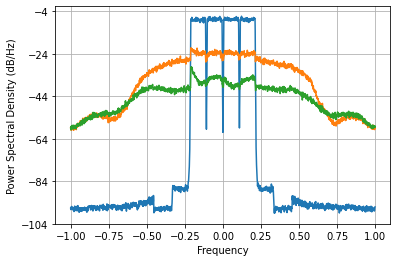

Loss =  8.428238487691783e-05 Accuracy =  -25.7880321066542 dbs


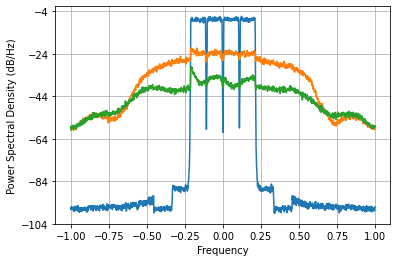

Loss =  8.426596519179172e-05 Accuracy =  -25.78887827081594 dbs


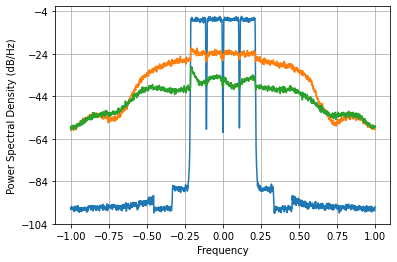

Loss =  8.424834989622766e-05 Accuracy =  -25.789786232336525 dbs


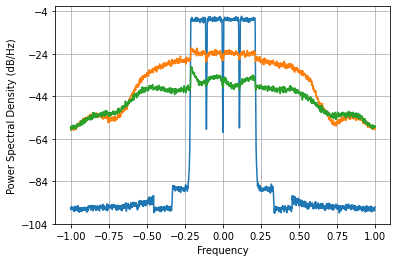

Loss =  8.422936592831919e-05 Accuracy =  -25.790764953172314 dbs


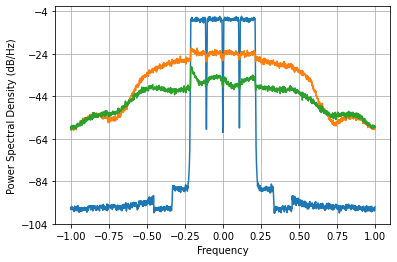

Loss =  8.420884845449877e-05 Accuracy =  -25.791822982164074 dbs


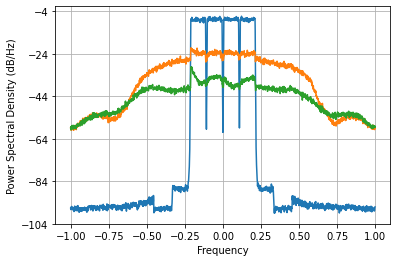

Loss =  8.418663404521226e-05 Accuracy =  -25.79296880808347 dbs


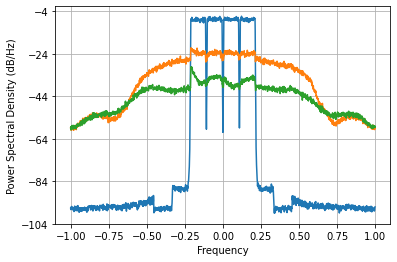

Loss =  8.416255649101815e-05 Accuracy =  -25.794211077079506 dbs


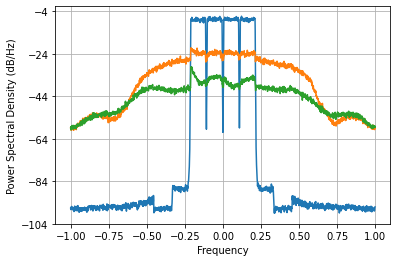

Loss =  8.413644530924316e-05 Accuracy =  -25.795558671792552 dbs


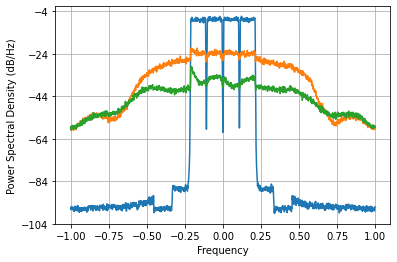

Loss =  8.410812703442455e-05 Accuracy =  -25.79702064711045 dbs


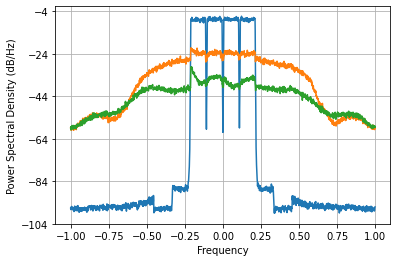

Loss =  8.407742941093522e-05 Accuracy =  -25.798606016141985 dbs


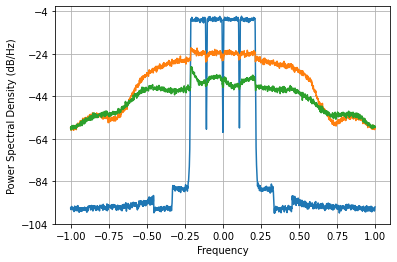

Loss =  8.404418857712754e-05 Accuracy =  -25.80032338135146 dbs


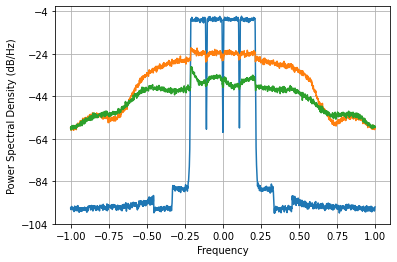

Loss =  8.40082592121913e-05 Accuracy =  -25.802180411745617 dbs


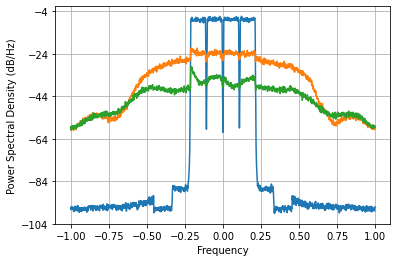

Loss =  8.396952737898092e-05 Accuracy =  -25.804183179144413 dbs


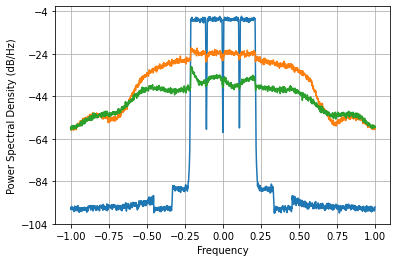

Loss =  8.392792541887114e-05 Accuracy =  -25.806335385956455 dbs


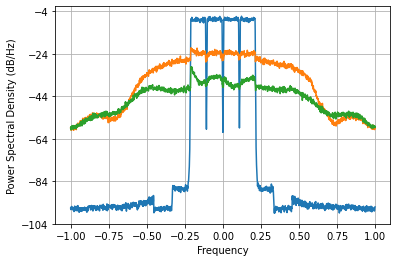

Loss =  8.388344774249908e-05 Accuracy =  -25.808637543373404 dbs


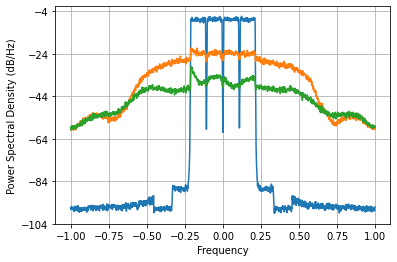

Loss =  8.38361657577847e-05 Accuracy =  -25.811086190275255 dbs


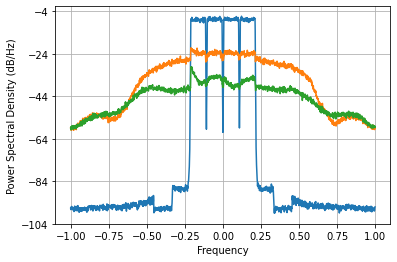

Loss =  8.378623958598834e-05 Accuracy =  -25.81367327420481 dbs



In [ ]:
net = Cell(D=0)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist8 = train(train_queue, valid_queue, net, loss_fn, optimizer,80,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


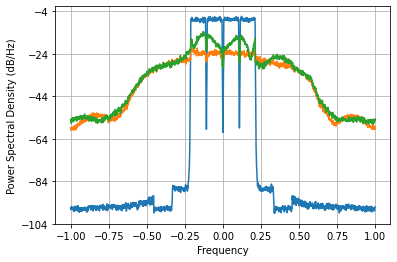

Loss =  0.0036192000520441445 Accuracy =  -9.459274371977134 dbs


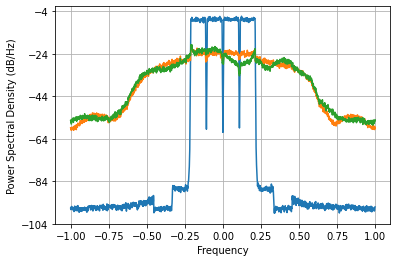

Loss =  0.001209536886042202 Accuracy =  -14.21920909541952 dbs


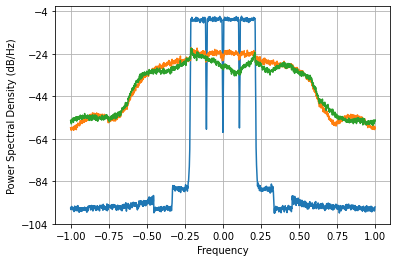

Loss =  0.0006852560957856555 Accuracy =  -16.68687119135878 dbs


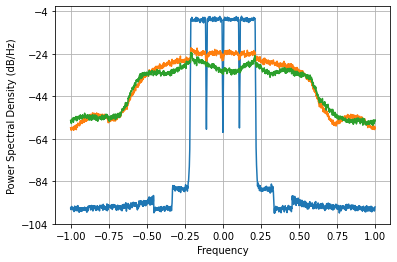

Loss =  0.0004821409987258847 Accuracy =  -18.213659635243495 dbs


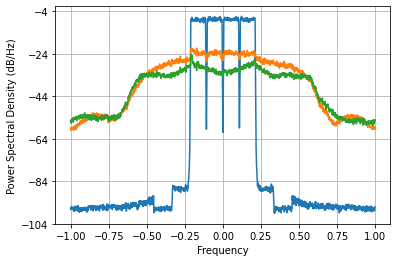

Loss =  0.00036686653528700383 Accuracy =  -19.400319284592168 dbs


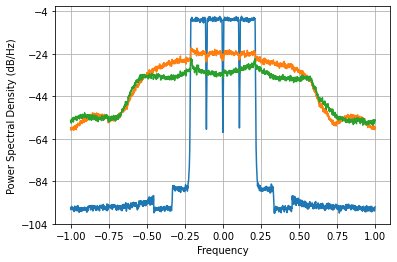

Loss =  0.0002934880919044993 Accuracy =  -20.369495419737063 dbs


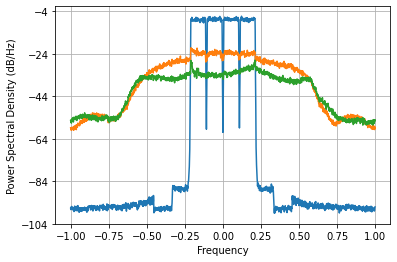

Loss =  0.00024403821275503069 Accuracy =  -21.170821909672554 dbs


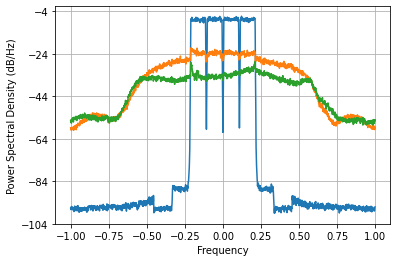

Loss =  0.00020917628888839882 Accuracy =  -21.840275730156897 dbs


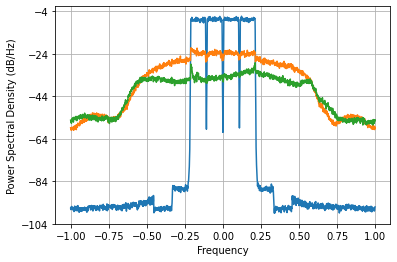

Loss =  0.0001835303274988093 Accuracy =  -22.408321871077813 dbs


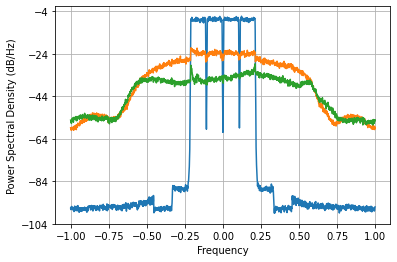

Loss =  0.0001641996442416487 Accuracy =  -22.891678148552167 dbs


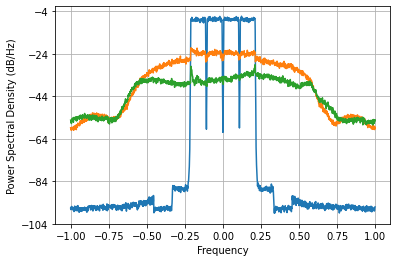

Loss =  0.00014936666294073698 Accuracy =  -23.30286348328267 dbs


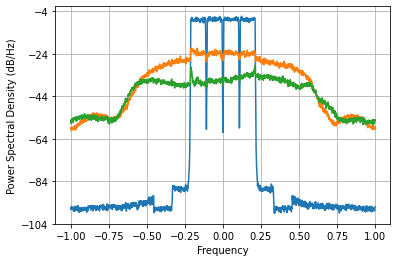

Loss =  0.0001377762306561993 Accuracy =  -23.653657277324474 dbs


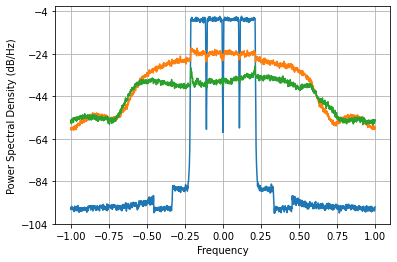

Loss =  0.00012859627038540002 Accuracy =  -23.95311653547377 dbs


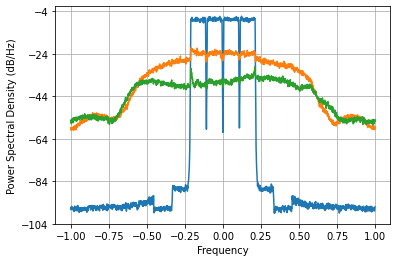

Loss =  0.00012123437991911625 Accuracy =  -24.20914231182426 dbs


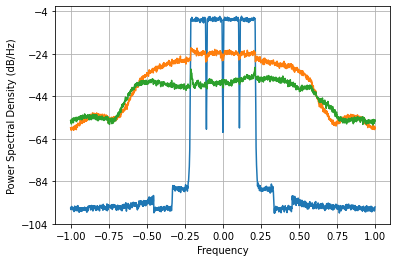

Loss =  0.00011523536934850113 Accuracy =  -24.42954228544626 dbs


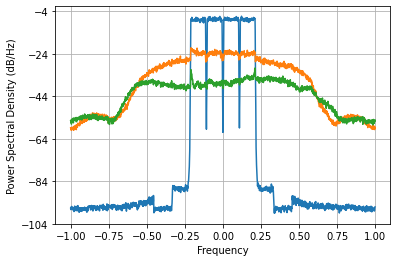

Loss =  0.00011026550936346211 Accuracy =  -24.62100338686698 dbs


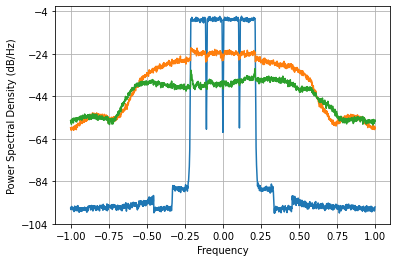

Loss =  0.00010606917020847368 Accuracy =  -24.78950855359807 dbs


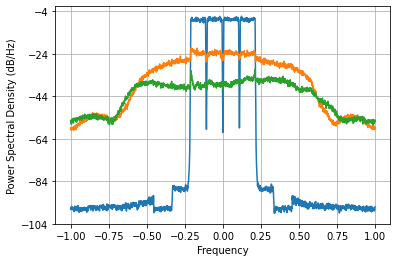

Loss =  0.0001024833161106549 Accuracy =  -24.938868570119258 dbs


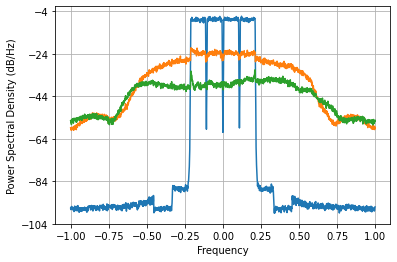

Loss =  9.942224870705096e-05 Accuracy =  -25.07056445012399 dbs


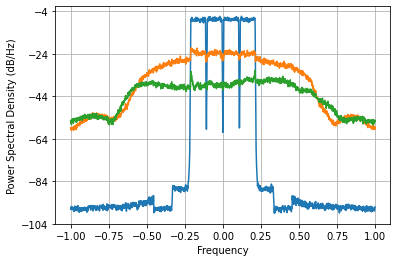

Loss =  9.680273924254985e-05 Accuracy =  -25.18652379905749 dbs


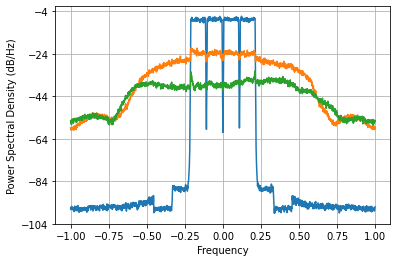

Loss =  9.451923522410932e-05 Accuracy =  -25.29019827685721 dbs


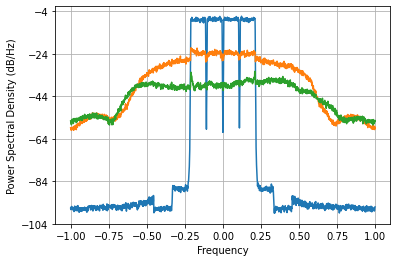

Loss =  9.250048633150614e-05 Accuracy =  -25.383960105920753 dbs


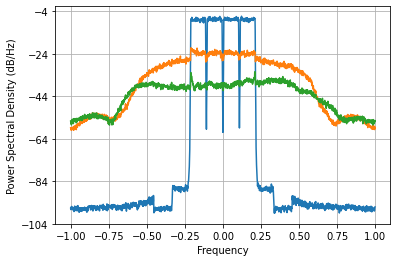

Loss =  9.069238143956496e-05 Accuracy =  -25.469692207497026 dbs


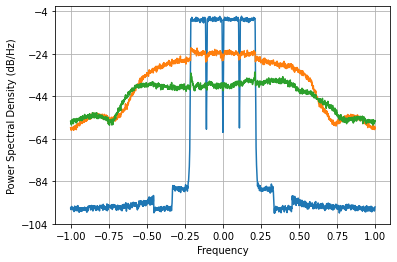

Loss =  8.903744069296192e-05 Accuracy =  -25.5496735861516 dbs


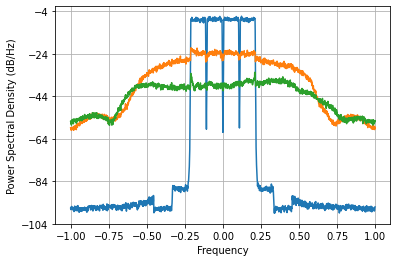

Loss =  8.749088775964205e-05 Accuracy =  -25.62577203400561 dbs


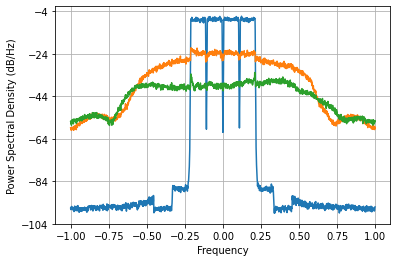

Loss =  8.60211255757192e-05 Accuracy =  -25.699349057437537 dbs


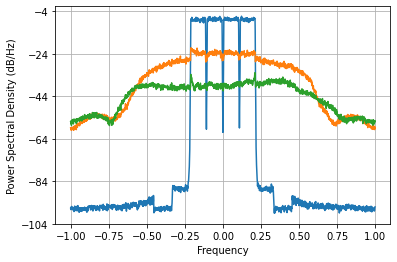

Loss =  8.46129722001115e-05 Accuracy =  -25.771030759063883 dbs


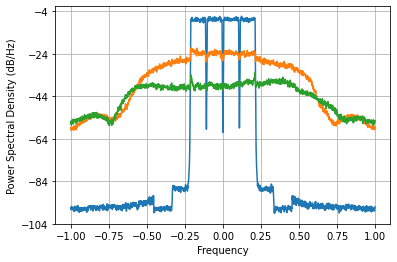

Loss =  8.326733444055063e-05 Accuracy =  -25.840653644712614 dbs


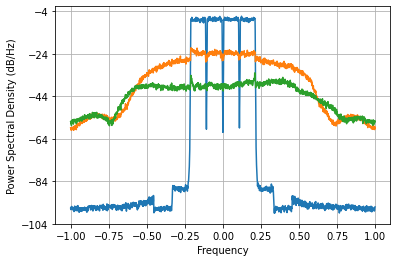

Loss =  8.199524049514664e-05 Accuracy =  -25.907513826787216 dbs


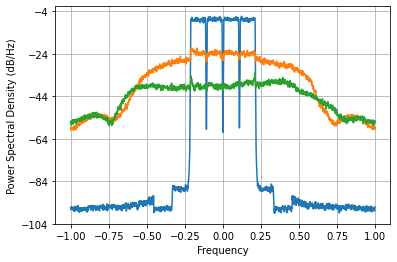

Loss =  8.080331819696797e-05 Accuracy =  -25.971108311977616 dbs


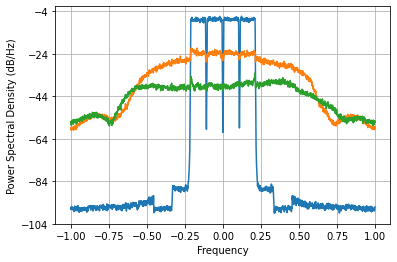

Loss =  7.968028113167012e-05 Accuracy =  -26.031891689719195 dbs


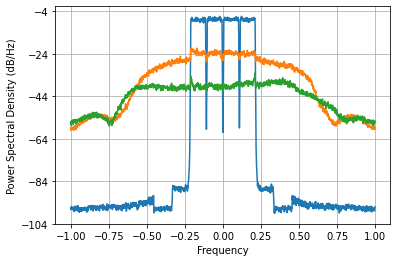

Loss =  7.859839680511333e-05 Accuracy =  -26.091263389922567 dbs


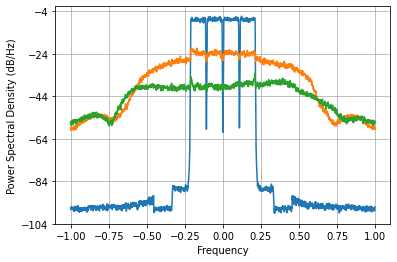

Loss =  7.753255273238876e-05 Accuracy =  -26.15055943488246 dbs


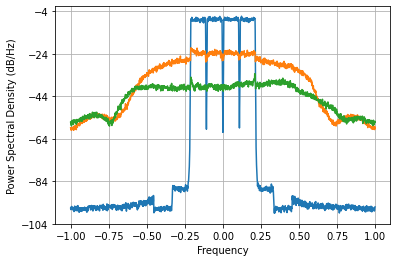

Loss =  7.648061450997729e-05 Accuracy =  -26.209886579167915 dbs


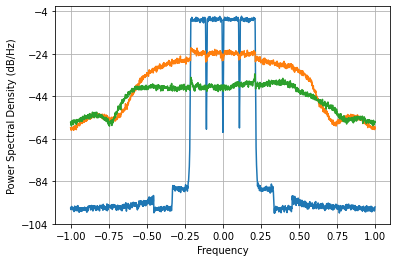

Loss =  7.546499541625923e-05 Accuracy =  -26.267944766858342 dbs


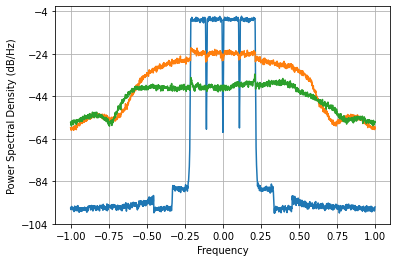

Loss =  7.451011917410764e-05 Accuracy =  -26.323247686642112 dbs


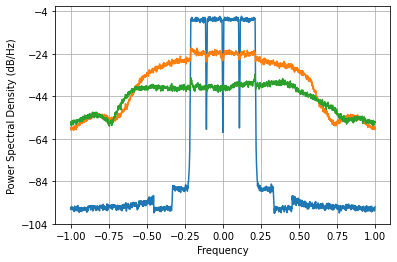

Loss =  7.361864946582609e-05 Accuracy =  -26.37552180637072 dbs


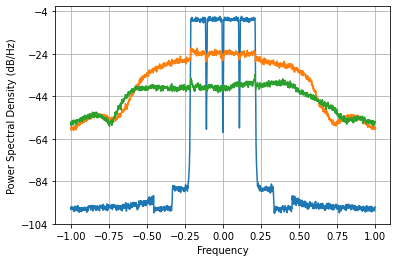

Loss =  7.27747696243187e-05 Accuracy =  -26.4255918737705 dbs


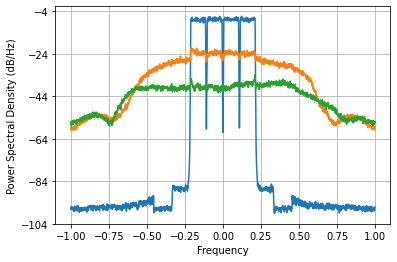

Loss =  7.196654132394064e-05 Accuracy =  -26.47409395475265 dbs


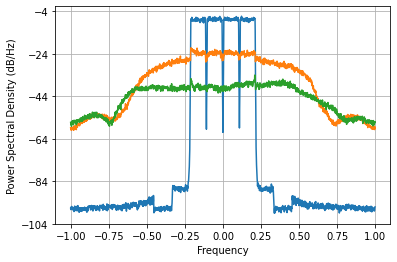

Loss =  7.119857872904933e-05 Accuracy =  -26.520687023813213 dbs


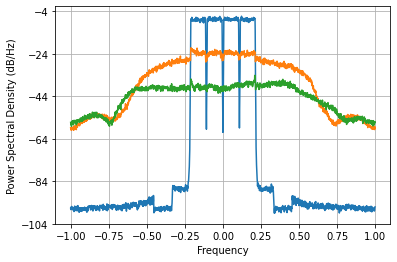

Loss =  7.048749686564195e-05 Accuracy =  -26.564279384035395 dbs


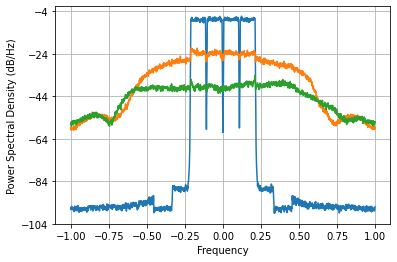

Loss =  6.984447251691331e-05 Accuracy =  -26.604079848907286 dbs


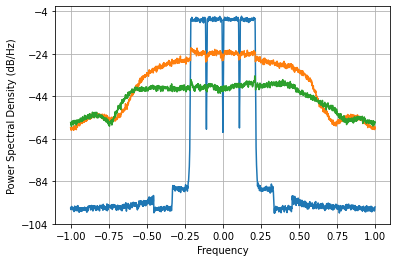

Loss =  6.925631353120293e-05 Accuracy =  -26.640806560740703 dbs


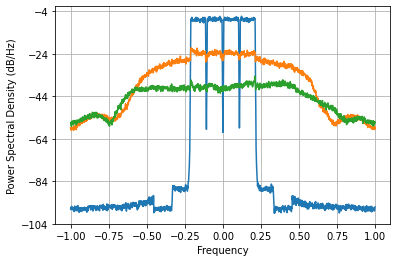

Loss =  6.86886478320157e-05 Accuracy =  -26.676550595165498 dbs


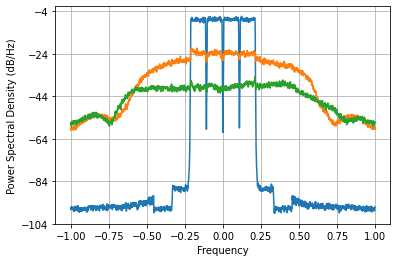

Loss =  6.811028489498779e-05 Accuracy =  -26.713273298139022 dbs


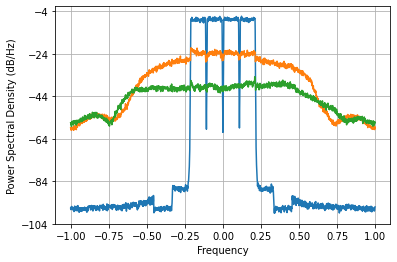

Loss =  6.750985371908451e-05 Accuracy =  -26.7517285973131 dbs


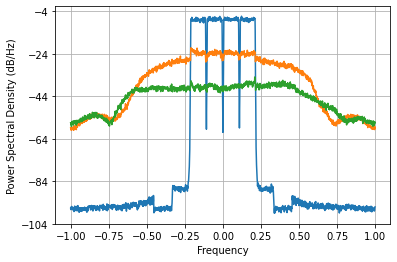

Loss =  6.689341129224002e-05 Accuracy =  -26.79156682916496 dbs


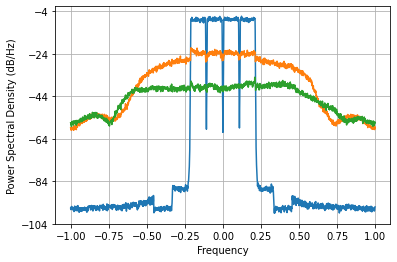

Loss =  6.627447451246241e-05 Accuracy =  -26.831937337722422 dbs


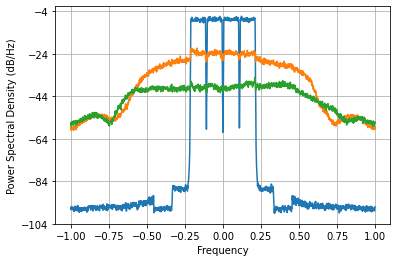

Loss =  6.566648438546901e-05 Accuracy =  -26.871962607868355 dbs


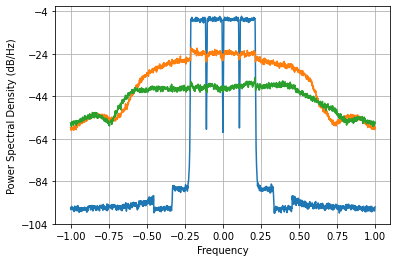

Loss =  6.507937766844515e-05 Accuracy =  -26.91096635411313 dbs


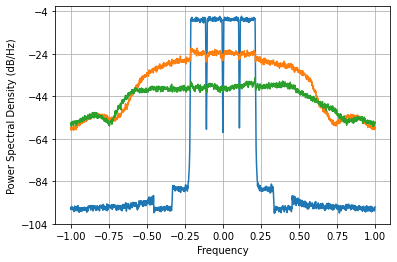

Loss =  6.451878057373059e-05 Accuracy =  -26.948538762029383 dbs


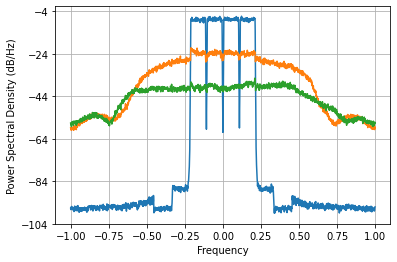

Loss =  6.39865360847964e-05 Accuracy =  -26.984514264422145 dbs


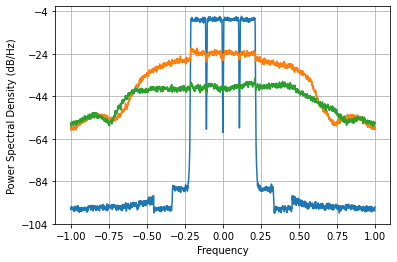

Loss =  6.348173319143092e-05 Accuracy =  -27.01891251245641 dbs


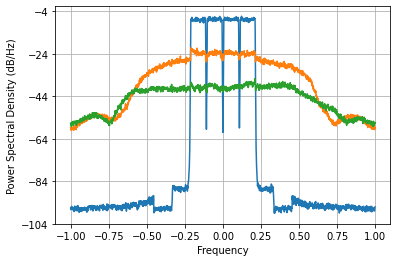

Loss =  6.300167472712979e-05 Accuracy =  -27.051879325507784 dbs


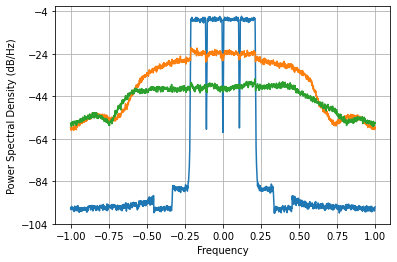

Loss =  6.254248477923958e-05 Accuracy =  -27.083648951526726 dbs


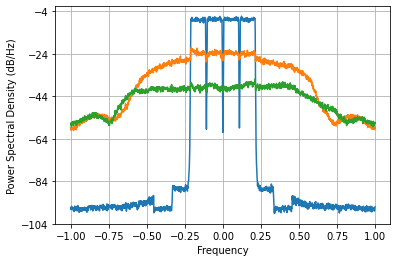

Loss =  6.209934104746852e-05 Accuracy =  -27.114530349008117 dbs


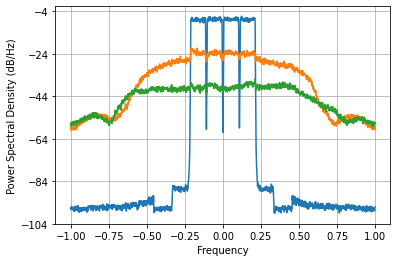

Loss =  6.16665149115299e-05 Accuracy =  -27.14490621758931 dbs


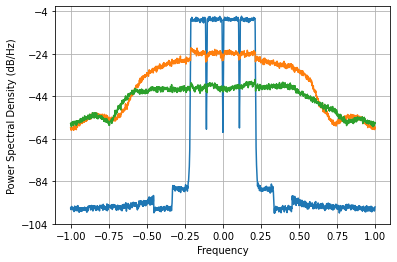

Loss =  6.123746401370509e-05 Accuracy =  -27.17522829437629 dbs


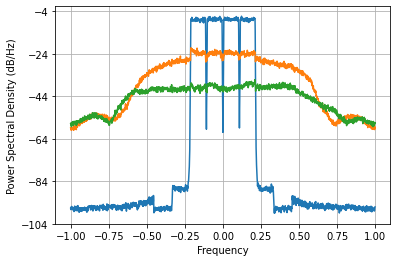

Loss =  6.080518619538918e-05 Accuracy =  -27.205994039947146 dbs


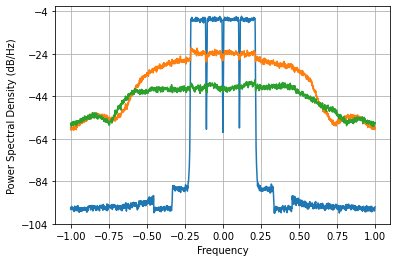

Loss =  6.0362945259550195e-05 Accuracy =  -27.237696047502823 dbs


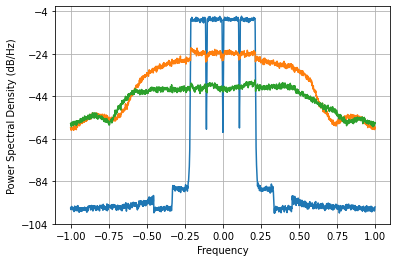

Loss =  5.990530725971382e-05 Accuracy =  -27.27074726644436 dbs


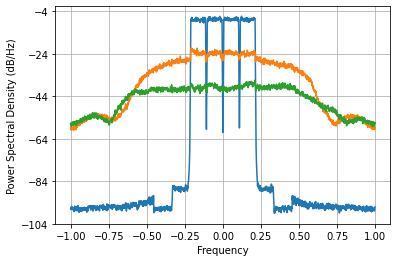

Loss =  5.9429219197278583e-05 Accuracy =  -27.305400023115833 dbs


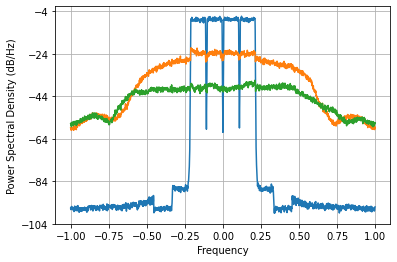

Loss =  5.893476511881478e-05 Accuracy =  -27.341684696734823 dbs


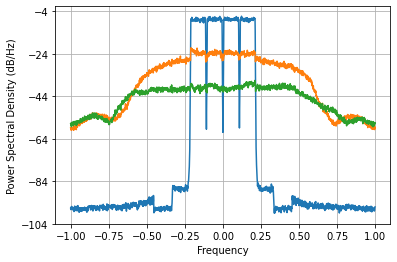

Loss =  5.8425351364714664e-05 Accuracy =  -27.379386938088594 dbs


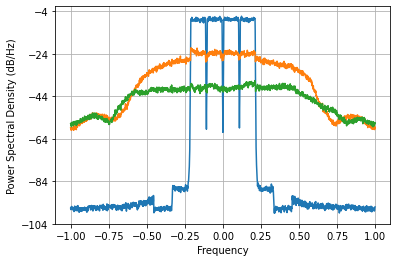

Loss =  5.790730663216142e-05 Accuracy =  -27.418066610640018 dbs


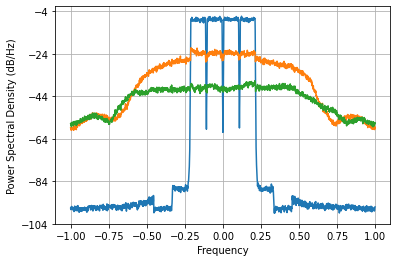

Loss =  5.738903516720176e-05 Accuracy =  -27.457111033018368 dbs


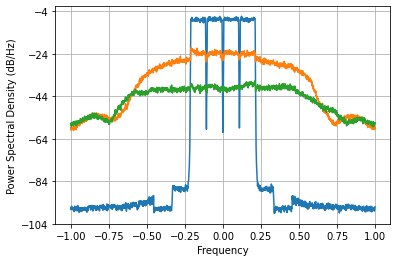

Loss =  5.687986221085219e-05 Accuracy =  -27.49581491025932 dbs


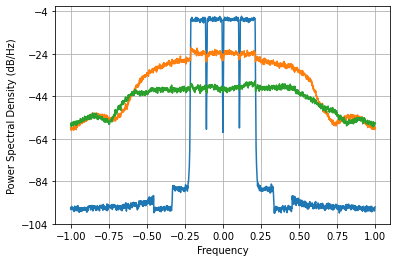

Loss =  5.6388670154890914e-05 Accuracy =  -27.53348174185409 dbs


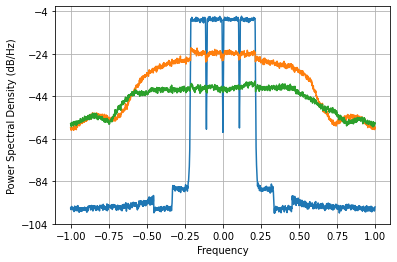

Loss =  5.5922472140734635e-05 Accuracy =  -27.56953664856399 dbs


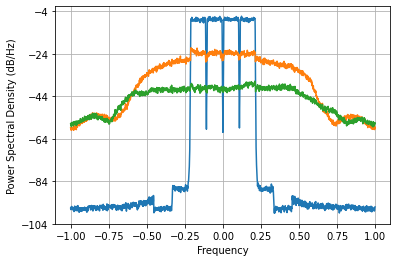

Loss =  5.5485191978921036e-05 Accuracy =  -27.603629336544255 dbs


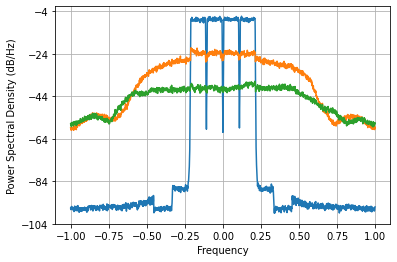

Loss =  5.5076973187550504e-05 Accuracy =  -27.635699615533223 dbs


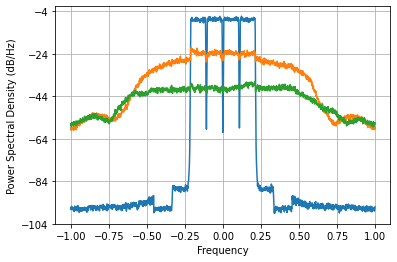

Loss =  5.4694239048993553e-05 Accuracy =  -27.6659844223768 dbs


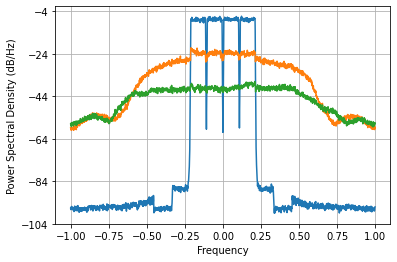

Loss =  5.433053521352805e-05 Accuracy =  -27.69496043371117 dbs


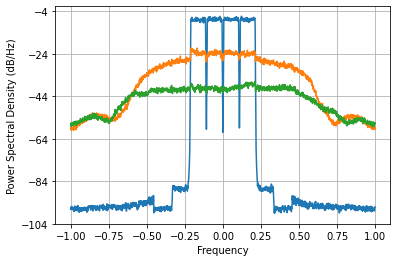

Loss =  5.397799669631756e-05 Accuracy =  -27.723232642869185 dbs


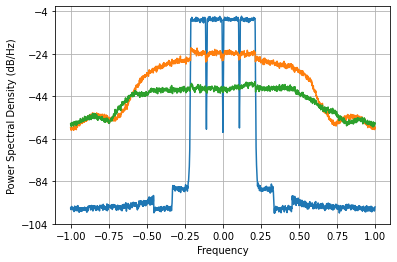

Loss =  5.3629101667848034e-05 Accuracy =  -27.75139504458788 dbs


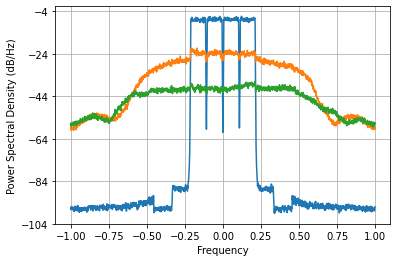

Loss =  5.327823672256754e-05 Accuracy =  -27.779901835427108 dbs


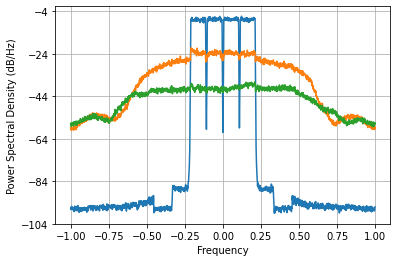

Loss =  5.292262007879665e-05 Accuracy =  -27.80898689706483 dbs


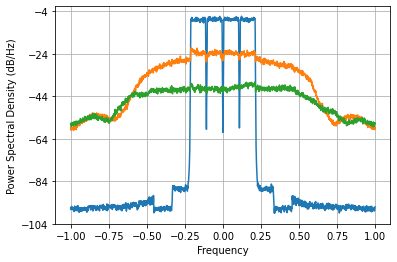

Loss =  5.2562365787277274e-05 Accuracy =  -27.8386512247218 dbs


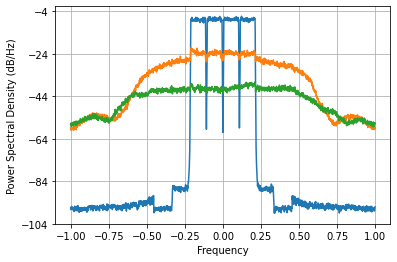

Loss =  5.219980524750891e-05 Accuracy =  -27.868711439942103 dbs


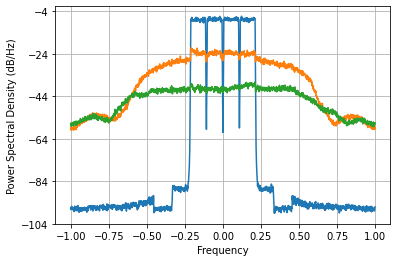

Loss =  5.1838424435988194e-05 Accuracy =  -27.8988823346217 dbs


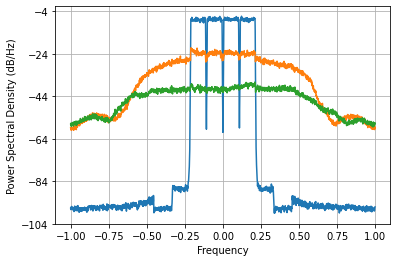

Loss =  5.14818220399258e-05 Accuracy =  -27.928861176733967 dbs


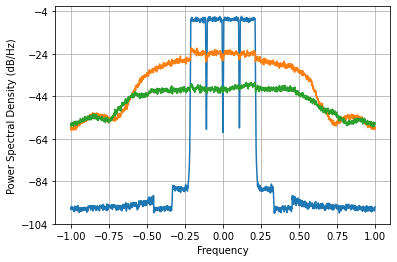

Loss =  5.113296959113086e-05 Accuracy =  -27.958390112041908 dbs


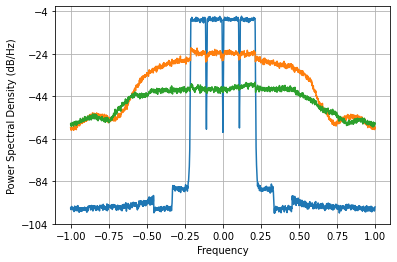

Loss =  5.079386445200162e-05 Accuracy =  -27.987287710099732 dbs


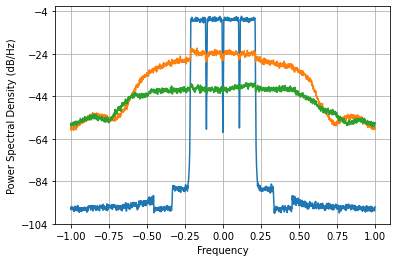

Loss =  5.0465514112949355e-05 Accuracy =  -28.015453247399208 dbs


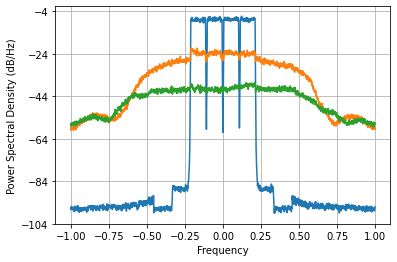

Loss =  5.01481220896263e-05 Accuracy =  -28.042853521709404 dbs


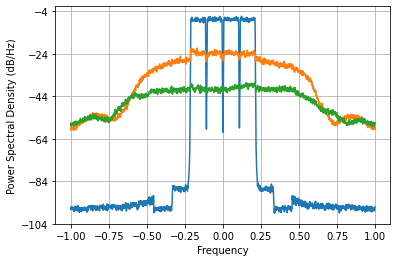

Loss =  4.984134959161389e-05 Accuracy =  -28.069502331604113 dbs


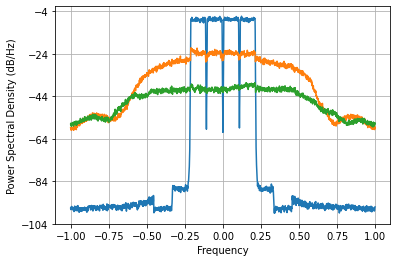

Loss =  4.954456643807985e-05 Accuracy =  -28.095439944128998 dbs


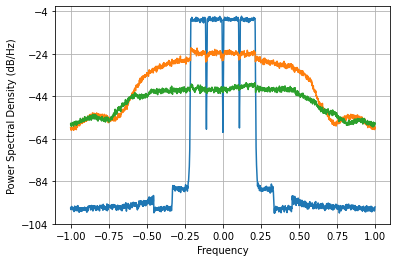

Loss =  4.925704805797877e-05 Accuracy =  -28.120716453837908 dbs


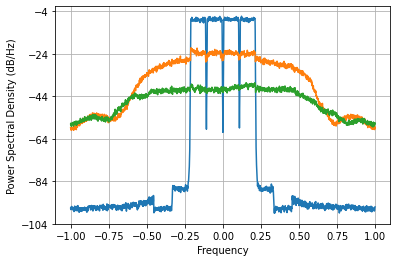

Loss =  4.897810721731801e-05 Accuracy =  -28.145380290959015 dbs


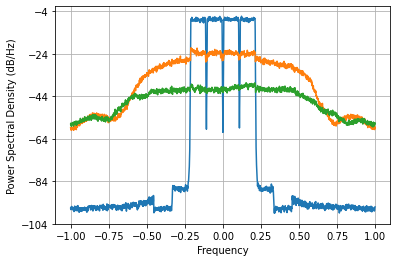

Loss =  4.870716681986747e-05 Accuracy =  -28.169471582596152 dbs


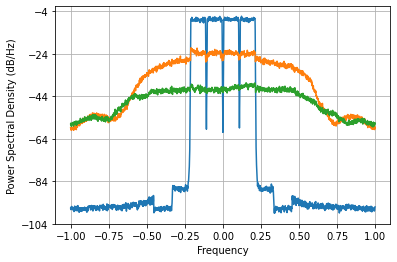

Loss =  4.844378738839447e-05 Accuracy =  -28.193019372712854 dbs


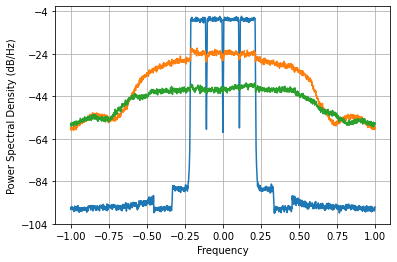

Loss =  4.818766408091831e-05 Accuracy =  -28.216041525006514 dbs


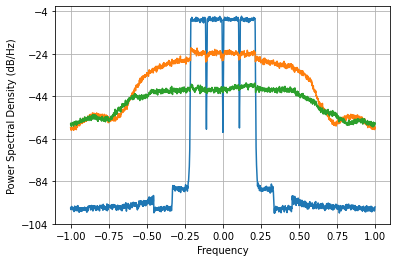

Loss =  4.7938606394383363e-05 Accuracy =  -28.238546220224414 dbs


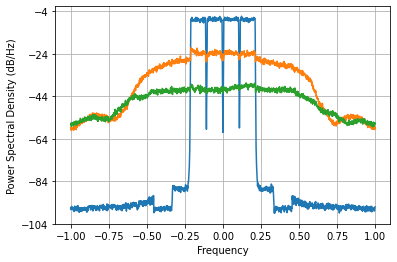

Loss =  4.769651078096988e-05 Accuracy =  -28.26053417123948 dbs


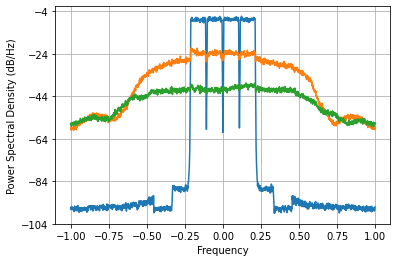

Loss =  4.7461333183679456e-05 Accuracy =  -28.28200093350882 dbs


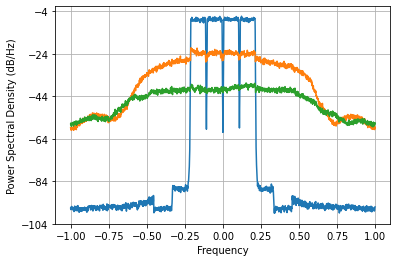

Loss =  4.723306552175535e-05 Accuracy =  -28.302938936040558 dbs


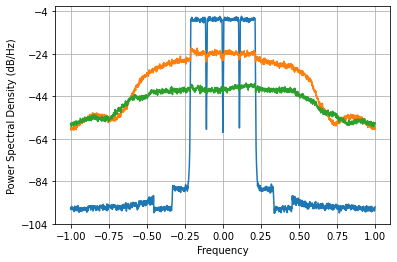

Loss =  4.701171773548961e-05 Accuracy =  -28.32333906761088 dbs


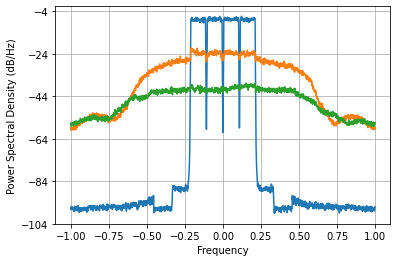

Loss =  4.6797305277055885e-05 Accuracy =  -28.343191808149438 dbs


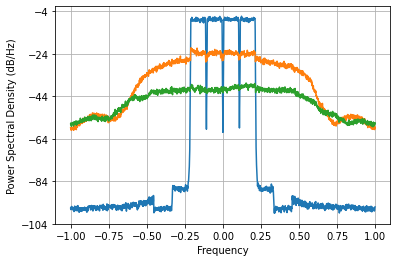

Loss =  4.658984090523887e-05 Accuracy =  -28.362487992641576 dbs


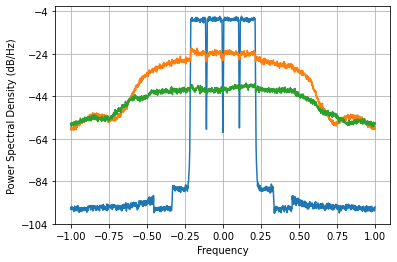

Loss =  4.638932919555908e-05 Accuracy =  -28.381219341602808 dbs



In [ ]:
net = Olga_Cell(D=2)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist10 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)

M_delays = 0
Br_delays = -1 3
Ol_delays = 2


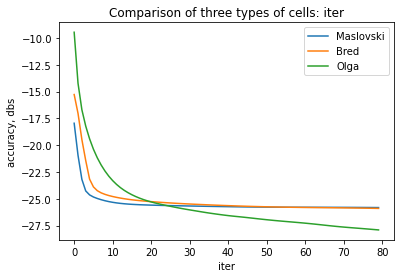

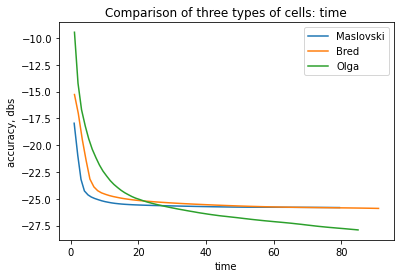

In [ ]:
Comparison_best_res(hist8, hist9, hist10, 0, const3, const4, 2)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


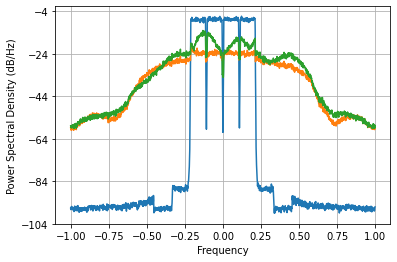

Loss =  0.0038885224284068882 Accuracy =  -9.147554184452446 dbs


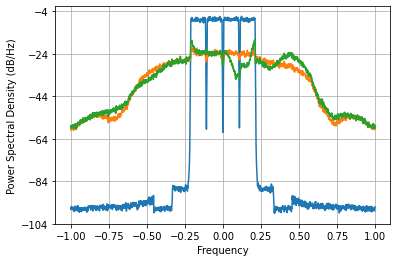

Loss =  0.0013528258374233056 Accuracy =  -13.7329813749239 dbs


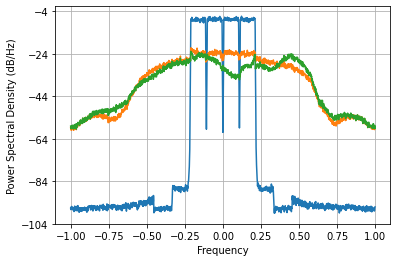

Loss =  0.0007927821227774943 Accuracy =  -16.05386178433297 dbs


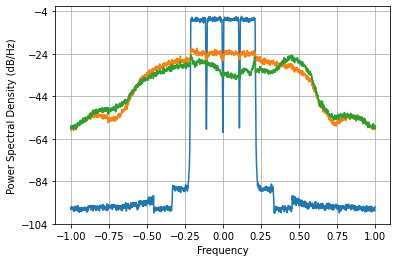

Loss =  0.0005511095211929715 Accuracy =  -17.63302112549265 dbs


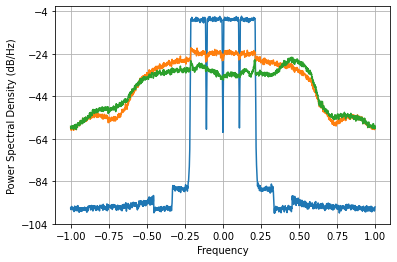

Loss =  0.00041370130289459037 Accuracy =  -18.878531380406322 dbs


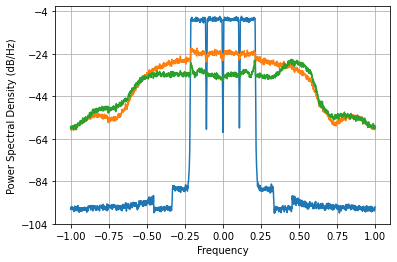

Loss =  0.00033123166177709615 Accuracy =  -19.844081832436718 dbs


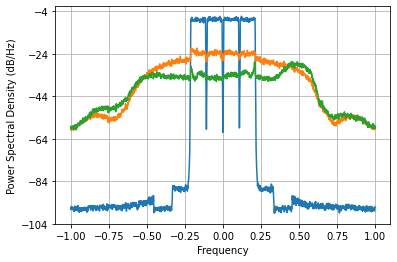

Loss =  0.0002773772816489656 Accuracy =  -20.614691390156157 dbs


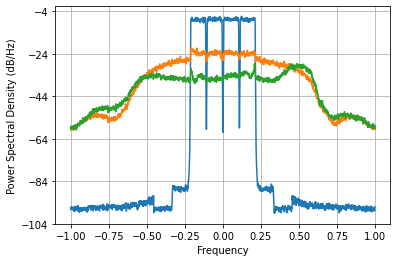

Loss =  0.00023996078868939282 Accuracy =  -21.243997460062136 dbs


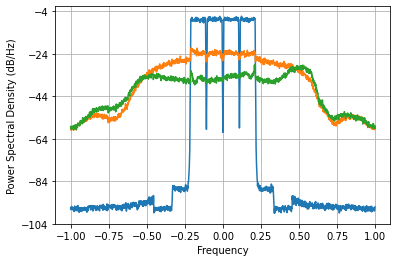

Loss =  0.00021364948856311604 Accuracy =  -21.748381691534725 dbs


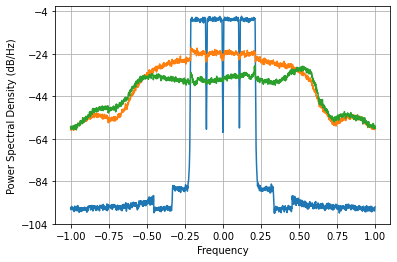

Loss =  0.00019494732529037398 Accuracy =  -22.14622745715654 dbs


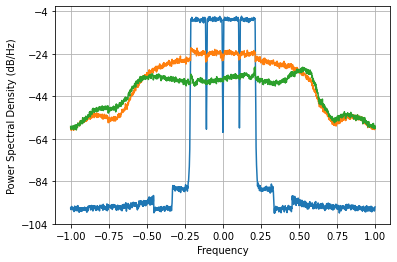

Loss =  0.00018118146756621704 Accuracy =  -22.464262535756014 dbs


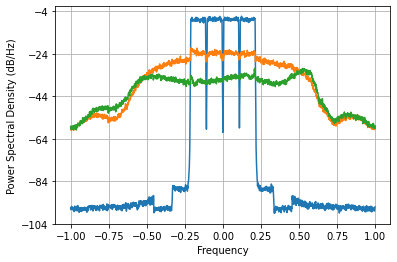

Loss =  0.00017050716939237667 Accuracy =  -22.727973819985053 dbs


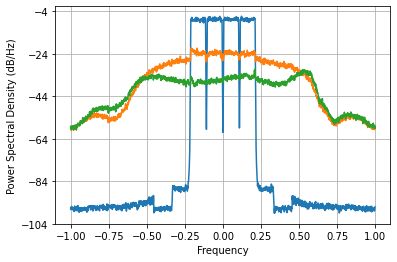

Loss =  0.00016182087518456804 Accuracy =  -22.95505481027076 dbs


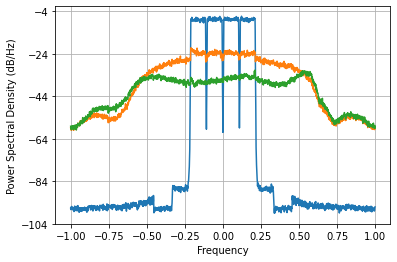

Loss =  0.00015448667263205258 Accuracy =  -23.156490073417014 dbs


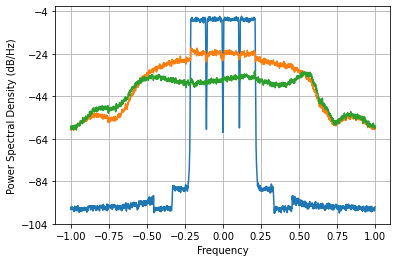

Loss =  0.0001481499972867061 Accuracy =  -23.338383788260536 dbs


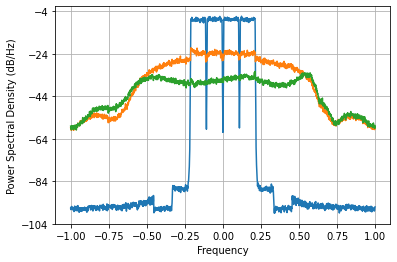

Loss =  0.00014261037199363313 Accuracy =  -23.503889139648706 dbs


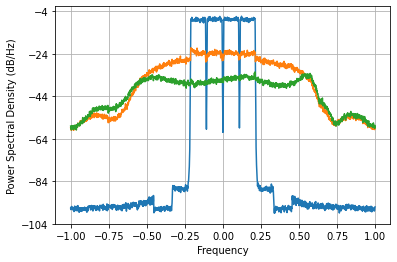

Loss =  0.00013774168548259688 Accuracy =  -23.654746337416157 dbs


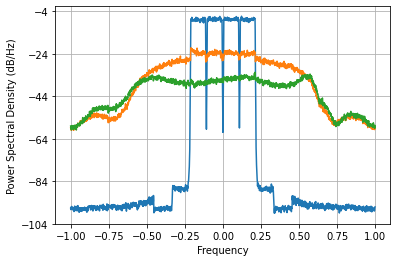

Loss =  0.00013346102684335062 Accuracy =  -23.79185564717725 dbs


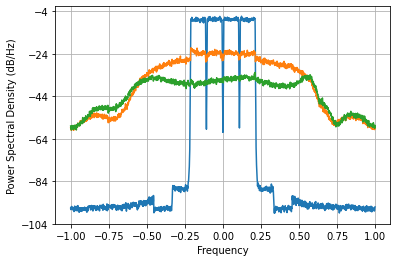

Loss =  0.00012971003894669887 Accuracy =  -23.91566436953925 dbs


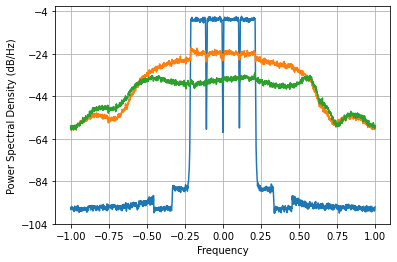

Loss =  0.0001264279497294922 Accuracy =  -24.026969316069305 dbs


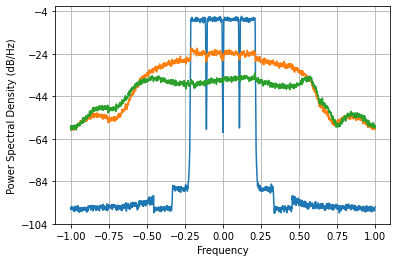

Loss =  0.0001235348915686578 Accuracy =  -24.127503883186925 dbs


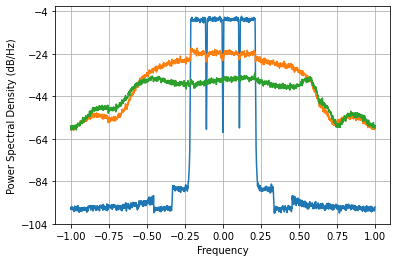

Loss =  0.00012094874106898817 Accuracy =  -24.219386744503367 dbs


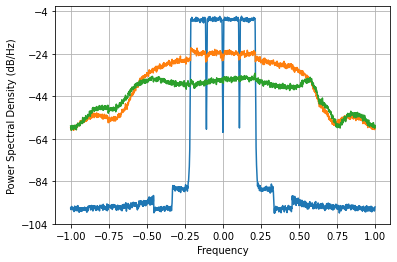

Loss =  0.00011861555981509122 Accuracy =  -24.303983638101435 dbs


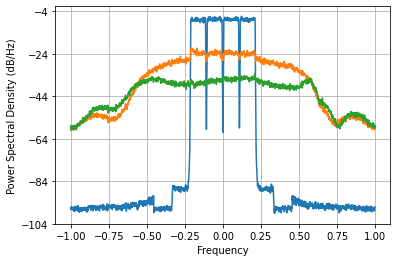

Loss =  0.00011651145148618787 Accuracy =  -24.381714140056104 dbs


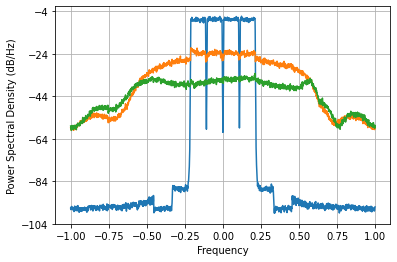

Loss =  0.00011462019375857971 Accuracy =  -24.452788884170467 dbs


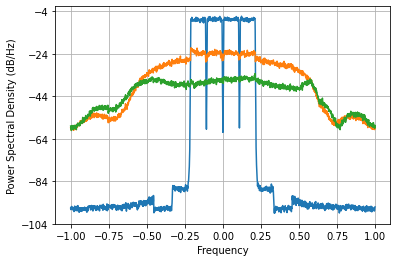

Loss =  0.00011291991896103606 Accuracy =  -24.51769468892308 dbs


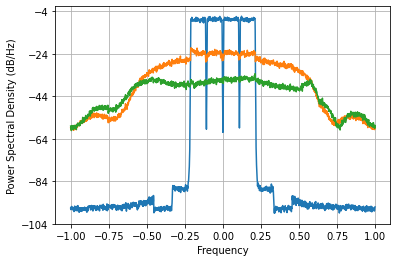

Loss =  0.00011138646600535503 Accuracy =  -24.57707601526152 dbs


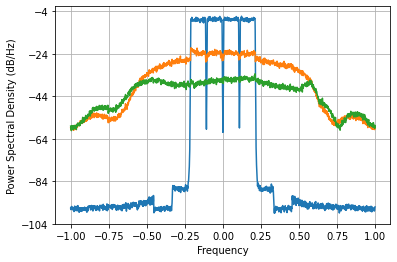

Loss =  0.00010999965859625449 Accuracy =  -24.631486894390363 dbs


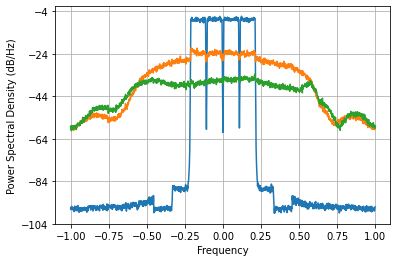

Loss =  0.00010874387946337743 Accuracy =  -24.68135204188776 dbs


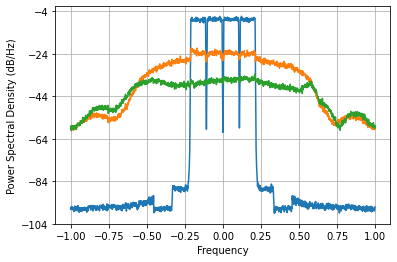

Loss =  0.00010760585594676764 Accuracy =  -24.727041202633924 dbs


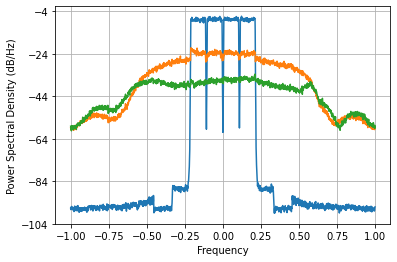

Loss =  0.00010657299596748676 Accuracy =  -24.76892851903854 dbs


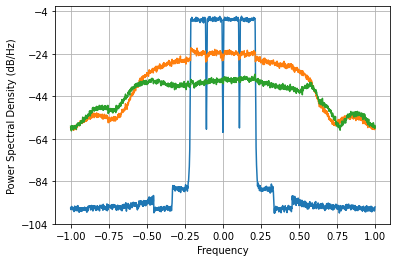

Loss =  0.00010563161657725862 Accuracy =  -24.80746100441788 dbs


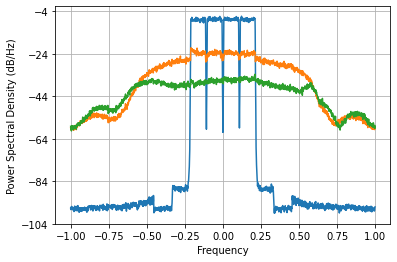

Loss =  0.00010476592098232024 Accuracy =  -24.843199915237832 dbs


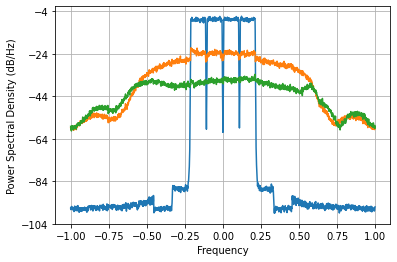

Loss =  0.00010395913800260343 Accuracy =  -24.8767735688143 dbs


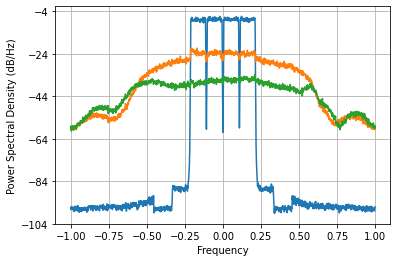

Loss =  0.0001031958307865677 Accuracy =  -24.908778749683933 dbs


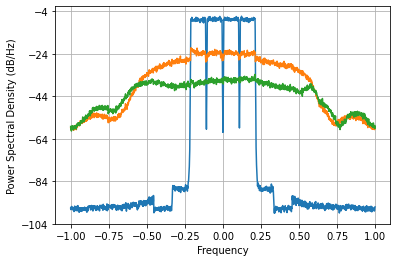

Loss =  0.00010246285989793994 Accuracy =  -24.93973553143615 dbs


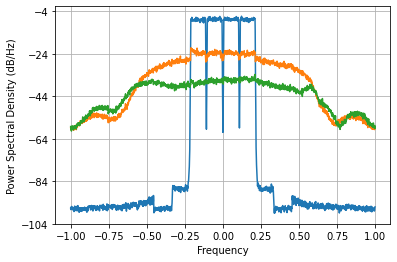

Loss =  0.00010174877061907714 Accuracy =  -24.970108561283382 dbs


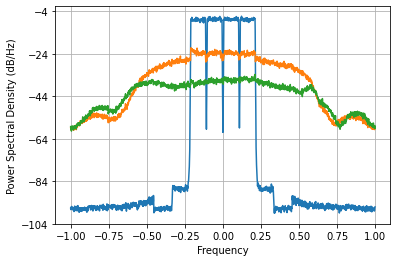

Loss =  0.00010104381947780999 Accuracy =  -25.00030272407141 dbs


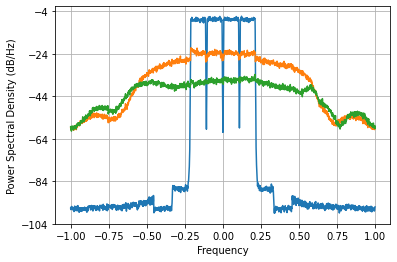

Loss =  0.00010034091056448664 Accuracy =  -25.030619888829126 dbs


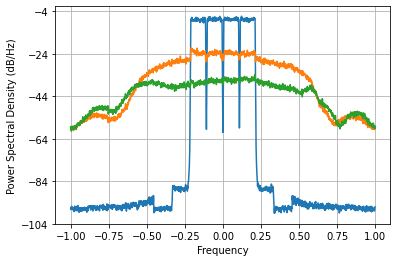

Loss =  9.963624961905724e-05 Accuracy =  -25.061226546764573 dbs


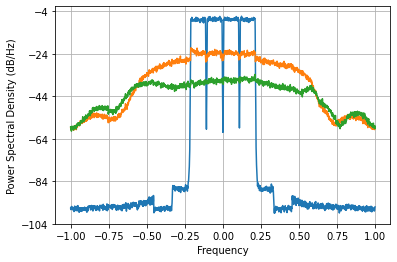

Loss =  9.893011095313835e-05 Accuracy =  -25.092115305360384 dbs


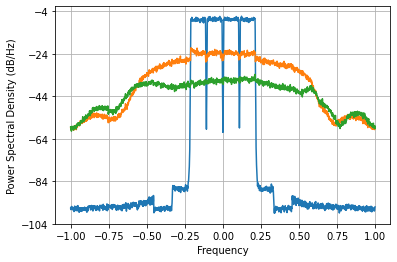

Loss =  9.822809028121791e-05 Accuracy =  -25.12304325972333 dbs


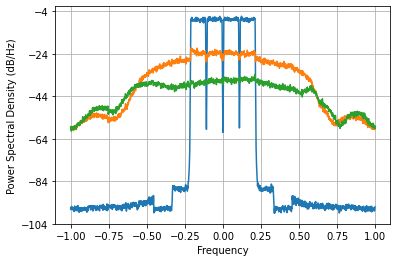

Loss =  9.754136508715054e-05 Accuracy =  -25.153511974578223 dbs


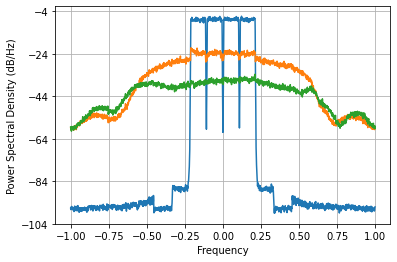

Loss =  9.688430586987945e-05 Accuracy =  -25.182865945923304 dbs


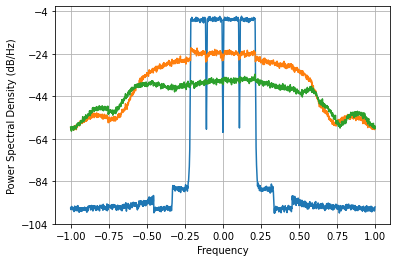

Loss =  9.6269452574945e-05 Accuracy =  -25.210515244311512 dbs


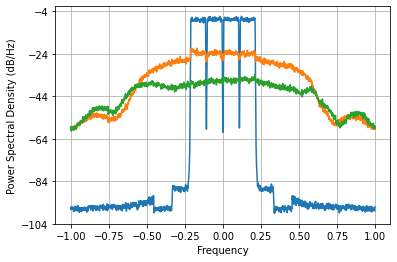

Loss =  9.570212624874697e-05 Accuracy =  -25.236184399266484 dbs


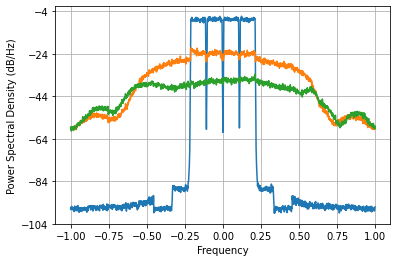

Loss =  9.517825322507965e-05 Accuracy =  -25.260022966149723 dbs


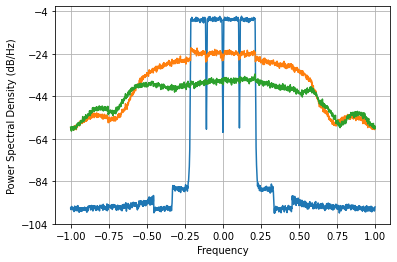

Loss =  9.468681333643781e-05 Accuracy =  -25.282505259741114 dbs


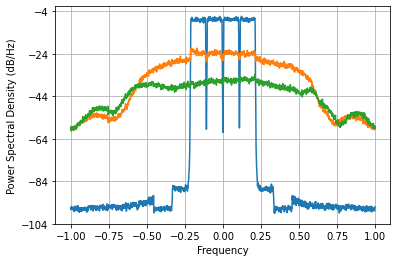

Loss =  9.421451155648717e-05 Accuracy =  -25.304222257688114 dbs


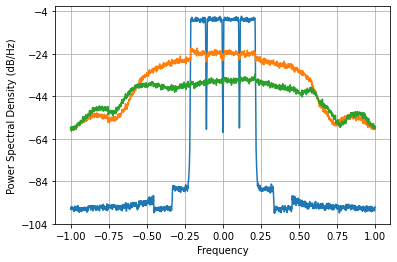

Loss =  9.37494100196398e-05 Accuracy =  -25.325714833660374 dbs


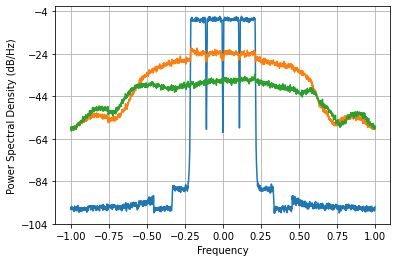

Loss =  9.328247671634484e-05 Accuracy =  -25.347399582917095 dbs


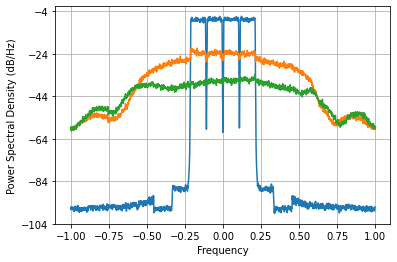

Loss =  9.280803196836754e-05 Accuracy =  -25.369544633078046 dbs


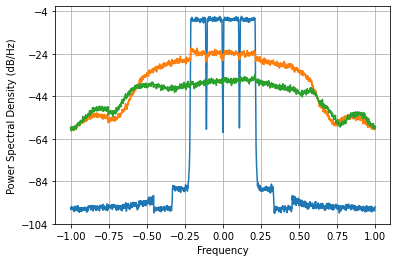

Loss =  9.23240140511632e-05 Accuracy =  -25.39225348268556 dbs


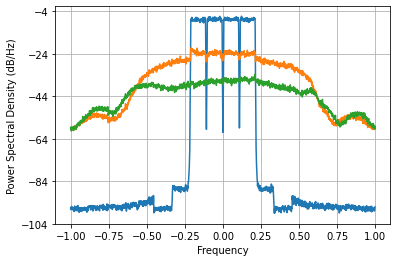

Loss =  9.18317595247929e-05 Accuracy =  -25.41547121075501 dbs


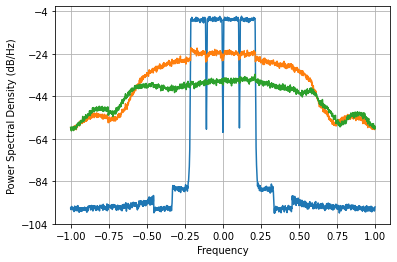

Loss =  9.133470075335839e-05 Accuracy =  -25.439042164868624 dbs


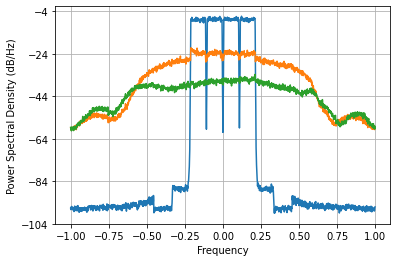

Loss =  9.083634945284983e-05 Accuracy =  -25.46280354292676 dbs


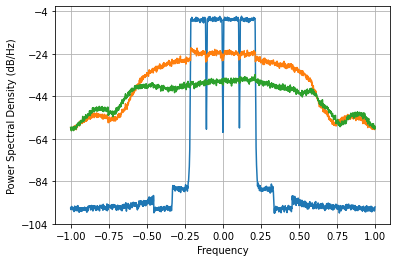

Loss =  9.033882975430053e-05 Accuracy =  -25.48665566260309 dbs


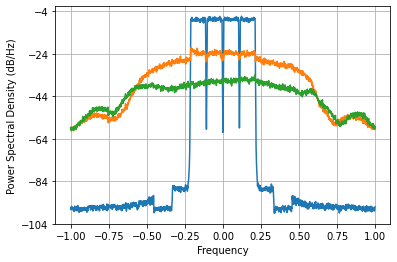

Loss =  8.984312101481037e-05 Accuracy =  -25.510551964360936 dbs


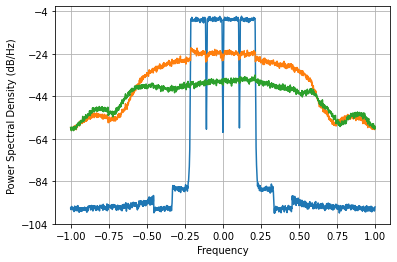

Loss =  8.935096777333385e-05 Accuracy =  -25.53440765914368 dbs


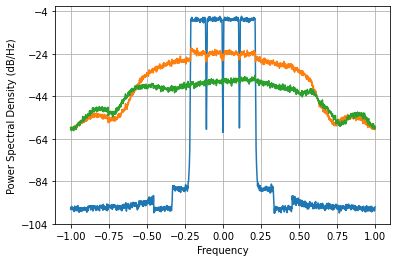

Loss =  8.886702093159098e-05 Accuracy =  -25.557994050285373 dbs


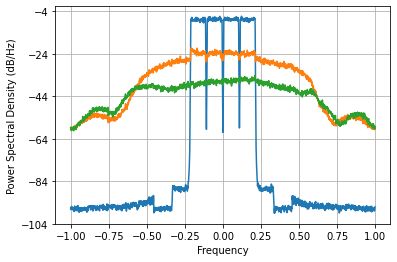

Loss =  8.83994695543386e-05 Accuracy =  -25.58090367674199 dbs


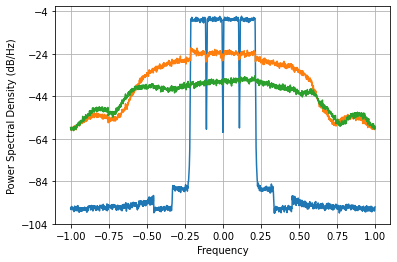

Loss =  8.795832888631465e-05 Accuracy =  -25.60263057049351 dbs


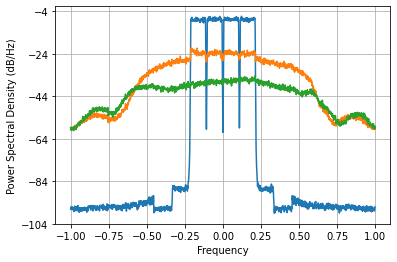

Loss =  8.755187240404046e-05 Accuracy =  -25.622745882499554 dbs


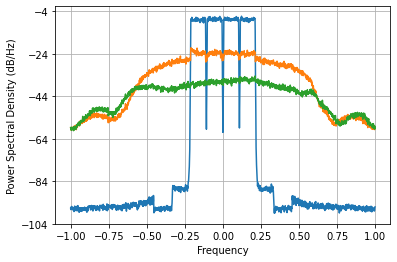

Loss =  8.718296094585759e-05 Accuracy =  -25.64108412056921 dbs


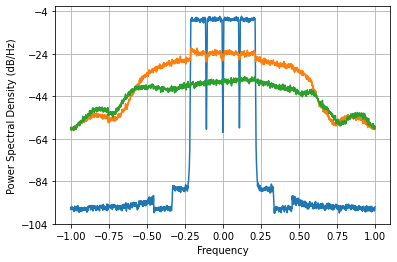

Loss =  8.684768942301702e-05 Accuracy =  -25.657817581271356 dbs


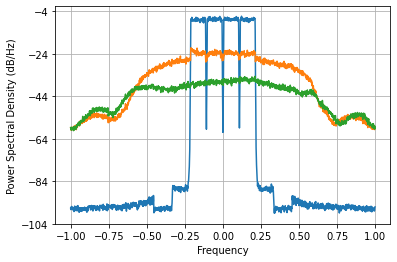

Loss =  8.653761880504464e-05 Accuracy =  -25.673350858377454 dbs


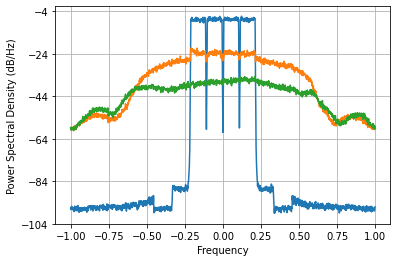

Loss =  8.624401376489903e-05 Accuracy =  -25.68811066468673 dbs


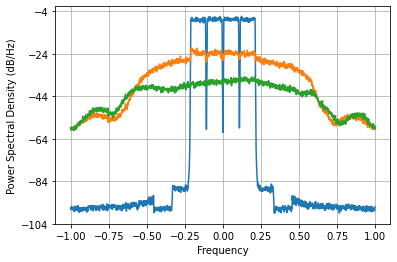

Loss =  8.596084815214176e-05 Accuracy =  -25.70239334783001 dbs


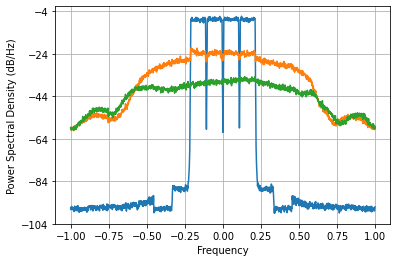

Loss =  8.568493865614448e-05 Accuracy =  -25.71635536543017 dbs


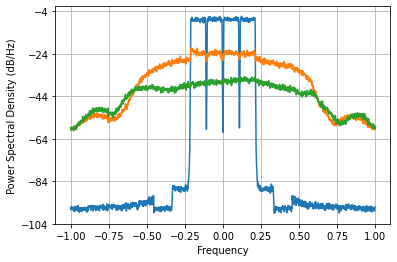

Loss =  8.54143264510103e-05 Accuracy =  -25.730093061538703 dbs


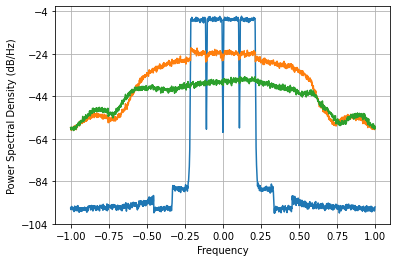

Loss =  8.514682083081242e-05 Accuracy =  -25.74371589555919 dbs


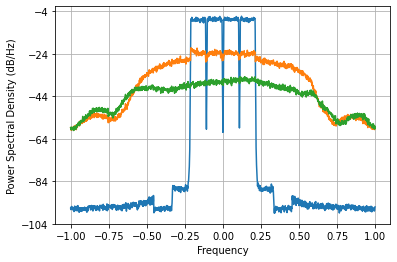

Loss =  8.487947497359325e-05 Accuracy =  -25.757373421377462 dbs


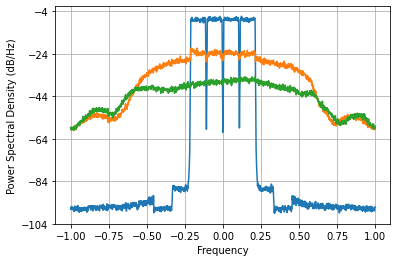

Loss =  8.460872514531788e-05 Accuracy =  -25.771248753858945 dbs


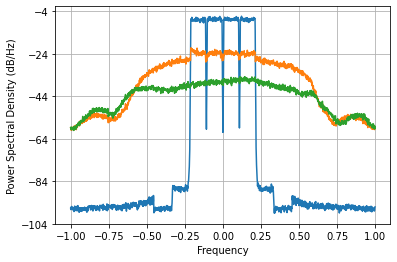

Loss =  8.433090085004842e-05 Accuracy =  -25.78553287061768 dbs


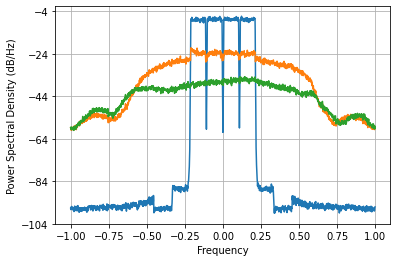

Loss =  8.40430425550664e-05 Accuracy =  -25.800382601918535 dbs


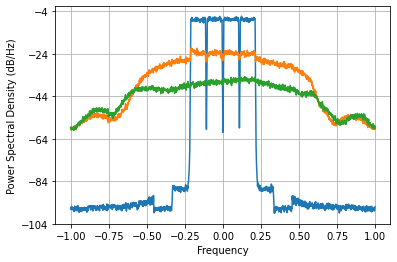

Loss =  8.374381396943828e-05 Accuracy =  -25.815872904797878 dbs


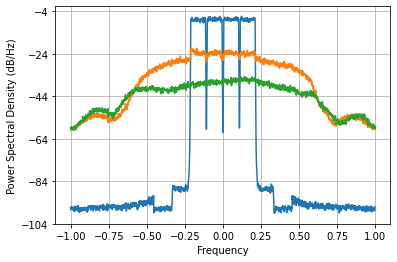

Loss =  8.34341105244912e-05 Accuracy =  -25.831963863151458 dbs


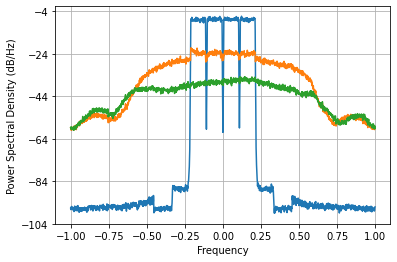

Loss =  8.311704612812852e-05 Accuracy =  -25.848499261267122 dbs


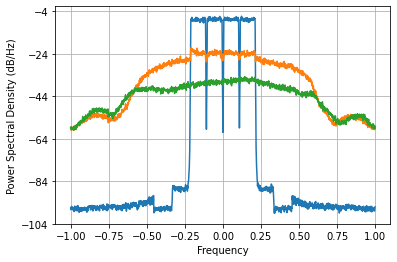

Loss =  8.279724586520389e-05 Accuracy =  -25.865241358627458 dbs


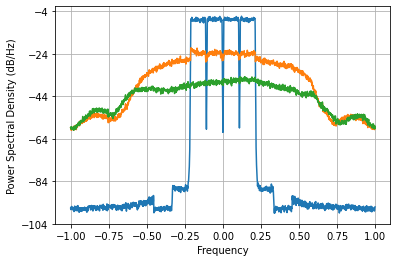

Loss =  8.247967535500591e-05 Accuracy =  -25.881930838187763 dbs


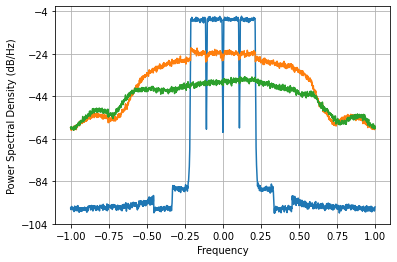

Loss =  8.216845356160924e-05 Accuracy =  -25.898349132083393 dbs


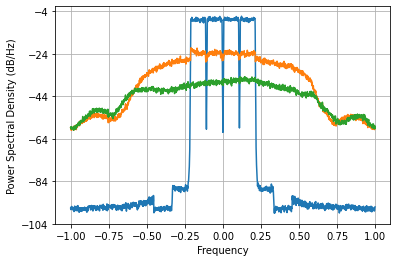

Loss =  8.186608305009548e-05 Accuracy =  -25.914360149773653 dbs


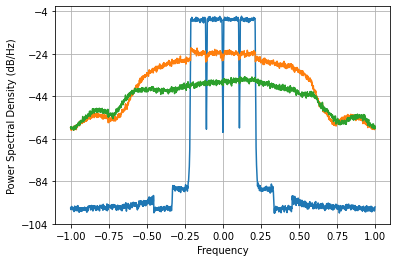

Loss =  8.157330051646078e-05 Accuracy =  -25.929919921475573 dbs


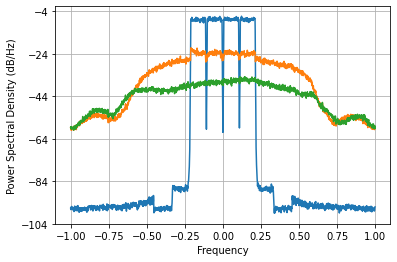

Loss =  8.12894508912691e-05 Accuracy =  -25.945058367764346 dbs


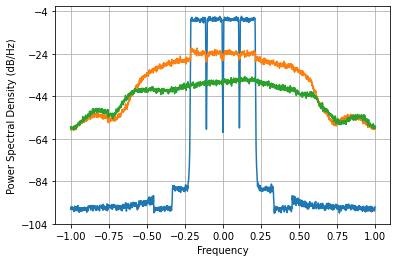

Loss =  8.101310152816225e-05 Accuracy =  -25.95984767546988 dbs


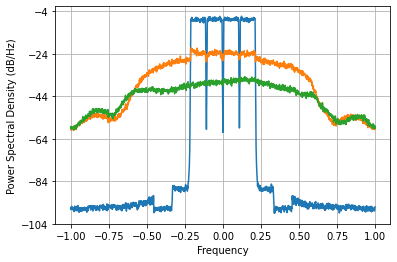

Loss =  8.074261238953719e-05 Accuracy =  -25.974372299913668 dbs


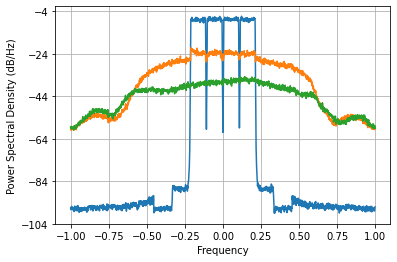

Loss =  8.047650268577321e-05 Accuracy =  -25.988709319544245 dbs


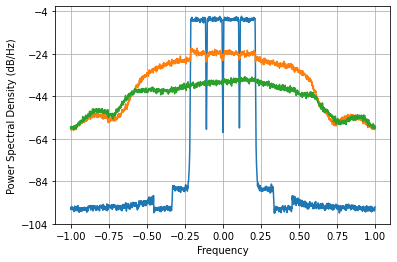

Loss =  8.021359719931768e-05 Accuracy =  -26.002920338641292 dbs


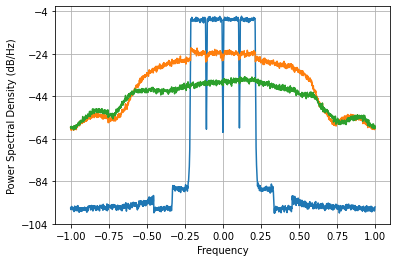

Loss =  7.995302547688832e-05 Accuracy =  -26.017051242963248 dbs


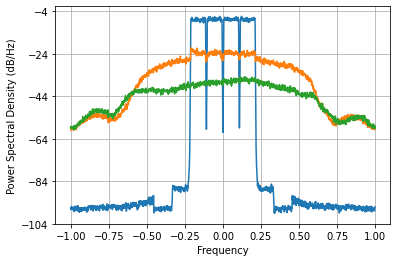

Loss =  7.969416509190786e-05 Accuracy =  -26.031135015424624 dbs


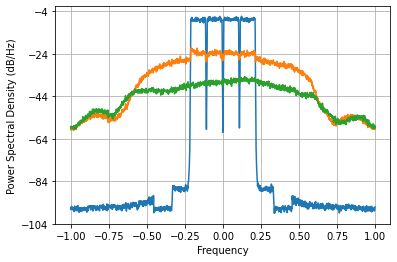

Loss =  7.94365871796313e-05 Accuracy =  -26.045194493188923 dbs


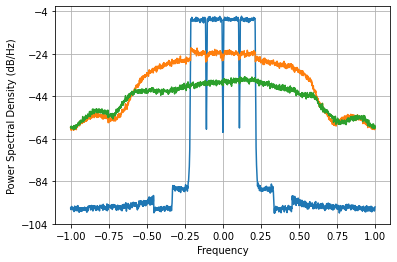

Loss =  7.918001966509149e-05 Accuracy =  -26.059244214109782 dbs


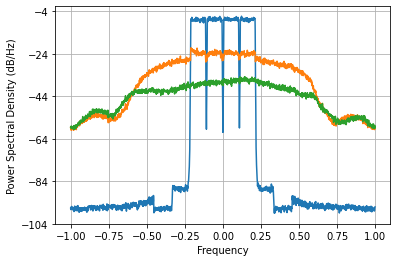

Loss =  7.892432143139716e-05 Accuracy =  -26.073291700469028 dbs


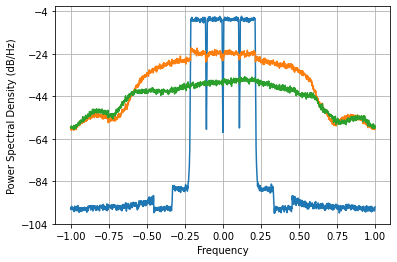

Loss =  7.866945994468241e-05 Accuracy =  -26.087338578823864 dbs


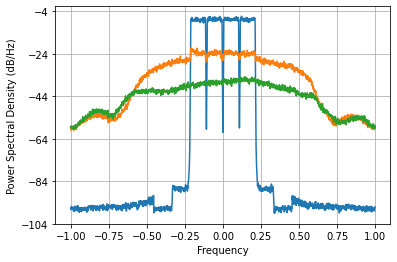

Loss =  7.84154901770268e-05 Accuracy =  -26.10138165101906 dbs


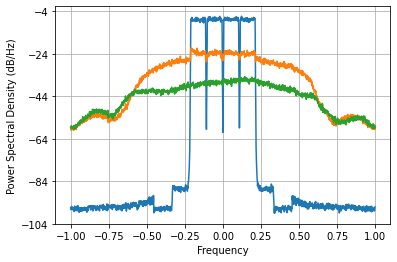

Loss =  7.816253503887859e-05 Accuracy =  -26.115413903129507 dbs


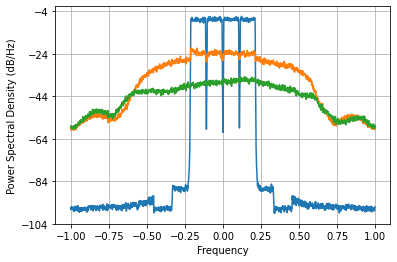

Loss =  7.791076799728155e-05 Accuracy =  -26.129425413055444 dbs


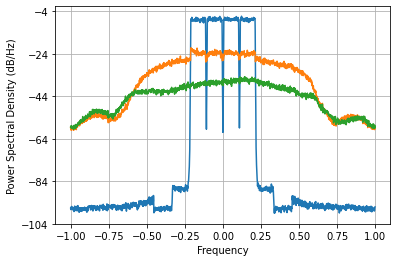

Loss =  7.766039911224476e-05 Accuracy =  -26.14340408546708 dbs


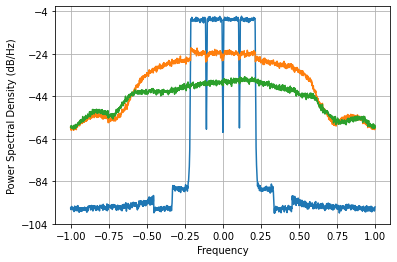

Loss =  7.741166595068581e-05 Accuracy =  -26.157336128240534 dbs


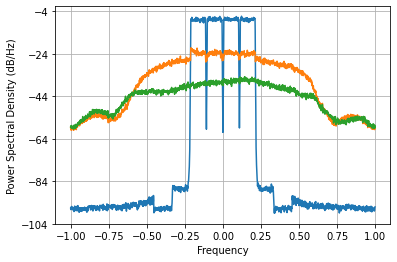

Loss =  7.716483036895558e-05 Accuracy =  -26.171206208718782 dbs



In [ ]:
net = Olga_Cell(D=0)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist10 = train(train_queue, valid_queue, net, loss_fn, optimizer,100,scheduler,save_flag=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


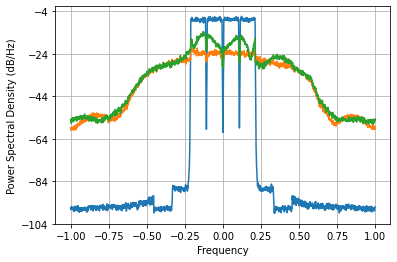

Loss =  0.003619200052044144 Accuracy =  -9.459274371977134 dbs


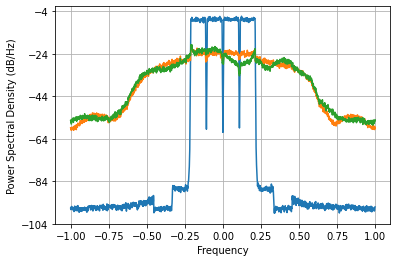

Loss =  0.001209536886042202 Accuracy =  -14.21920909541952 dbs


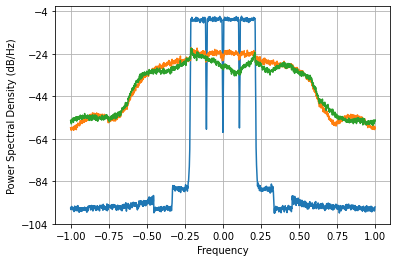

Loss =  0.0006852560957856554 Accuracy =  -16.68687119135878 dbs


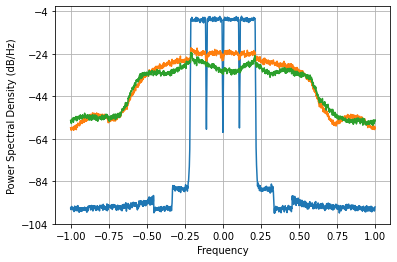

Loss =  0.00048214099872588475 Accuracy =  -18.213659635243495 dbs


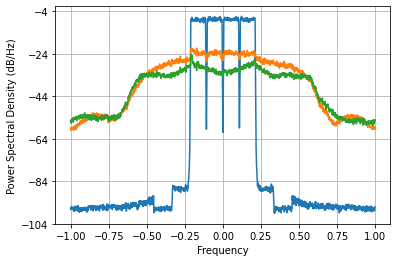

Loss =  0.00036686653528700383 Accuracy =  -19.400319284592168 dbs


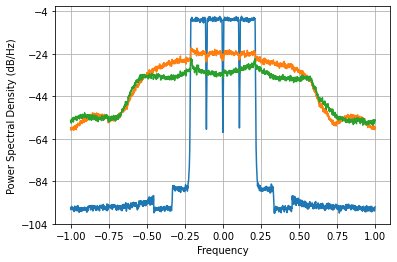

Loss =  0.0002934880919044992 Accuracy =  -20.369495419737063 dbs


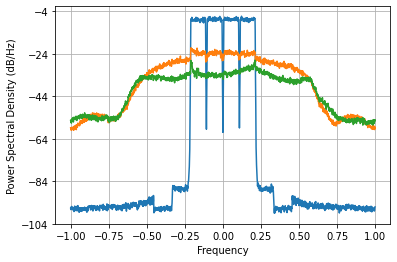

Loss =  0.00024403821275503063 Accuracy =  -21.170821909672554 dbs


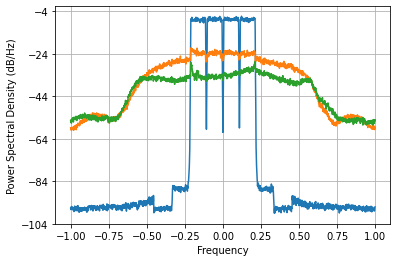

Loss =  0.00020917628888839882 Accuracy =  -21.840275730156897 dbs


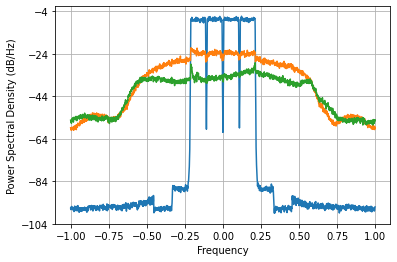

Loss =  0.0001835303274988093 Accuracy =  -22.408321871077813 dbs


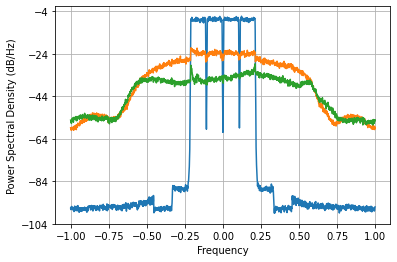

Loss =  0.00016419964424164868 Accuracy =  -22.891678148552167 dbs


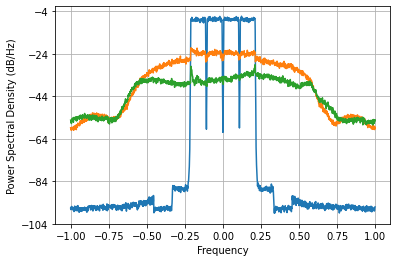

Loss =  0.00014936666294073698 Accuracy =  -23.30286348328267 dbs


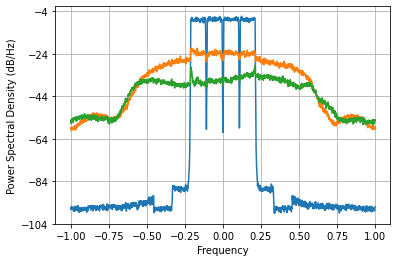

Loss =  0.0001377762306561993 Accuracy =  -23.653657277324474 dbs


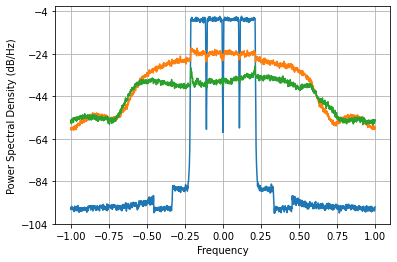

Loss =  0.00012859627038540002 Accuracy =  -23.95311653547377 dbs


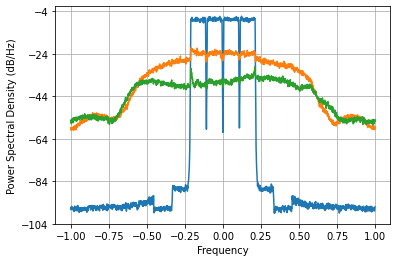

Loss =  0.00012123437991911627 Accuracy =  -24.20914231182426 dbs


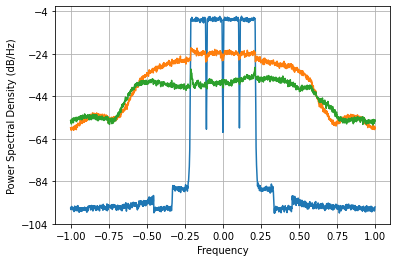

Loss =  0.00011523536934850113 Accuracy =  -24.42954228544626 dbs


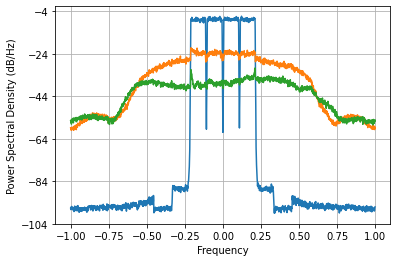

Loss =  0.00011026550936346214 Accuracy =  -24.62100338686698 dbs


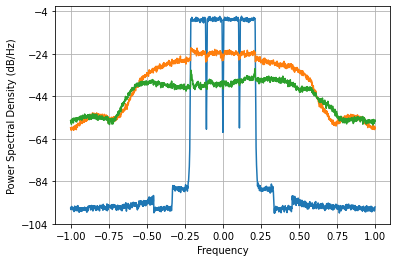

Loss =  0.00010606917020847368 Accuracy =  -24.78950855359807 dbs


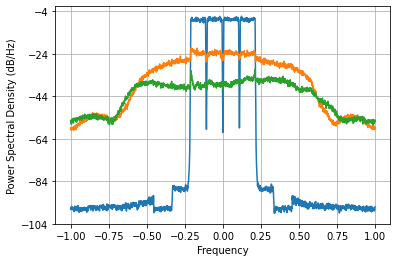

Loss =  0.0001024833161106549 Accuracy =  -24.938868570119258 dbs


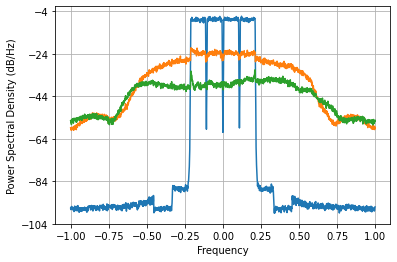

Loss =  9.942224870705095e-05 Accuracy =  -25.07056445012399 dbs


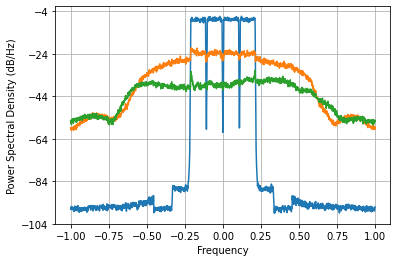

Loss =  9.680273924254985e-05 Accuracy =  -25.18652379905749 dbs


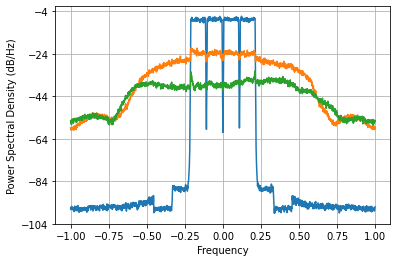

Loss =  9.451923522410931e-05 Accuracy =  -25.29019827685721 dbs


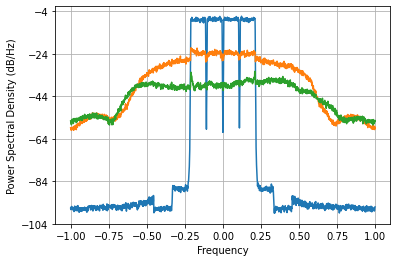

Loss =  9.250048633150614e-05 Accuracy =  -25.383960105920753 dbs


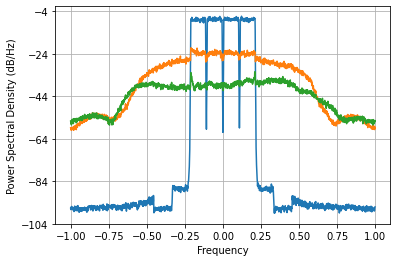

Loss =  9.069238143956494e-05 Accuracy =  -25.469692207497026 dbs


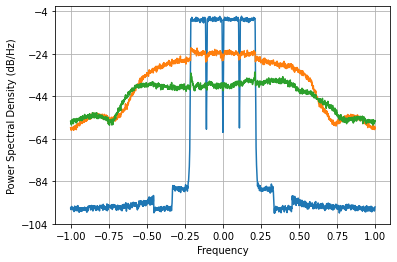

Loss =  8.903744069296194e-05 Accuracy =  -25.5496735861516 dbs


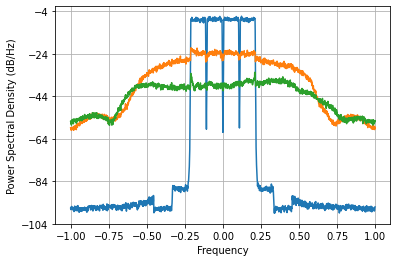

Loss =  8.749088775964205e-05 Accuracy =  -25.62577203400561 dbs


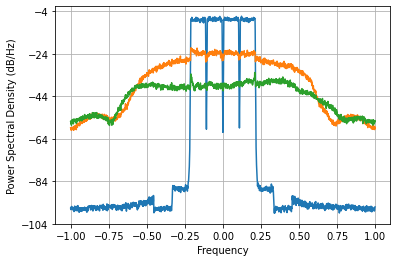

Loss =  8.602112557571921e-05 Accuracy =  -25.699349057437537 dbs


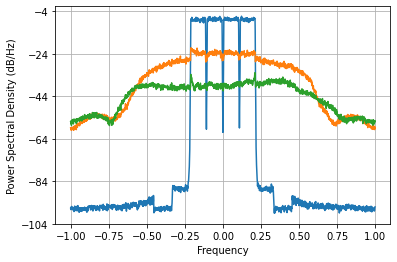

Loss =  8.461297220011151e-05 Accuracy =  -25.771030759063883 dbs


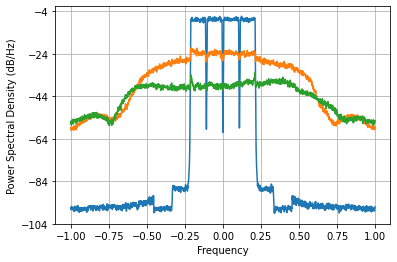

Loss =  8.326733444055063e-05 Accuracy =  -25.840653644712614 dbs


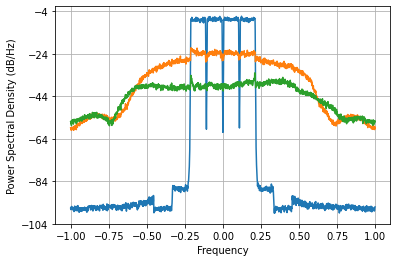

Loss =  8.199524049514664e-05 Accuracy =  -25.907513826787216 dbs


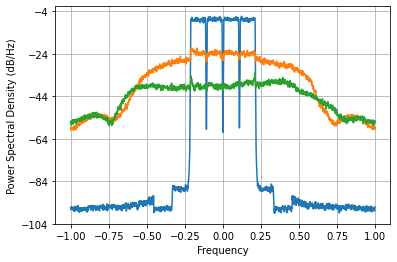

Loss =  8.080331819696797e-05 Accuracy =  -25.971108311977616 dbs


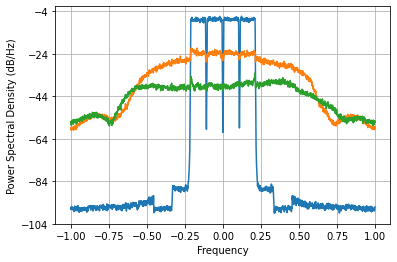

Loss =  7.96802811316701e-05 Accuracy =  -26.031891689719195 dbs


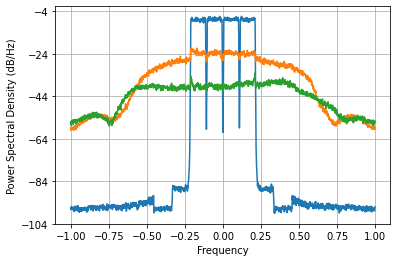

Loss =  7.859839680511331e-05 Accuracy =  -26.091263389922567 dbs


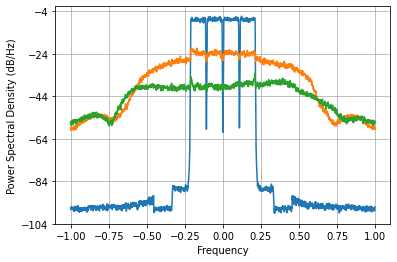

Loss =  7.753255273238876e-05 Accuracy =  -26.15055943488246 dbs


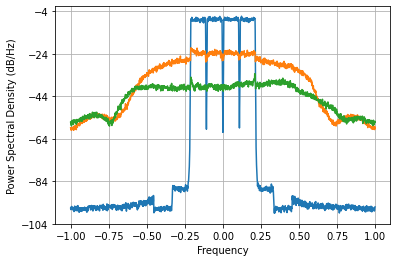

Loss =  7.648061450997729e-05 Accuracy =  -26.209886579167915 dbs


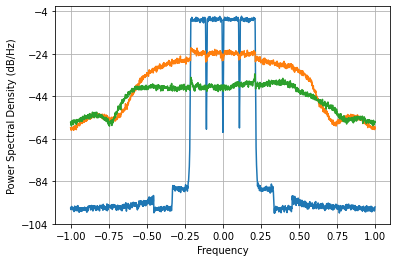

Loss =  7.546499541625925e-05 Accuracy =  -26.267944766858342 dbs


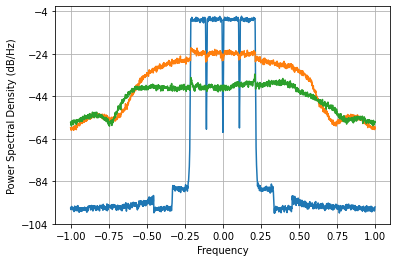

Loss =  7.451011917410762e-05 Accuracy =  -26.323247686642112 dbs


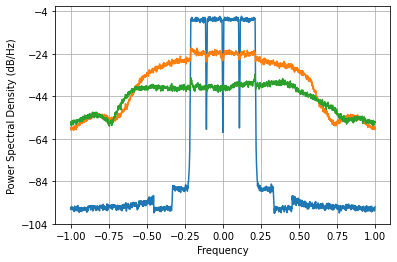

Loss =  7.361864946582609e-05 Accuracy =  -26.37552180637072 dbs


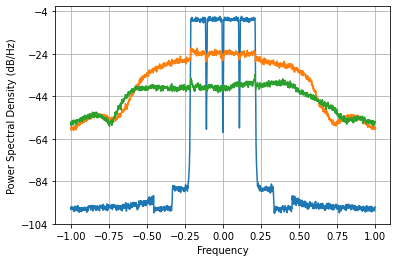

Loss =  7.27747696243187e-05 Accuracy =  -26.4255918737705 dbs


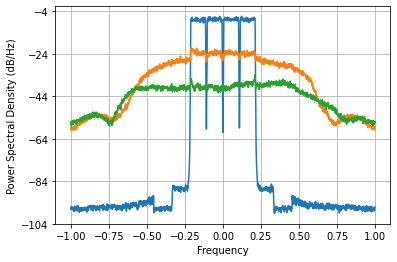

Loss =  7.196654132394064e-05 Accuracy =  -26.47409395475265 dbs


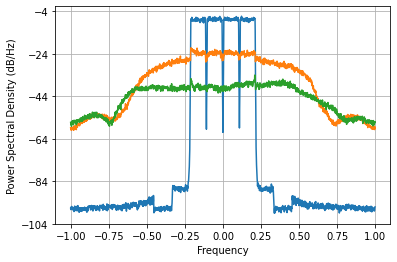

Loss =  7.119857872904933e-05 Accuracy =  -26.520687023813213 dbs


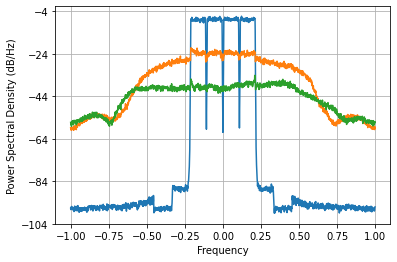

Loss =  7.048749686564192e-05 Accuracy =  -26.5642793840354 dbs


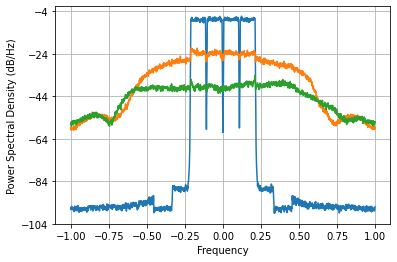

Loss =  6.984447251691331e-05 Accuracy =  -26.604079848907286 dbs


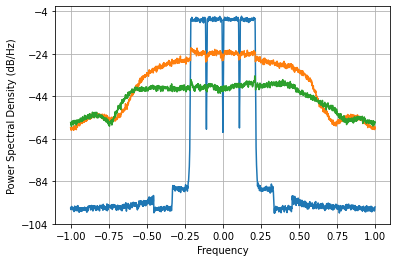

Loss =  6.925631353120294e-05 Accuracy =  -26.640806560740703 dbs


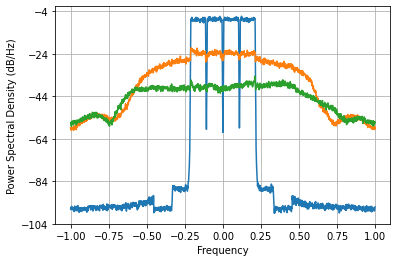

Loss =  6.868864783201568e-05 Accuracy =  -26.676550595165498 dbs


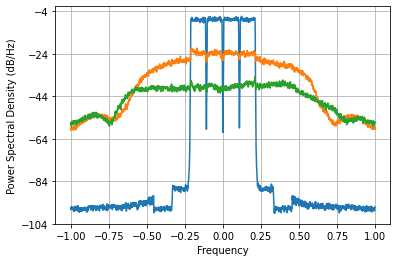

Loss =  6.811028489498778e-05 Accuracy =  -26.713273298139022 dbs


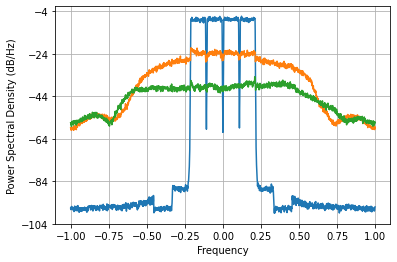

Loss =  6.750985371908454e-05 Accuracy =  -26.7517285973131 dbs


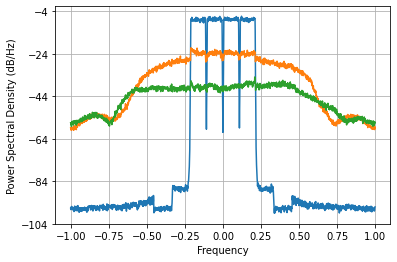

Loss =  6.689341129224008e-05 Accuracy =  -26.791566829164957 dbs


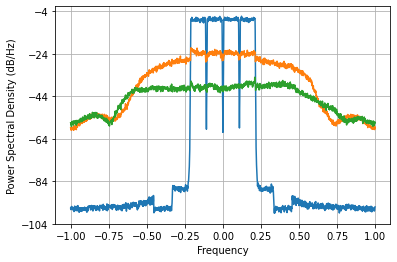

Loss =  6.627447451246243e-05 Accuracy =  -26.831937337722422 dbs


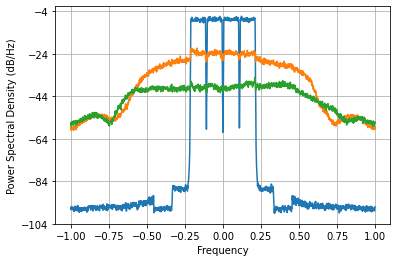

Loss =  6.566648438546904e-05 Accuracy =  -26.871962607868355 dbs


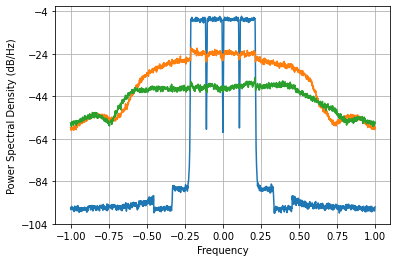

Loss =  6.507937766844516e-05 Accuracy =  -26.910966354113125 dbs


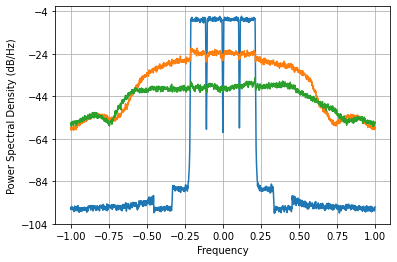

Loss =  6.451878057373058e-05 Accuracy =  -26.948538762029383 dbs


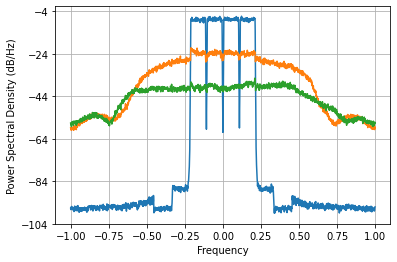

Loss =  6.398653608479637e-05 Accuracy =  -26.984514264422145 dbs


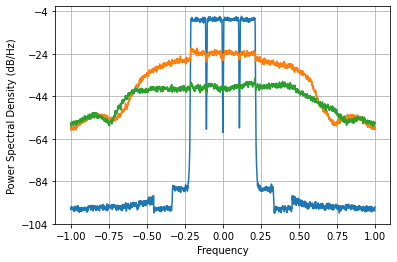

Loss =  6.348173319143093e-05 Accuracy =  -27.01891251245641 dbs


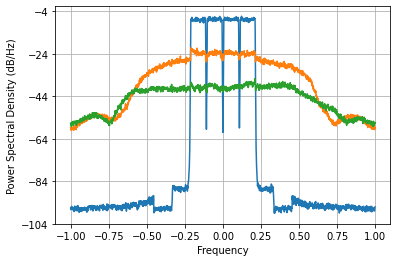

Loss =  6.30016747271298e-05 Accuracy =  -27.051879325507784 dbs


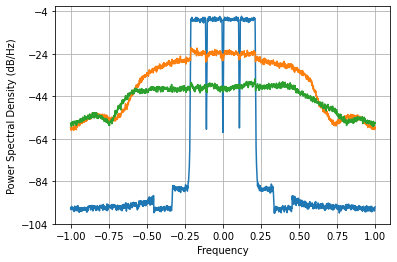

Loss =  6.254248477923963e-05 Accuracy =  -27.083648951526726 dbs


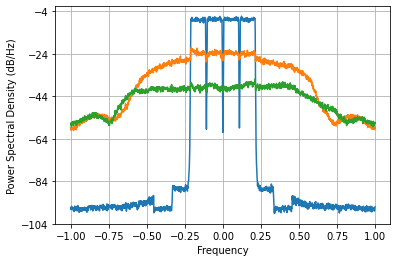

Loss =  6.209934104746854e-05 Accuracy =  -27.114530349008113 dbs


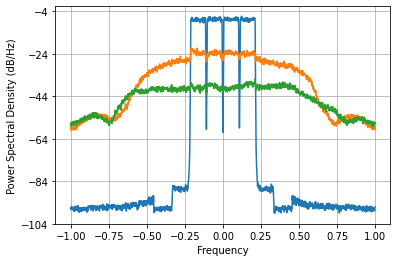

Loss =  6.16665149115299e-05 Accuracy =  -27.14490621758931 dbs


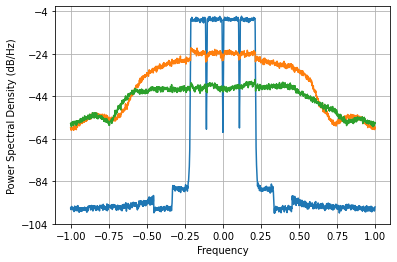

Loss =  6.123746401370509e-05 Accuracy =  -27.17522829437629 dbs


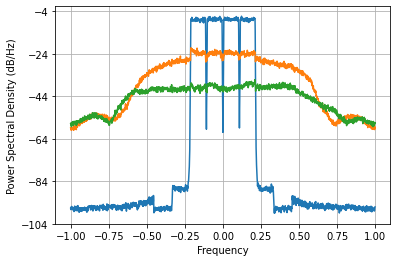

Loss =  6.080518619538917e-05 Accuracy =  -27.20599403994715 dbs


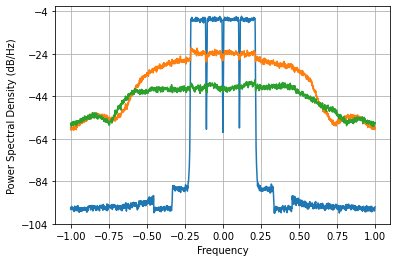

Loss =  6.036294525955018e-05 Accuracy =  -27.237696047502823 dbs


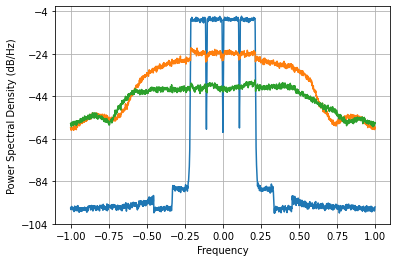

Loss =  5.990530725971379e-05 Accuracy =  -27.270747266444367 dbs


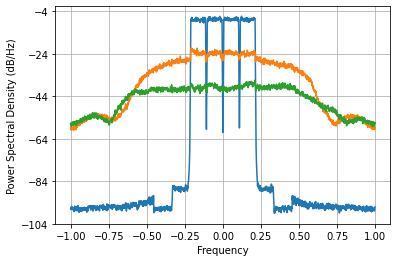

Loss =  5.9429219197278604e-05 Accuracy =  -27.30540002311583 dbs


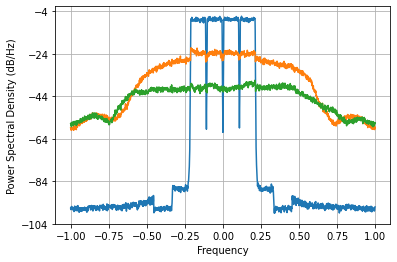

Loss =  5.893476511881484e-05 Accuracy =  -27.341684696734823 dbs


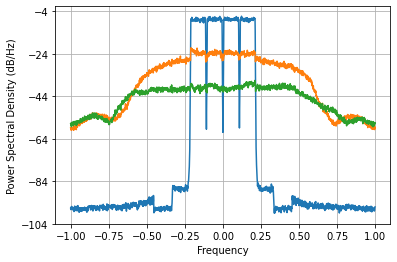

Loss =  5.8425351364714644e-05 Accuracy =  -27.379386938088594 dbs


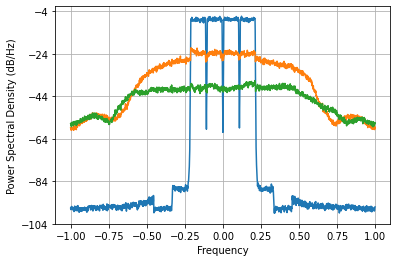

Loss =  5.790730663216142e-05 Accuracy =  -27.418066610640018 dbs


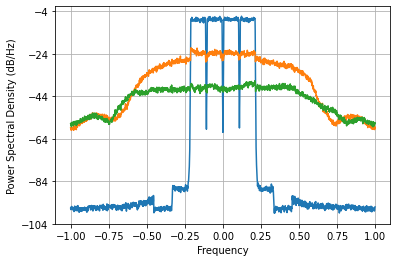

Loss =  5.738903516720177e-05 Accuracy =  -27.457111033018368 dbs


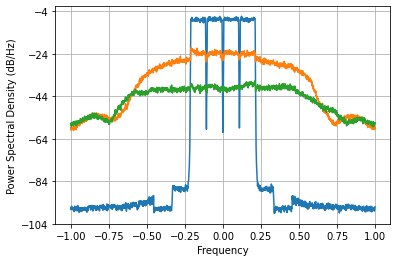

Loss =  5.687986221085222e-05 Accuracy =  -27.495814910259316 dbs


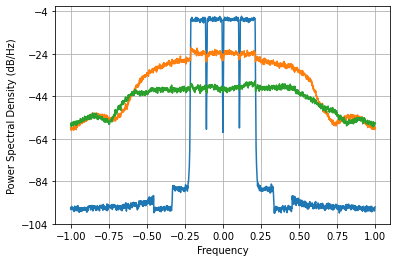

Loss =  5.638867015489089e-05 Accuracy =  -27.53348174185409 dbs


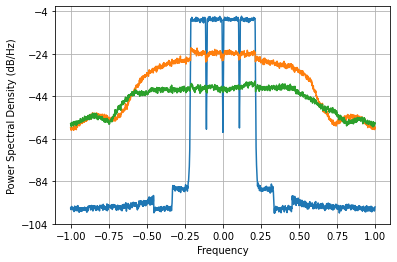

Loss =  5.592247214073463e-05 Accuracy =  -27.56953664856399 dbs


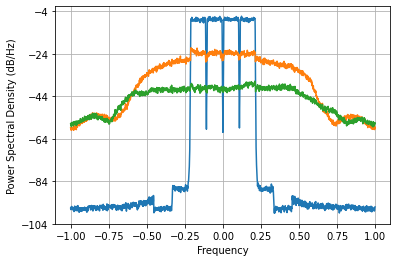

Loss =  5.548519197892102e-05 Accuracy =  -27.603629336544255 dbs


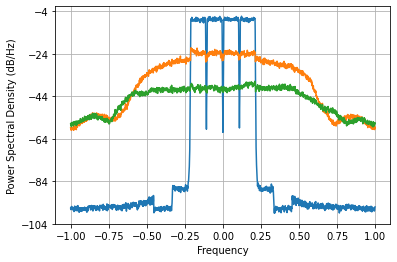

Loss =  5.507697318755047e-05 Accuracy =  -27.635699615533227 dbs


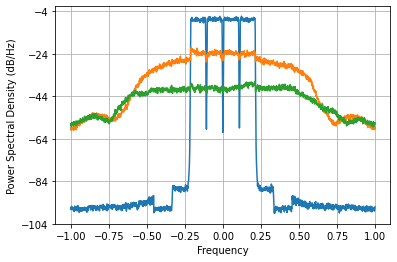

Loss =  5.469423904899354e-05 Accuracy =  -27.6659844223768 dbs


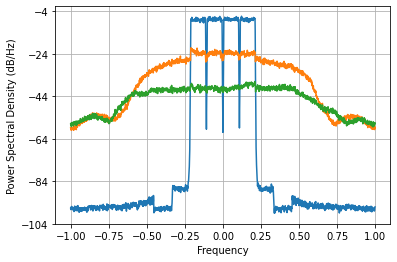

Loss =  5.433053521352804e-05 Accuracy =  -27.69496043371117 dbs


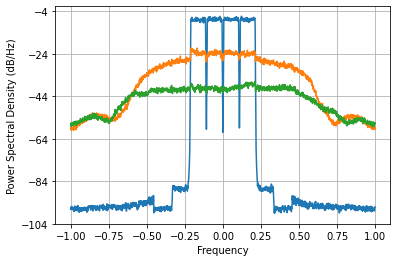

Loss =  5.397799669631754e-05 Accuracy =  -27.723232642869192 dbs


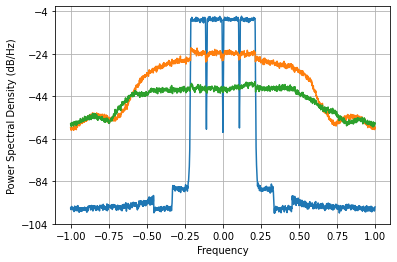

Loss =  5.3629101667848014e-05 Accuracy =  -27.75139504458788 dbs


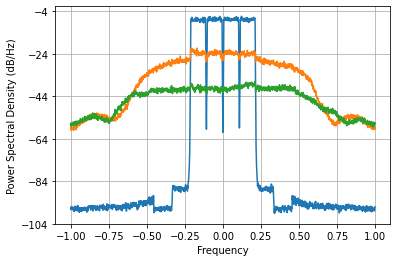

Loss =  5.327823672256754e-05 Accuracy =  -27.779901835427108 dbs


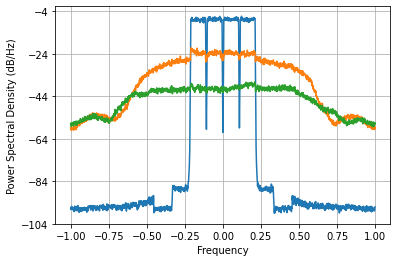

Loss =  5.2922620078796624e-05 Accuracy =  -27.80898689706483 dbs


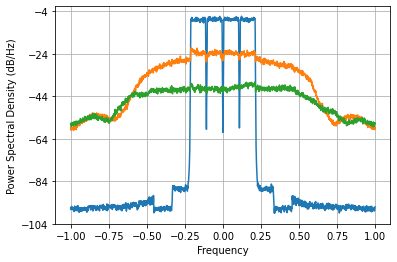

Loss =  5.256236578727726e-05 Accuracy =  -27.8386512247218 dbs


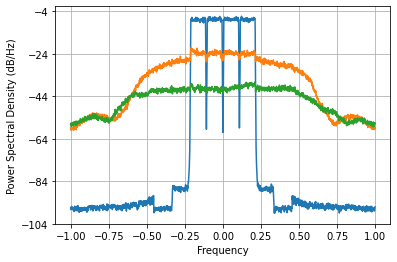

Loss =  5.21998052475089e-05 Accuracy =  -27.868711439942103 dbs


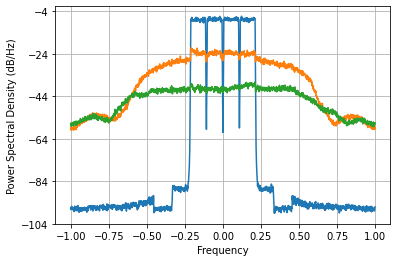

Loss =  5.1838424435988194e-05 Accuracy =  -27.8988823346217 dbs


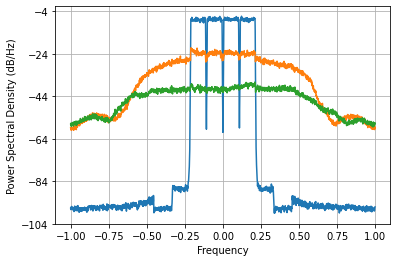

Loss =  5.148182203992579e-05 Accuracy =  -27.928861176733967 dbs


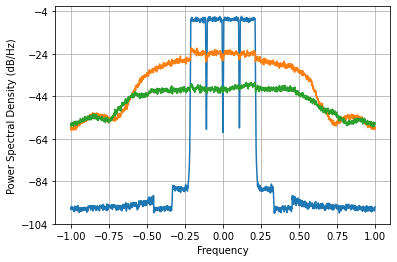

Loss =  5.113296959113084e-05 Accuracy =  -27.958390112041908 dbs


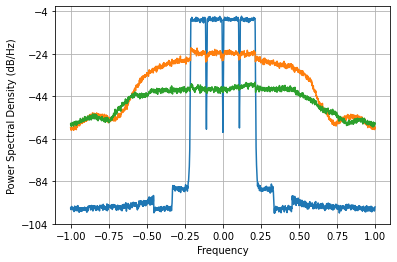

Loss =  5.0793864452001626e-05 Accuracy =  -27.987287710099732 dbs


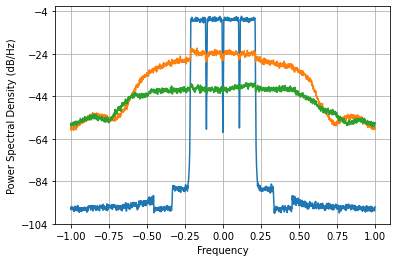

Loss =  5.0465514112949355e-05 Accuracy =  -28.015453247399208 dbs


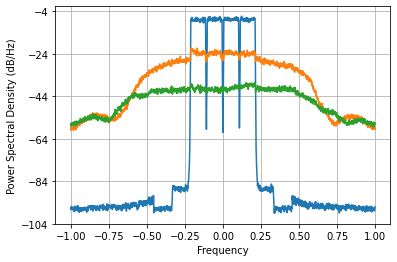

Loss =  5.014812208962627e-05 Accuracy =  -28.042853521709404 dbs


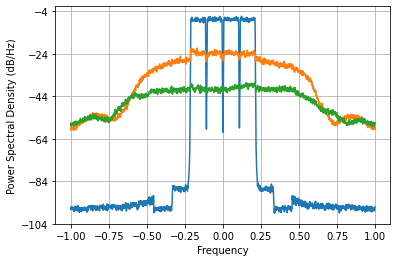

Loss =  4.9841349591613896e-05 Accuracy =  -28.069502331604113 dbs


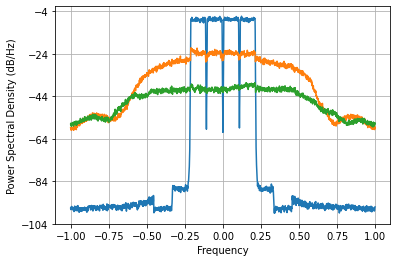

Loss =  4.954456643807984e-05 Accuracy =  -28.095439944128998 dbs


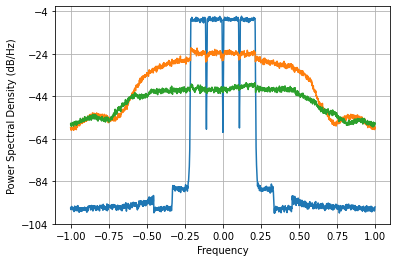

Loss =  4.925704805797877e-05 Accuracy =  -28.120716453837908 dbs


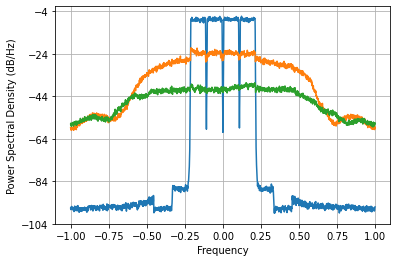

Loss =  4.897810721731803e-05 Accuracy =  -28.145380290959015 dbs


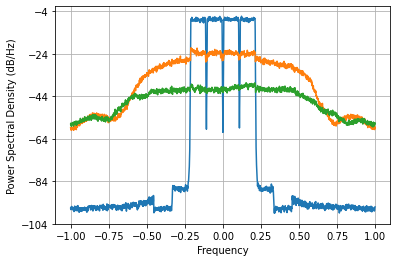

Loss =  4.870716681986749e-05 Accuracy =  -28.169471582596152 dbs


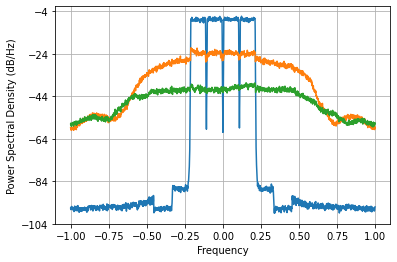

Loss =  4.844378738839447e-05 Accuracy =  -28.193019372712854 dbs


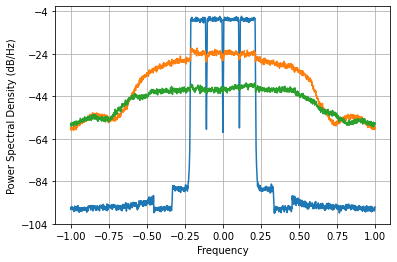

Loss =  4.818766408091831e-05 Accuracy =  -28.21604152500651 dbs


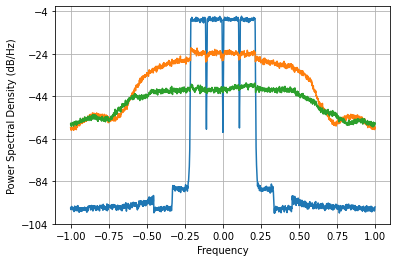

Loss =  4.7938606394383384e-05 Accuracy =  -28.238546220224414 dbs


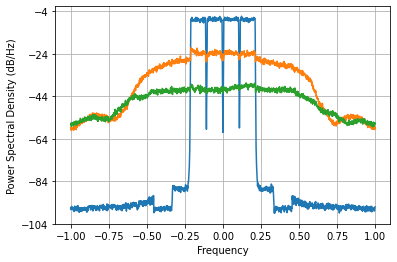

Loss =  4.7696510780969914e-05 Accuracy =  -28.260534171239478 dbs


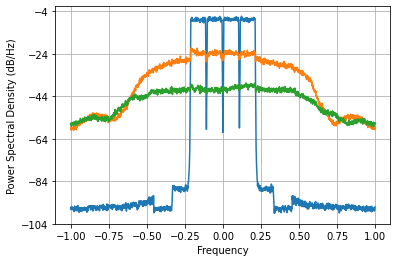

Loss =  4.746133318367944e-05 Accuracy =  -28.28200093350882 dbs


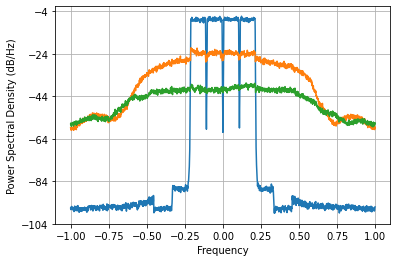

Loss =  4.723306552175535e-05 Accuracy =  -28.302938936040558 dbs


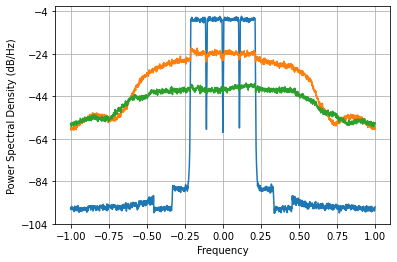

Loss =  4.701171773548961e-05 Accuracy =  -28.32333906761088 dbs


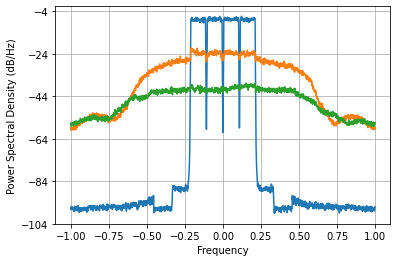

Loss =  4.67973052770559e-05 Accuracy =  -28.343191808149435 dbs


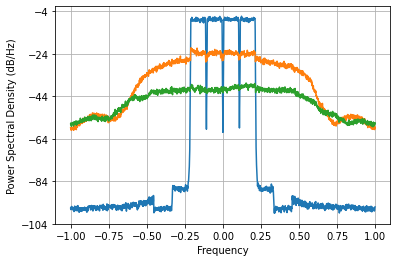

Loss =  4.6589840905238905e-05 Accuracy =  -28.36248799264157 dbs


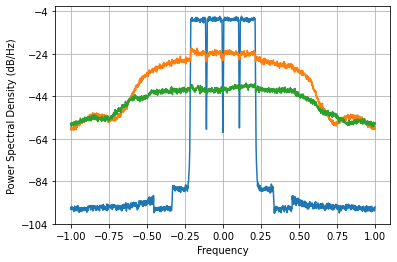

Loss =  4.6389329195559104e-05 Accuracy =  -28.381219341602804 dbs


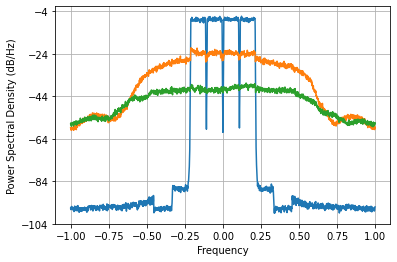

Loss =  4.619576214680632e-05 Accuracy =  -28.39937890107744 dbs


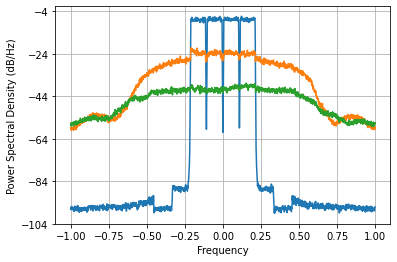

Loss =  4.6009114479964475e-05 Accuracy =  -28.41696152044737 dbs


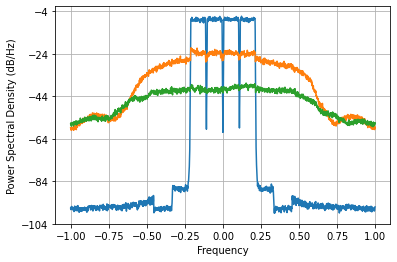

Loss =  4.582933754719332e-05 Accuracy =  -28.43396447027515 dbs


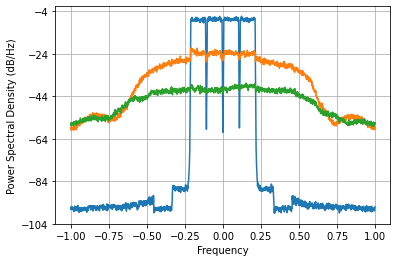

Loss =  4.5656351106109415e-05 Accuracy =  -28.450388273265087 dbs


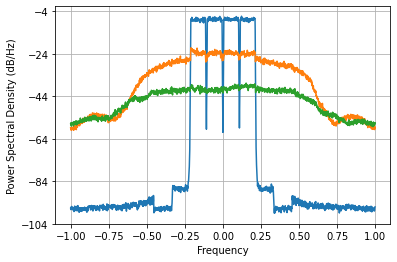

Loss =  4.549003252555281e-05 Accuracy =  -28.466237793359003 dbs


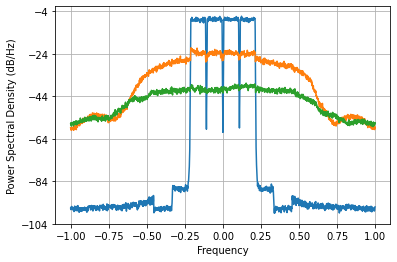

Loss =  4.533020327020101e-05 Accuracy =  -28.481523601570412 dbs


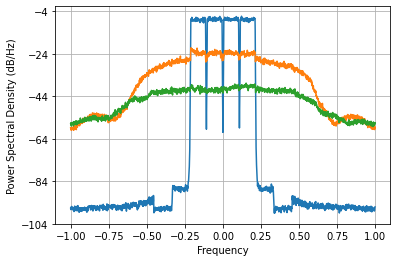

Loss =  4.517661278666314e-05 Accuracy =  -28.496263610425217 dbs


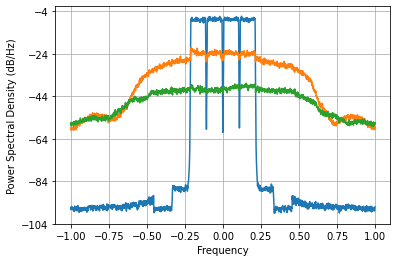

Loss =  4.50289202220801e-05 Accuracy =  -28.510484938317816 dbs


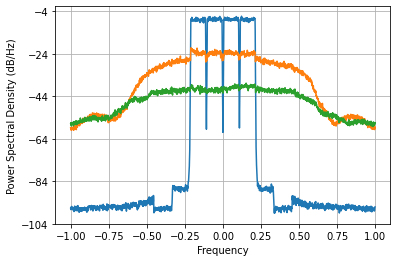

Loss =  4.488667479217445e-05 Accuracy =  -28.52422592658797 dbs


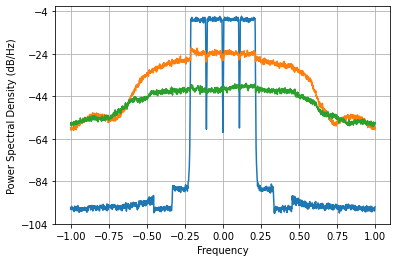

Loss =  4.4749296120903936e-05 Accuracy =  -28.537538181695222 dbs


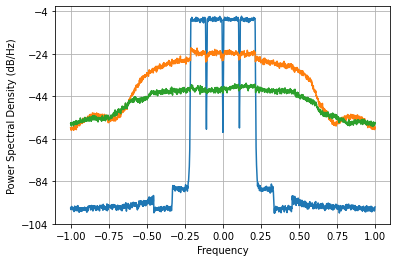

Loss =  4.461605652967242e-05 Accuracy =  -28.550488449422858 dbs


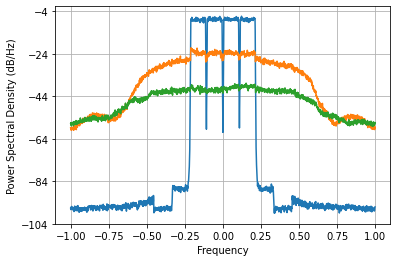

Loss =  4.4486068070681254e-05 Accuracy =  -28.56316004636942 dbs


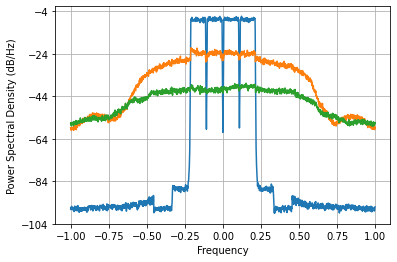

Loss =  4.4358278048688516e-05 Accuracy =  -28.575653478330164 dbs


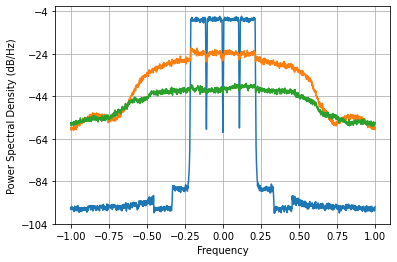

Loss =  4.4231477764924753e-05 Accuracy =  -28.5880857738349 dbs


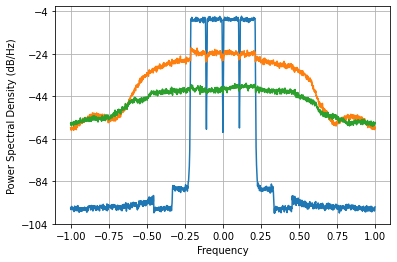

Loss =  4.4104330046842825e-05 Accuracy =  -28.600587972400074 dbs


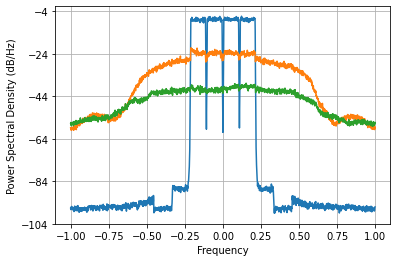

Loss =  4.397542144179344e-05 Accuracy =  -28.61330016444619 dbs


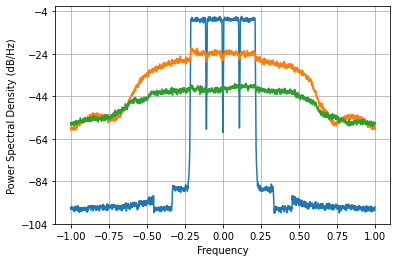

Loss =  4.3843344195768966e-05 Accuracy =  -28.62636353694196 dbs


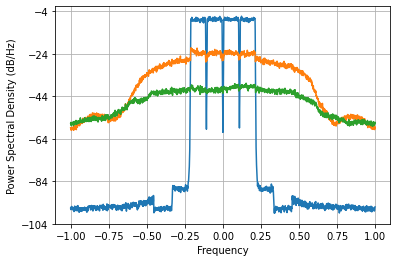

Loss =  4.370681056160053e-05 Accuracy =  -28.639909110253004 dbs


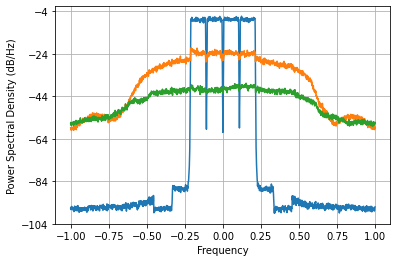

Loss =  4.3564796780032996e-05 Accuracy =  -28.654043341993795 dbs


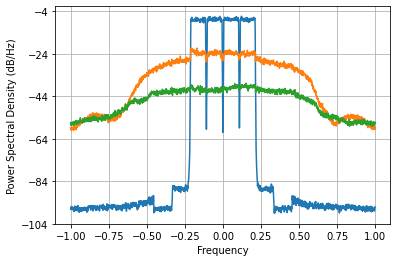

Loss =  4.3416705761372974e-05 Accuracy =  -28.668831583743568 dbs



In [ ]:
net = Olga_Cell(D=2)
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist11 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)

In [ ]:
class Olga_Cell1(nn.Module):
    def __init__(self,M=15,D=2,Poly_order=2,Passthrough=True):
        super(Olga_Cell1,self).__init__()
        self.f1=AFIR(M,0)
        self.f3=AFIR(M,0)
        self.delay=Delay(D)
        self.pol_big=Polynomial(10,Passthrough)
        self.prod=Prod_cmp()
 
    def forward(self,x):
        #source = x.clone()
        up=self.delay(x)
        up=self.f1(up)  
        low = self.pol_big(x)
        low = self.prod(low, x)
        low = self.f3(low)
        return up+low

In [ ]:
class Cell_upd(nn.Module):
    def __init__(self,M=15,D=0,Poly_order=10,Passthrough=False):
        super(Cell_upd,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,0)
        self.delay=Delay(D)
        self.pol=Polynomial(Poly_order,True) # было Passthrough
        self.prod=Prod_cmp()
    def forward(self,x):
        x=self.delay(x)
        up=self.f1(x) 
        return self.prod(up,self.f2(self.pol(x)))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


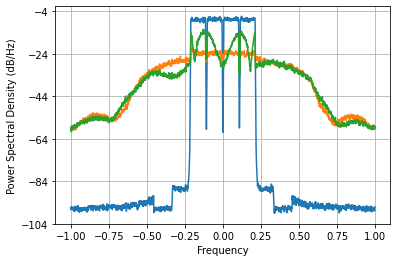

Loss =  0.0035225853718086875 Accuracy =  -9.57678499411842 dbs


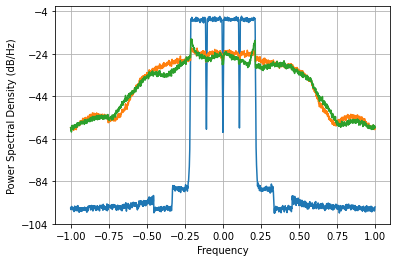

Loss =  0.0010653466027665676 Accuracy =  -14.770491013738205 dbs


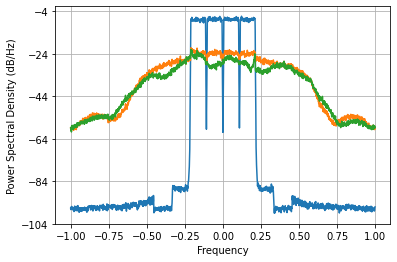

Loss =  0.0006907212811045918 Accuracy =  -16.652371898743358 dbs


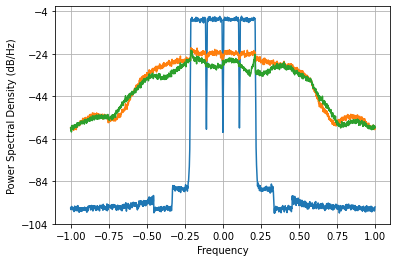

Loss =  0.0005533895585642059 Accuracy =  -17.615090661383228 dbs


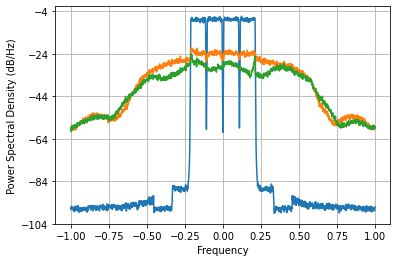

Loss =  0.0004244699299872369 Accuracy =  -18.76693097015613 dbs


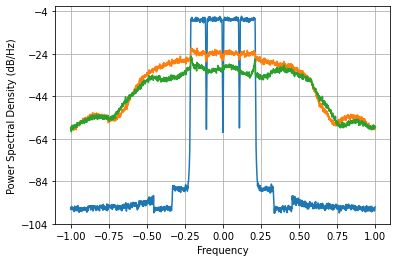

Loss =  0.00032486065358542857 Accuracy =  -19.928429129594903 dbs


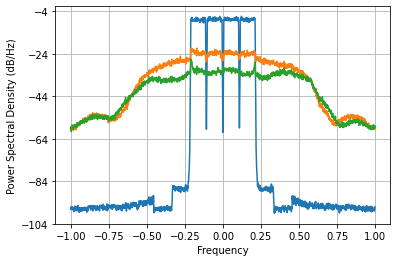

Loss =  0.00025392286158812643 Accuracy =  -20.998382229606296 dbs


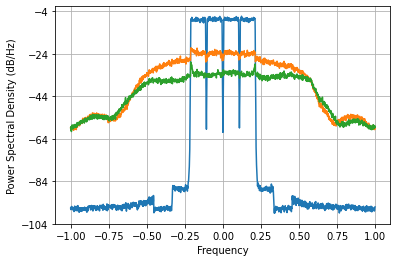

Loss =  0.00020785265952971008 Accuracy =  -21.867844408977785 dbs


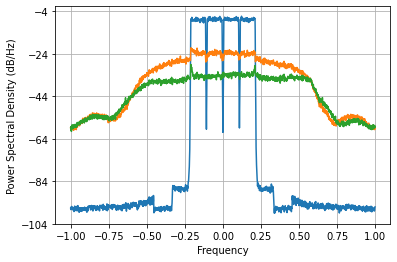

Loss =  0.00017821582975765314 Accuracy =  -22.535937497086547 dbs


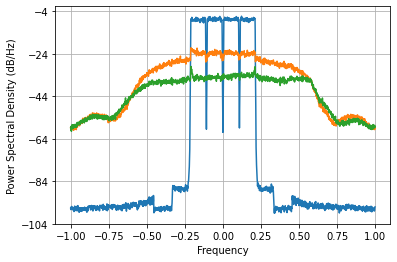

Loss =  0.00015911044315205074 Accuracy =  -23.028413413567613 dbs


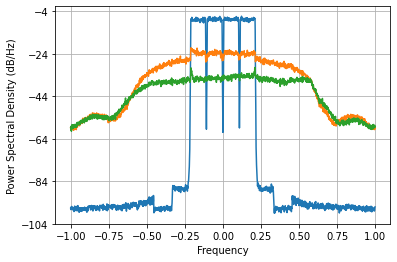

Loss =  0.00014666023220485502 Accuracy =  -23.382276584164288 dbs


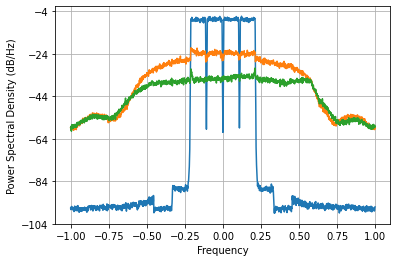

Loss =  0.00013811418199688555 Accuracy =  -23.64301751101944 dbs


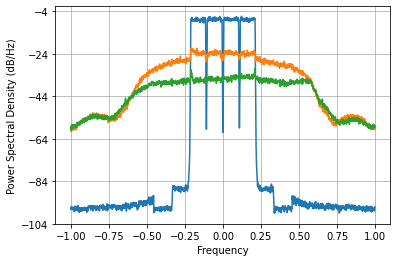

Loss =  0.00013193573580587477 Accuracy =  -23.841775832171468 dbs


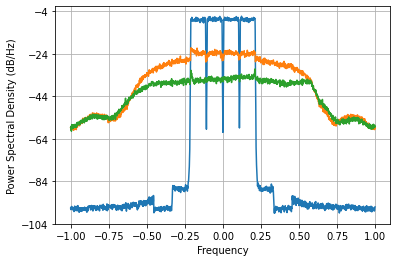

Loss =  0.00012723818948600399 Accuracy =  -23.999225459277923 dbs


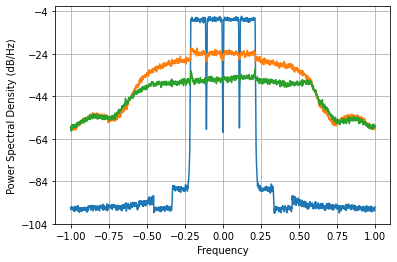

Loss =  0.00012351204759498472 Accuracy =  -24.128307051343782 dbs


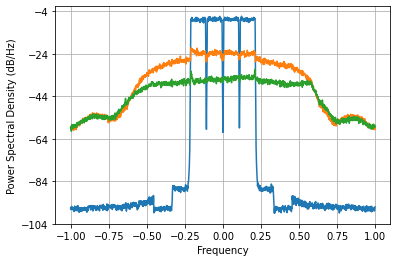

Loss =  0.00012045550664849441 Accuracy =  -24.237133680376427 dbs


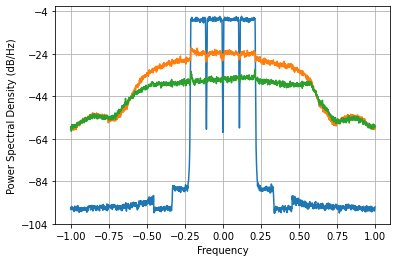

Loss =  0.00011787834657202675 Accuracy =  -24.33105991126237 dbs


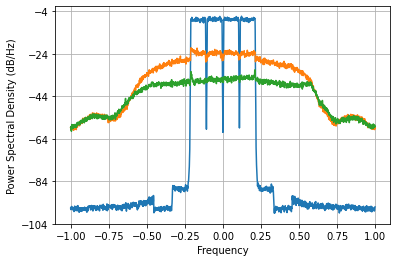

Loss =  0.0001156486532323979 Accuracy =  -24.413994470579794 dbs


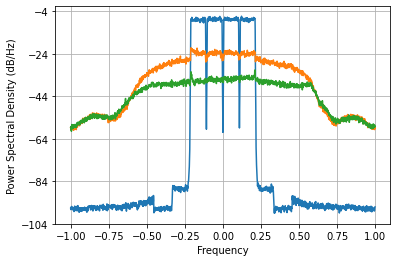

Loss =  0.00011368729479675708 Accuracy =  -24.4882809417263 dbs


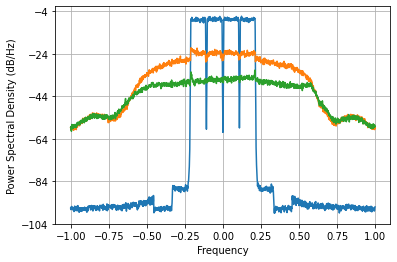

Loss =  0.000111959654311733 Accuracy =  -24.554784778260377 dbs


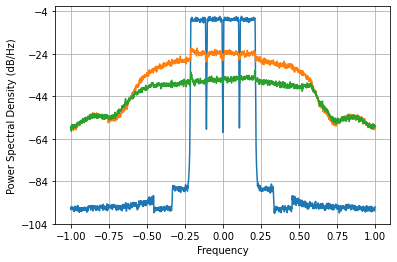

Loss =  0.00011044554890799926 Accuracy =  -24.613918087319963 dbs


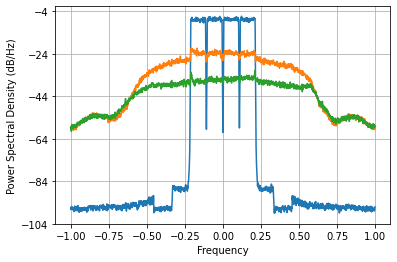

Loss =  0.00010911159818562477 Accuracy =  -24.66669109644365 dbs


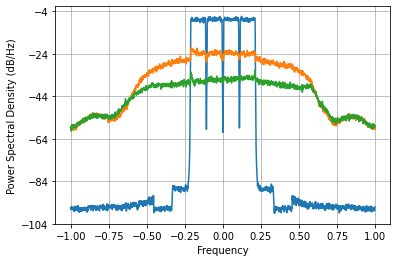

Loss =  0.00010790976918751843 Accuracy =  -24.714792630787453 dbs


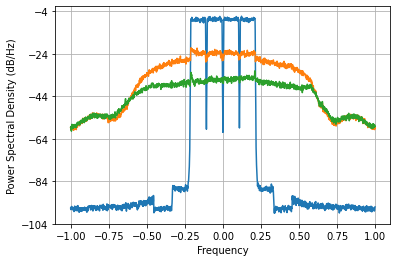

Loss =  0.00010679024617076602 Accuracy =  -24.760084390486913 dbs


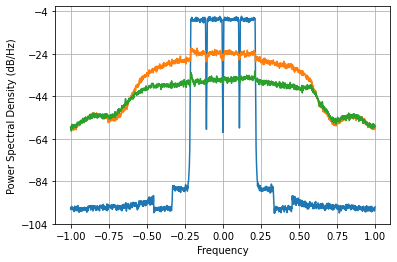

Loss =  0.00010571363043553956 Accuracy =  -24.80409038990136 dbs


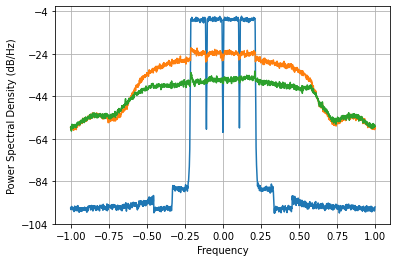

Loss =  0.00010465941295443919 Accuracy =  -24.847617322807928 dbs


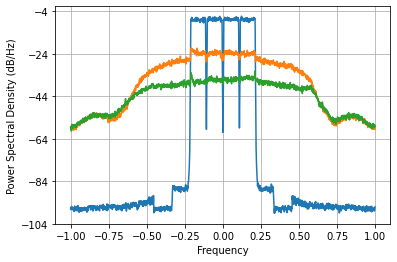

Loss =  0.00010363068307855221 Accuracy =  -24.890516658852402 dbs


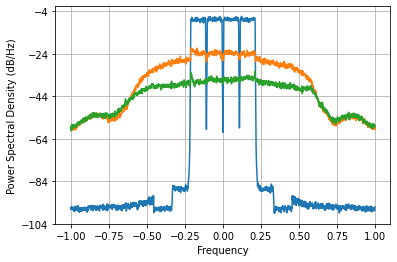

Loss =  0.0001026500420898894 Accuracy =  -24.931808949065836 dbs


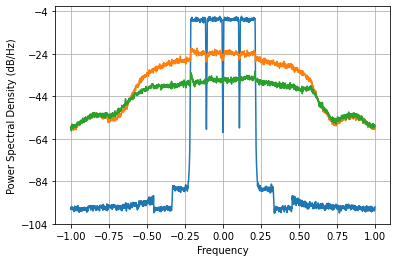

Loss =  0.00010174221174502898 Accuracy =  -24.970388522859515 dbs


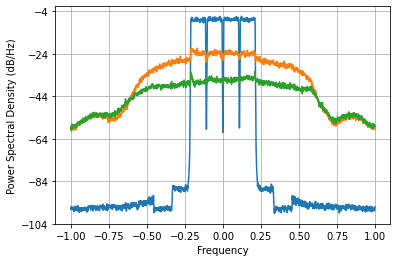

Loss =  0.00010091546309777307 Accuracy =  -25.0058230917774 dbs


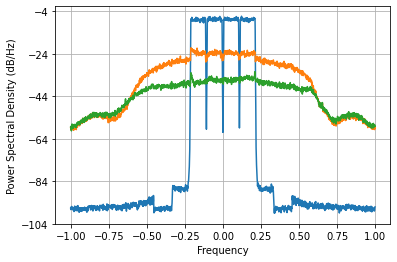

Loss =  0.00010015918268395352 Accuracy =  -25.038492547246083 dbs


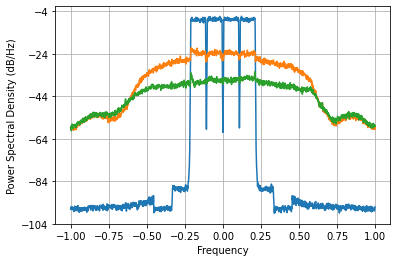

Loss =  9.945463206946635e-05 Accuracy =  -25.069150116223355 dbs


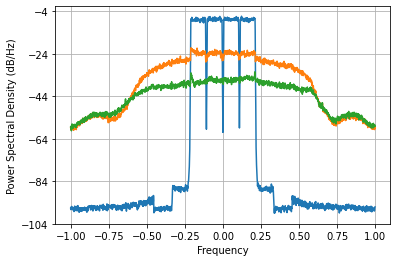

Loss =  9.878431721778204e-05 Accuracy =  -25.098520242705966 dbs


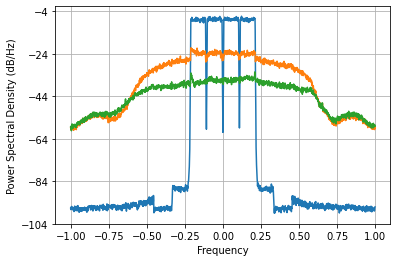

Loss =  9.813593064178795e-05 Accuracy =  -25.127119813626557 dbs


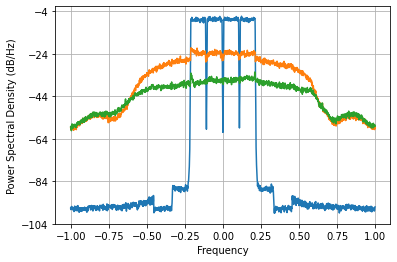

Loss =  9.750312520906494e-05 Accuracy =  -25.155214905866245 dbs


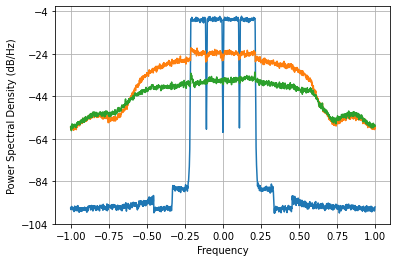

Loss =  9.688386230288358e-05 Accuracy =  -25.18288582934383 dbs


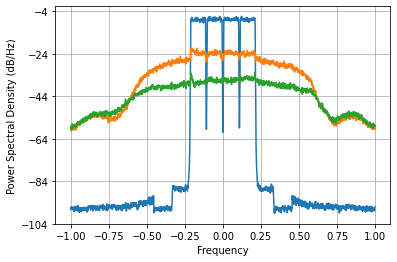

Loss =  9.62787479985676e-05 Accuracy =  -25.21009592580556 dbs


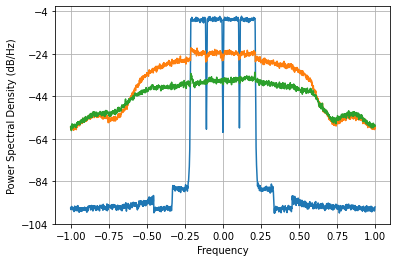

Loss =  9.569098590140579e-05 Accuracy =  -25.23668997559866 dbs


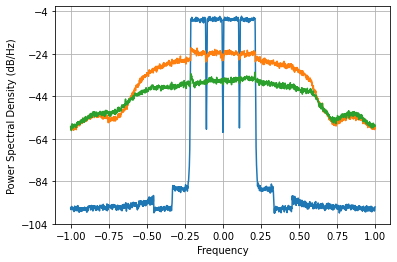

Loss =  9.512653629169906e-05 Accuracy =  -25.26238343005587 dbs


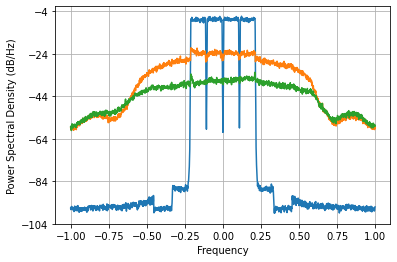

Loss =  9.459318756939255e-05 Accuracy =  -25.28680166264827 dbs


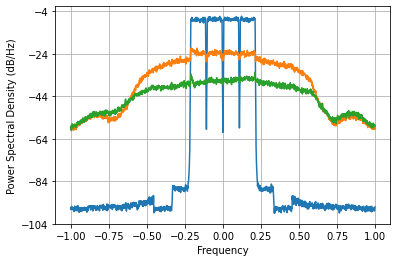

Loss =  9.409844730754939e-05 Accuracy =  -25.30957569374972 dbs


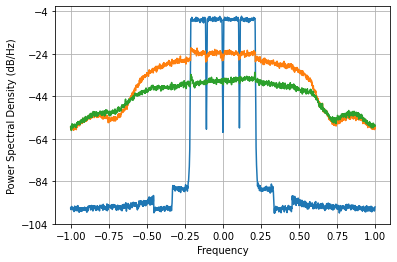

Loss =  9.364690572619744e-05 Accuracy =  -25.330465946645283 dbs


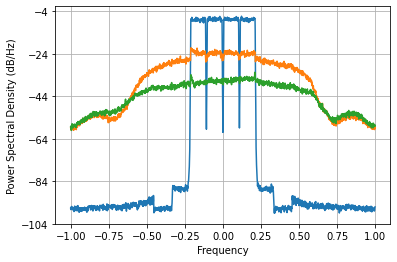

Loss =  9.323865102939415e-05 Accuracy =  -25.34944045137941 dbs


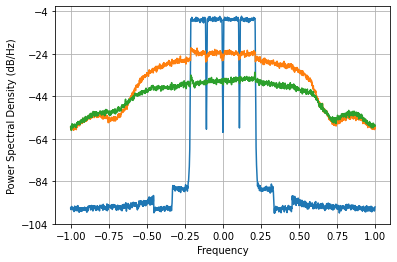

Loss =  9.286983702946459e-05 Accuracy =  -25.36665343251393 dbs


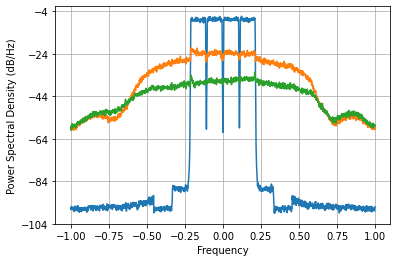

Loss =  9.253473275897771e-05 Accuracy =  -25.382352516325785 dbs


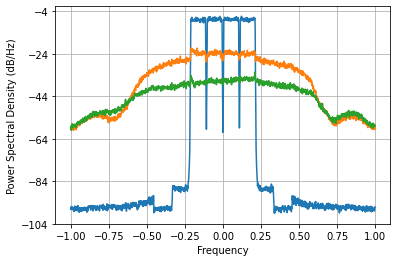

Loss =  9.222758294585139e-05 Accuracy =  -25.396791996728638 dbs


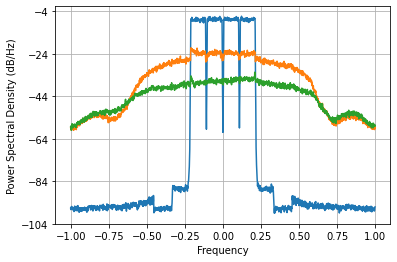

Loss =  9.194330554147452e-05 Accuracy =  -25.410199132581095 dbs


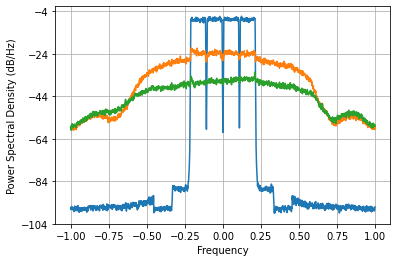

Loss =  9.167733779657902e-05 Accuracy =  -25.42278033289204 dbs


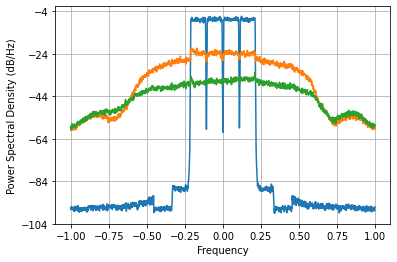

Loss =  9.142540384894272e-05 Accuracy =  -25.434731392862474 dbs


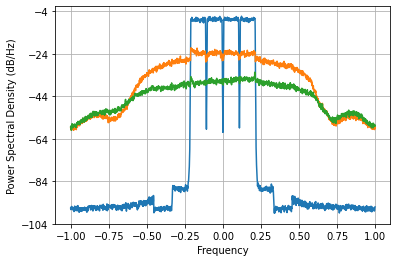

Loss =  9.11835749711154e-05 Accuracy =  -25.446234114062758 dbs


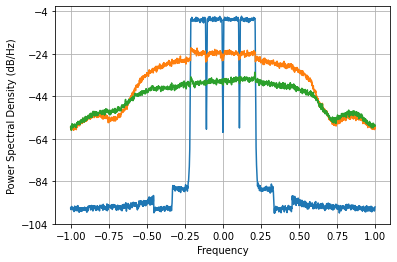

Loss =  9.094854028381644e-05 Accuracy =  -25.457442936215642 dbs


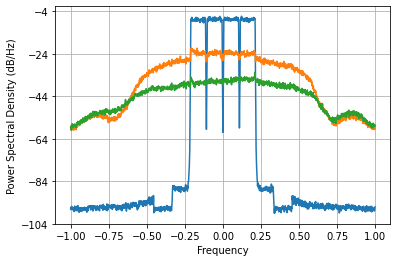

Loss =  9.07179314139633e-05 Accuracy =  -25.468468879804927 dbs


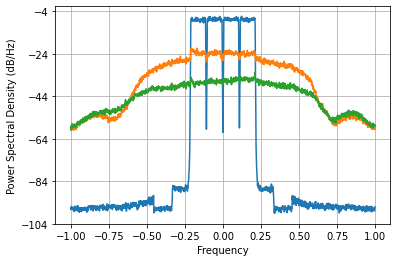

Loss =  9.049061909550585e-05 Accuracy =  -25.479364672203097 dbs


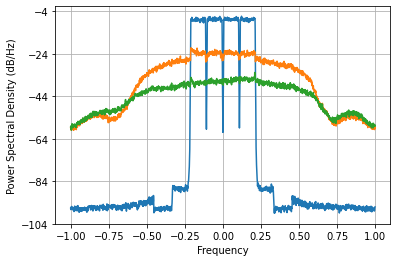

Loss =  9.026689745683864e-05 Accuracy =  -25.49011511009599 dbs


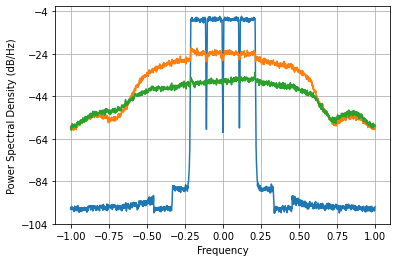

Loss =  9.004842805280712e-05 Accuracy =  -25.500638908092004 dbs


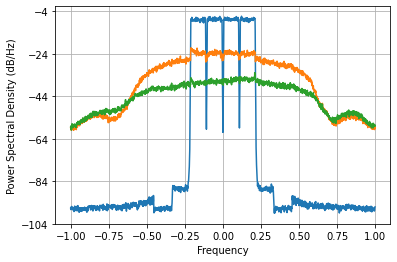

Loss =  8.983782539650264e-05 Accuracy =  -25.5108079578712 dbs


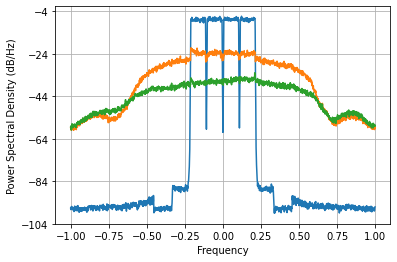

Loss =  8.963787991298148e-05 Accuracy =  -25.520484505005992 dbs


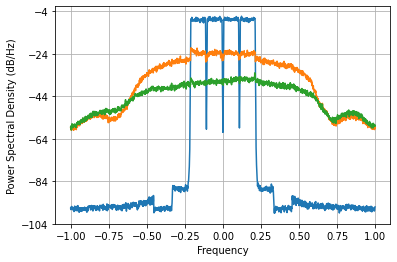

Loss =  8.945061735802908e-05 Accuracy =  -25.5295668442028 dbs


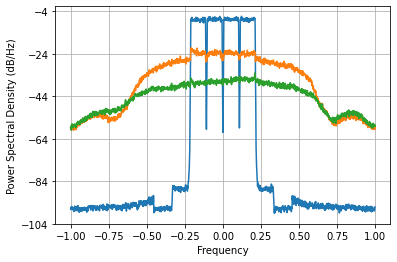

Loss =  8.92765671600056e-05 Accuracy =  -25.53802544155323 dbs


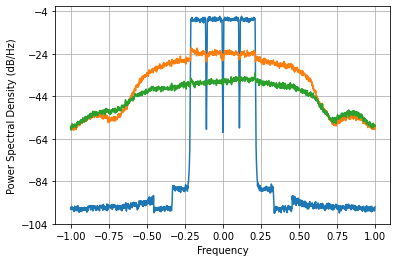

Loss =  8.911459054820437e-05 Accuracy =  -25.545912106894523 dbs


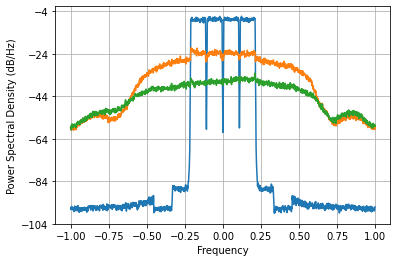

Loss =  8.89623563851779e-05 Accuracy =  -25.553337489483784 dbs


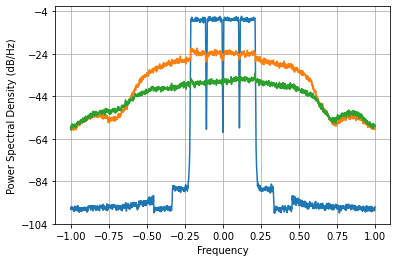

Loss =  8.881720669162223e-05 Accuracy =  -25.56042916232596 dbs


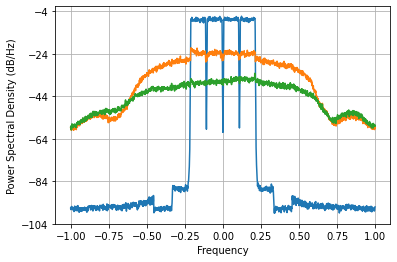

Loss =  8.867697343850632e-05 Accuracy =  -25.567291645437805 dbs


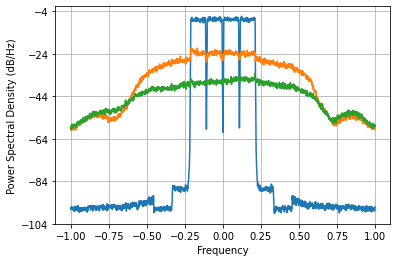

Loss =  8.854040687843821e-05 Accuracy =  -25.57398513284682 dbs


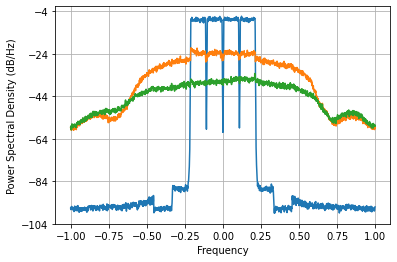

Loss =  8.840714381468292e-05 Accuracy =  -25.580526667210638 dbs


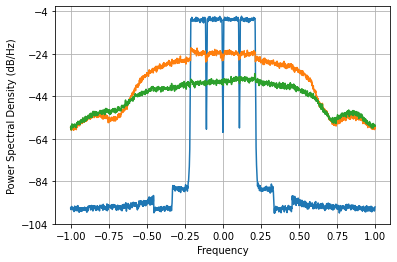

Loss =  8.827737669360431e-05 Accuracy =  -25.58690607776548 dbs


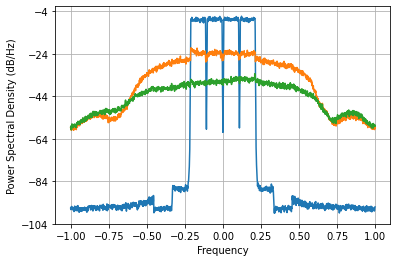

Loss =  8.815145807093458e-05 Accuracy =  -25.593105265370223 dbs


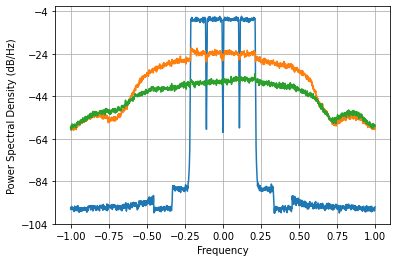

Loss =  8.80296062287412e-05 Accuracy =  -25.599112674999937 dbs


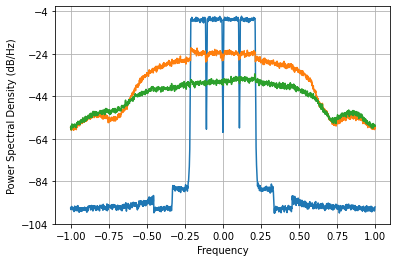

Loss =  8.79117599851553e-05 Accuracy =  -25.604930520121588 dbs


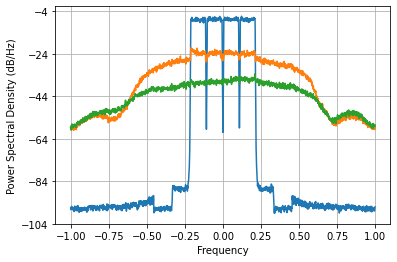

Loss =  8.779754690915521e-05 Accuracy =  -25.610576449358984 dbs


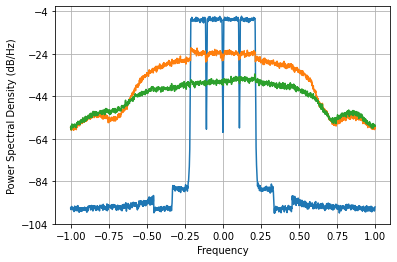

Loss =  8.768630700430749e-05 Accuracy =  -25.616082469683526 dbs


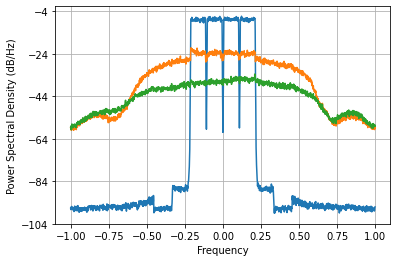

Loss =  8.757713381787488e-05 Accuracy =  -25.621492989795357 dbs


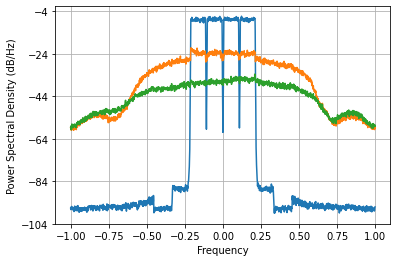

Loss =  8.746892286402895e-05 Accuracy =  -25.626862482489344 dbs


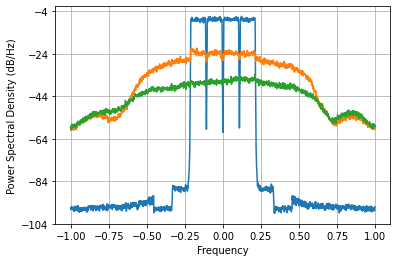

Loss =  8.73604323406485e-05 Accuracy =  -25.632252520293438 dbs


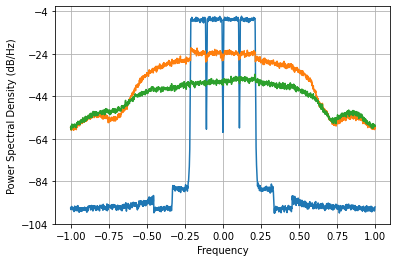

Loss =  8.72503623997441e-05 Accuracy =  -25.63772787184442 dbs


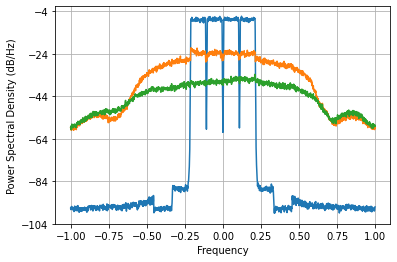

Loss =  8.713745552546711e-05 Accuracy =  -25.643351526054033 dbs


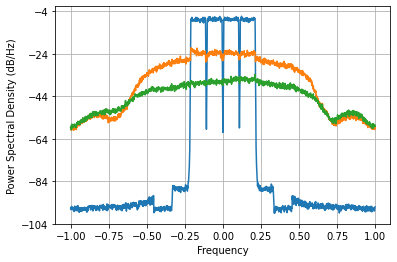

Loss =  8.70206179548165e-05 Accuracy =  -25.649178636886276 dbs


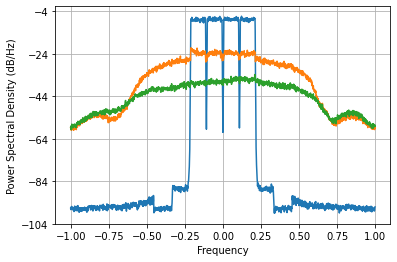

Loss =  8.68990601438273e-05 Accuracy =  -25.65524947323077 dbs


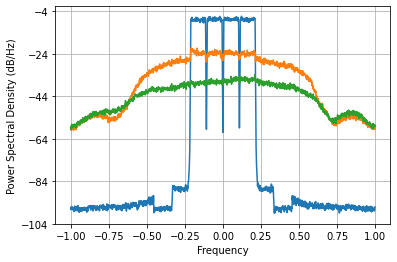

Loss =  8.6772449543714e-05 Accuracy =  -25.66158169143051 dbs


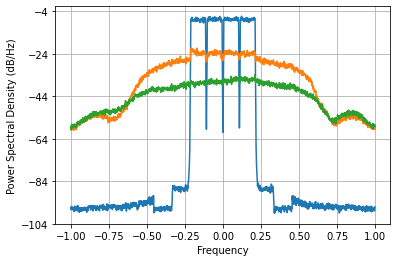

Loss =  8.664105777352587e-05 Accuracy =  -25.66816280873359 dbs


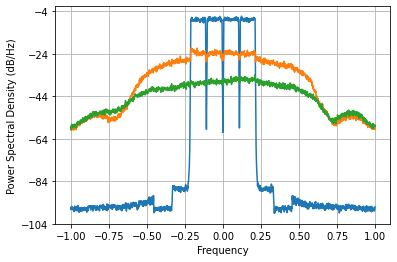

Loss =  8.650586474400999e-05 Accuracy =  -25.67494474834746 dbs


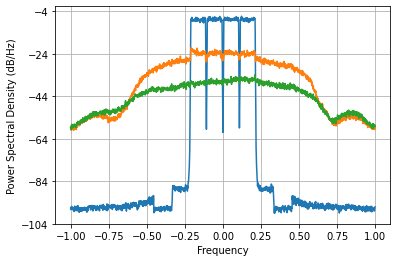

Loss =  8.636855935713861e-05 Accuracy =  -25.68184351138924 dbs


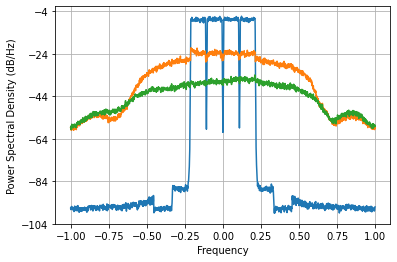

Loss =  8.623136872198449e-05 Accuracy =  -25.688747471202753 dbs


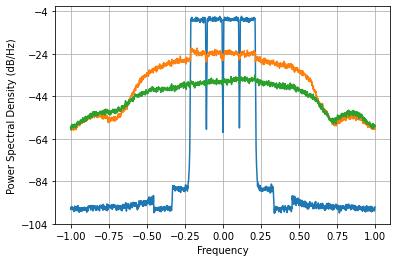

Loss =  8.609668470441817e-05 Accuracy =  -25.695535981416416 dbs


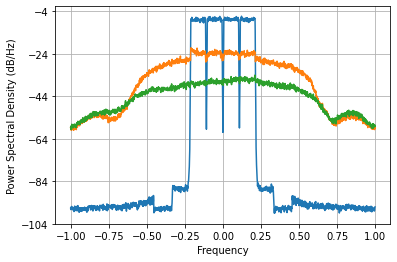

Loss =  8.596655220314802e-05 Accuracy =  -25.702105175279005 dbs


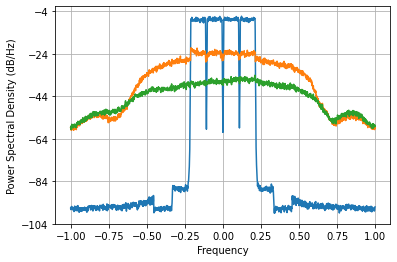

Loss =  8.584219735738228e-05 Accuracy =  -25.70839200675682 dbs


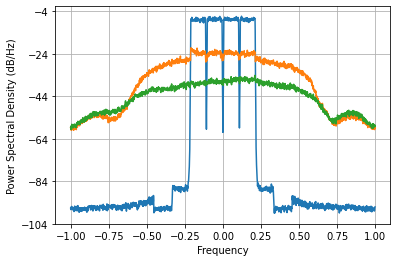

Loss =  8.572380962789223e-05 Accuracy =  -25.714385635297422 dbs


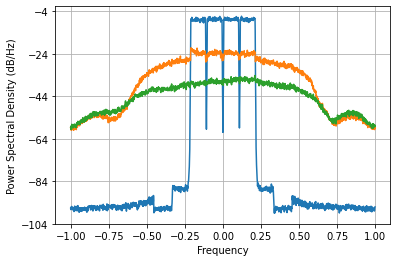

Loss =  8.56106804825107e-05 Accuracy =  -25.720120776037607 dbs


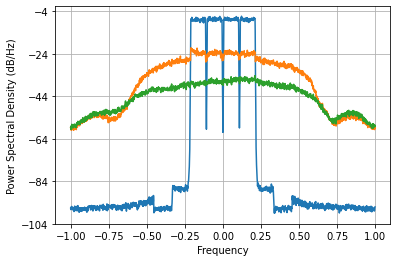

Loss =  8.550160308224932e-05 Accuracy =  -25.725657692320134 dbs


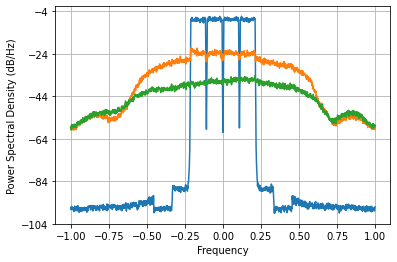

Loss =  8.539530973777528e-05 Accuracy =  -25.731060085863593 dbs


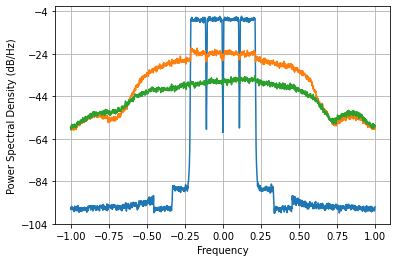

Loss =  8.529075983276235e-05 Accuracy =  -25.736380432465214 dbs


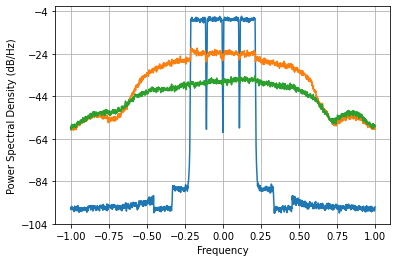

Loss =  8.518722823691253e-05 Accuracy =  -25.741655389873735 dbs


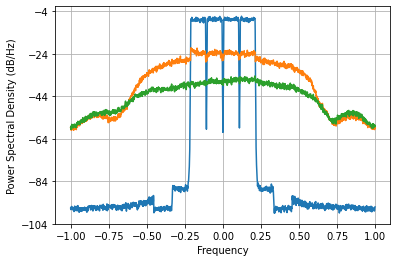

Loss =  8.508425693018461e-05 Accuracy =  -25.746908163197947 dbs


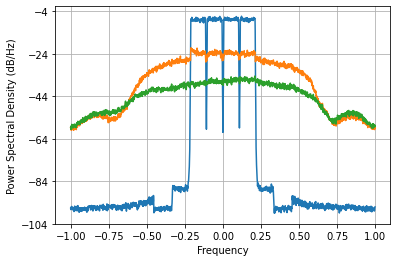

Loss =  8.498156018121107e-05 Accuracy =  -25.752153266248918 dbs


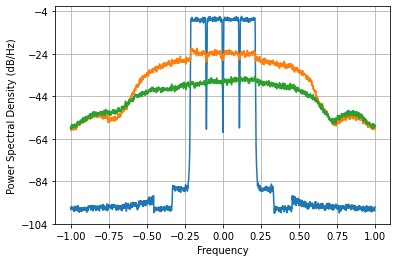

Loss =  8.487894145853862e-05 Accuracy =  -25.757400719304616 dbs


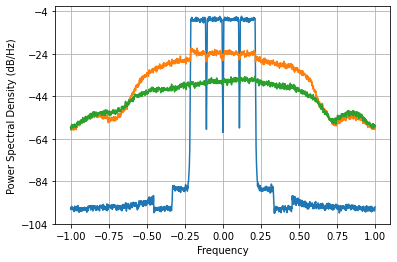

Loss =  8.47762389141949e-05 Accuracy =  -25.762658814416874 dbs


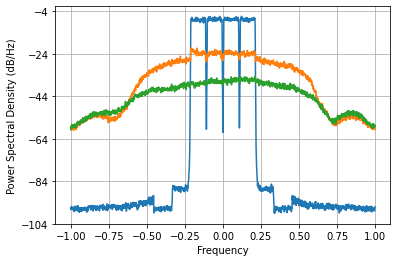

Loss =  8.467329368863265e-05 Accuracy =  -25.767935730583442 dbs


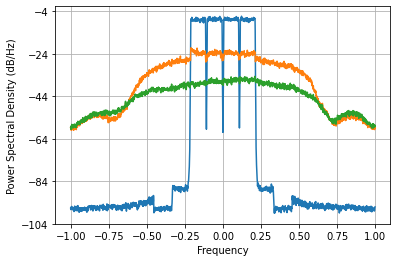

Loss =  8.456993159650718e-05 Accuracy =  -25.77324047371317 dbs


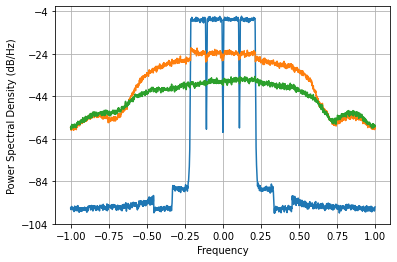

Loss =  8.446595269606918e-05 Accuracy =  -25.77858341832865 dbs


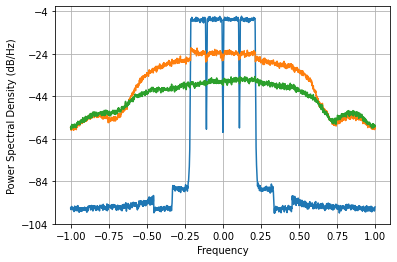

Loss =  8.436112635957683e-05 Accuracy =  -25.783976570375337 dbs


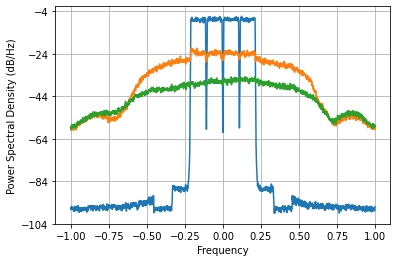

Loss =  8.42551900737474e-05 Accuracy =  -25.78943364017683 dbs


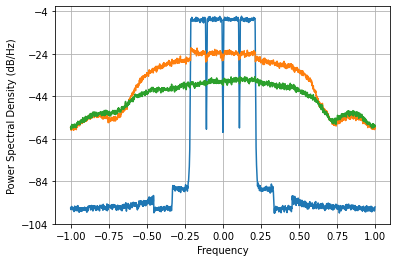

Loss =  8.41478502150232e-05 Accuracy =  -25.79497001464673 dbs


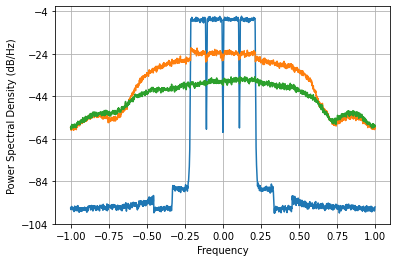

Loss =  8.403878384786999e-05 Accuracy =  -25.800602677232497 dbs


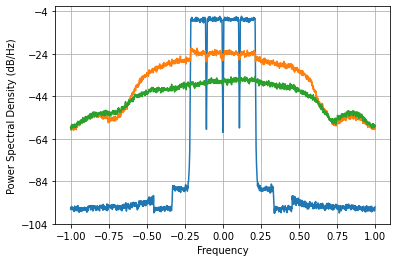

Loss =  8.392764175961833e-05 Accuracy =  -25.806350064248072 dbs


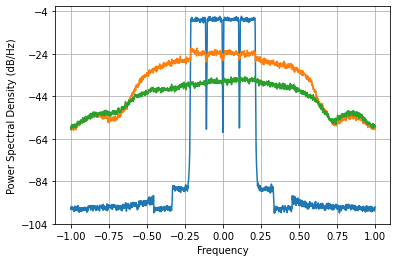

Loss =  8.381405345062501e-05 Accuracy =  -25.812231819918047 dbs


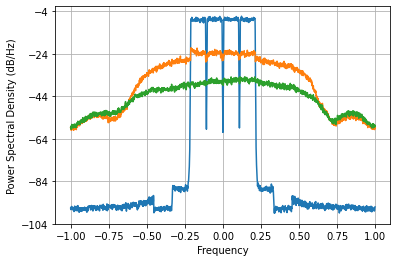

Loss =  8.36976344278353e-05 Accuracy =  -25.8182684312097 dbs


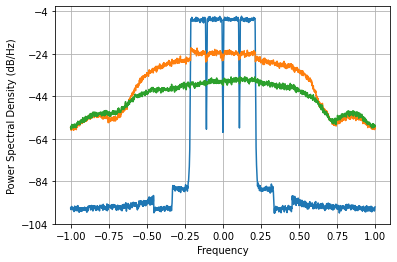

Loss =  8.357799553930407e-05 Accuracy =  -25.82448075490323 dbs


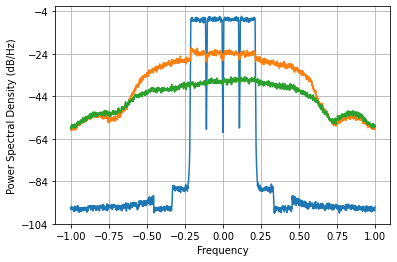

Loss =  8.345475382473777e-05 Accuracy =  -25.830889462955128 dbs


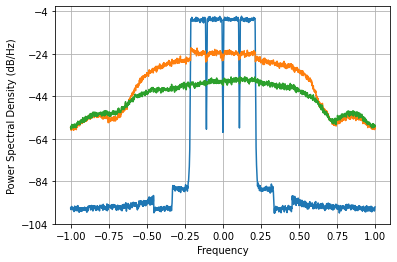

Loss =  8.332754444156653e-05 Accuracy =  -25.837514427887868 dbs


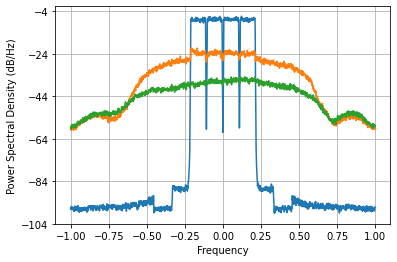

Loss =  8.319603334639428e-05 Accuracy =  -25.84437406369141 dbs


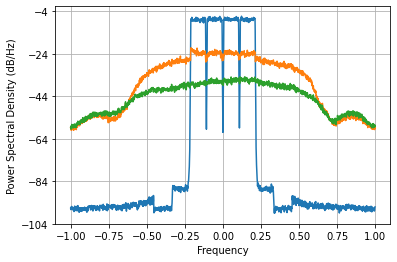

Loss =  8.305993040588364e-05 Accuracy =  -25.851484638001615 dbs


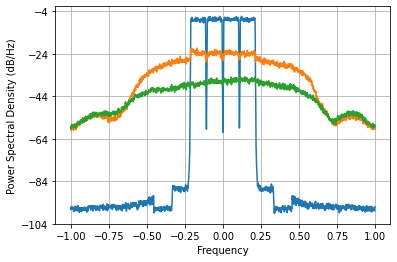

Loss =  8.291900252629769e-05 Accuracy =  -25.85885957578162 dbs


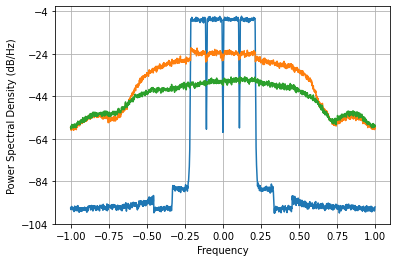

Loss =  8.277308629478228e-05 Accuracy =  -25.86650877991687 dbs


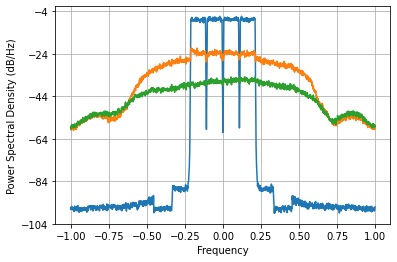

Loss =  8.262209953219636e-05 Accuracy =  -25.87443799934594 dbs


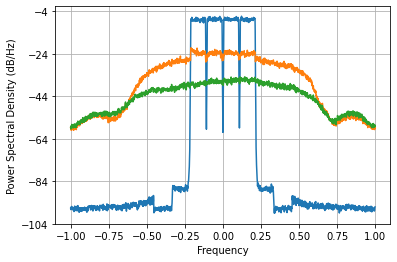

Loss =  8.246605107983686e-05 Accuracy =  -25.882648279938717 dbs


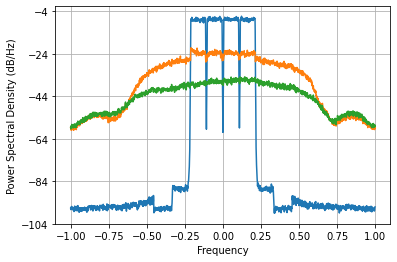

Loss =  8.230504811237866e-05 Accuracy =  -25.891135535644807 dbs


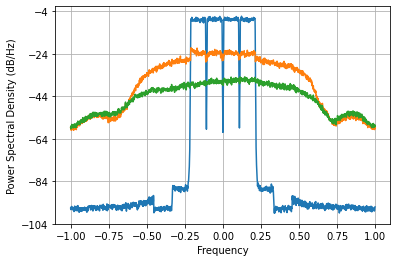

Loss =  8.21393003145668e-05 Accuracy =  -25.89989027596179 dbs


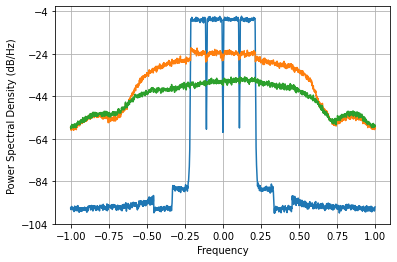

Loss =  8.196912039622741e-05 Accuracy =  -25.908897519543576 dbs


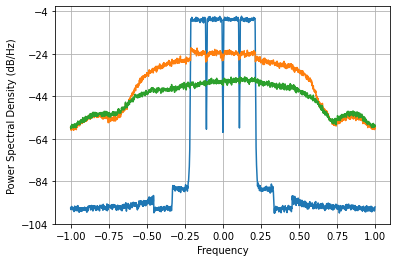

Loss =  8.179492065416572e-05 Accuracy =  -25.91813691236456 dbs


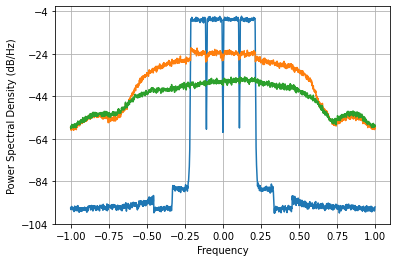

Loss =  8.161720560711372e-05 Accuracy =  -25.927583052804593 dbs



In [ ]:
net = Olga_Cell1()
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist12 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)

In [ ]:
def Comparison_Olga_cells(hist1, hist2):
    fig, ax = plt.subplots()
    ax.plot(hist1['iter'], hist1['train_loss_db'], label='Olga_v0')
    ax.plot(hist2['iter'], hist2['train_loss_db'], label='Olga_v1')
    ax.set_xlabel('iter')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of two types of new cells: iter')
    ax.legend()
    plt.show()

    fig, ax = plt.subplots()
    ax.plot(hist1['time'], hist1['train_loss_db'], label='Olga_v0')
    ax.plot(hist2['time'], hist2['train_loss_db'], label='Olga_v1')
    ax.set_xlabel('time')
    ax.set_ylabel('accuracy, dbs')
    plt.title('Comparison of two types of new cells: time')
    ax.legend()
    plt.show()

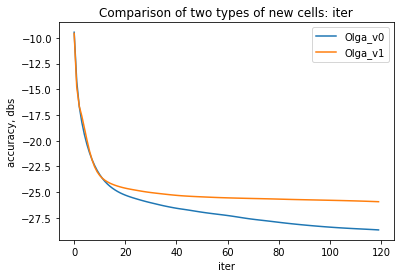

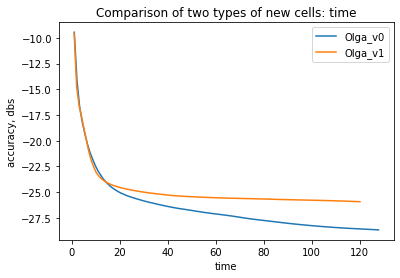

In [ ]:
Comparison_Olga_cells(hist11, hist12)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


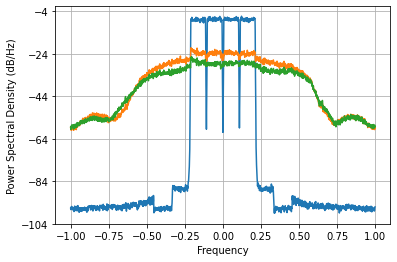

Loss =  0.000511985733916413 Accuracy =  -17.952821668211904 dbs


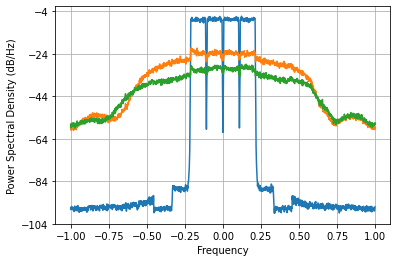

Loss =  0.00025629722363092064 Accuracy =  -20.957961250233108 dbs


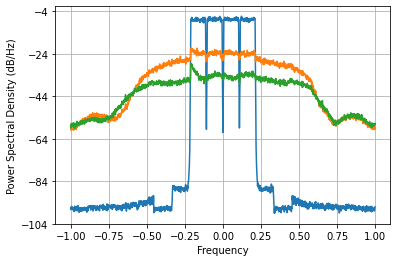

Loss =  0.00015274215185049348 Accuracy =  -23.205811219837074 dbs


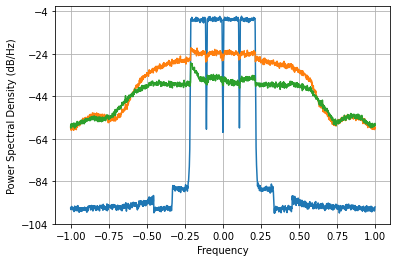

Loss =  0.00011900112849790265 Accuracy =  -24.289889468243757 dbs


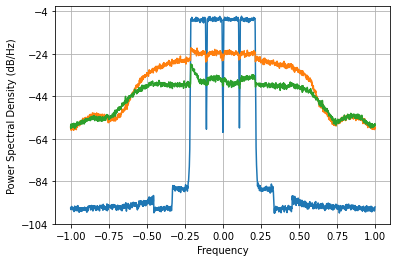

Loss =  0.0001092453720034173 Accuracy =  -24.66136978811916 dbs


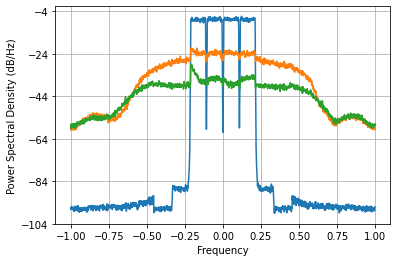

Loss =  0.00010437076163462084 Accuracy =  -24.85961173991261 dbs


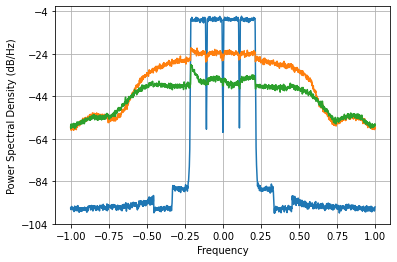

Loss =  0.00010112185578418276 Accuracy =  -24.9969499552213 dbs


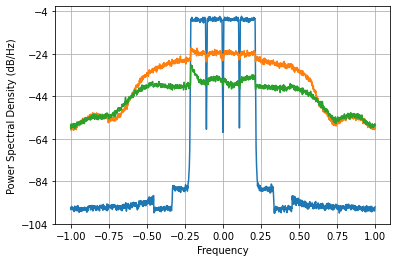

Loss =  9.854873174258487e-05 Accuracy =  -25.108889871213904 dbs


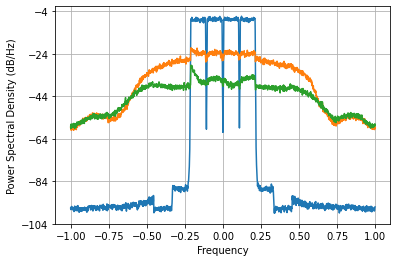

Loss =  9.646507985669413e-05 Accuracy =  -25.201698985276046 dbs


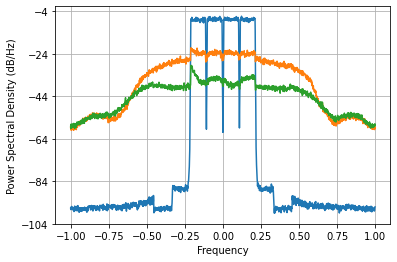

Loss =  9.479218687545014e-05 Accuracy =  -25.27767484041251 dbs


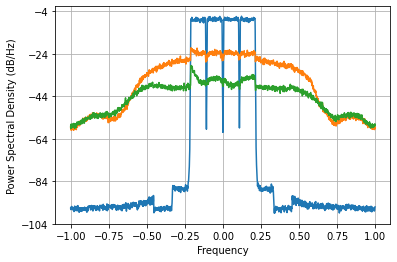

Loss =  9.346232906965412e-05 Accuracy =  -25.33903427300439 dbs


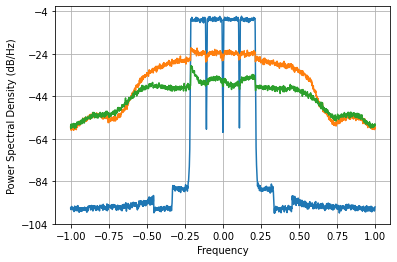

Loss =  9.240773596392434e-05 Accuracy =  -25.388316967472235 dbs


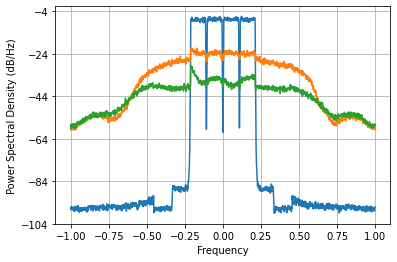

Loss =  9.157155364480942e-05 Accuracy =  -25.42779444000376 dbs


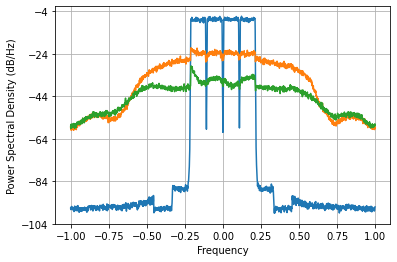

Loss =  9.090566702114058e-05 Accuracy =  -25.459490688865664 dbs


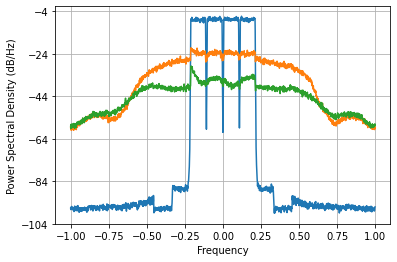

Loss =  9.037015824488945e-05 Accuracy =  -25.48514983924852 dbs


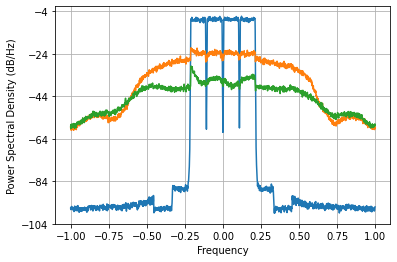

Loss =  8.993325562447435e-05 Accuracy =  -25.50619711333798 dbs


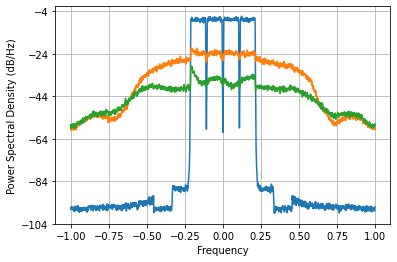

Loss =  8.956947644260394e-05 Accuracy =  -25.52379991033029 dbs


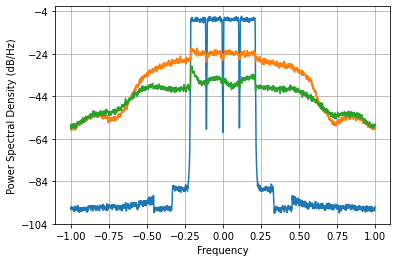

Loss =  8.925880236661524e-05 Accuracy =  -25.538889713074052 dbs


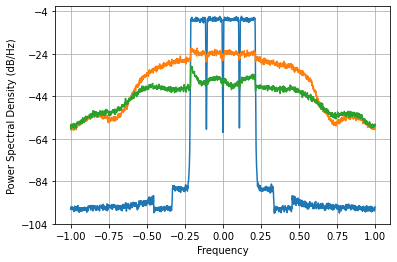

Loss =  8.898608901270643e-05 Accuracy =  -25.552179069783662 dbs


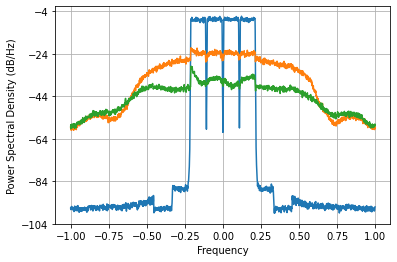

Loss =  8.874025202242564e-05 Accuracy =  -25.564193689090814 dbs


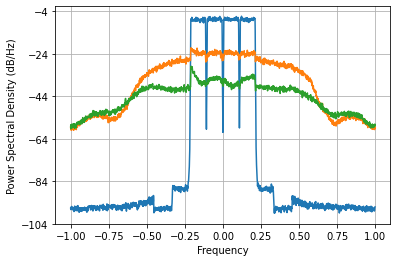

Loss =  8.851340521671367e-05 Accuracy =  -25.57530977789584 dbs


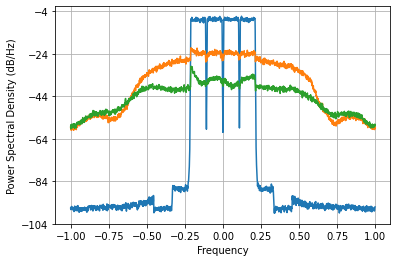

Loss =  8.830010115489973e-05 Accuracy =  -25.58578825590965 dbs


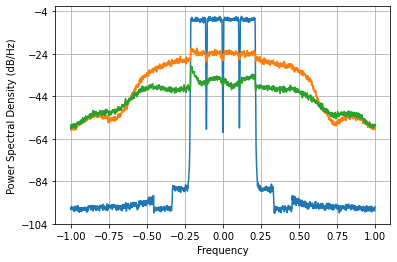

Loss =  8.809671928824282e-05 Accuracy =  -25.595802910519208 dbs


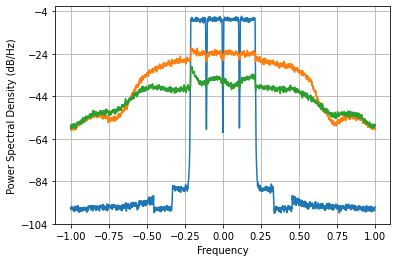

Loss =  8.790096850448585e-05 Accuracy =  -25.60546366474114 dbs


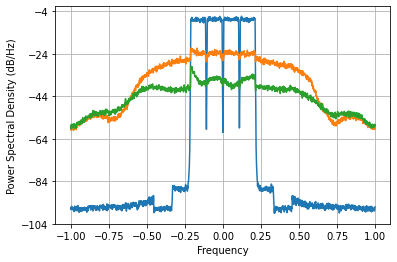

Loss =  8.771147925784347e-05 Accuracy =  -25.614835912230802 dbs


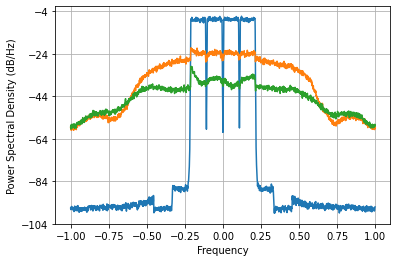

Loss =  8.752746240853557e-05 Accuracy =  -25.623956890804 dbs


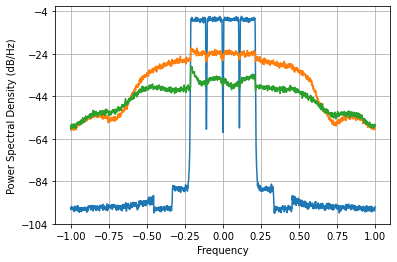

Loss =  8.734843550501694e-05 Accuracy =  -25.632848959339437 dbs


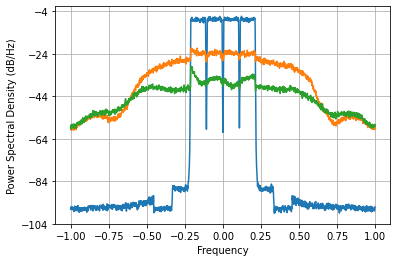

Loss =  8.717403134555414e-05 Accuracy =  -25.64152896377163 dbs


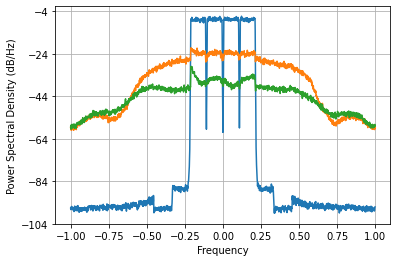

Loss =  8.700389378763893e-05 Accuracy =  -25.65001337142675 dbs


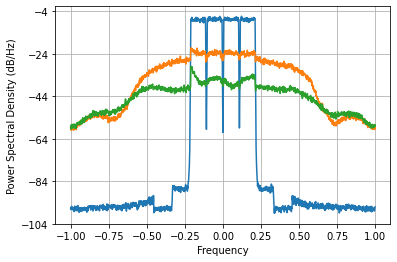

Loss =  8.683764557962515e-05 Accuracy =  -25.65831986728957 dbs


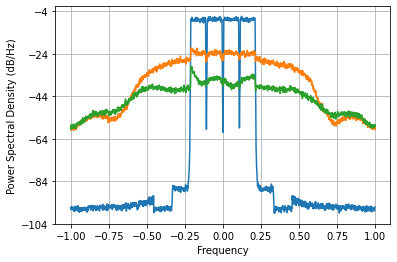

Loss =  8.667489911976641e-05 Accuracy =  -25.666466818314397 dbs


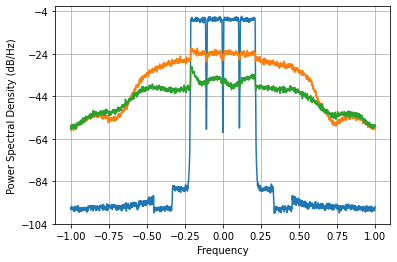

Loss =  8.651528172460422e-05 Accuracy =  -25.67447200350722 dbs


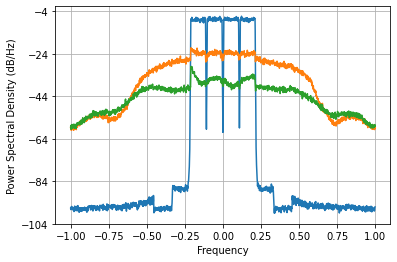

Loss =  8.635845841269184e-05 Accuracy =  -25.682351455600497 dbs


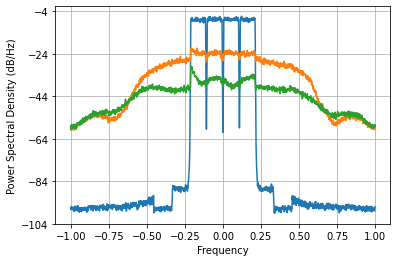

Loss =  8.620414790817008e-05 Accuracy =  -25.690118632963596 dbs


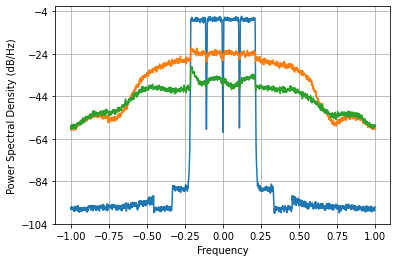

Loss =  8.605213492483657e-05 Accuracy =  -25.69778377189396 dbs


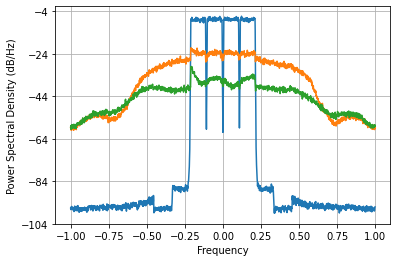

Loss =  8.590228298794902e-05 Accuracy =  -25.705353206463613 dbs


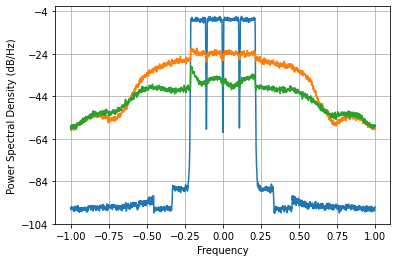

Loss =  8.575454997846536e-05 Accuracy =  -25.712828544968428 dbs


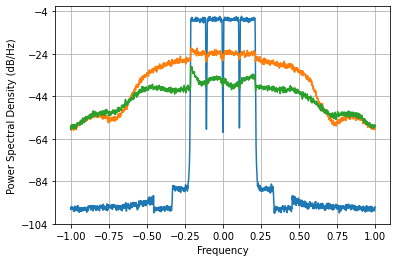

Loss =  8.560900617362284e-05 Accuracy =  -25.720205712895662 dbs


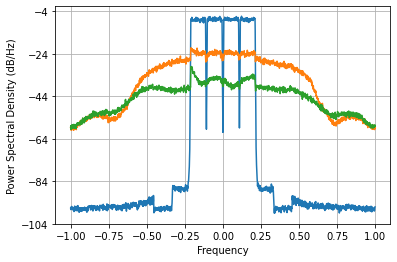

Loss =  8.546585289738557e-05 Accuracy =  -25.72747395707657 dbs


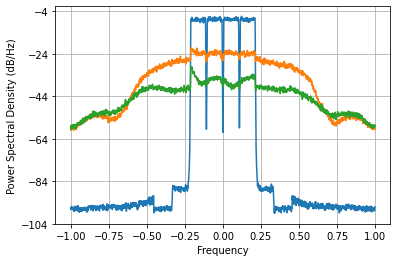

Loss =  8.532543870981995e-05 Accuracy =  -25.734614967605395 dbs


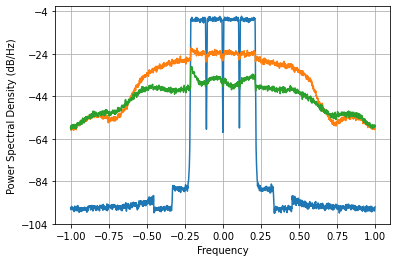

Loss =  8.518826900470956e-05 Accuracy =  -25.741602330634763 dbs


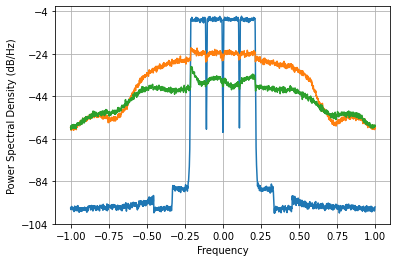

Loss =  8.505500411597696e-05 Accuracy =  -25.748401567581812 dbs


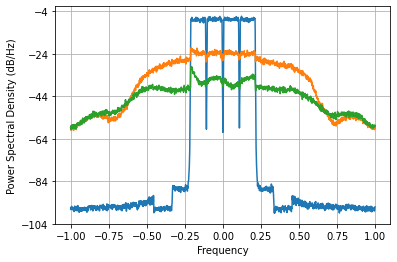

Loss =  8.492644105404916e-05 Accuracy =  -25.754971018613663 dbs


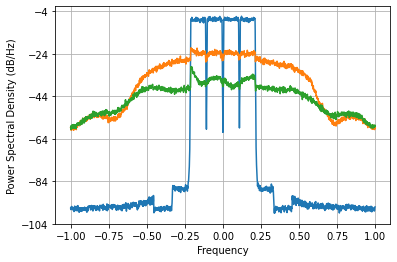

Loss =  8.480347529166451e-05 Accuracy =  -25.761263764472467 dbs


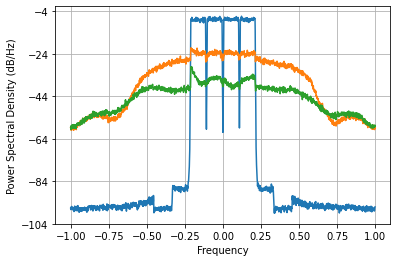

Loss =  8.46870418450992e-05 Accuracy =  -25.767230636502934 dbs


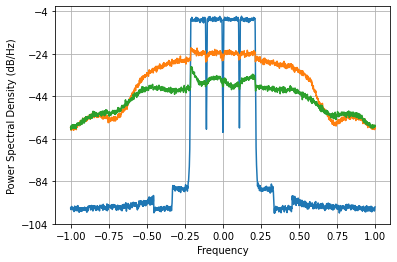

Loss =  8.457803905735696e-05 Accuracy =  -25.772824148823382 dbs


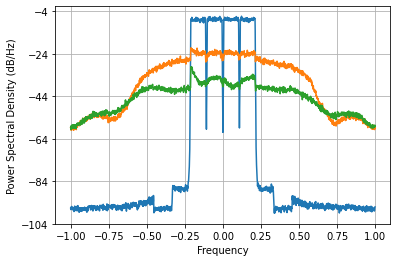

Loss =  8.447724318266783e-05 Accuracy =  -25.778002939664262 dbs


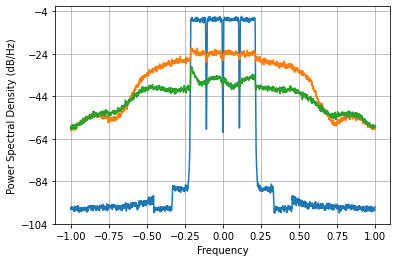

Loss =  8.438522574904442e-05 Accuracy =  -25.78273610125664 dbs


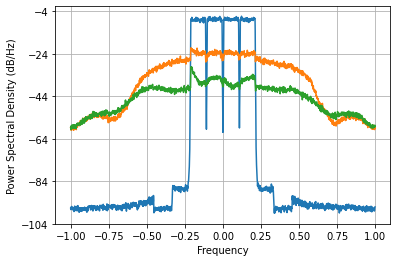

Loss =  8.4302287244735e-05 Accuracy =  -25.787006688571857 dbs


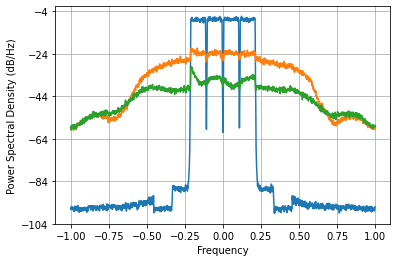

Loss =  8.422841893652351e-05 Accuracy =  -25.790813781228742 dbs


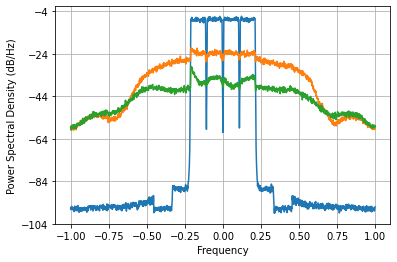

Loss =  8.416329965307625e-05 Accuracy =  -25.794172728701138 dbs


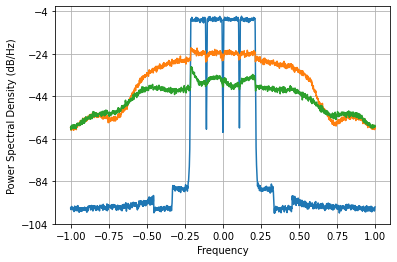

Loss =  8.410632744393348e-05 Accuracy =  -25.79711357042342 dbs


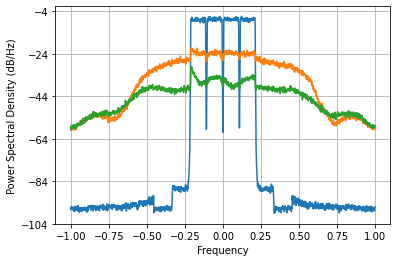

Loss =  8.405667921917565e-05 Accuracy =  -25.799677981122656 dbs


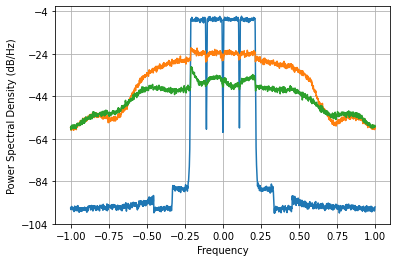

Loss =  8.401338677804785e-05 Accuracy =  -25.801915341903616 dbs


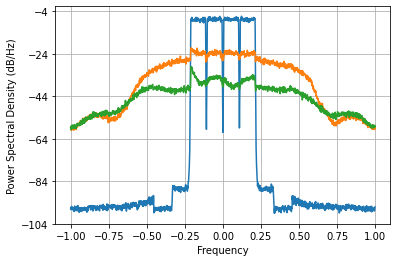

Loss =  8.397541616415027e-05 Accuracy =  -25.803878618989017 dbs


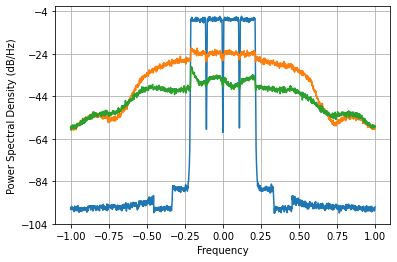

Loss =  8.394173894709995e-05 Accuracy =  -25.805620648231617 dbs


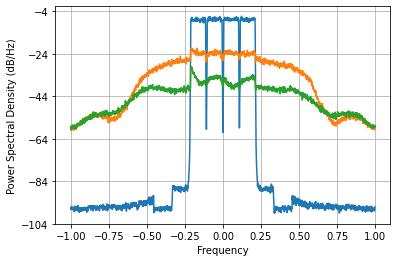

Loss =  8.391138776409358e-05 Accuracy =  -25.807191229810982 dbs


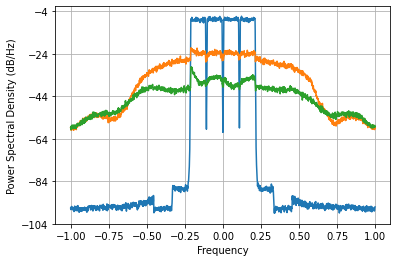

Loss =  8.388349282442985e-05 Accuracy =  -25.808635209321928 dbs


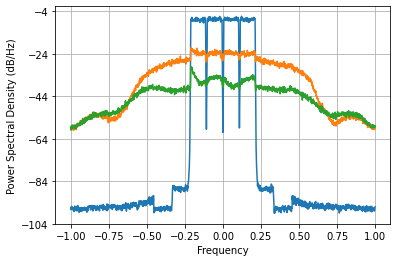

Loss =  8.385729986684654e-05 Accuracy =  -25.80999152305493 dbs


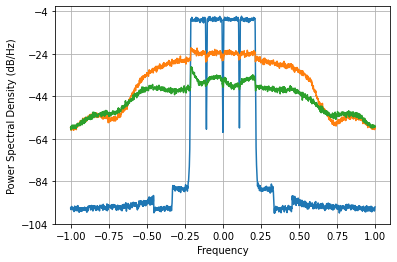

Loss =  8.383217258868929e-05 Accuracy =  -25.811293052384215 dbs


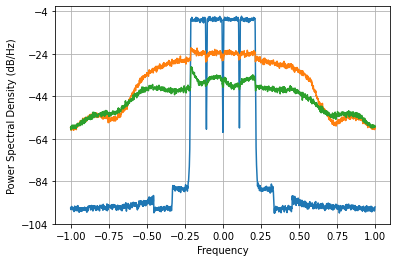

Loss =  8.38075837258612e-05 Accuracy =  -25.812567070881236 dbs


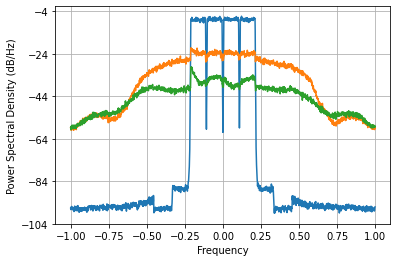

Loss =  8.378309902450688e-05 Accuracy =  -25.813836063952976 dbs


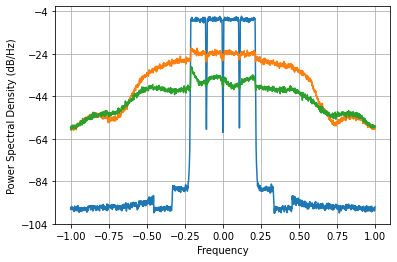

Loss =  8.375835773371885e-05 Accuracy =  -25.815118732296728 dbs


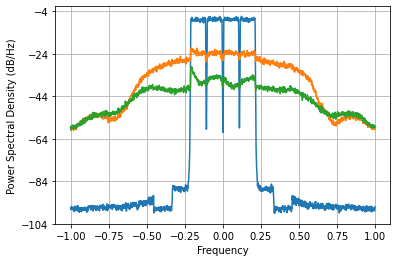

Loss =  8.373305236414001e-05 Accuracy =  -25.816431036306568 dbs


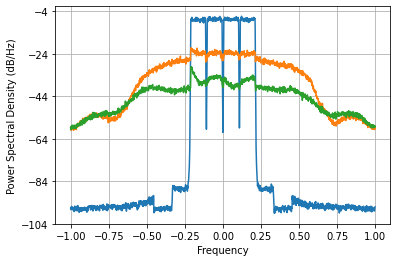

Loss =  8.370690958908355e-05 Accuracy =  -25.81778718365735 dbs


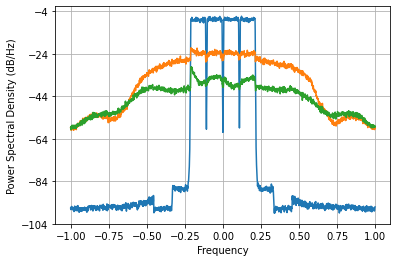

Loss =  8.36796734736438e-05 Accuracy =  -25.819200498217207 dbs


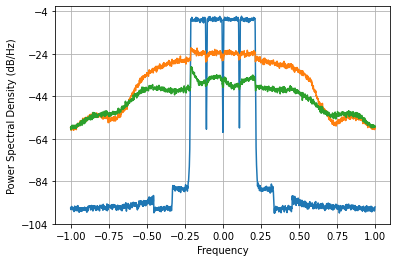

Loss =  8.36510917604929e-05 Accuracy =  -25.820684132193076 dbs


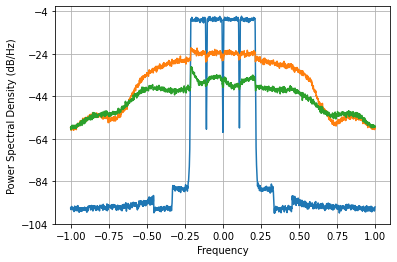

Loss =  8.362090570814192e-05 Accuracy =  -25.822251595523124 dbs


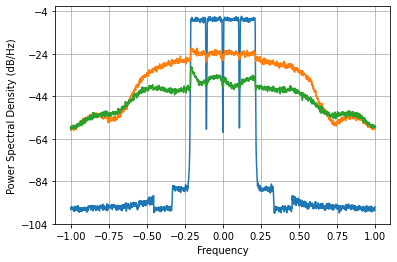

Loss =  8.358884392065772e-05 Accuracy =  -25.823917079454045 dbs


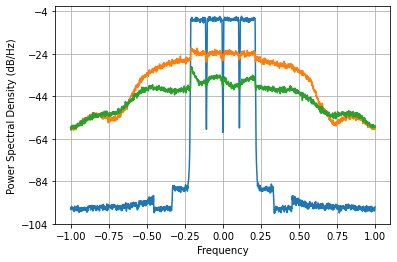

Loss =  8.35546206611016e-05 Accuracy =  -25.82569554839064 dbs


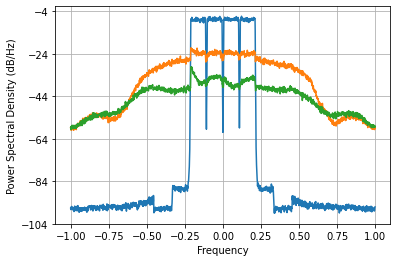

Loss =  8.35179392276677e-05 Accuracy =  -25.827602569435292 dbs


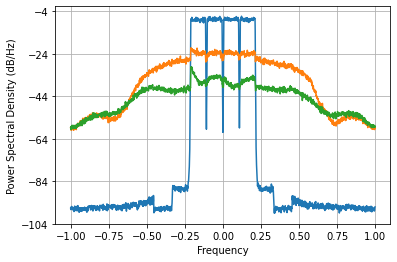

Loss =  8.34785010047623e-05 Accuracy =  -25.829653847040788 dbs


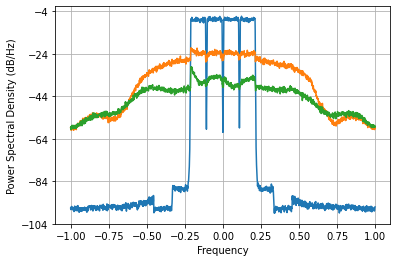

Loss =  8.343602068208336e-05 Accuracy =  -25.8318644360226 dbs


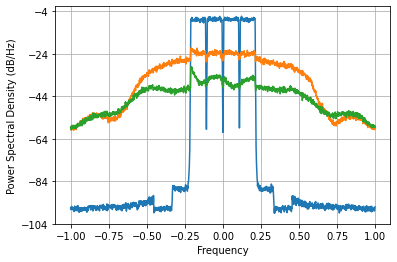

Loss =  8.33902477542176e-05 Accuracy =  -25.83424762551402 dbs


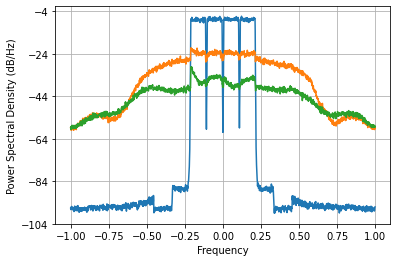

Loss =  8.334099366632069e-05 Accuracy =  -25.83681352486495 dbs


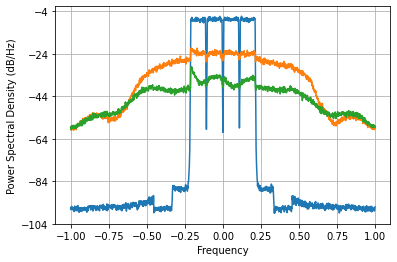

Loss =  8.328816279024731e-05 Accuracy =  -25.839567443711992 dbs


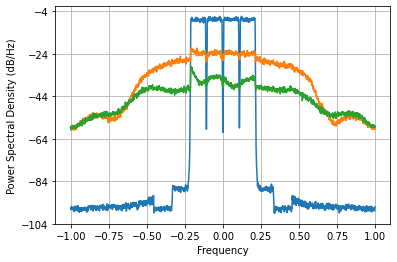

Loss =  8.323178382760469e-05 Accuracy =  -25.842508241352636 dbs


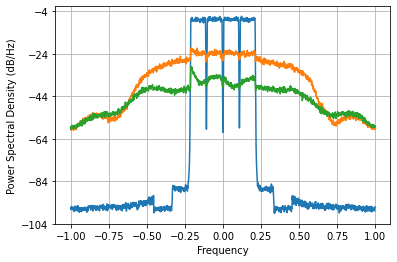

Loss =  8.317203644312147e-05 Accuracy =  -25.845626915005923 dbs


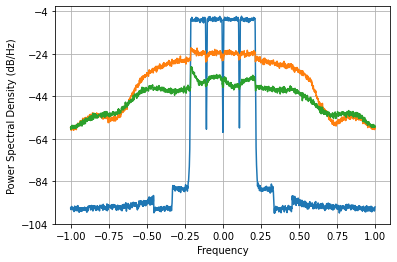

Loss =  8.310926638253455e-05 Accuracy =  -25.848905779408987 dbs


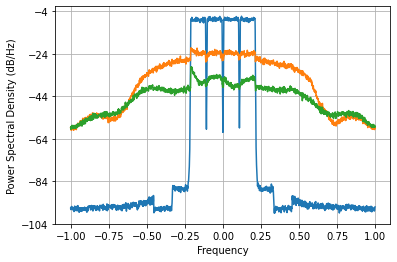

Loss =  8.304398173376455e-05 Accuracy =  -25.852318624417357 dbs


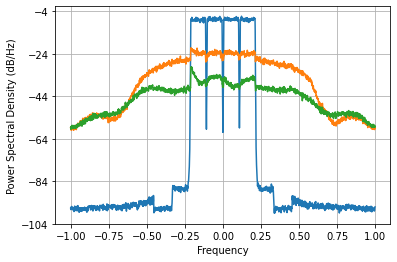

Loss =  8.297682419197002e-05 Accuracy =  -25.855832178185242 dbs


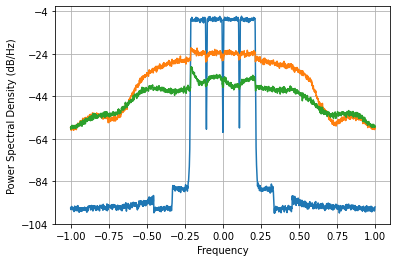

Loss =  8.290851283335006e-05 Accuracy =  -25.859409016055174 dbs


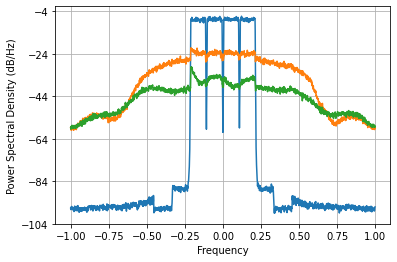

Loss =  8.283976393279385e-05 Accuracy =  -25.863011740673883 dbs


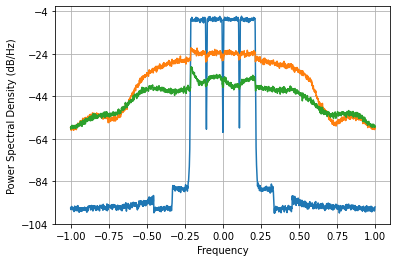

Loss =  8.277119755997332e-05 Accuracy =  -25.866607879334403 dbs


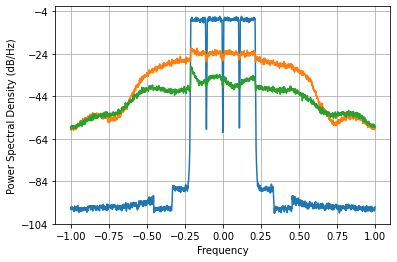

Loss =  8.270324765523547e-05 Accuracy =  -25.87017462588477 dbs


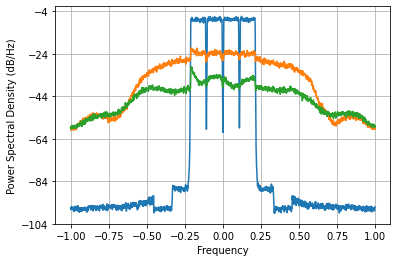

Loss =  8.263609418426932e-05 Accuracy =  -25.873702447292604 dbs


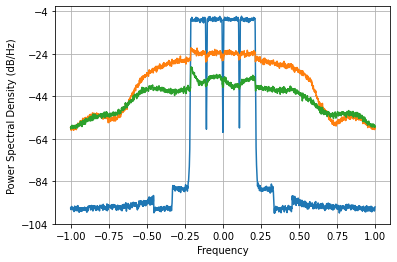

Loss =  8.256963197426874e-05 Accuracy =  -25.87719677806269 dbs


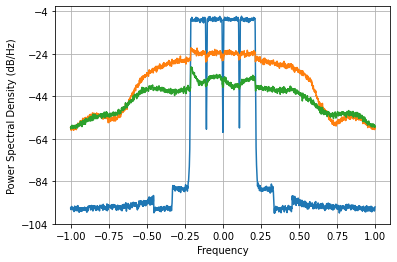

Loss =  8.250348153909818e-05 Accuracy =  -25.880677510920563 dbs


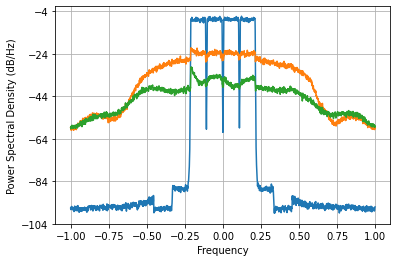

Loss =  8.243703591961423e-05 Accuracy =  -25.884176586574522 dbs


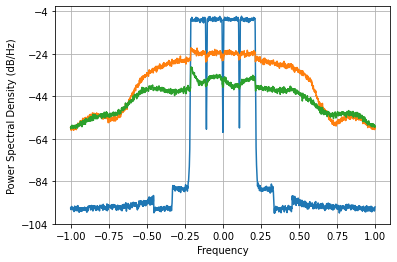

Loss =  8.236952894107285e-05 Accuracy =  -25.88773444362165 dbs


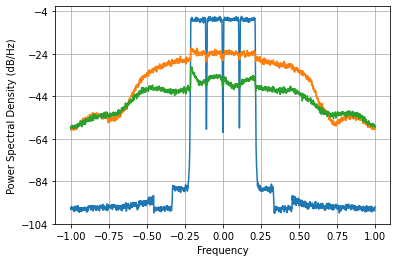

Loss =  8.230010782591104e-05 Accuracy =  -25.891396224824355 dbs


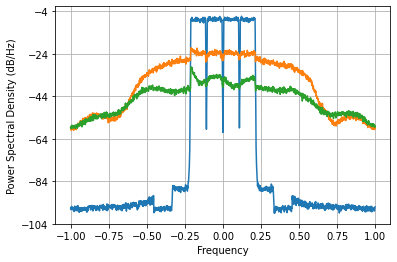

Loss =  8.222789716657365e-05 Accuracy =  -25.89520842602377 dbs


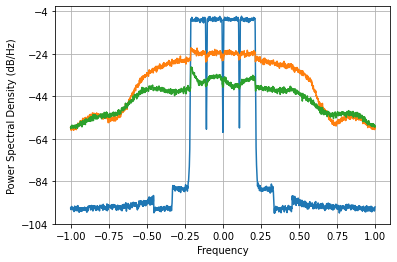

Loss =  8.215204898441778e-05 Accuracy =  -25.899216268839368 dbs


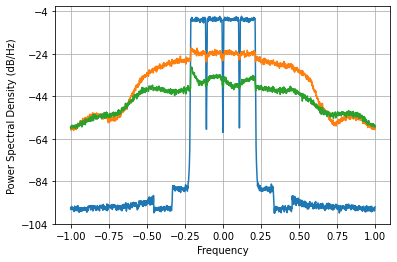

Loss =  8.20717807632739e-05 Accuracy =  -25.90346170001029 dbs


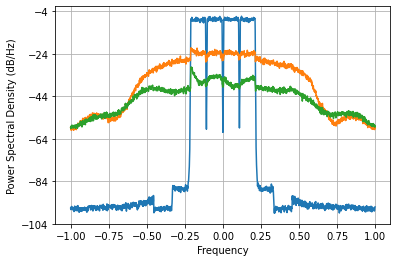

Loss =  8.19864069645219e-05 Accuracy =  -25.907981727149142 dbs


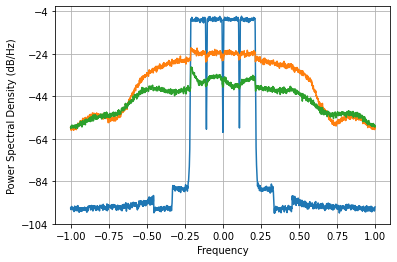

Loss =  8.189536922247657e-05 Accuracy =  -25.912806814355548 dbs


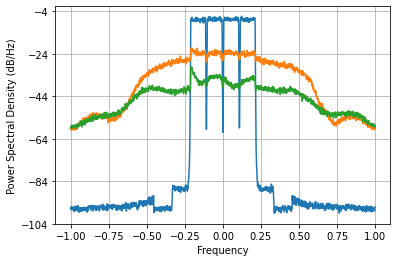

Loss =  8.179826777682852e-05 Accuracy =  -25.917959198742512 dbs


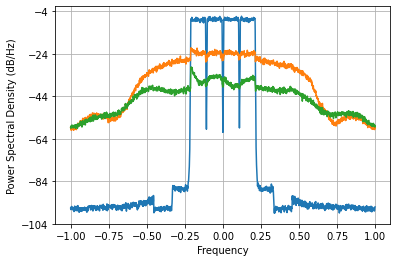

Loss =  8.169489358767439e-05 Accuracy =  -25.92345115272137 dbs


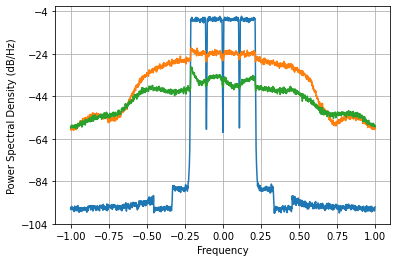

Loss =  8.158525801343227e-05 Accuracy =  -25.929283353586257 dbs


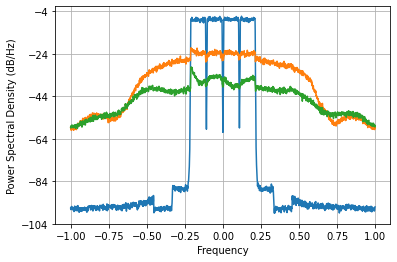

Loss =  8.146961519302394e-05 Accuracy =  -25.935443616840978 dbs


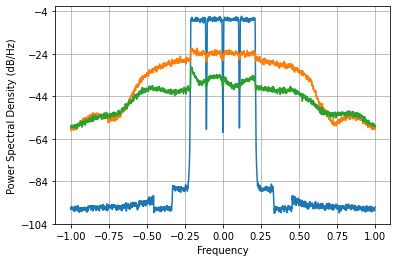

Loss =  8.134847152960641e-05 Accuracy =  -25.94190629372258 dbs


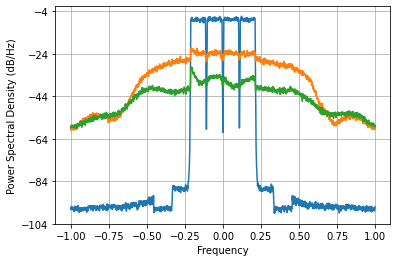

Loss =  8.122257722038147e-05 Accuracy =  -25.94863261001926 dbs


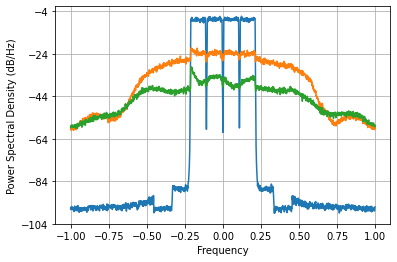

Loss =  8.109289682860201e-05 Accuracy =  -25.955572119745472 dbs


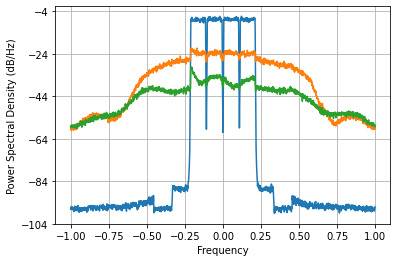

Loss =  8.096055930374597e-05 Accuracy =  -25.962665269245818 dbs


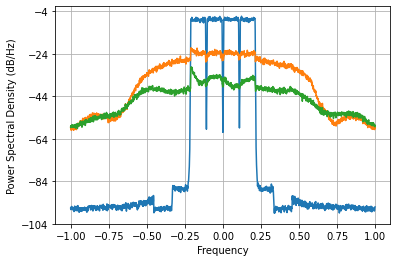

Loss =  8.082679197353427e-05 Accuracy =  -25.969846847552066 dbs


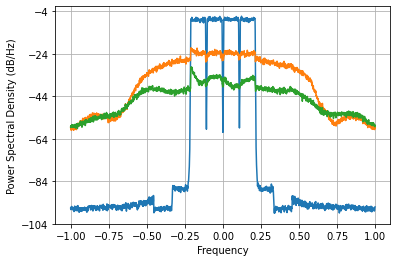

Loss =  8.069284673884968e-05 Accuracy =  -25.977049896060542 dbs


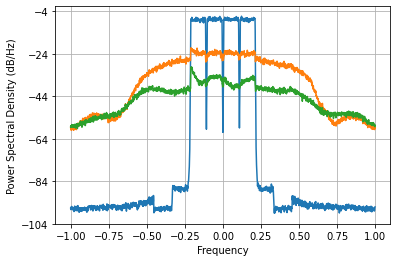

Loss =  8.055992872681194e-05 Accuracy =  -25.984209533726386 dbs


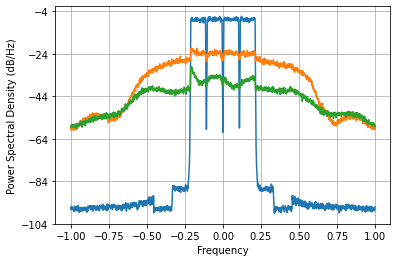

Loss =  8.04291371257625e-05 Accuracy =  -25.99126617236347 dbs


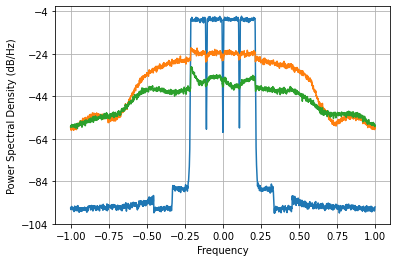

Loss =  8.030142488092496e-05 Accuracy =  -25.998167751526072 dbs


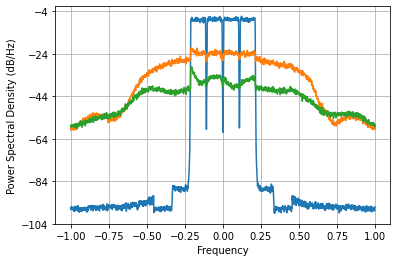

Loss =  8.017757943526714e-05 Accuracy =  -26.004870859457814 dbs


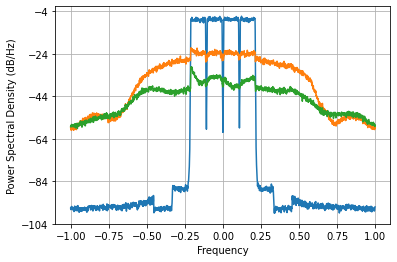

Loss =  8.00582223702216e-05 Accuracy =  -26.011340839790357 dbs


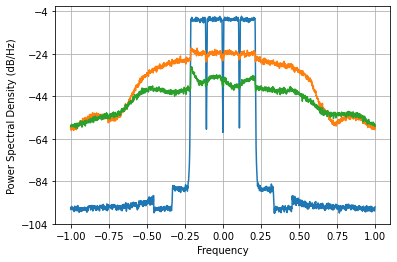

Loss =  7.994382297843107e-05 Accuracy =  -26.01755113953316 dbs


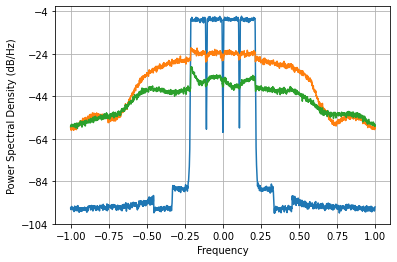

Loss =  7.983471993500465e-05 Accuracy =  -26.023482205897807 dbs


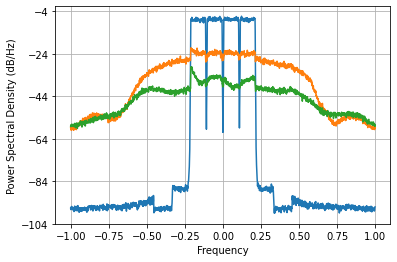

Loss =  7.973114587500684e-05 Accuracy =  -26.029120209842375 dbs


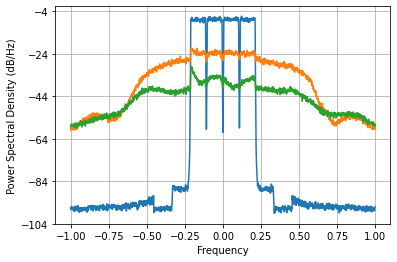

Loss =  7.963325100421634e-05 Accuracy =  -26.034455806546674 dbs


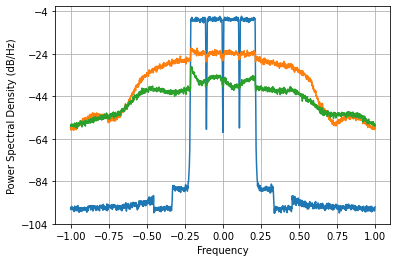

Loss =  7.954112320945893e-05 Accuracy =  -26.039483072720447 dbs


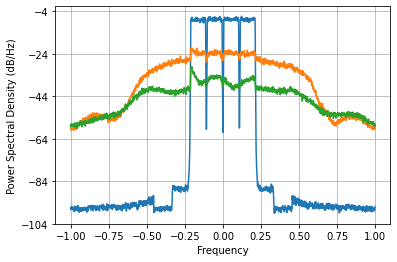

Loss =  7.945480320092167e-05 Accuracy =  -26.04419870385832 dbs


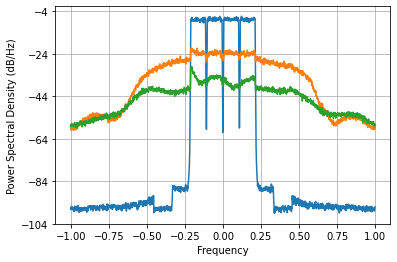

Loss =  7.937429397335231e-05 Accuracy =  -26.048601513783247 dbs


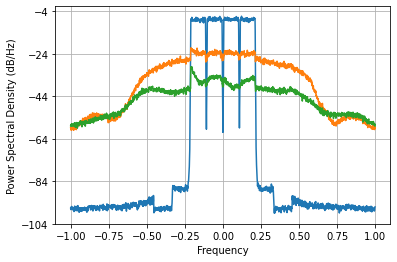

Loss =  7.929956438350018e-05 Accuracy =  -26.052692250750667 dbs


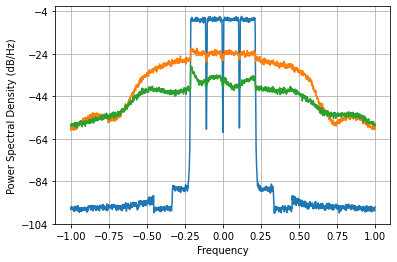

Loss =  7.923054701458211e-05 Accuracy =  -26.056473723444526 dbs



In [ ]:
net = Cell_upd()
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist13 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)

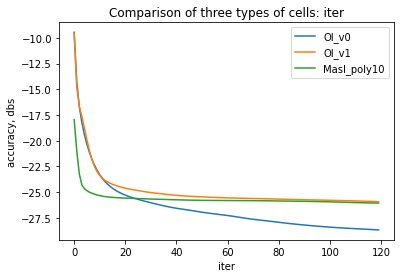

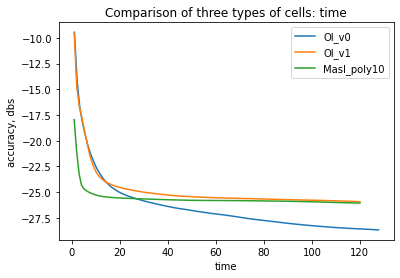

In [ ]:
Comparison_best_res(hist11, hist12, hist13)

In [ ]:
class Cell_upd2(nn.Module):
    def __init__(self,M=15,D=0,Poly_order=10,Passthrough=True):
        super(Cell_upd2,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,0)
        self.delay=Delay(D)
        self.pol=Polynomial(Poly_order,True) # было Passthrough
        self.prod=Prod_cmp()
    def forward(self,x):
        source = x.clone()
        x=self.delay(x)
        up=self.f1(x) 
        return up+self.f2(self.prod(self.pol(x), x))
        #return self.prod(up,self.f2(self.pol(x))+x)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


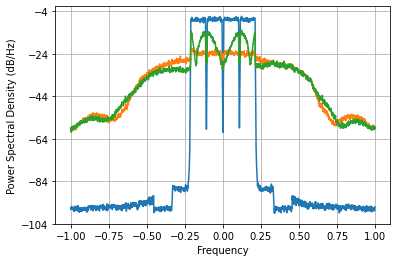

Loss =  0.003565667367169062 Accuracy =  -9.523992002832696 dbs


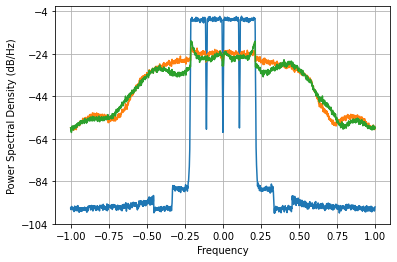

Loss =  0.0010238579017831343 Accuracy =  -14.943003403157288 dbs


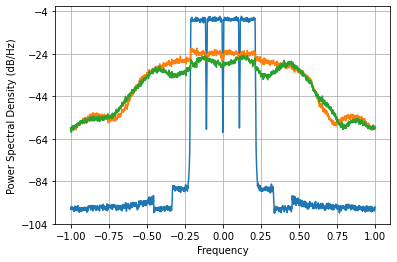

Loss =  0.0006212683721545769 Accuracy =  -17.11260781796141 dbs


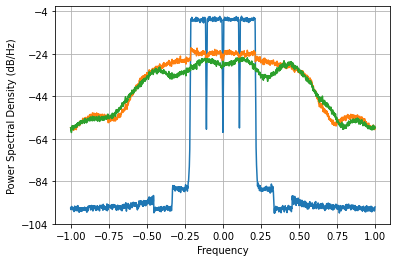

Loss =  0.0005462641050045209 Accuracy =  -17.671373627115067 dbs


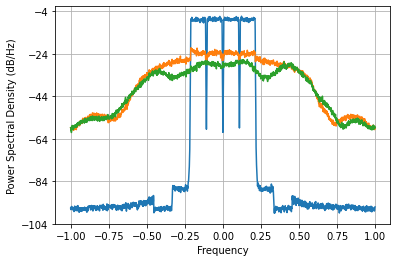

Loss =  0.00046021528690137986 Accuracy =  -18.41578986222082 dbs


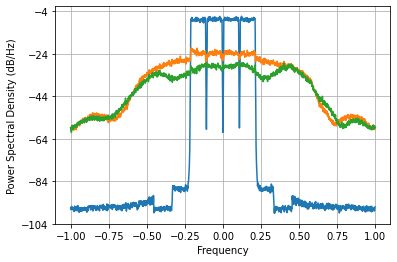

Loss =  0.00037524646593963776 Accuracy =  -19.302234159265353 dbs


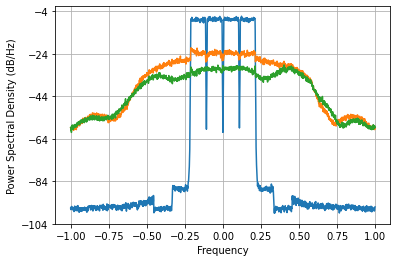

Loss =  0.00029652894801183354 Accuracy =  -20.32472929837445 dbs


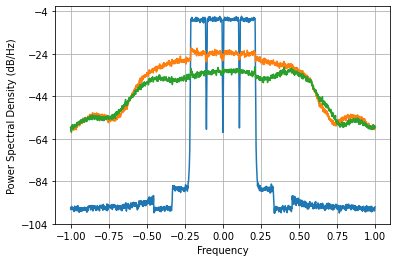

Loss =  0.00023402594749608168 Accuracy =  -21.35276014450612 dbs


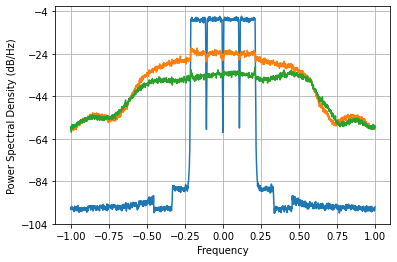

Loss =  0.00019046341764996491 Accuracy =  -22.24728453702406 dbs


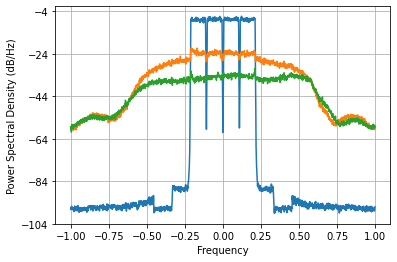

Loss =  0.00016264266670723175 Accuracy =  -22.933055402593038 dbs


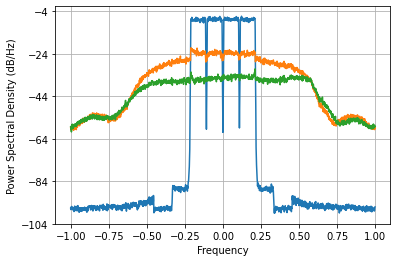

Loss =  0.00014599666192197916 Accuracy =  -23.401971005300833 dbs


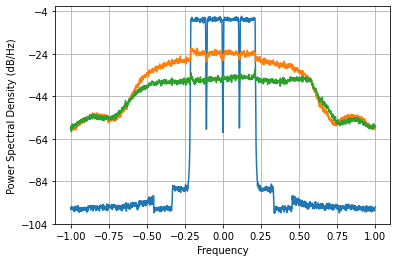

Loss =  0.00013600582179335545 Accuracy =  -23.709825277399723 dbs


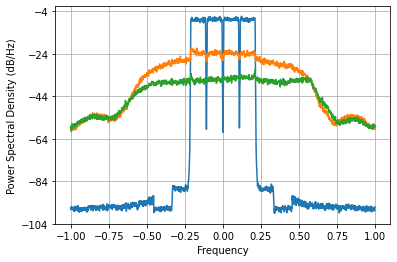

Loss =  0.0001296825014923505 Accuracy =  -23.91658647504729 dbs


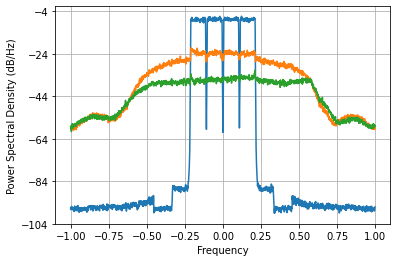

Loss =  0.00012526528078508735 Accuracy =  -24.067093104655193 dbs


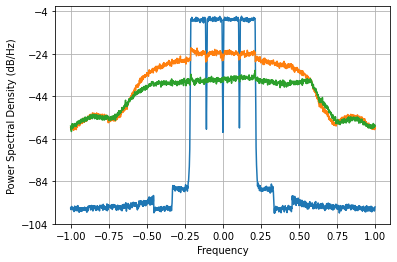

Loss =  0.00012185996703447765 Accuracy =  -24.186789703849843 dbs


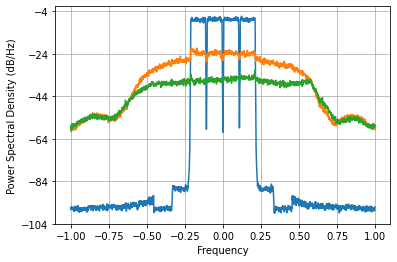

Loss =  0.00011908340614614086 Accuracy =  -24.286887783981506 dbs


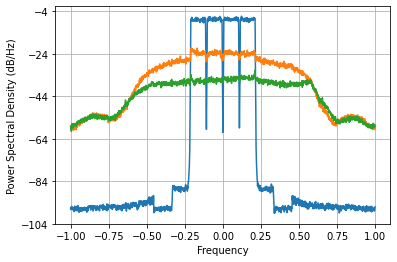

Loss =  0.00011672785107438627 Accuracy =  -24.37365536325685 dbs


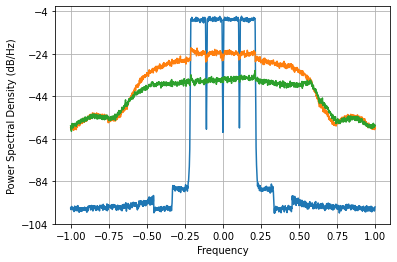

Loss =  0.00011466278352884546 Accuracy =  -24.451175462830296 dbs


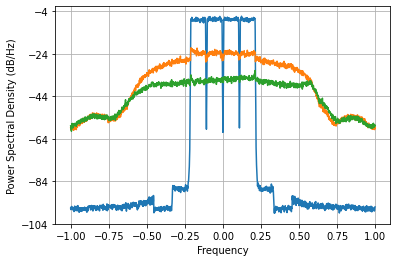

Loss =  0.00011280298299021513 Accuracy =  -24.522194422974664 dbs


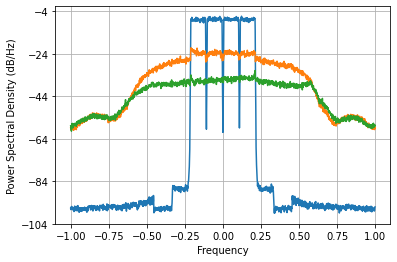

Loss =  0.00011111323025156333 Accuracy =  -24.587742532275033 dbs


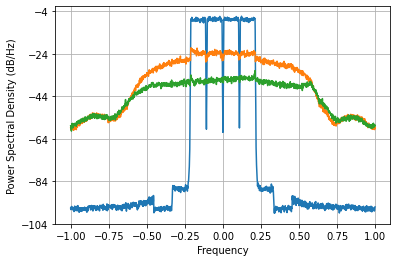

Loss =  0.00010958977978413148 Accuracy =  -24.647699724515423 dbs


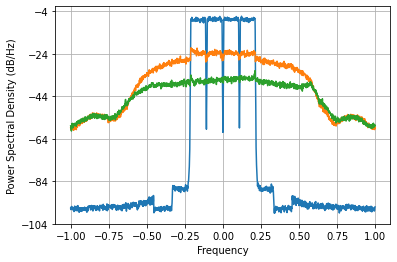

Loss =  0.00010822178998879421 Accuracy =  -24.702253137999794 dbs


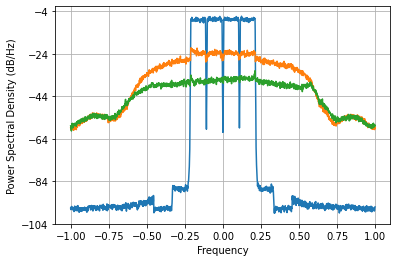

Loss =  0.0001069729156453534 Accuracy =  -24.752661936265895 dbs


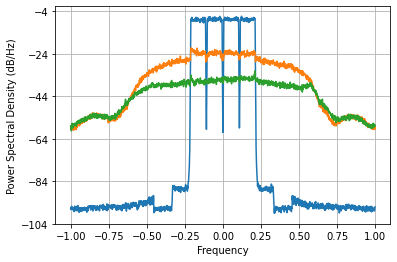

Loss =  0.00010579620826243826 Accuracy =  -24.80069923830363 dbs


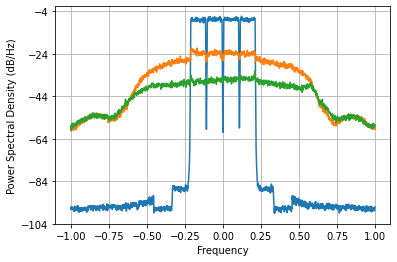

Loss =  0.00010465905458955509 Accuracy =  -24.847632193535148 dbs


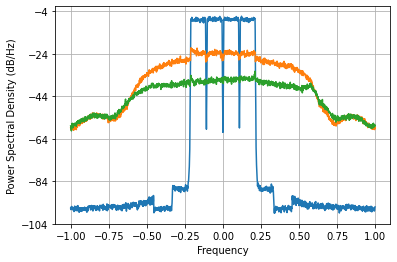

Loss =  0.000103555410510194 Accuracy =  -24.893672320697142 dbs


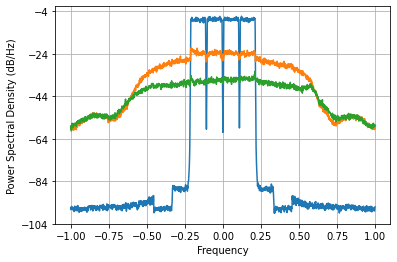

Loss =  0.00010250287939569978 Accuracy =  -24.93803961412564 dbs


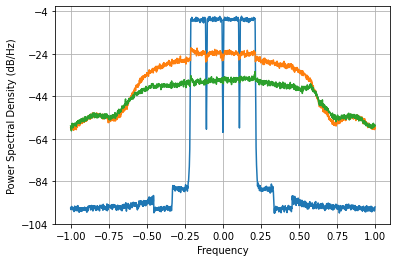

Loss =  0.00010153079593783914 Accuracy =  -24.97942235894066 dbs


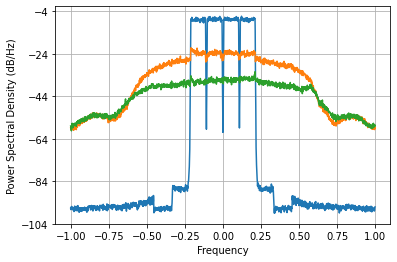

Loss =  0.00010065940746205285 Accuracy =  -25.01685657121434 dbs


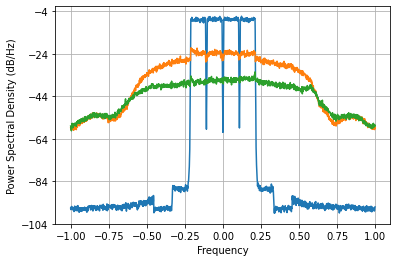

Loss =  9.988199572318278e-05 Accuracy =  -25.050528153666882 dbs


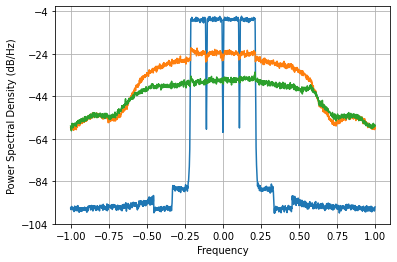

Loss =  9.917016910058263e-05 Accuracy =  -25.08158972914467 dbs


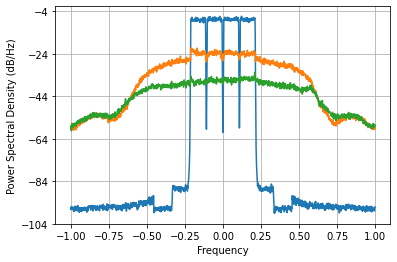

Loss =  9.849460835090975e-05 Accuracy =  -25.111275690590126 dbs


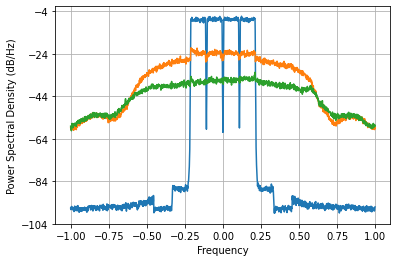

Loss =  9.783665260327238e-05 Accuracy =  -25.140384414171276 dbs


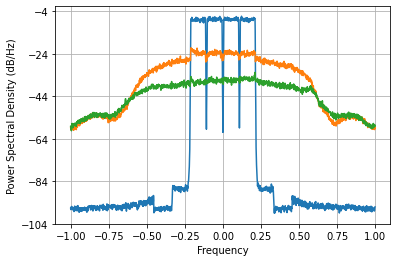

Loss =  9.718752472984233e-05 Accuracy =  -25.169295054729286 dbs


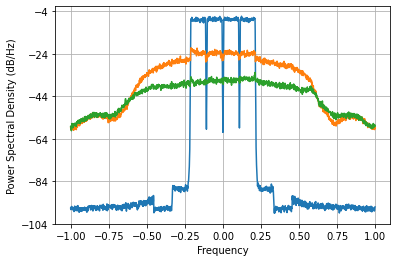

Loss =  9.654401763312328e-05 Accuracy =  -25.19814658872332 dbs


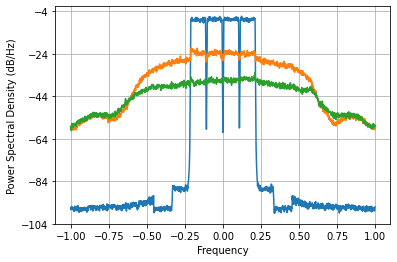

Loss =  9.590667411967668e-05 Accuracy =  -25.2269119602966 dbs


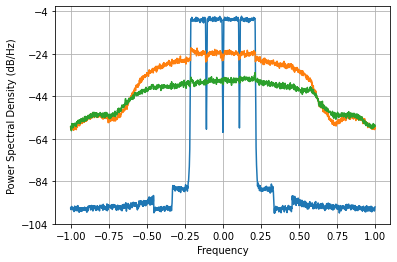

Loss =  9.528150534341433e-05 Accuracy =  -25.255314167822185 dbs


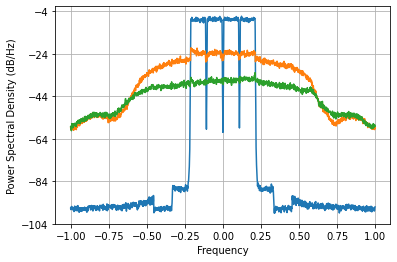

Loss =  9.468048161500804e-05 Accuracy =  -25.282795682823895 dbs


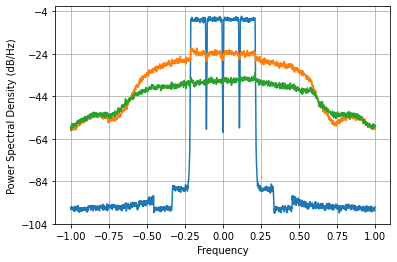

Loss =  9.411850848982174e-05 Accuracy =  -25.30864990459779 dbs


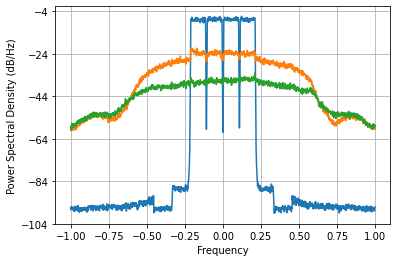

Loss =  9.36079951099463e-05 Accuracy =  -25.332270830372554 dbs


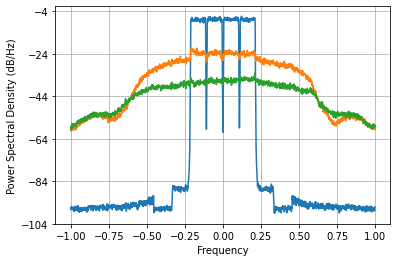

Loss =  9.315358947267732e-05 Accuracy =  -25.353404325322796 dbs


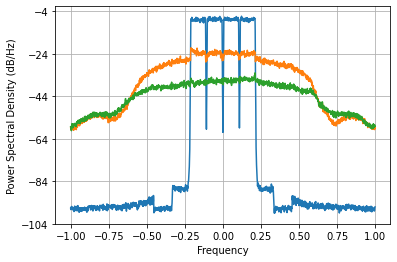

Loss =  9.275121719876965e-05 Accuracy =  -25.372204090023335 dbs


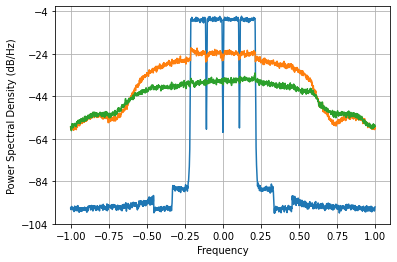

Loss =  9.239187033356771e-05 Accuracy =  -25.3890626785558 dbs


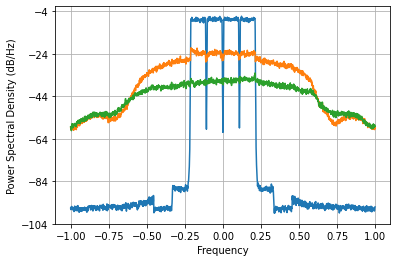

Loss =  9.206621629412304e-05 Accuracy =  -25.40439731656113 dbs


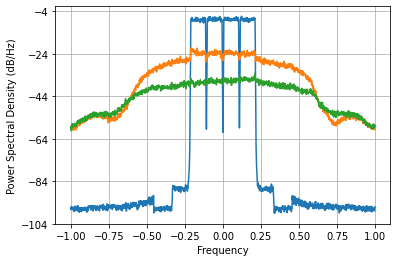

Loss =  9.176670116334607e-05 Accuracy =  -25.418549067557805 dbs


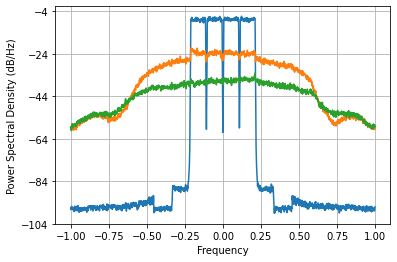

Loss =  9.148722129168295e-05 Accuracy =  -25.431795895625044 dbs


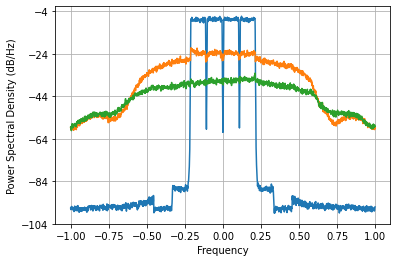

Loss =  9.122223883896232e-05 Accuracy =  -25.444392998984714 dbs


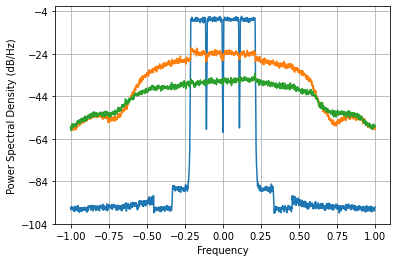

Loss =  9.096648732275472e-05 Accuracy =  -25.45658601965353 dbs


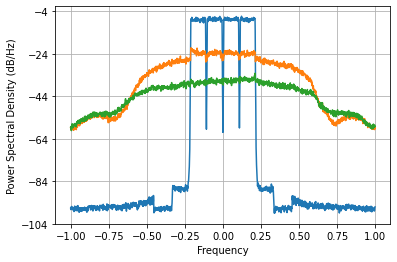

Loss =  9.071517126405445e-05 Accuracy =  -25.468601018632633 dbs


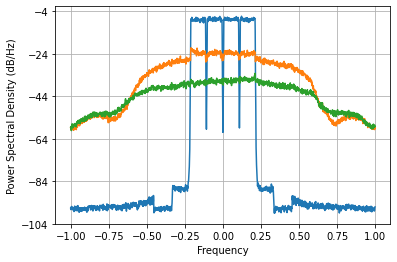

Loss =  9.046442345372814e-05 Accuracy =  -25.48062206990732 dbs


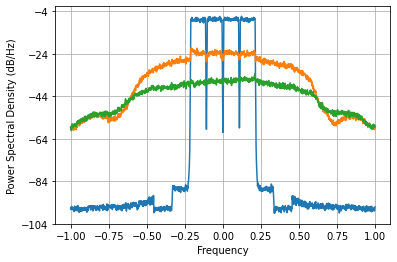

Loss =  9.021199320613314e-05 Accuracy =  -25.492757481595767 dbs


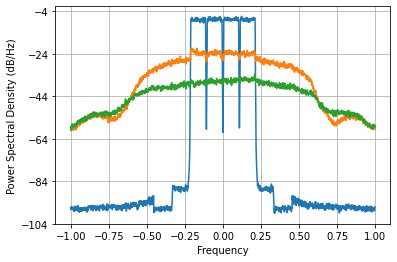

Loss =  8.995800210123269e-05 Accuracy =  -25.505002251674725 dbs


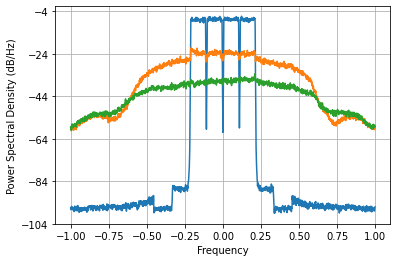

Loss =  8.970541287869008e-05 Accuracy =  -25.517213772626373 dbs


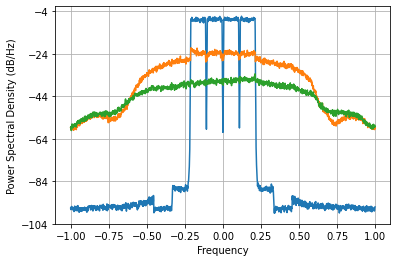

Loss =  8.945981170836378e-05 Accuracy =  -25.529120469372742 dbs


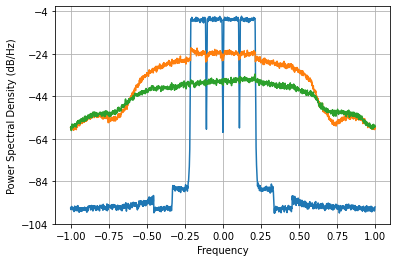

Loss =  8.922826732187612e-05 Accuracy =  -25.540375669629604 dbs


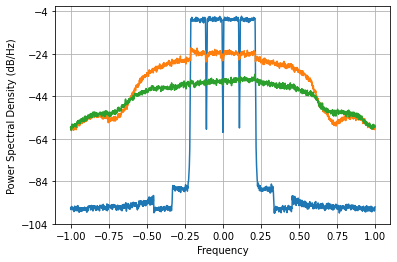

Loss =  8.901746070500394e-05 Accuracy =  -25.5506482516606 dbs


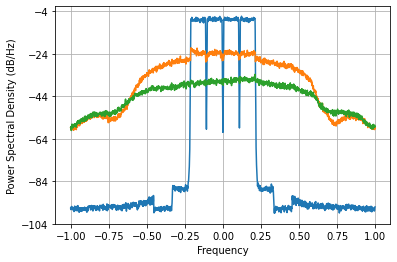

Loss =  8.883177343896467e-05 Accuracy =  -25.5597169423065 dbs


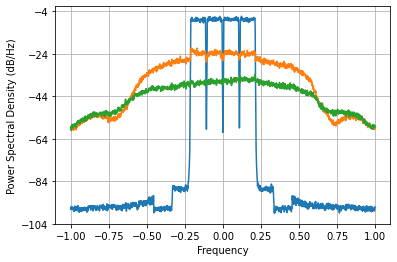

Loss =  8.867218224762882e-05 Accuracy =  -25.567526299812368 dbs


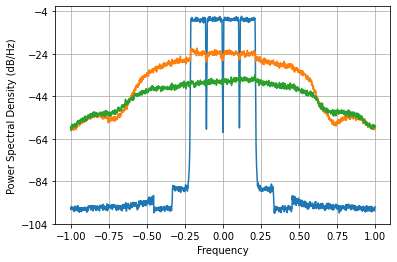

Loss =  8.853641669042276e-05 Accuracy =  -25.57418085768559 dbs


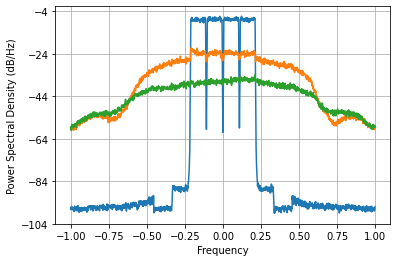

Loss =  8.842014607243083e-05 Accuracy =  -25.579887986517633 dbs


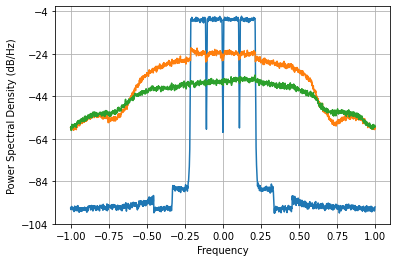

Loss =  8.831849810479441e-05 Accuracy =  -25.584883516104732 dbs


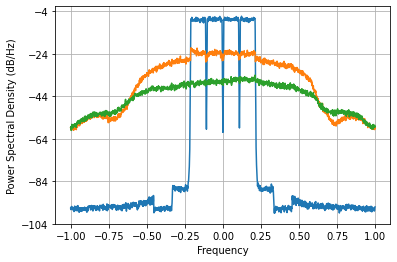

Loss =  8.822724765669865e-05 Accuracy =  -25.589372955307844 dbs


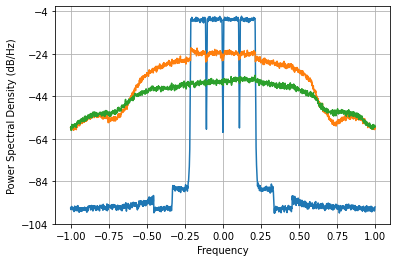

Loss =  8.814336517779135e-05 Accuracy =  -25.593503995040496 dbs


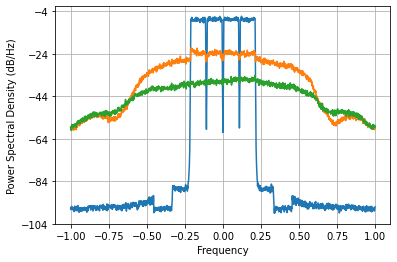

Loss =  8.806495323672884e-05 Accuracy =  -25.5973691786905 dbs


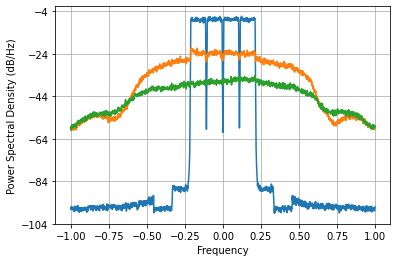

Loss =  8.799078857768638e-05 Accuracy =  -25.601028168025096 dbs


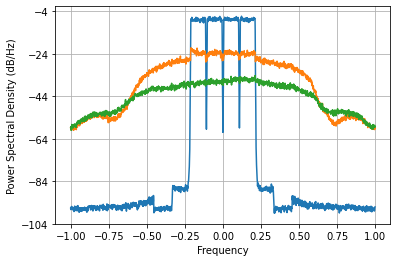

Loss =  8.791976479960374e-05 Accuracy =  -25.604535090832066 dbs


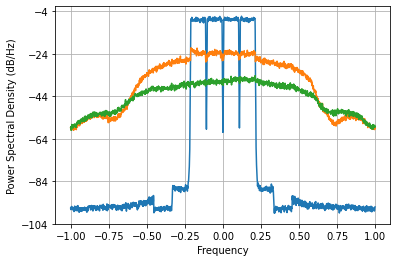

Loss =  8.785053099110468e-05 Accuracy =  -25.607956358619322 dbs


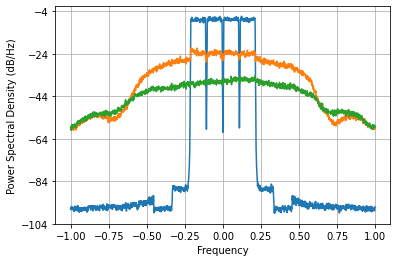

Loss =  8.778151219147443e-05 Accuracy =  -25.611369686258953 dbs


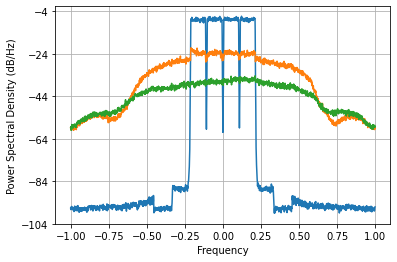

Loss =  8.771126939169561e-05 Accuracy =  -25.614846303552415 dbs


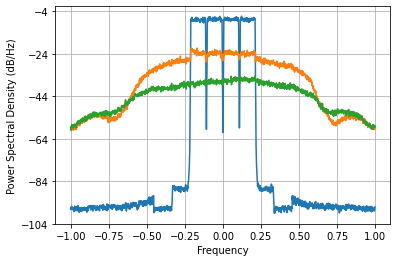

Loss =  8.76389222488304e-05 Accuracy =  -25.61842998560223 dbs


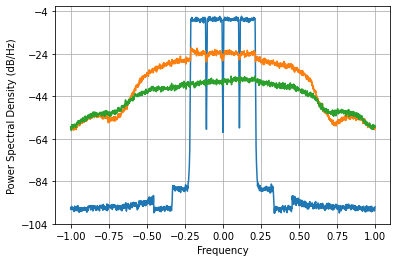

Loss =  8.75643051619994e-05 Accuracy =  -25.622129208670724 dbs


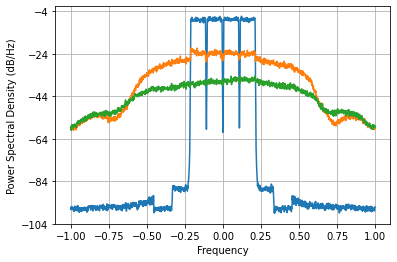

Loss =  8.748772161305548e-05 Accuracy =  -25.625929200644038 dbs


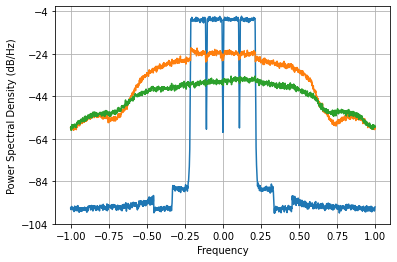

Loss =  8.74094340835707e-05 Accuracy =  -25.629817182034294 dbs


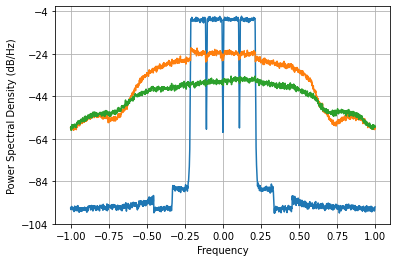

Loss =  8.732915476334499e-05 Accuracy =  -25.633807699351394 dbs


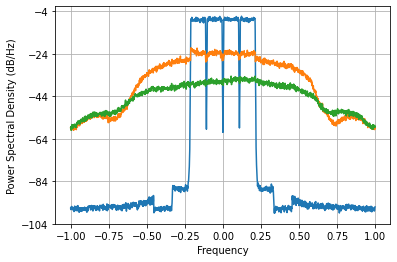

Loss =  8.724574123220926e-05 Accuracy =  -25.63795789962372 dbs


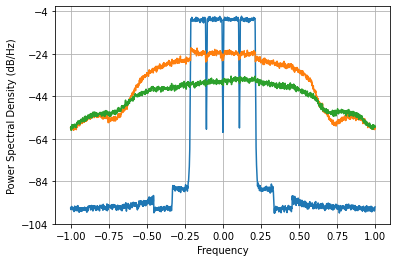

Loss =  8.715716491402855e-05 Accuracy =  -25.642369318030767 dbs


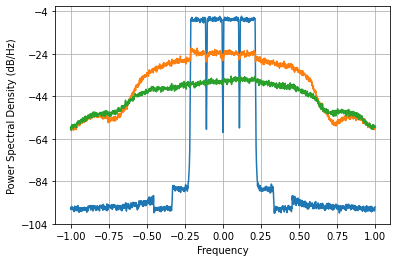

Loss =  8.706072115307856e-05 Accuracy =  -25.64717766445474 dbs


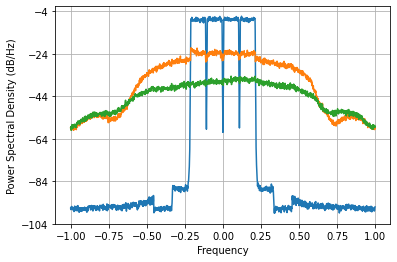

Loss =  8.695342321940695e-05 Accuracy =  -25.652533425227737 dbs


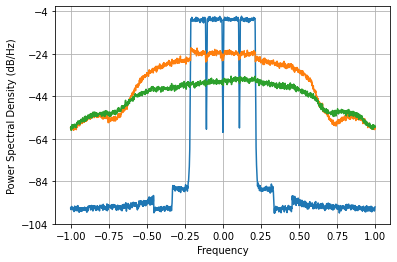

Loss =  8.683253402474272e-05 Accuracy =  -25.658575515102584 dbs


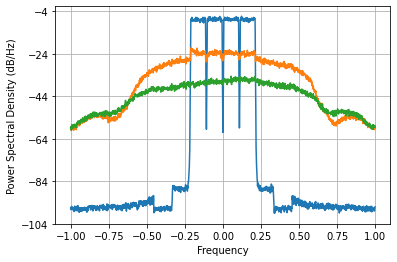

Loss =  8.669617896134238e-05 Accuracy =  -25.66540069841471 dbs


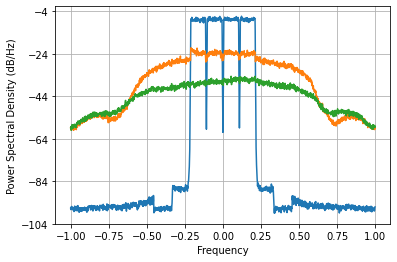

Loss =  8.65439223459799e-05 Accuracy =  -25.67303452273269 dbs


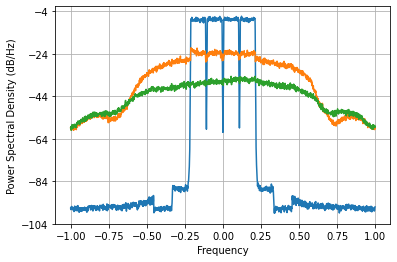

Loss =  8.637711117553527e-05 Accuracy =  -25.68141351421113 dbs


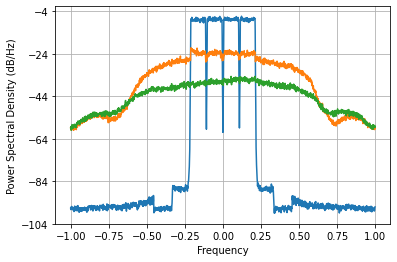

Loss =  8.619877771689062e-05 Accuracy =  -25.69038919037226 dbs


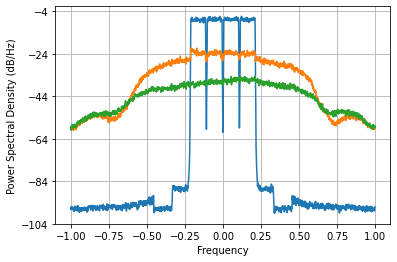

Loss =  8.601303424365086e-05 Accuracy =  -25.69975758338085 dbs


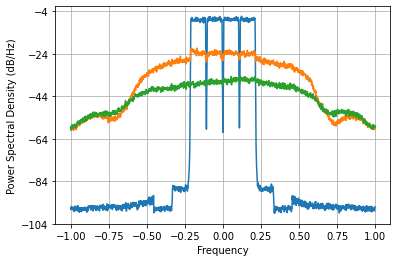

Loss =  8.582417673671926e-05 Accuracy =  -25.709303805143016 dbs


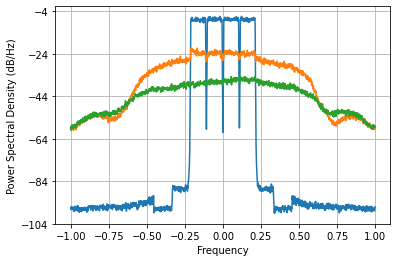

Loss =  8.563594312390676e-05 Accuracy =  -25.71883941636988 dbs


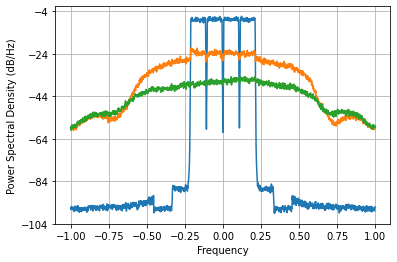

Loss =  8.545128097967334e-05 Accuracy =  -25.728214491781888 dbs


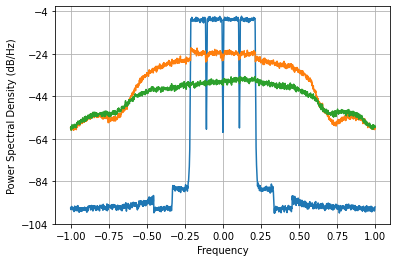

Loss =  8.527256310278973e-05 Accuracy =  -25.737307095866203 dbs


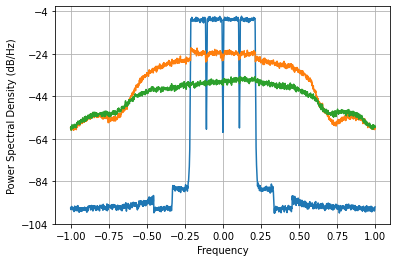

Loss =  8.51018326325813e-05 Accuracy =  -25.746011141518537 dbs


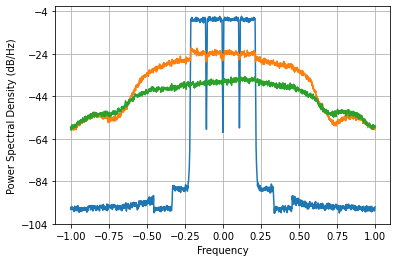

Loss =  8.494073771486745e-05 Accuracy =  -25.754239981463027 dbs


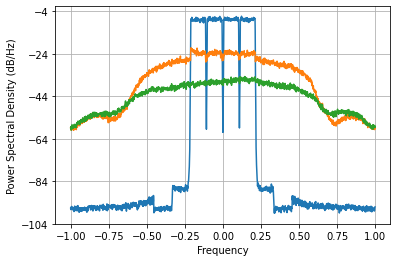

Loss =  8.47902118981119e-05 Accuracy =  -25.761943060823455 dbs


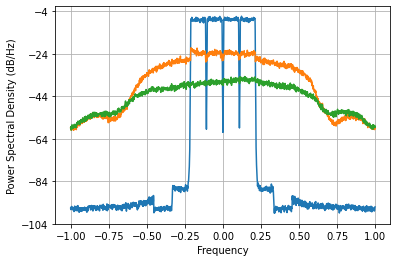

Loss =  8.465022064533257e-05 Accuracy =  -25.76911932229985 dbs


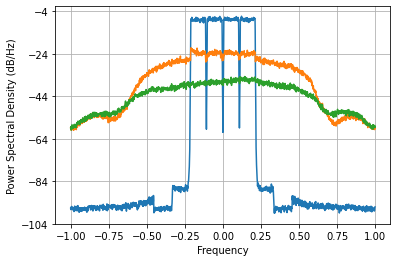

Loss =  8.451980540052914e-05 Accuracy =  -25.77581538231926 dbs


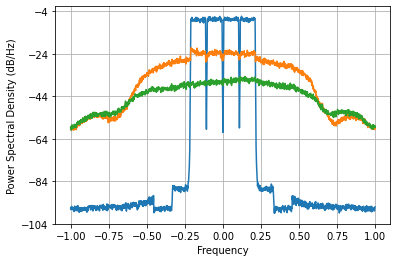

Loss =  8.439739247336297e-05 Accuracy =  -25.78210997739398 dbs


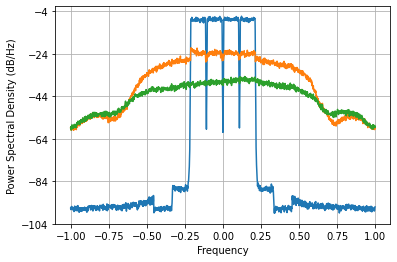

Loss =  8.428117326733891e-05 Accuracy =  -25.788094539526423 dbs


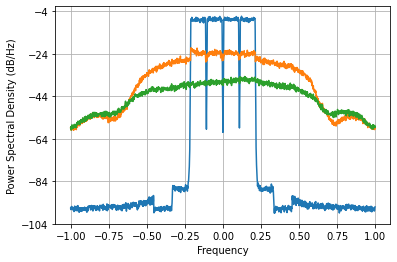

Loss =  8.416939237597371e-05 Accuracy =  -25.793858346996267 dbs


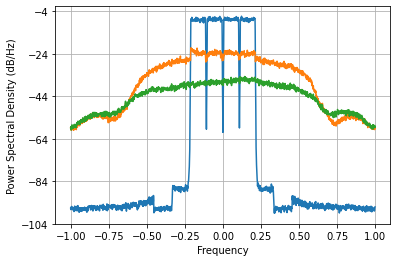

Loss =  8.406049297056226e-05 Accuracy =  -25.7994809410272 dbs


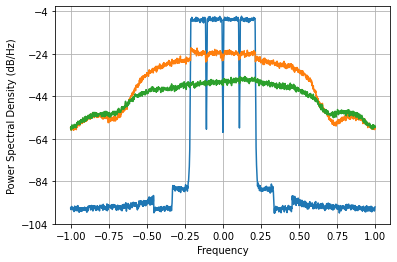

Loss =  8.39531506425426e-05 Accuracy =  -25.805030274530587 dbs


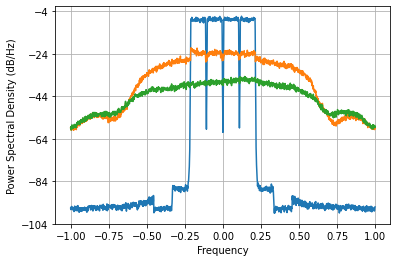

Loss =  8.38462534764763e-05 Accuracy =  -25.810563650036627 dbs


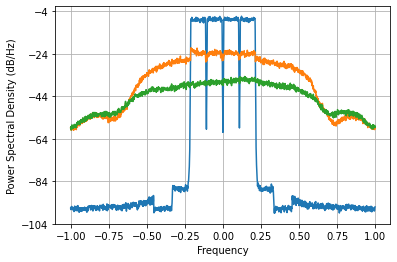

Loss =  8.373887488036994e-05 Accuracy =  -25.816129052957827 dbs


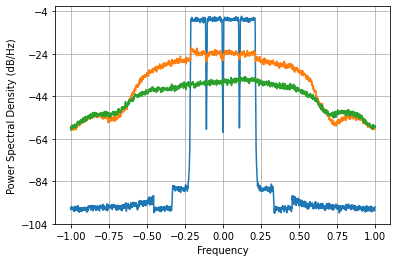

Loss =  8.363026043676133e-05 Accuracy =  -25.821765774453294 dbs


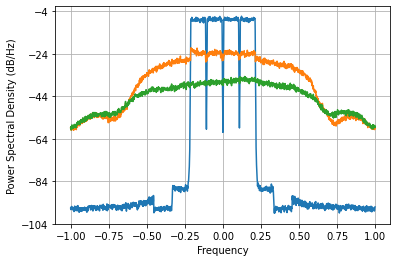

Loss =  8.351983252297913e-05 Accuracy =  -25.827504118923436 dbs


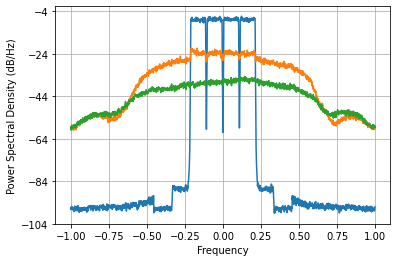

Loss =  8.340720953555763e-05 Accuracy =  -25.833364349691436 dbs


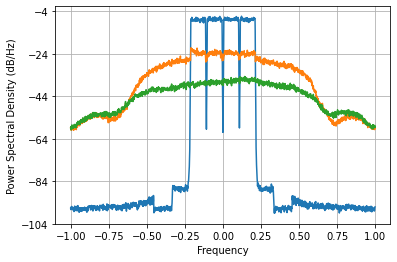

Loss =  8.329223269748762e-05 Accuracy =  -25.83935522927325 dbs


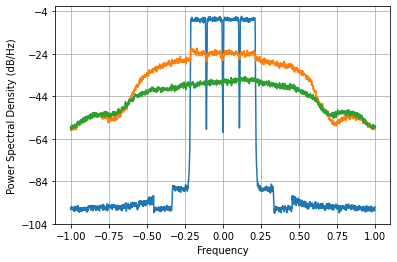

Loss =  8.317498912821241e-05 Accuracy =  -25.845472739139236 dbs


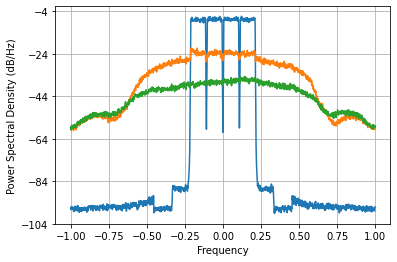

Loss =  8.305581668721053e-05 Accuracy =  -25.85169973685304 dbs


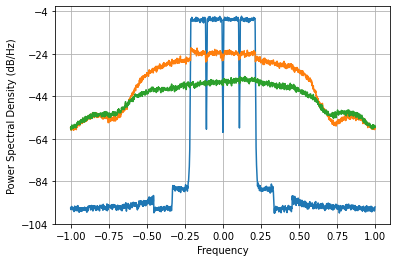

Loss =  8.293527737424943e-05 Accuracy =  -25.858007252080817 dbs


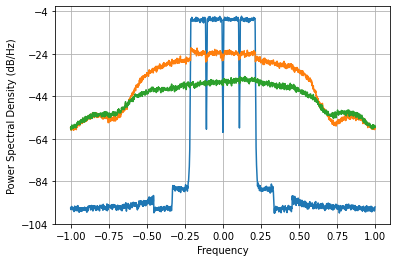

Loss =  8.281409347998967e-05 Accuracy =  -25.864357744475328 dbs


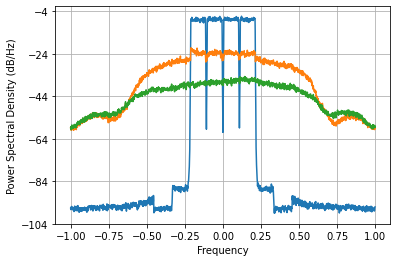

Loss =  8.269305313541943e-05 Accuracy =  -25.87070999743615 dbs


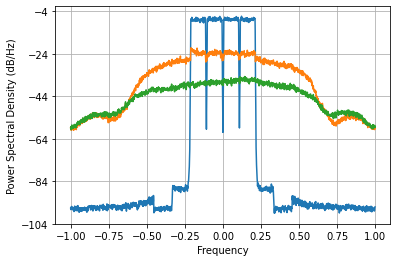

Loss =  8.257290458697088e-05 Accuracy =  -25.877024650678948 dbs


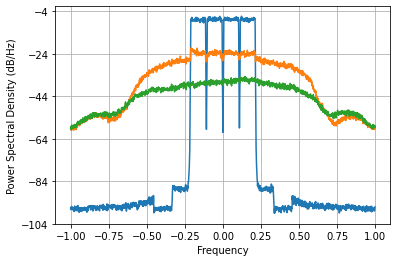

Loss =  8.245426452674675e-05 Accuracy =  -25.883269044573755 dbs


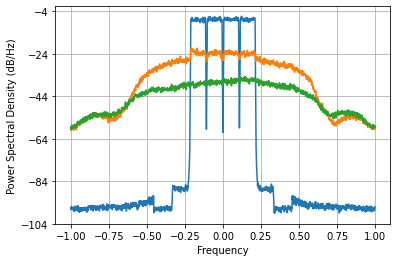

Loss =  8.233756087030401e-05 Accuracy =  -25.88942029174419 dbs


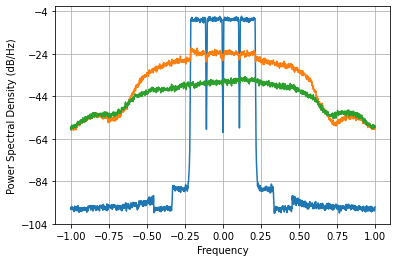

Loss =  8.222301682409042e-05 Accuracy =  -25.895466193616482 dbs


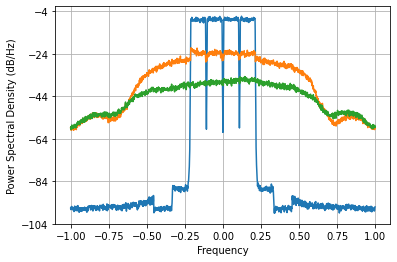

Loss =  8.211066863182883e-05 Accuracy =  -25.901404380594677 dbs


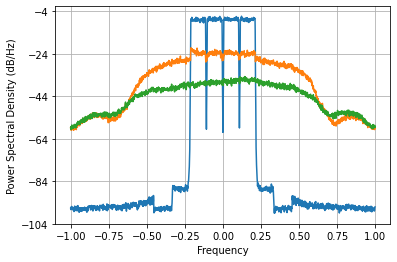

Loss =  8.200040141508996e-05 Accuracy =  -25.9072404830535 dbs


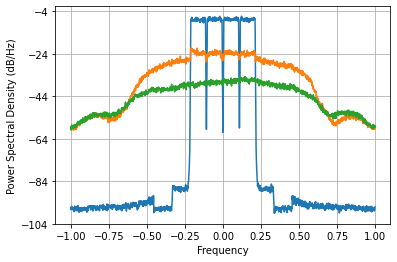

Loss =  8.189198820432046e-05 Accuracy =  -25.912986114828023 dbs


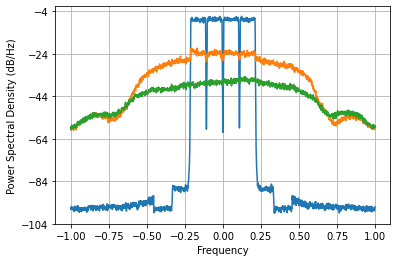

Loss =  8.178512361181535e-05 Accuracy =  -25.918657122694114 dbs


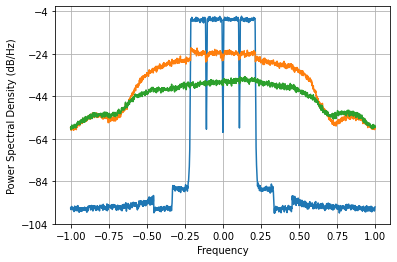

Loss =  8.167945105153899e-05 Accuracy =  -25.924272163910732 dbs


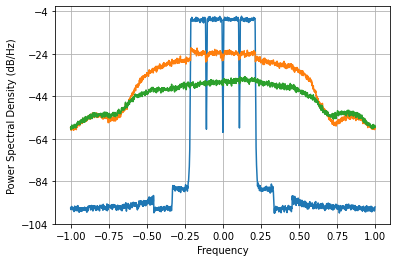

Loss =  8.157458782686218e-05 Accuracy =  -25.929851385889915 dbs


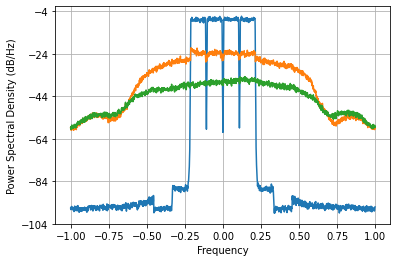

Loss =  8.147015466964437e-05 Accuracy =  -25.935414858764346 dbs



In [ ]:
net = Cell_upd2()
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist14 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)

Сравнение с клеткой Masl(сложение ветвей)

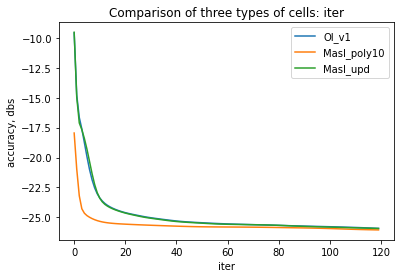

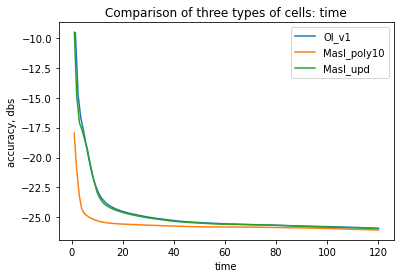

In [ ]:
Comparison_best_res(hist12, hist13, hist14)

In [ ]:
class Cell_upd3(nn.Module):
    def __init__(self,M=15,D=0,Poly_order=10,Passthrough=True):
        super(Cell_upd3,self).__init__()
        self.f1=AFIR(M,0)
        self.f2=AFIR(M,0)
        self.delay=Delay(D)
        self.pol=Polynomial(Poly_order,True) # было Passthrough
        self.prod=Prod_cmp()
    def forward(self,x):
        source = x.clone()
        x=self.delay(x)
        up=self.f1(x) 
        return up+self.prod(self.pol(x), x)
        #return self.prod(up,self.f2(self.pol(x))+x)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


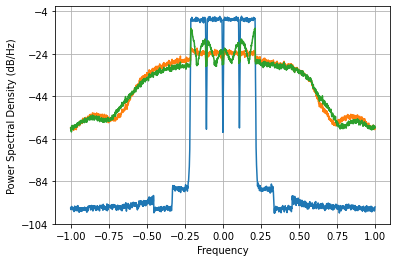

Loss =  0.002214201577138387 Accuracy =  -11.593228709161556 dbs


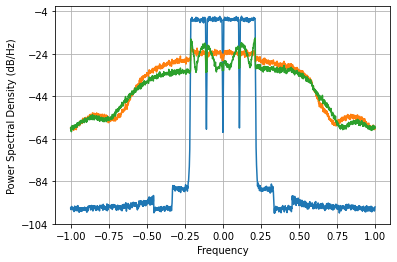

Loss =  0.001132573300099693 Accuracy =  -14.504737075718818 dbs


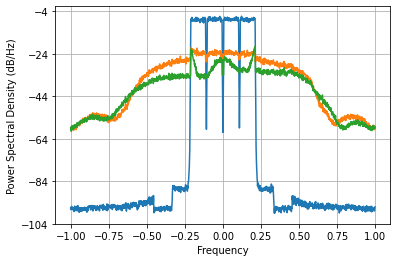

Loss =  0.00042665109070194965 Accuracy =  -18.744671664764446 dbs


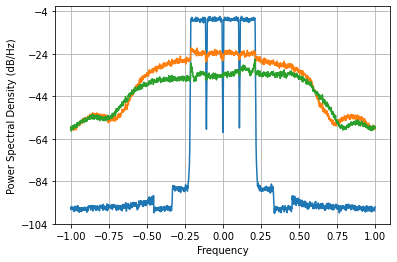

Loss =  0.00022785796233099943 Accuracy =  -21.46875817399362 dbs


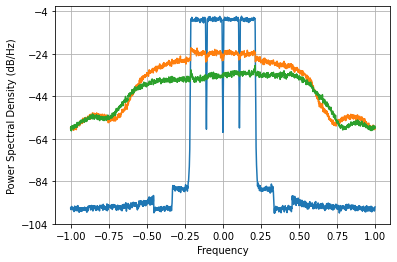

Loss =  0.00019433975807923133 Accuracy =  -22.15978368918683 dbs


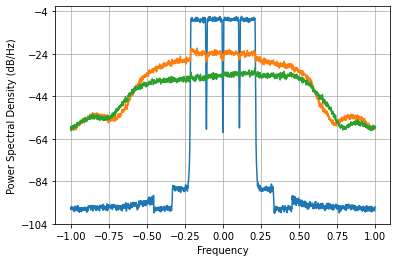

Loss =  0.00018941652943770852 Accuracy =  -22.27122151649521 dbs


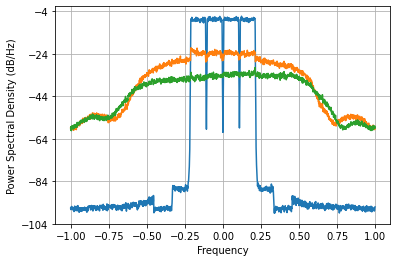

Loss =  0.00018729030285691438 Accuracy =  -22.320247347628403 dbs


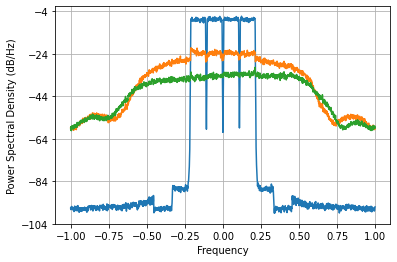

Loss =  0.0001855660313782198 Accuracy =  -22.360415469129183 dbs


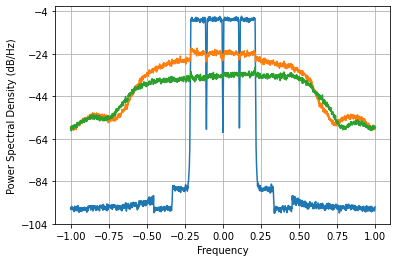

Loss =  0.00018369336981412213 Accuracy =  -22.404465454238277 dbs


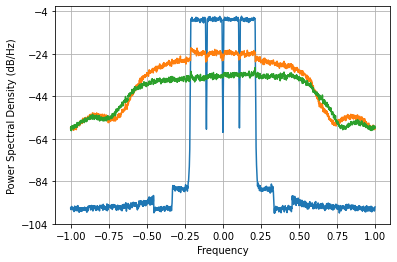

Loss =  0.00018175237316664586 Accuracy =  -22.450599364751778 dbs


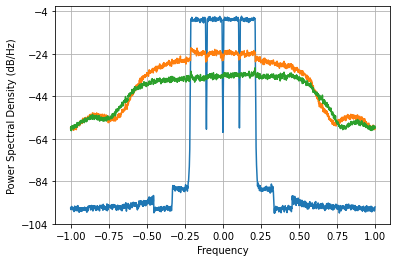

Loss =  0.00017990659889078115 Accuracy =  -22.494929333299375 dbs


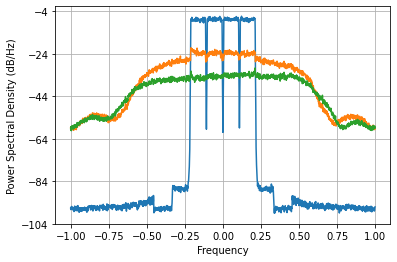

Loss =  0.0001782759638229201 Accuracy =  -22.534472336124203 dbs


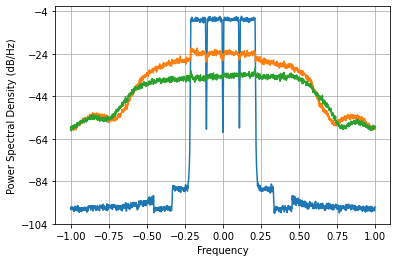

Loss =  0.0001767708196600348 Accuracy =  -22.571294510029905 dbs


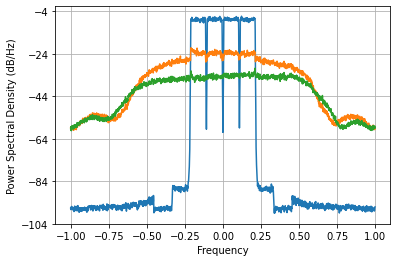

Loss =  0.00017521324879481845 Accuracy =  -22.609730843257193 dbs


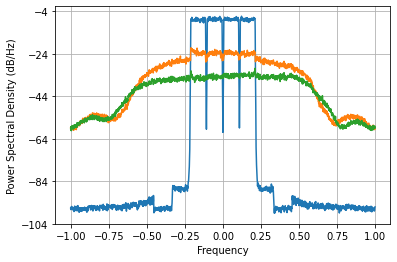

Loss =  0.00017360728728937964 Accuracy =  -22.649720756453327 dbs


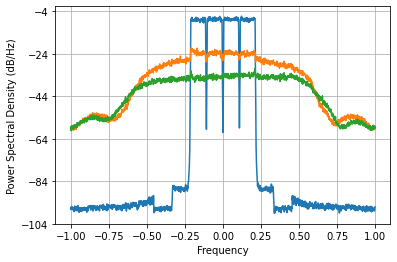

Loss =  0.0001720451821943576 Accuracy =  -22.68897511170991 dbs


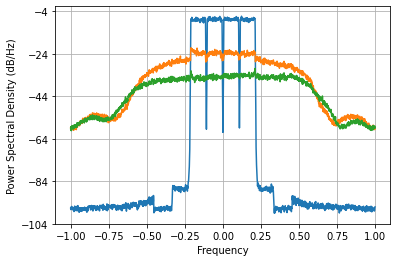

Loss =  0.00017056227410116128 Accuracy =  -22.726570488691866 dbs


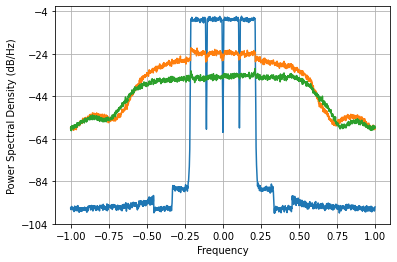

Loss =  0.00016914051700826988 Accuracy =  -22.76292372932129 dbs


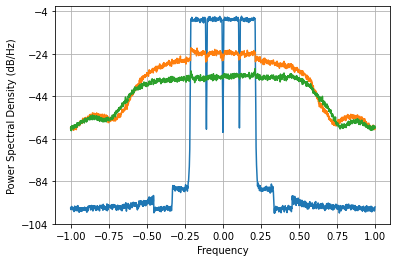

Loss =  0.00016775657676862353 Accuracy =  -22.798604713295745 dbs


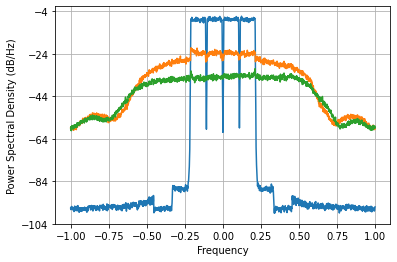

Loss =  0.00016639938918415077 Accuracy =  -22.833882989308837 dbs


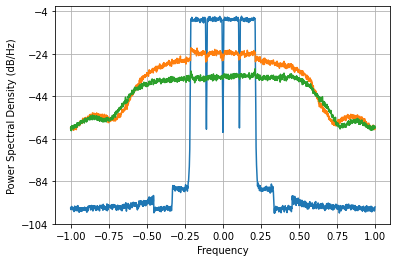

Loss =  0.0001650691755991822 Accuracy =  -22.86874044382511 dbs


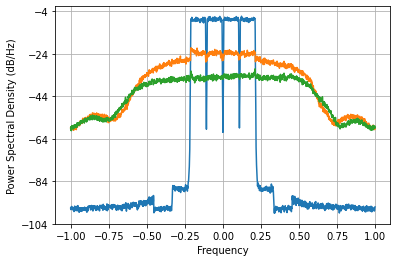

Loss =  0.00016376669291057303 Accuracy =  -22.903144476766002 dbs


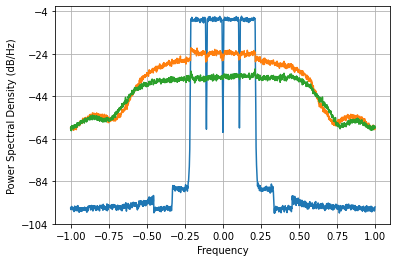

Loss =  0.00016248810245817917 Accuracy =  -22.93718459686722 dbs


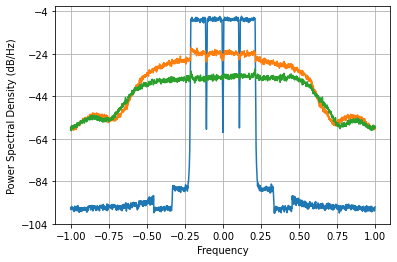

Loss =  0.00016122508989412234 Accuracy =  -22.971073989296208 dbs


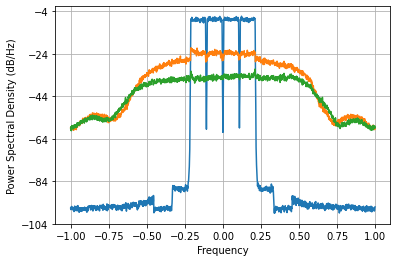

Loss =  0.0001599642871177498 Accuracy =  -23.005169917754365 dbs


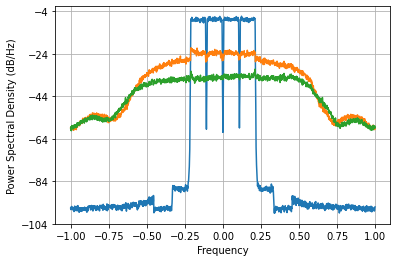

Loss =  0.00015868983752342623 Accuracy =  -23.039909112050672 dbs


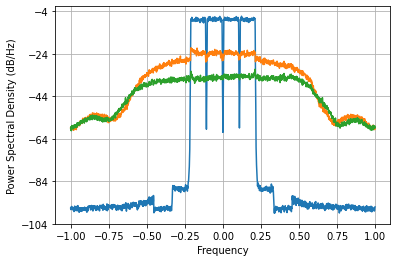

Loss =  0.0001573892947433623 Accuracy =  -23.07564837369107 dbs


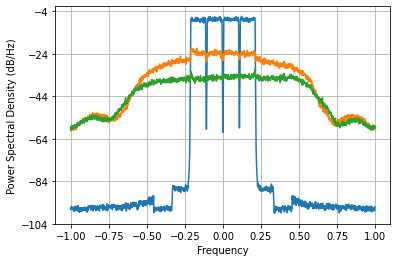

Loss =  0.00015606105218179446 Accuracy =  -23.112454960348572 dbs


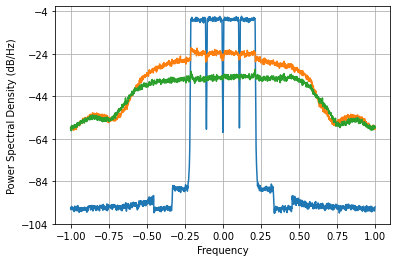

Loss =  0.0001547194319379392 Accuracy =  -23.14995164485705 dbs


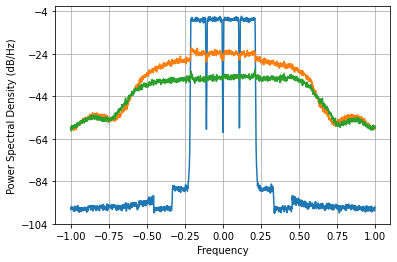

Loss =  0.00015339203962331195 Accuracy =  -23.18737204476664 dbs


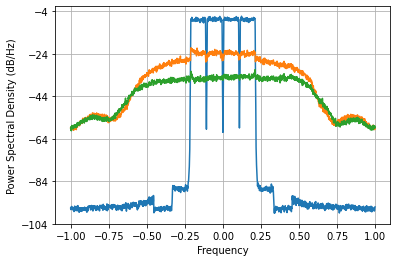

Loss =  0.00015210770091463833 Accuracy =  -23.223888246005902 dbs


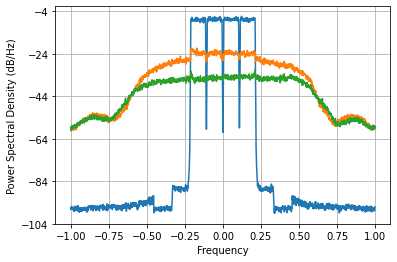

Loss =  0.00015088251973725903 Accuracy =  -23.259010985189352 dbs


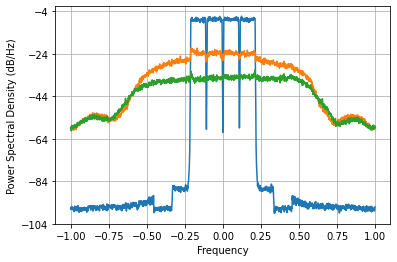

Loss =  0.00014971579754709228 Accuracy =  -23.292723985191806 dbs


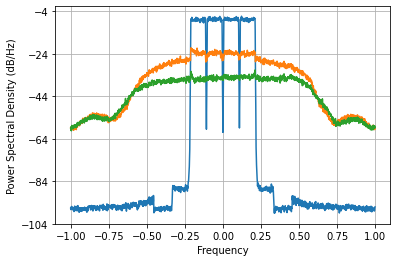

Loss =  0.00014859692827694172 Accuracy =  -23.325301946941114 dbs


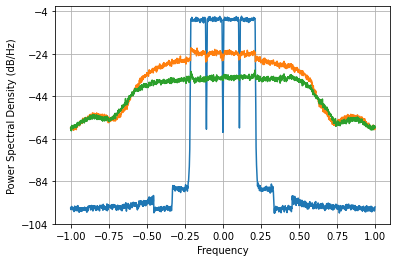

Loss =  0.0001475136986659623 Accuracy =  -23.357076743144376 dbs


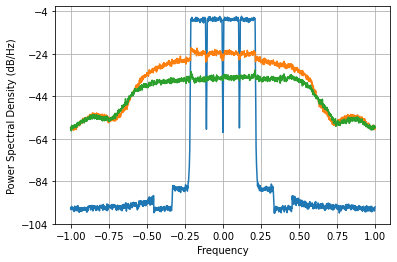

Loss =  0.0001464564593009452 Accuracy =  -23.388314961680873 dbs


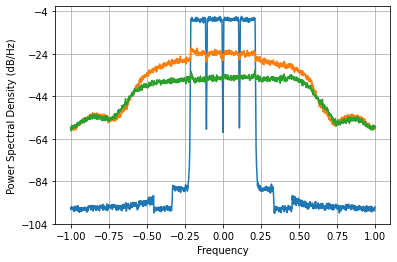

Loss =  0.00014541869418053128 Accuracy =  -23.419197862066564 dbs


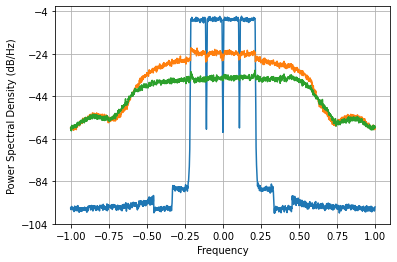

Loss =  0.00014439560641279044 Accuracy =  -23.44986047718535 dbs


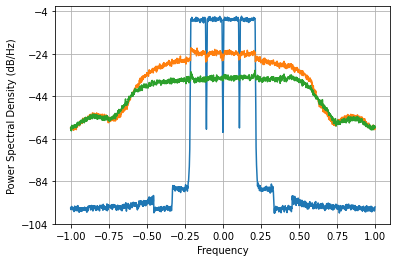

Loss =  0.00014338316622350975 Accuracy =  -23.480418603312273 dbs


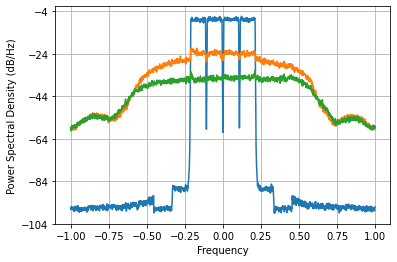

Loss =  0.00014237856967297353 Accuracy =  -23.51095400963043 dbs


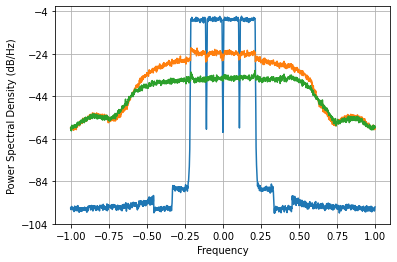

Loss =  0.0001413809289336282 Accuracy =  -23.541491958516843 dbs


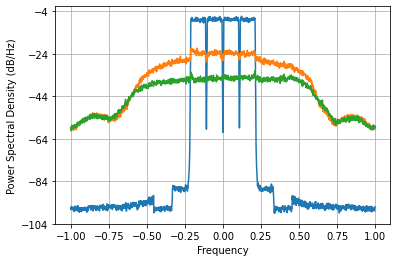

Loss =  0.00014039149634119188 Accuracy =  -23.571992237658254 dbs


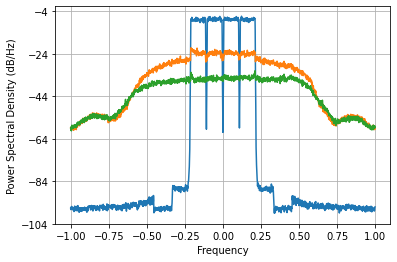

Loss =  0.0001394134405420867 Accuracy =  -23.602353815354306 dbs


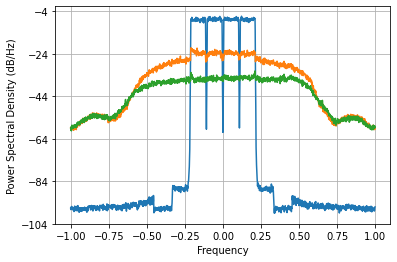

Loss =  0.00013845104452948827 Accuracy =  -23.632437901047876 dbs


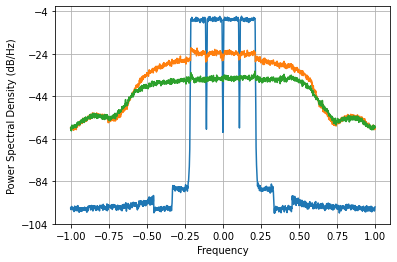

Loss =  0.00013750844309996625 Accuracy =  -23.662106617644874 dbs


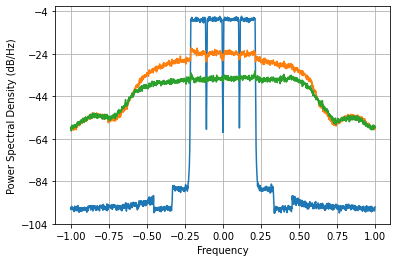

Loss =  0.00013658838064228875 Accuracy =  -23.6912627051672 dbs


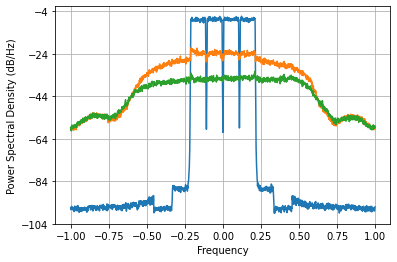

Loss =  0.00013569153201052327 Accuracy =  -23.71987280840235 dbs


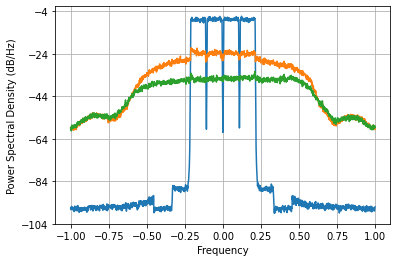

Loss =  0.00013481668022594743 Accuracy =  -23.747963979761263 dbs


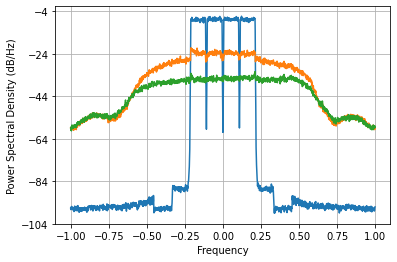

Loss =  0.00013396156445085372 Accuracy =  -23.775598159451775 dbs


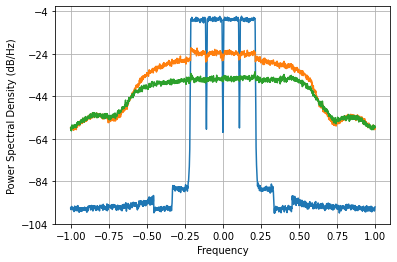

Loss =  0.00013312386854681346 Accuracy =  -23.802840970675906 dbs


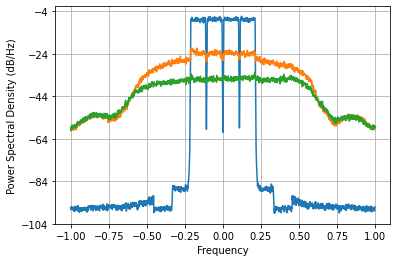

Loss =  0.00013230186567255817 Accuracy =  -23.82974058195488 dbs


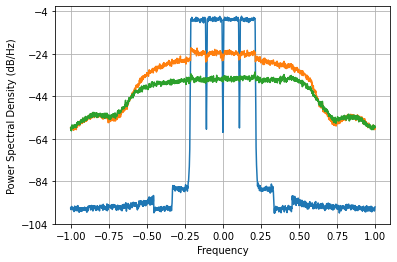

Loss =  0.00013149456657050423 Accuracy =  -23.856322187841272 dbs


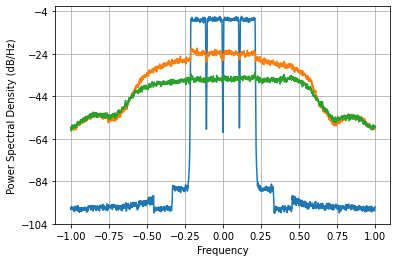

Loss =  0.00013070152601303266 Accuracy =  -23.882593684483915 dbs


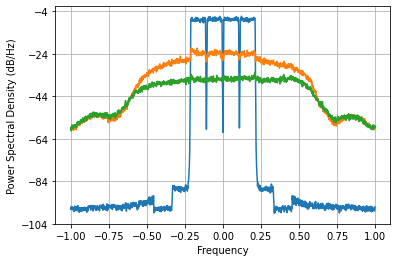

Loss =  0.0001299225592229936 Accuracy =  -23.90855459946021 dbs


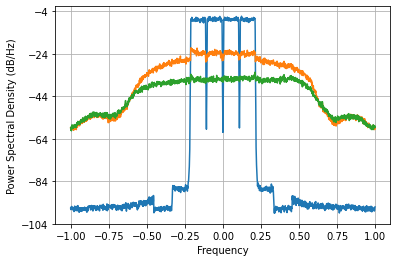

Loss =  0.00012915755216361024 Accuracy =  -23.934202211569126 dbs


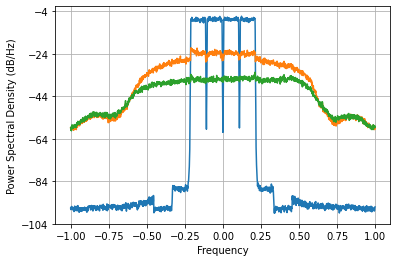

Loss =  0.00012840643666894925 Accuracy =  -23.959532323966613 dbs


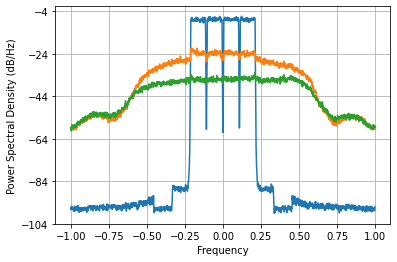

Loss =  0.00012766931144011723 Accuracy =  -23.984535105832578 dbs


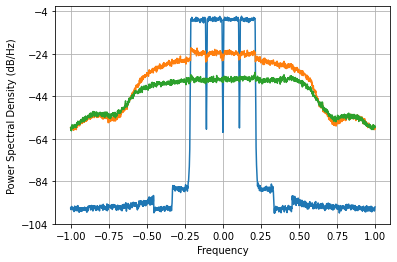

Loss =  0.00012694663678972074 Accuracy =  -24.00918827134373 dbs


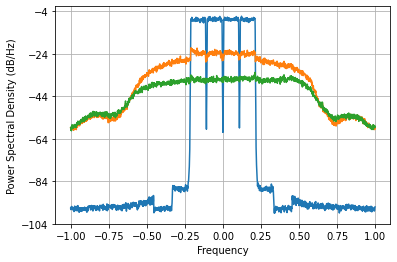

Loss =  0.00012623941157461613 Accuracy =  -24.033450651455517 dbs


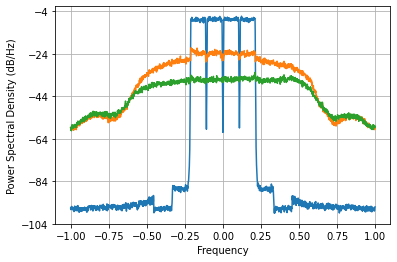

Loss =  0.00012554925144564908 Accuracy =  -24.057258989980603 dbs


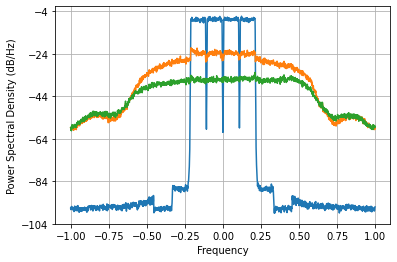

Loss =  0.0001248783209683588 Accuracy =  -24.08052975832135 dbs


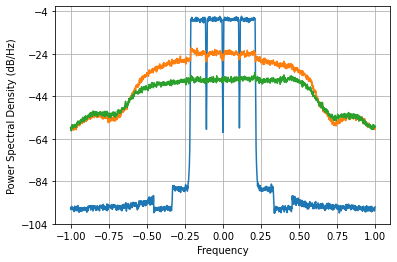

Loss =  0.00012422911578093175 Accuracy =  -24.103166326102723 dbs


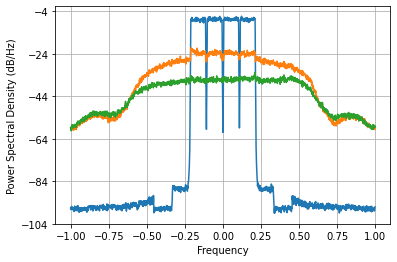

Loss =  0.00012360413347695383 Accuracy =  -24.12507032341459 dbs


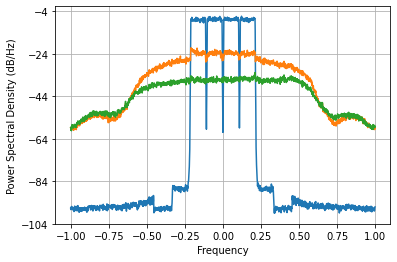

Loss =  0.00012300550534757846 Accuracy =  -24.14615477130399 dbs


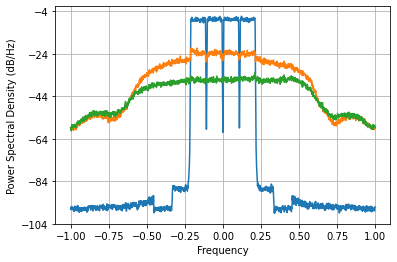

Loss =  0.00012243467692946405 Accuracy =  -24.16635587095952 dbs


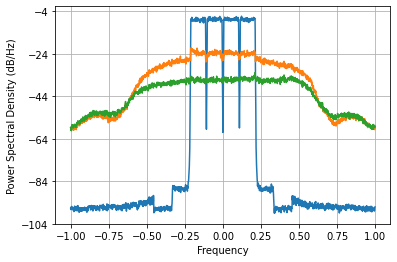

Loss =  0.000121892215119676 Accuracy =  -24.185640572349843 dbs


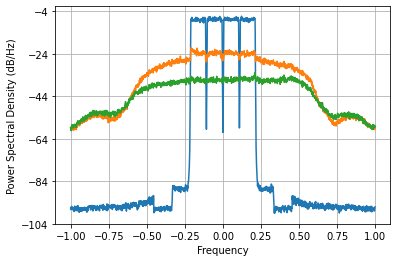

Loss =  0.00012137778256562748 Accuracy =  -24.204008275287492 dbs


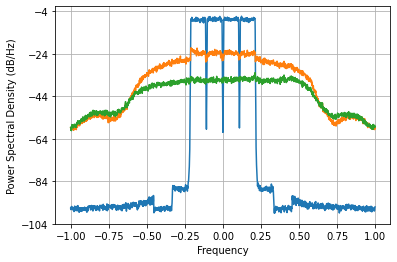

Loss =  0.00012089026844353578 Accuracy =  -24.221486847305012 dbs


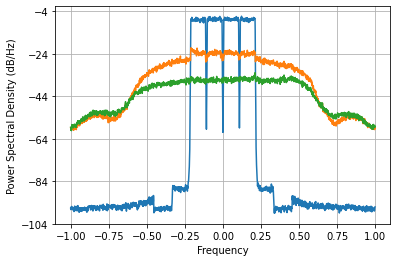

Loss =  0.00012042802050422974 Accuracy =  -24.238124788483802 dbs


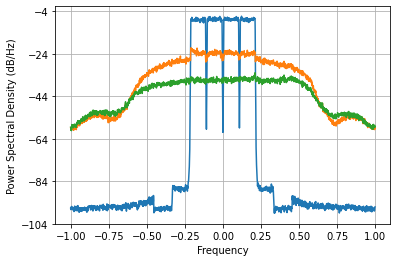

Loss =  0.00011998910509100638 Accuracy =  -24.253982124211344 dbs


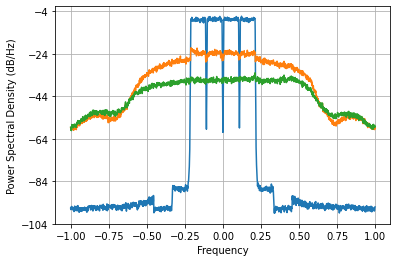

Loss =  0.00011957153330148901 Accuracy =  -24.269122283201376 dbs


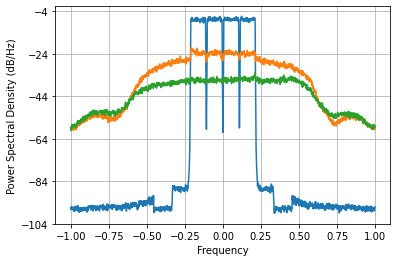

Loss =  0.00011917342049156924 Accuracy =  -24.28360622131459 dbs


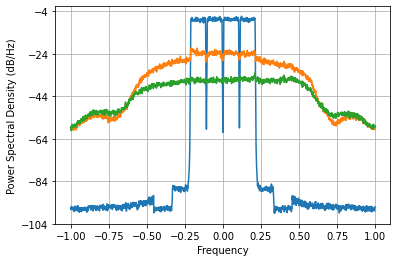

Loss =  0.00011879307560222936 Accuracy =  -24.29748900145633 dbs


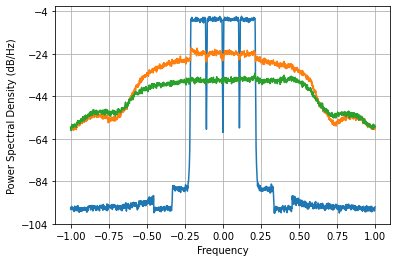

Loss =  0.00011842903500612146 Accuracy =  -24.310818361504754 dbs


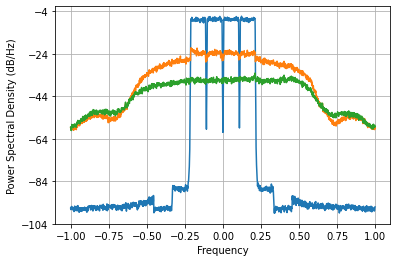

Loss =  0.00011808006093829877 Accuracy =  -24.323634580802032 dbs


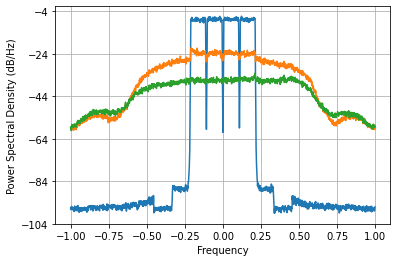

Loss =  0.00011774512145432092 Accuracy =  -24.335971046822927 dbs


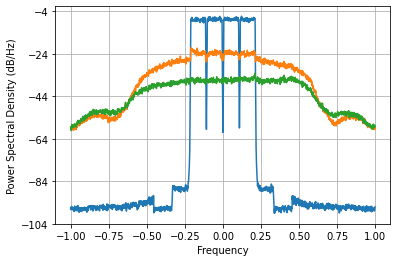

Loss =  0.00011742336281044974 Accuracy =  -24.347855129944918 dbs


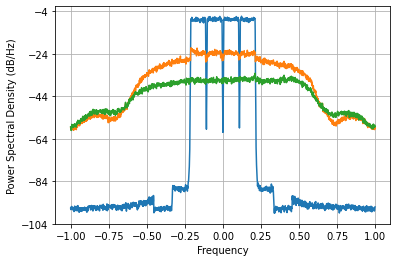

Loss =  0.0001171140799479548 Accuracy =  -24.359309157652195 dbs


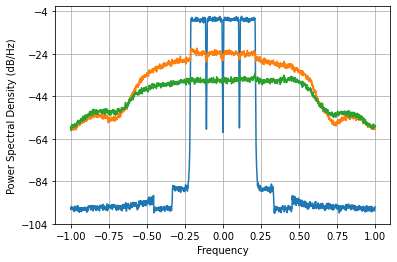

Loss =  0.00011681668769179048 Accuracy =  -24.3703513892231 dbs


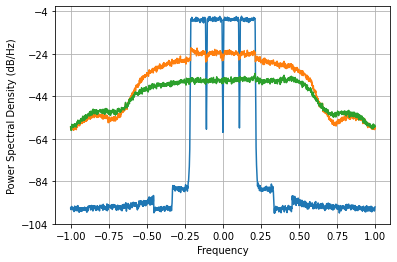

Loss =  0.00011653069397206537 Accuracy =  -24.38099693884452 dbs


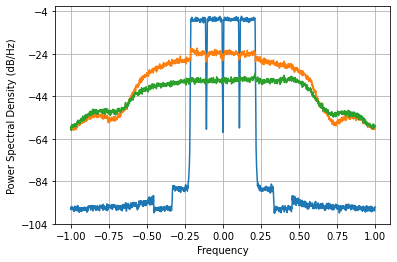

Loss =  0.00011625567593882789 Accuracy =  -24.391258610941 dbs


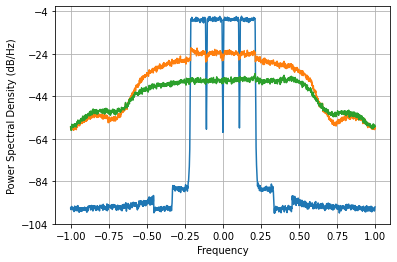

Loss =  0.00011599125959055628 Accuracy =  -24.40114762069989 dbs


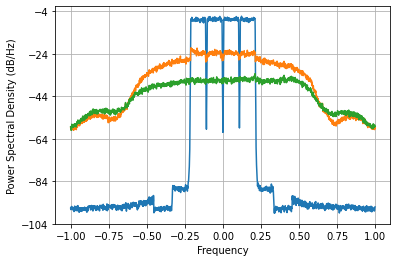

Loss =  0.00011573710323179354 Accuracy =  -24.410674184221644 dbs


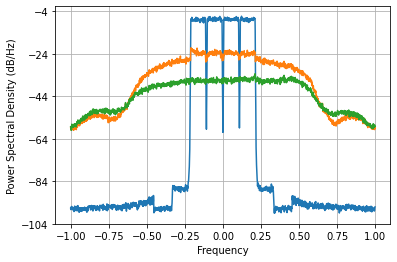

Loss =  0.00011549288474626724 Accuracy =  -24.419847975303668 dbs


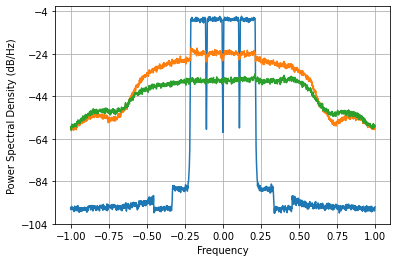

Loss =  0.0001152582924015792 Accuracy =  -24.42867845644399 dbs


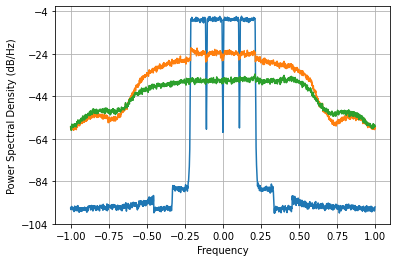

Loss =  0.00011503301872482142 Accuracy =  -24.437175098845433 dbs


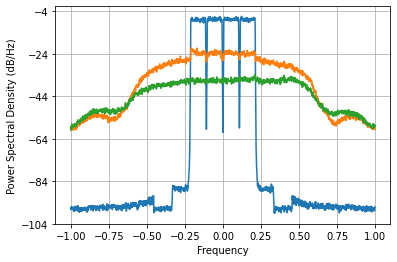

Loss =  0.00011481675690018781 Accuracy =  -24.445347510112256 dbs


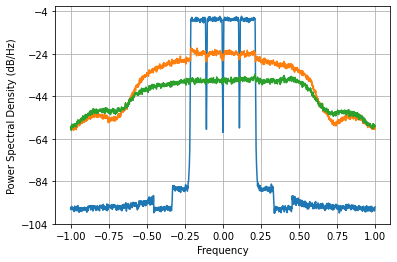

Loss =  0.00011460919912360179 Accuracy =  -24.45320548949713 dbs


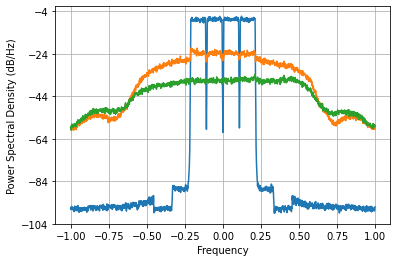

Loss =  0.00011441003638519951 Accuracy =  -24.460759029696586 dbs


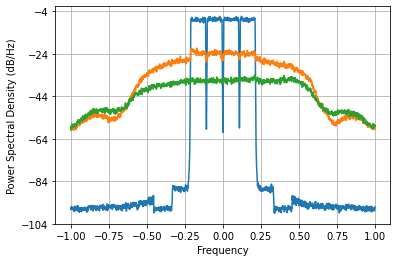

Loss =  0.00011421895921382318 Accuracy =  -24.46801828220302 dbs


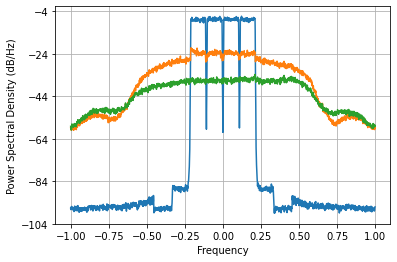

Loss =  0.00011403565898662493 Accuracy =  -24.474993500925333 dbs


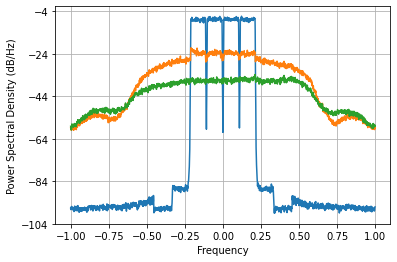

Loss =  0.00011385982946810013 Accuracy =  -24.48169497670449 dbs


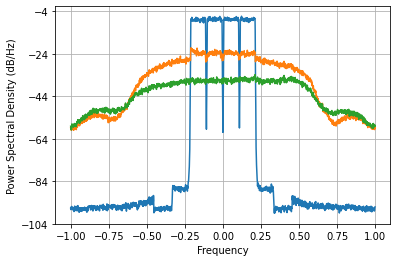

Loss =  0.00011369116829197568 Accuracy =  -24.48813297365787 dbs


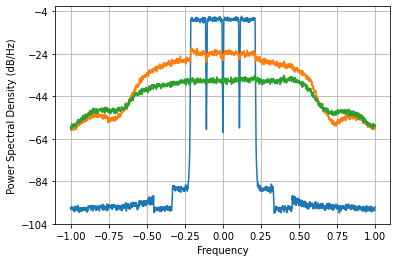

Loss =  0.00011352937813941376 Accuracy =  -24.494317676886716 dbs


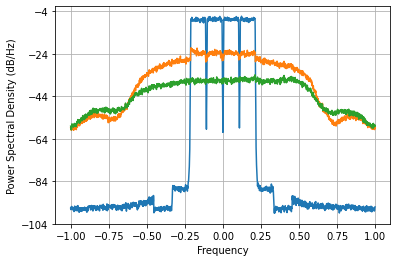

Loss =  0.00011337416740661597 Accuracy =  -24.500259159655307 dbs


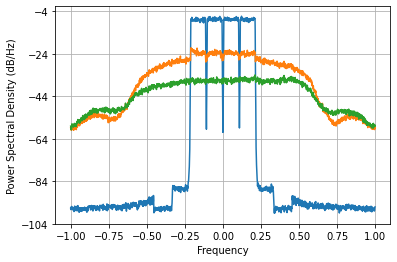

Loss =  0.00011322525020551039 Accuracy =  -24.505967376268817 dbs


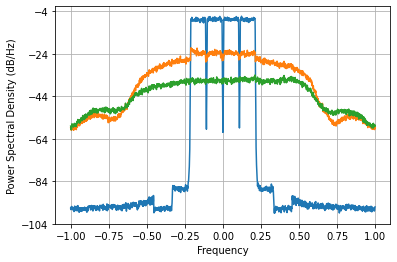

Loss =  0.00011308234561288694 Accuracy =  -24.51145218415073 dbs


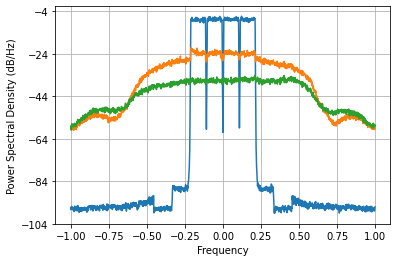

Loss =  0.00011294517618073025 Accuracy =  -24.51672339486985 dbs


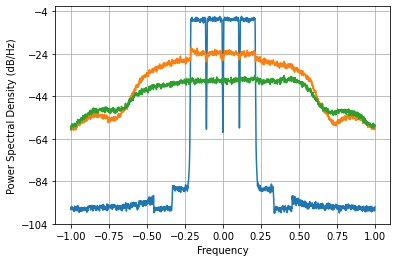

Loss =  0.00011281346583904798 Accuracy =  -24.52179084926099 dbs


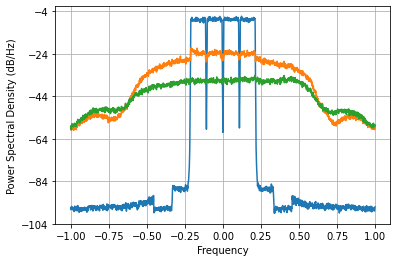

Loss =  0.00011268693744726006 Accuracy =  -24.526664506897387 dbs


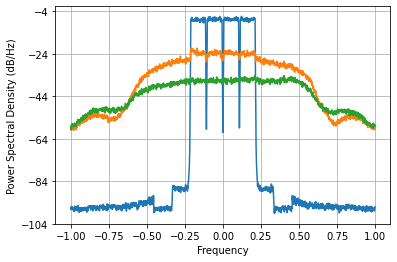

Loss =  0.00011256531035844296 Accuracy =  -24.531354535891225 dbs


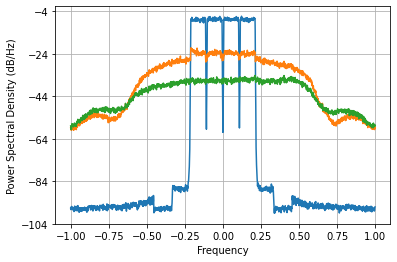

Loss =  0.00011244829842862077 Accuracy =  -24.53587138625359 dbs


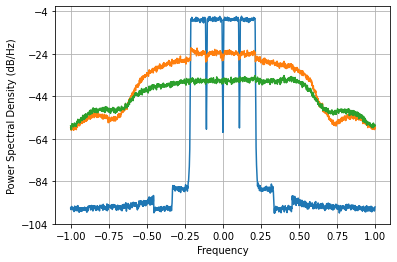

Loss =  0.00011233560891499366 Accuracy =  -24.540225829471073 dbs


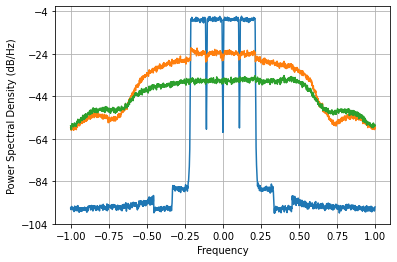

Loss =  0.00011222694266177417 Accuracy =  -24.54442894860154 dbs


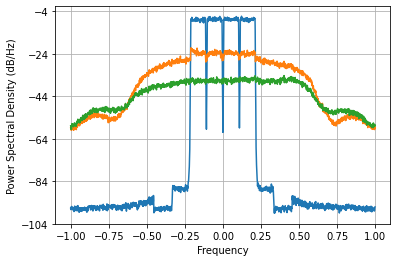

Loss =  0.00011212199588587955 Accuracy =  -24.54849206646464 dbs


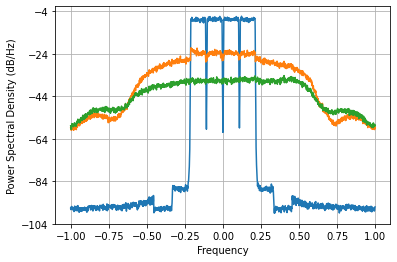

Loss =  0.00011202046377256045 Accuracy =  -24.552426603422393 dbs


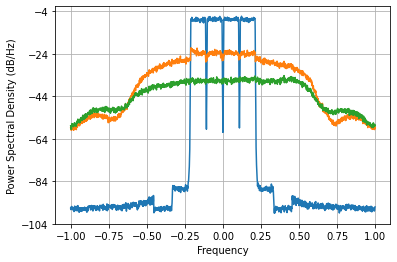

Loss =  0.00011192204599553503 Accuracy =  -24.556243859938753 dbs


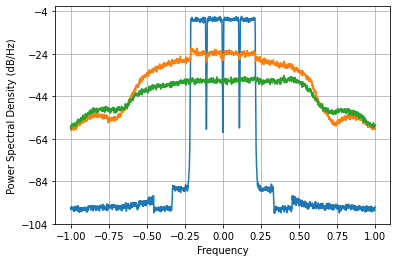

Loss =  0.0001118264541930837 Accuracy =  -24.55995472234101 dbs


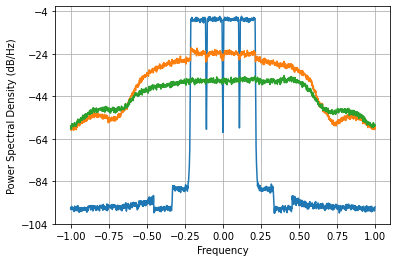

Loss =  0.00011173342134176264 Accuracy =  -24.563569293712565 dbs


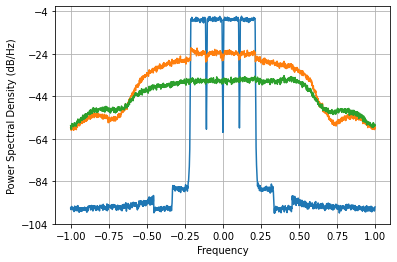

Loss =  0.00011164271283069521 Accuracy =  -24.56709645726829 dbs


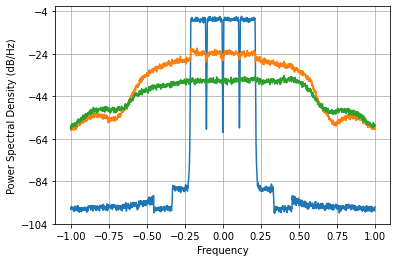

Loss =  0.00011155413879901251 Accuracy =  -24.570543388973476 dbs


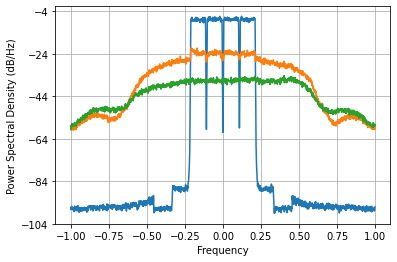

Loss =  0.00011146756691533778 Accuracy =  -24.573915051219174 dbs


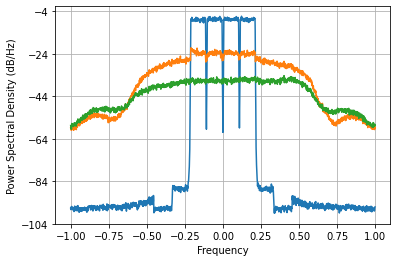

Loss =  0.00011138293424883465 Accuracy =  -24.577213720203638 dbs


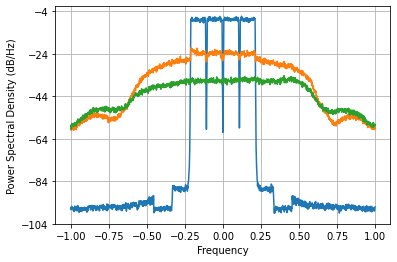

Loss =  0.0001113002562727938 Accuracy =  -24.580438623739035 dbs


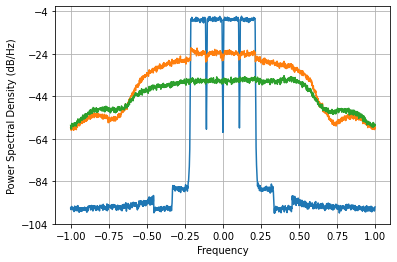

Loss =  0.00011121963051288845 Accuracy =  -24.583585787317467 dbs


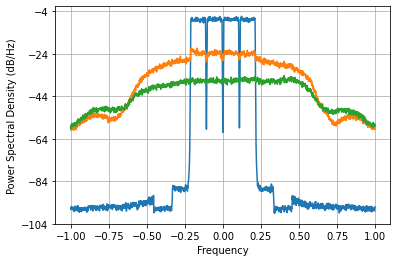

Loss =  0.00011114123215564461 Accuracy =  -24.586648194518403 dbs


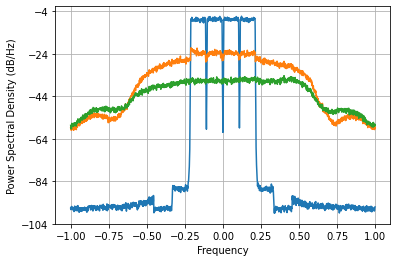

Loss =  0.00011106529937131523 Accuracy =  -24.589616351240604 dbs


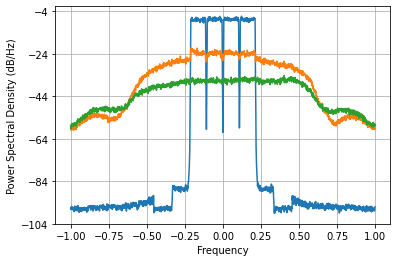

Loss =  0.00011099210742494026 Accuracy =  -24.59247929195851 dbs


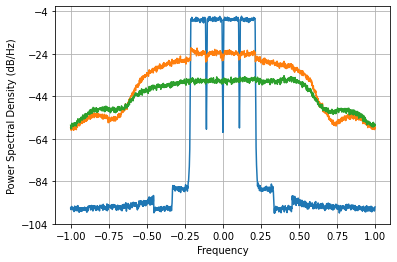

Loss =  0.00011092193287326018 Accuracy =  -24.59522597905768 dbs


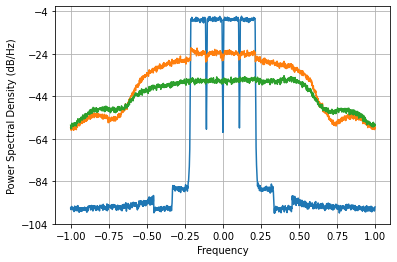

Loss =  0.00011085501191175954 Accuracy =  -24.597846937265366 dbs



In [ ]:
net = Cell_upd3()
# net
net=net.to("cuda:0")
optimizer = torch.optim.Adam(net.parameters(), lr=1e-2)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=1)
hist14 = train(train_queue, valid_queue, net, loss_fn, optimizer,120,scheduler,save_flag=False)

Сравнение с клеткой Masl без FIR

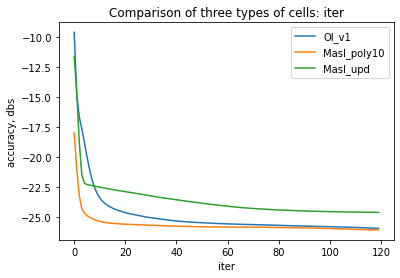

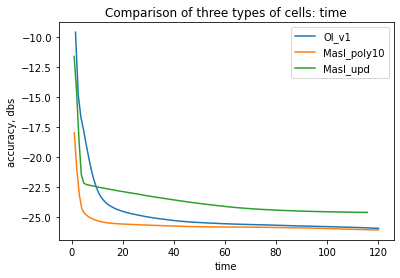

In [ ]:
Comparison_best_res(hist12, hist13, hist14)